In [1]:

%reload_ext autoreload
%autoreload 2

import numpy as np
import matplotlib.pyplot as plt

from qick import *
from qick.helpers import gauss
from tqdm import tqdm_notebook as tqdm

import time
import os
import sys
sys.path.append('/home/xilinx/jupyter_notebooks/')
sys.path.append('C:\\_Lib\\python\\rfsoc\\rfsoc_multimode\\example_expts')
import scipy as sp
import json
from scipy.fft import fft, fftfreq

from slab.instruments import *
from slab.experiment import Experiment
from slab.datamanagement import SlabFile
from slab import get_next_filename, AttrDict
from slab import Experiment, dsfit, AttrDict

# Figure params
plt.rcParams['figure.figsize'] = [10,6]
plt.rcParams.update({'font.size': 14})

Warning serial library import failed.
Could not load InstrumentManagerWindow
Could not import QickInstrument, try install qick package
Could not load AD5780 dac 
Could not load labbrick
Could not load Autonics TM4 Driver


In [2]:
from slab.dsfit import *
import os
from scipy.interpolate import griddata
from numpy import mgrid, array, zeros,abs,pi,cos,transpose, linspace
from matplotlib.ticker import MultipleLocator, FormatStrFormatter
from tempfile import TemporaryFile
font = {'family' : 'DejaVu Sans',
        'weight' : 'normal',
        'size'   : 15}
import json
from h5py import File
from datetime import datetime
import time
from slab.datamanagement import SlabFile
import matplotlib.pyplot as plt
import numpy as np
import os
import json
from slab.dsfit import *
from scipy.optimize import curve_fit
# import experiments.fitting as fitter
from matplotlib.colors import Normalize

# Function used in experiment

In [3]:
import sys

# Path to add
expts_path = 'C:\\_Lib\\python\\multimode_expts'

# Add the path to the system path at the highest priority
if expts_path not in sys.path:
    sys.path.insert(0, expts_path)
    print('Path added at highest priority')

# Verify the path is added
print(sys.path)


Path added at highest priority
['C:\\_Lib\\python\\multimode_expts', 'C:\\_Lib\\python', 'C:\\_Lib\\python\\slab', 'C:\\_Lib\\python\\qick\\qick_lib', 'C:\\_Lib\\python\\rfsoc\\rfsoc_multimode\\example_expts', 'c:\\_Lib\\python\\multimode_expts\\analysis_notebooks', 'c:\\Users\\26049\\.conda\\envs\\slab\\python38.zip', 'c:\\Users\\26049\\.conda\\envs\\slab\\DLLs', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib', 'c:\\Users\\26049\\.conda\\envs\\slab', '', 'C:\\Users\\26049\\AppData\\Roaming\\Python\\Python38\\site-packages', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib\\site-packages', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib\\site-packages\\easy_lmfit-1.0-py3.8.egg', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib\\site-packages\\attrdict-2.0.1-py3.8.egg', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib\\site-packages\\win32', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib\\site-packages\\win32\\lib', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib\\site-packages\\Pythonwin', 'c:\\Users\\26049\\.conda\\envs

In [4]:
from fitting.fit_display import *

importing from path  C:\_Lib\python\multimode_expts\experiments\clifford_averager_program.py
imported experiments.clifford_averager_program
importing from path  C:\_Lib\python\multimode_expts\experiments\fitting.py
imported experiments.fitting
importing from path  C:\_Lib\python\multimode_expts\experiments\qram_protocol_timestepped.py
imported experiments.qram_protocol_timestepped
importing from path  C:\_Lib\python\multimode_expts\experiments\qsim
imported experiments.qsim.floquet_general
importing from path  C:\_Lib\python\multimode_expts\experiments\qubit_cavity
imported experiments.qubit_cavity.amplitude_rabi_f0g1
imported experiments.qubit_cavity.displacement_enhanced_sideband
imported experiments.qubit_cavity.displace_amplitude_calibration
imported experiments.qubit_cavity.displace_pulse_probe
imported experiments.qubit_cavity.ecd
imported experiments.qubit_cavity.ecd_backup
imported experiments.qubit_cavity.ecd_read_spec
imported experiments.qubit_cavity.non_demolution_readout
i

In [5]:
import experiments.fitting as fitter
from numpy.linalg import inv

# Experiment data file path

In [6]:

# print("path: ", path)

"""Reopen saved data"""
def prev_data(expt_path, filename):
    temp_data_file = expt_path+'\\'+filename
    with SlabFile(temp_data_file) as a:
        attrs = dict()
        for key in list(a.attrs):
            attrs.update({key:json.loads(a.attrs[key])})
        keys = list(a)
        temp_data = dict()
        for key in keys:
            temp_data.update({key:np.array(a[key])})
        # print(f'Extracted data and attrs {list(a.attrs)}')
    return temp_data, attrs
data_parent =  r'H:\Shared drives\SLab\Multimode\experiment\250307_qsim'
data_parent_old = r'H:\Shared drives\SLab\Multimode\experiment\240911'
expt_path=data_parent+'\\data'
expt_path_old=data_parent_old+'\\data'
print('Data are extracted from', expt_path)

Data are extracted from H:\Shared drives\SLab\Multimode\experiment\250307_qsim\data


# Dataset

In [7]:
from experiments.dataset import *
from experiments.dataset import storage_man_swap_dataset
import os 

file_path = os.path.join(expts_path, 'man1_storage_swap_dataset.csv')
# print(os.makedirs(file_path, exist_ok=True))
ds = storage_man_swap_dataset(file_path)

In [8]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.125,0.01,0.811174,0.358205,3000,2025-05-02 11:10:55.896851
1,M1-S2,520.320,0.05,0.938822,0.423037,5000,2025-03-27 21:05:57.941851
2,M1-S3,694.130,0.05,1.007907,0.464203,9000,2025-04-30 13:21:53.707418
3,M1-S4,873.750,0.05,1.082605,0.506007,9000,2025-03-27 19:04:37.148499
4,M1-S5,1052.650,0.05,1.735148,0.820643,7500,2025-03-12 10:41:05.165443
5,M1-S6,1244.520,0.05,1.372186,0.637996,13500,2025-03-12 09:53:56.486329
6,M1-S7,1422.350,0.05,1.964983,0.927853,10000,2025-03-12 09:14:13.544748
7,M1-S8,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3


In [9]:
list(ds.df['freq (MHz)'][1:7])

[520.32, 694.13, 873.75, 1052.65, 1244.52, 1422.35]

In [10]:
list(ds.df['gain (DAC units)'][1:7])

[5000, 9000, 9000, 7500, 13500, 10000]

# Actual experiment data

## qubit g-f rabi

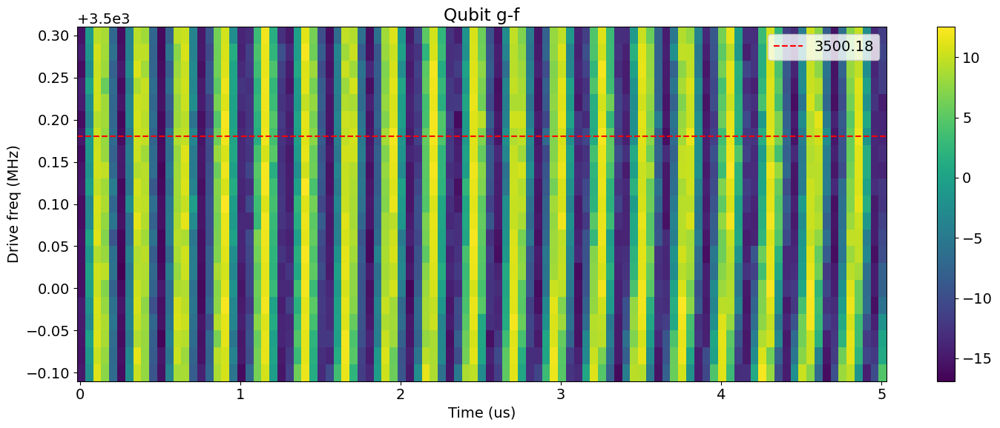

In [11]:
file_list = np.arange(35, 56, 1)
y_list = []
freq_list = []
name = '_length_rabi_sweep.h5'
normalize = False


for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    if normalize: 
        signal_y = normalize_data1(temp_data['avgi'], temp_data['g_data'][0], temp_data['f_data'][0])
        #signal_y = normalize_data(temp_data['avgq'], temp_data['g_data'][1], temp_data['f_data'][1])
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['freq'])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[3500.18], vlines=None, normalize = normalize, title="Qubit g-f")

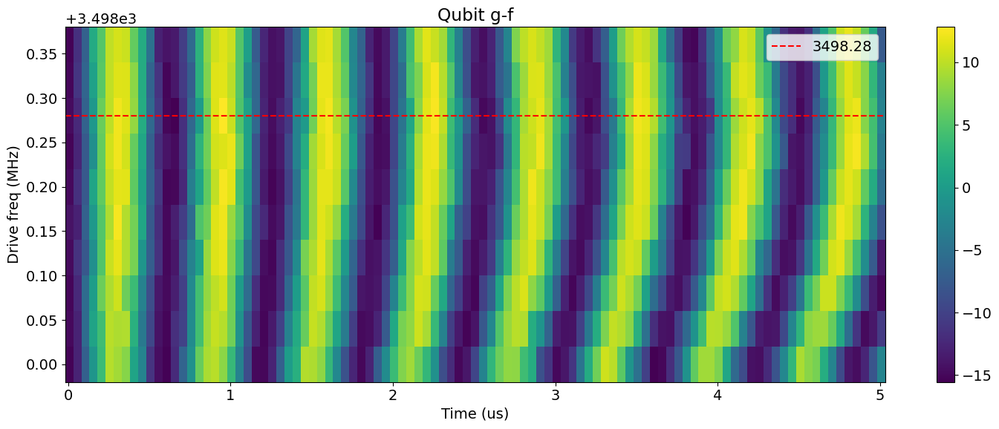

In [75]:
file_list = np.arange(61, 71, 1)
y_list = []
freq_list = []
name = '_length_rabi_sweep.h5'
normalize = False


for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    if normalize: 
        signal_y = normalize_data1(temp_data['avgi'], temp_data['g_data'][0], temp_data['f_data'][0])
        #signal_y = normalize_data(temp_data['avgq'], temp_data['g_data'][1], temp_data['f_data'][1])
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['freq'])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[3498.28], vlines=None, normalize = normalize, title="Qubit g-f")

In [59]:
attrs['config']['expt']

{'start': 0.007,
 'step': 0.05,
 'qubits': [0],
 'expts': 101,
 'reps': 200,
 'rounds': 1,
 'gain': 15000,
 'ramp_sigma': 0.005,
 'freq': 3498.3599999999997,
 'pi_ge_before': False,
 'pi_ef_before': False,
 'pi_ge_after': False,
 'pre_pulse': False,
 'length_placeholder': 5.007}

## Length rabi f0-g1 M1

Attempted to init fitparam 4 to 76.4702758314856, which is out of bounds -138.6807512195122 to -73.78528130081301. Instead init to -106.2330162601626
[72.23686667  0.81230416 92.2674292  98.43379939 73.15851581 -3.91302455]
Decay from avgi [us] 98.43379938677828
Rate [MHz] 0.8123041566928968
Pi length from avgi data [us]: 0.6077792185114786
	Pi/2 length from avgi data [us]: 0.30001272742541113
Fit params:  [72.23686667  0.81230416 92.2674292  98.43379939 73.15851581 -3.91302455]

Decay from avgq [us] 6.732914721328694
Rate [MHz] 0.8091060256535263
Pi length from avgq data [us]: 0.6012328704539641
Pi/2 length from avgq data [us]: 0.30061643522698206
Fit params:  [  72.23686667    0.80910603   94.87399021    6.73291472 -106.77647156
   -3.91302455]


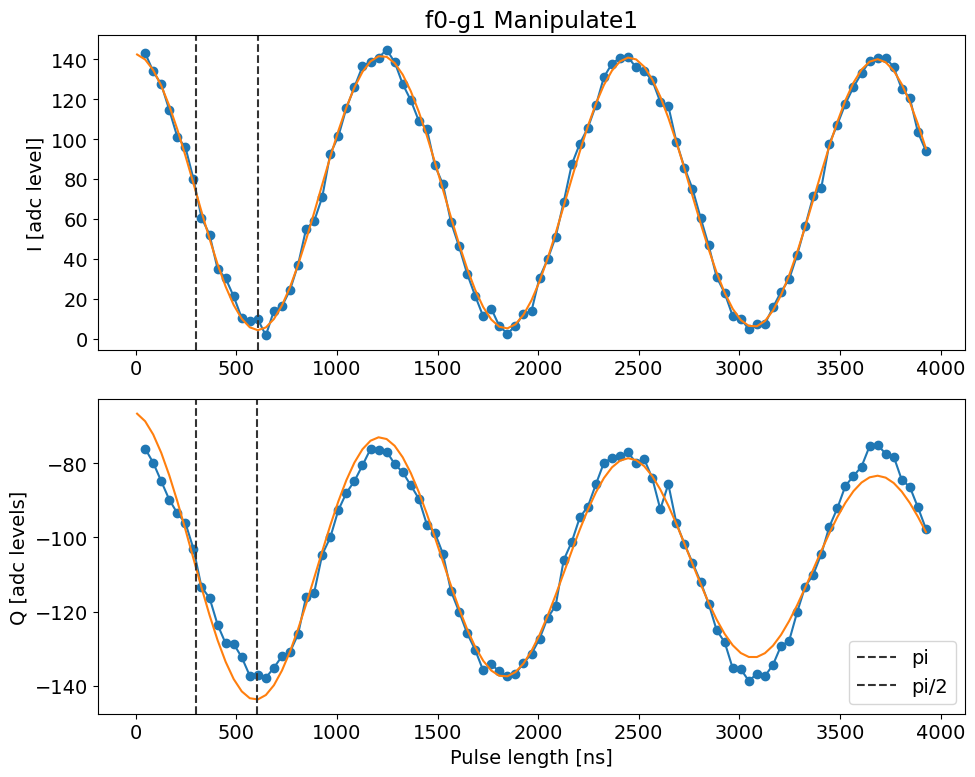

In [22]:
temp_data, attrs = prev_data(expt_path, '00001_LengthRabiGeneralF0g1Experiment.h5')  #
Ilist2 = length_rabi_display(temp_data, fit=True, fitparams=[None,None,None,None,None,None ], vlines = None,
                      normalize= [False, 'g_data', 'f_data'],
                       active_reset = False,  title='f0-g1 Manipulate1')

In [23]:
freq = attrs['config']['expt']['freq']
pi_length = temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = 15000

ds.update_all('M1', freq, 0.03, pi_length, pi2_length, gain)



In [24]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.660,0.03,0.942926,0.465943,3000,2025-01-21 16:12:51.119011
1,M1-S2,521.230,0.05,1.069160,0.531718,5000,2025-01-21 16:17:17.763411
2,M1-S3,696.980,0.03,1.256963,0.613370,9000,2025-01-21 16:17:39.113328
3,M1-S4,876.380,0.03,1.235632,0.622603,9000,2025-01-21 16:17:54.523998
4,M1-S5,1053.950,0.03,1.882097,0.985547,7500,2025-01-21 16:18:31.141469
5,M1-S6,1245.525,0.03,1.500950,0.732998,13500,2025-01-21 16:32:20.759195
6,M1-S7,1423.275,0.03,2.153588,1.085899,10000,2025-01-21 16:32:02.177572
7,M1-S8,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3


In [6]:
import numpy as np
2/200 

0.01

### f1-g2

[12.0842431   1.12836022 92.8622305  65.35339383 -1.83724394 -2.9253932 ]
Decay from avgi [us] 65.35339382540624
Rate [MHz] 1.128360223229978
Pi length from avgi data [us]: 0.4360747123098117
	Pi/2 length from avgi data [us]: 0.21803735615490585

Decay from avgq [us] 65.13295713883099
Rate [MHz] 1.1292445512017966
Pi length from avgq data [us]: 0.43715618110200094
Pi/2 length from avgq data [us]: 0.21857809055100047


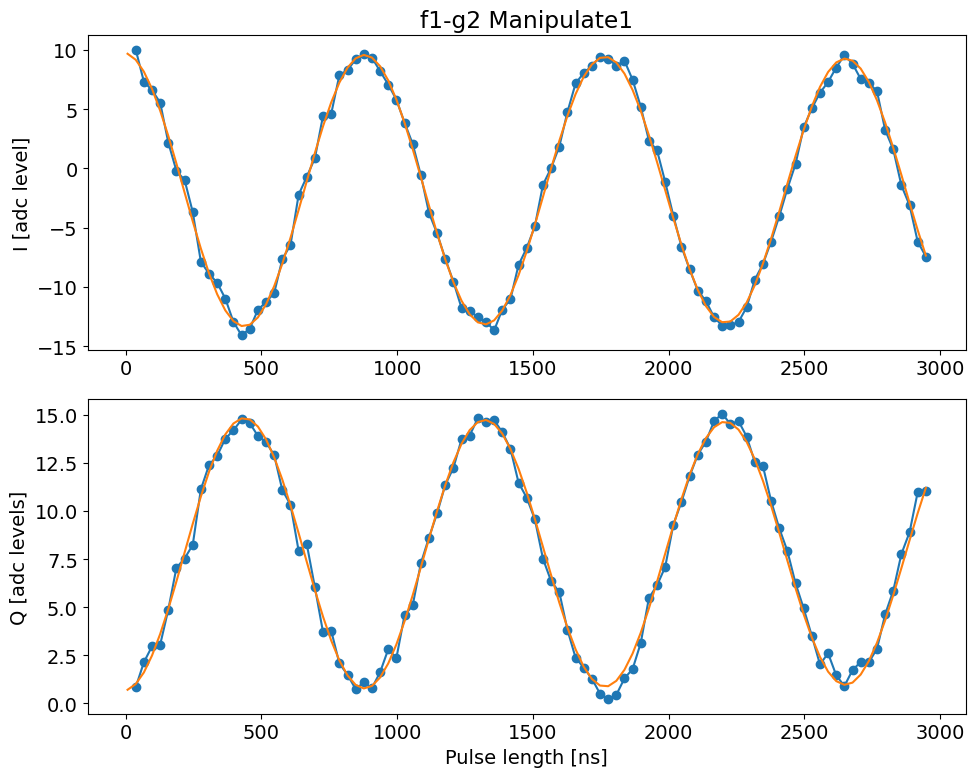

In [77]:
temp_data, attrs = prev_data(expt_path, '00005_LengthRabiGeneralF0g1Experiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='f1-g2 Manipulate1')

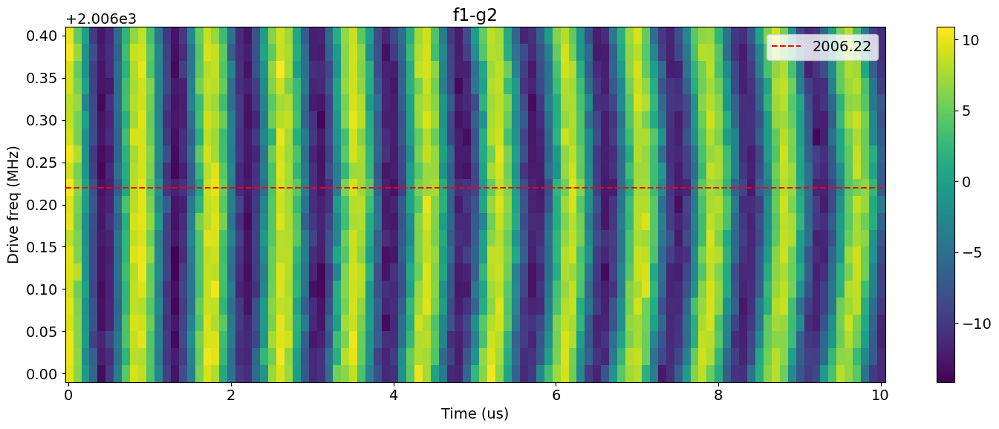

In [76]:
file_list = np.arange(45, 66, 1)
y_list = []
freq_list = []
name = '_length_rabi_f0g1_sweep.h5'
normalize = False


for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    if normalize: 
        signal_y = normalize_data1(temp_data['avgi'], temp_data['g_data'][0], temp_data['f_data'][0])
        #signal_y = normalize_data(temp_data['avgq'], temp_data['g_data'][1], temp_data['f_data'][1])
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['freq'])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[2006.22], vlines=None, normalize = normalize, title="f1-g2")

### f2-g3

In [9]:
temp_data, attrs = prev_data(expt_path, '00006_LengthRabiGeneralF0g1Experiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='f2-g3 Manipulate1')

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = 'H:\Shared drives\SLab\Multimode\experiment\250307_qsim\data\00006_LengthRabiGeneralF0g1Experiment.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

### f3-g4

[10.10797078  1.59916906 94.68841582 48.25838625 -0.56248215 -1.95302455]
Decay from avgi [us] 48.25838624539497
Rate [MHz] 1.5991690598877262
Pi length from avgi data [us]: 0.3045185371188427
	Pi/2 length from avgi data [us]: 0.15225926855942135
Fit params:  [10.10797078  1.59916906 94.68841582 48.25838625 -0.56248215 -1.95302455]

Decay from avgq [us] 38.701607453873045
Rate [MHz] 1.5979281595704924
Pi length from avgq data [us]: 0.3036142192358008
Pi/2 length from avgq data [us]: 0.1518071096179004
Fit params:  [  6.94105844   1.59792816 -84.6553358   38.70160745   8.36734341
  -1.95302455]


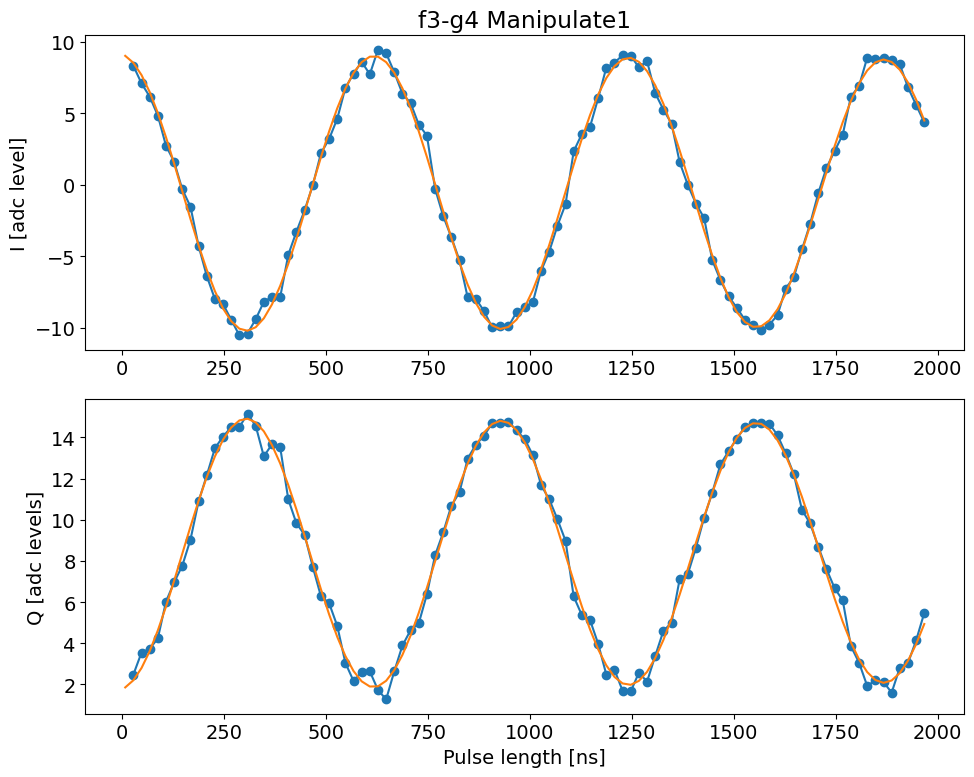

In [648]:
temp_data, attrs = prev_data(expt_path, '00007_LengthRabiGeneralF0g1Experiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='f3-g4 Manipulate1', 
                    active_reset=False)

## Length rabi f0-g1 M1 sweep

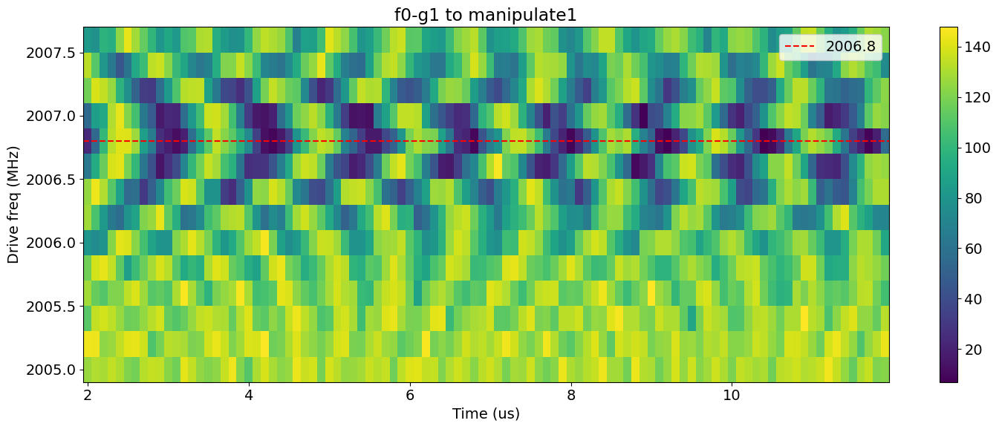

In [25]:

file_list = np.arange(14,20,1)
file_list = np.arange(00,14,1)

y_list = []
freq_list = []
name = '_length_rabi_f0g1_sweep.h5'
normalize = False


for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi'][0:-1]
    # if attrs['config']['expt']['active_reset']:
    #     # for each time, post select the single shot data
    #     Ilist = []
    #     Qlist = []
    #     threshold = -4#attrs['config']['expt']['threshold'][0]
    #     readout_per_round = 4#attrs['config']['expt']['readout_per_round']
    #     for ii in range(len(temp_data['idata'])-1):
    #         Ig, Qg = filter_data_IQ(temp_data['idata'][ii], temp_data['qdata'][ii], threshold, readout_per_round)
    #         Ilist.append(np.mean(Ig))
    #         Qlist.append(np.mean(Qg))
        
        
    #signal_y = Ilist
    #print(len(signal_y))
    
    len_x = temp_data['xpts'][0:-1]
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['freq'])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[2006.8], vlines=None, normalize = normalize, title="f0-g1 to manipulate1")

In [74]:
# participation factor g^2/delta^2
chi = 1.4e6 # Hz    assume g^2/delta^2 * alpha
kerr = 6e3      #   assume g^4/delta^4 * alpha
delta = 980e6
part_factor = kerr/chi
g = np.sqrt(part_factor)*delta
alpha = chi/part_factor

print(f'g = {g/1e6} MHz, alpha = {alpha/1e6} MHz, chi = {chi/1e6} MHz, kerr = {kerr/1e6} MHz')

g = 64.15605972938175 MHz, alpha = 326.66666666666663 MHz, chi = 1.4 MHz, kerr = 0.006 MHz


In [79]:
A = 4 * g**2 * chi/kerr 
alpha_ = delta - (delta**3/A)
print(f'alpha = {alpha_/1e6} MHz')

alpha = 735.0 MHz


In [101]:
g = 102e6
alpha = 60e6
delta = 980e6
kerr = 1/2 * g**4/(delta**4) * alpha
chi = 2*g**2/(delta * (delta - alpha)) * alpha
print(f'g = {g/1e6} MHz, alpha = {alpha/1e6} MHz, chi = {chi/1e6} MHz, kerr = {kerr/1e6} MHz')

g = 102.0 MHz, alpha = 60.0 MHz, chi = 1.3847382431233362 MHz, kerr = 0.00352060773650296 MHz


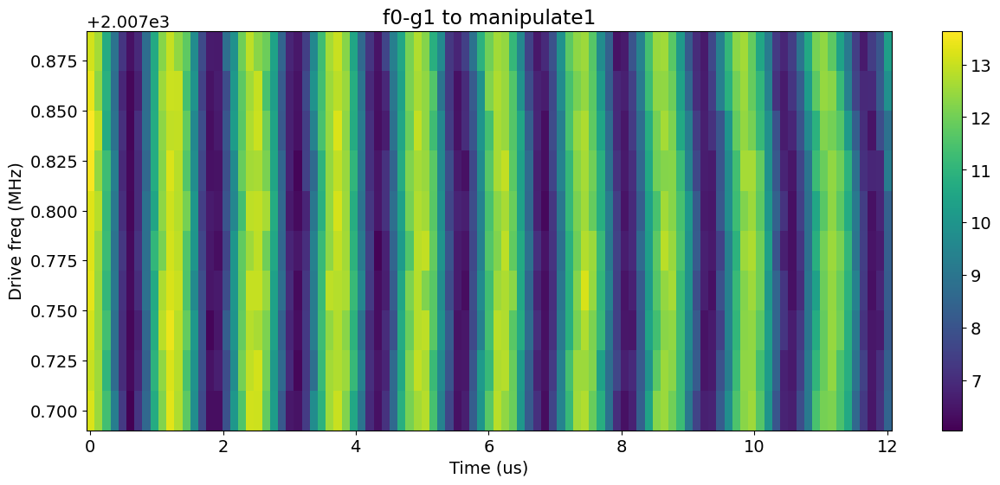

In [256]:
file_list = np.arange(81,91,1)
y_list = []
freq_list = []
name = '_length_rabi_f0g1_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['freq'])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=None, vlines=None, title="f0-g1 to manipulate1")
    

### f1-g2

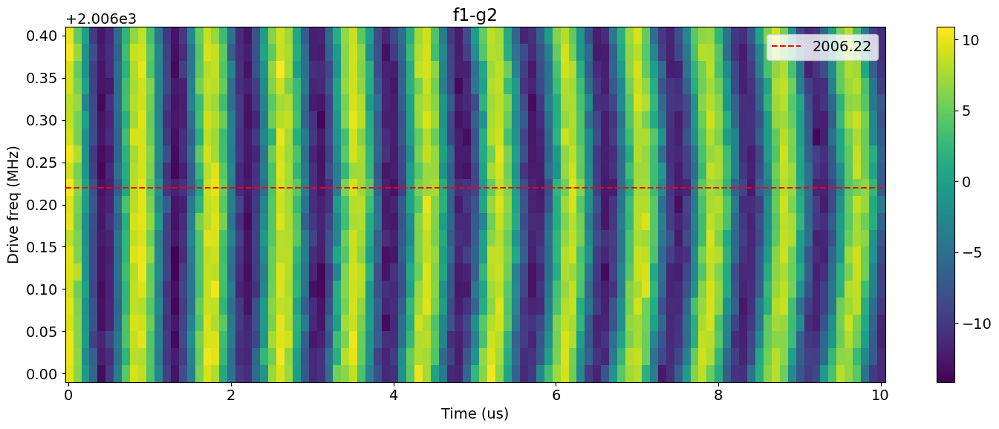

In [78]:
file_list = np.arange(45, 66, 1)
y_list = []
freq_list = []
name = '_length_rabi_f0g1_sweep.h5'
normalize = False


for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    if normalize: 
        signal_y = normalize_data1(temp_data['avgi'], temp_data['g_data'][0], temp_data['f_data'][0])
        #signal_y = normalize_data(temp_data['avgq'], temp_data['g_data'][1], temp_data['f_data'][1])
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['freq'])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[2006.22], vlines=None, normalize = normalize, title="f1-g2")

### f2-g3

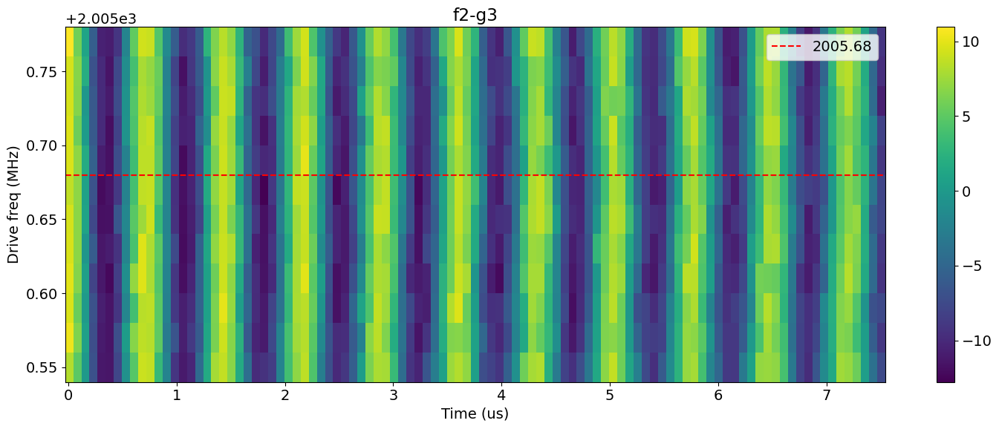

In [88]:
file_list = np.arange(76, 88, 1)
y_list = []
freq_list = []
name = '_length_rabi_f0g1_sweep.h5'
normalize = False


for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    if normalize: 
        signal_y = normalize_data1(temp_data['avgi'], temp_data['g_data'][0], temp_data['f_data'][0])
        #signal_y = normalize_data(temp_data['avgq'], temp_data['g_data'][1], temp_data['f_data'][1])
    len_x = temp_data['xpts'] 
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['freq'])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[2005.68], vlines=None, normalize = normalize, title="f2-g3")

## Length rabi f0-g1 M2

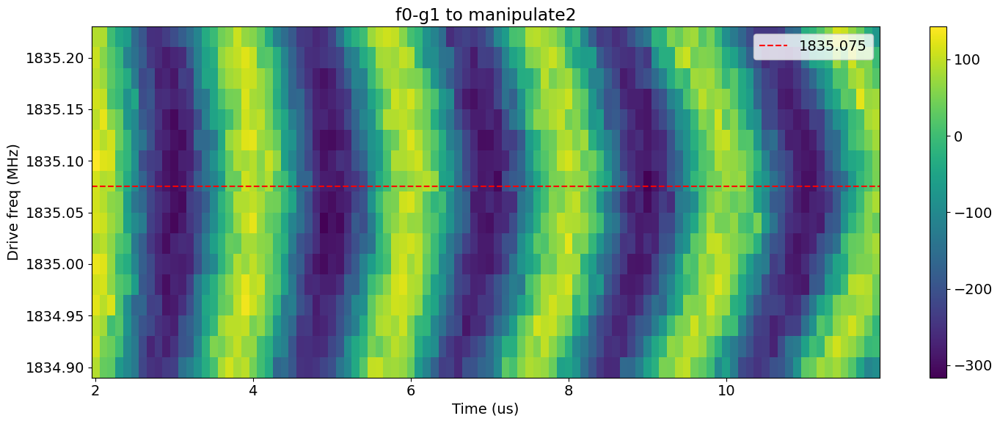

In [73]:
# file_list = np.arange(542, 553, 1)
file_list = np.arange(216,226,1)
file_list = np.arange(228, 245, 1)
y_list = []
freq_list = []
name = '_length_rabi_f0g1_sweep.h5'
normalize = False


for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi'][0:-1]
    # if attrs['config']['expt']['active_reset']:
    #     # for each time, post select the single shot data
    #     Ilist = []
    #     Qlist = []
    #     threshold = -4#attrs['config']['expt']['threshold'][0]
    #     readout_per_round = 4#attrs['config']['expt']['readout_per_round']
    #     for ii in range(len(temp_data['idata'])-1):
    #         Ig, Qg = filter_data_IQ(temp_data['idata'][ii], temp_data['qdata'][ii], threshold, readout_per_round)
    #         Ilist.append(np.mean(Ig))
    #         Qlist.append(np.mean(Qg))
        
        
    #signal_y = Ilist
    #print(len(signal_y))
    
    len_x = temp_data['xpts'][0:-1]
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['freq'])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1835.075], vlines=None, normalize = normalize, title="f0-g1 to manipulate2")

[234.47809822   0.50053352  89.50192967  57.41656705 -90.81503583
  -3.90827979]
Decay from avgi [us] 57.4165670521898
Rate [MHz] 0.5005335157164024
Pi length from avgi data [us]: 1.0016982139269228
	Pi/2 length from avgi data [us]: 0.502231160972076
Fit params:  [234.47809822   0.50053352  89.50192967  57.41656705 -90.81503583
  -3.90827979]

Decay from avgq [us] 13.855557175252095
Rate [MHz] 0.5007900163177621
Pi length from avgq data [us]: 1.0026527379255932
Pi/2 length from avgq data [us]: 0.5013263689627966
Fit params:  [ 218.94767532    0.50079002   89.23734684   13.85555718 -169.38629766
   -3.91302455]


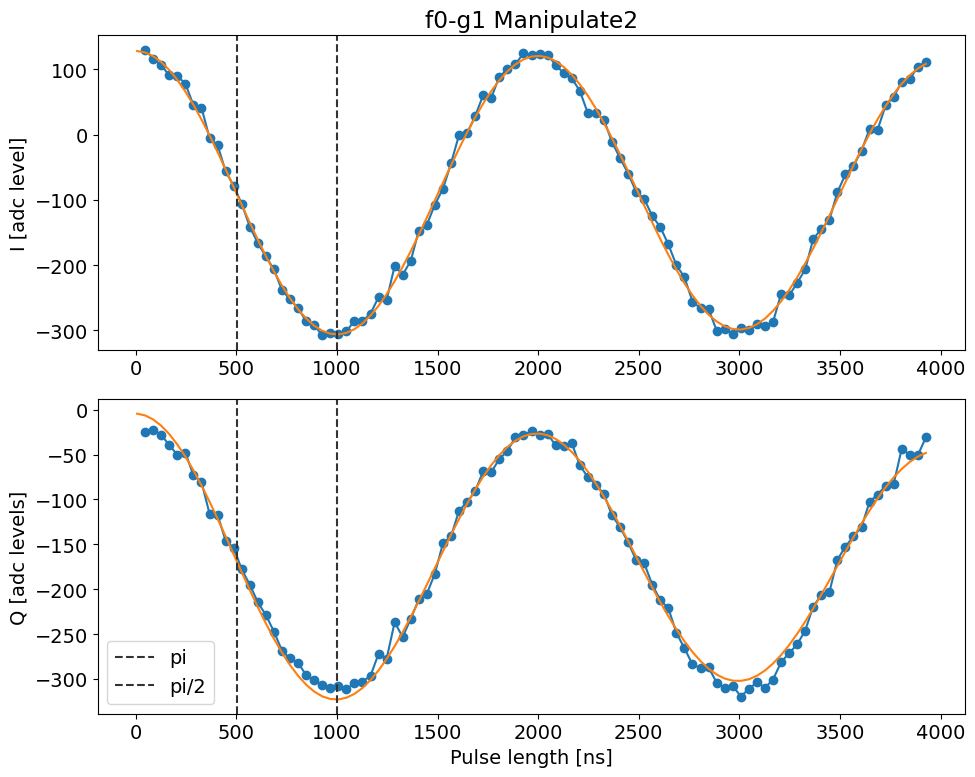

array([ 127.14921429,  130.35528571,  116.5226039 ,  106.05254545,
         91.27222727,   90.00142857,   78.18679221,   45.04641558,
         41.43456494,   -4.96692857,  -16.01501948,  -56.20016883,
        -78.2130974 , -105.93836364, -140.98462987, -166.2264026 ,
       -186.66292857, -206.53932468, -238.34741558, -252.17733766,
       -266.12868831, -285.51078571, -291.50127922, -307.54006494,
       -303.13705195, -305.35498701, -301.00055844, -285.58869481,
       -286.03076623, -274.16151948, -248.95418182, -253.30013636,
       -201.2135974 , -214.49630519, -193.20616883, -146.8979026 ,
       -138.0462987 , -107.03805844,  -82.94972727,  -44.02898052,
         -0.31077922,    2.0502013 ,   28.41874026,   60.77640909,
         56.47648052,   88.91857792,  100.06456494,  107.97974026,
        124.58601948,  121.54969481,  123.94095455,  121.95175974,
        107.02088312,   93.92545455,   86.17835714,   67.35472727,
         32.80864286,   32.76431169,   22.87786364,  -11.37683

In [75]:
temp_data, attrs = prev_data(expt_path, '00006_LengthRabiGeneralF0g1Experiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=[None,None,None,None,None,None ],
                    active_reset=False,  normalize= [False, 'g_data', 'f_data'], title='f0-g1 Manipulate2')

In [76]:
freq = attrs['config']['expt']['freq']
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['gain']

#ds.append_dataset('M2', freq, 0.05, pi_length, pi2_length, gain)
ds.update_all('M2', freq, 0.01, pi_length, pi2_length, gain)

In [77]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.660,0.03,0.942926,0.465943,3000,2025-01-21 16:12:51.119011
1,M1-S2,521.230,0.05,1.069160,0.531718,5000,2025-01-21 16:17:17.763411
2,M1-S3,696.980,0.03,1.256963,0.613370,9000,2025-01-21 16:17:39.113328
3,M1-S4,876.380,0.03,1.235632,0.622603,9000,2025-01-21 16:17:54.523998
4,M1-S5,1053.950,0.03,1.882097,0.985547,7500,2025-01-21 16:18:31.141469
5,M1-S6,1245.525,0.03,1.500950,0.732998,13500,2025-01-21 16:32:20.759195
6,M1-S7,1423.275,0.03,2.153588,1.085899,10000,2025-01-21 16:32:02.177572
7,M1-S8,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3


In [67]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.370,0.05,0.593358,0.296679,5000,2024-09-10 04:52:32.799510
1,M1-S2,520.910,0.05,1.140218,0.570109,5000,2024-09-10 04:53:14.612427
2,M1-S3,-1.000,-1.00,-1.000000,-1.000000,-1,2024-09-10 04:51:31.277170
3,M1-S4,-1.000,-1.00,-1.000000,-1.000000,-1,2024-09-10 04:51:31.277170
4,M1-S5,-1.000,-1.00,-1.000000,-1.000000,-1,2024-09-10 04:51:31.277170
5,M1-S6,-1.000,-1.00,-1.000000,-1.000000,-1,2024-09-10 04:51:31.277170
6,M1-S7,-1.000,-1.00,-1.000000,-1.000000,-1,2024-09-10 04:51:31.277170
7,M1-S8,-1.000,-1.00,-1.000000,-1.000000,-1,2024-09-10 04:51:31.277170
8,M1-S9,-1.000,-1.00,-1.000000,-1.000000,-1,2024-09-10 04:51:31.277170
9,M1-S10,-1.000,-1.00,-1.000000,-1.000000,-1,2024-09-10 04:51:31.277170


## Length rabi f0-g1 M2 sweep

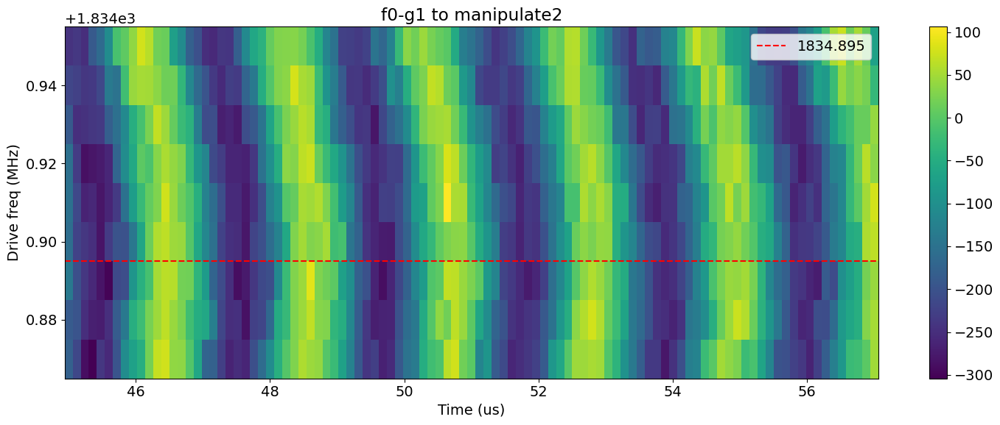

In [31]:
# file_list = np.arange(76,85,1)
#file_list = np.arange(5,24,1)
file_list = np.arange(105,110,1)
#file_list = np.concatenate((np.arange(49,53,1), np.arange(42,49,1)))
#file_list = np.arange(269,274,1)
# file_list = np.arange(274,281,1)
# file_list = np.arange(371,383,1)
# file_list = np.arange(384,389,1)
file_list = np.arange(389,398,1)
y_list = []
freq_list = []
name = '_length_rabi_f0g1_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['freq'])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1834.895], vlines=None, title="f0-g1 to manipulate2")
    

## RF flux Spectroscopy


### M1 general spectroscopy

Found peak in amps at [MHz] 445.51508833236215, HWHM -165.5594385061441
Found peak in I at [MHz] 451.05044593572075, HWHM -0.019207851888481633
Found peak in Q at [MHz] 443.78423523269544, HWHM -0.00021480358550198873


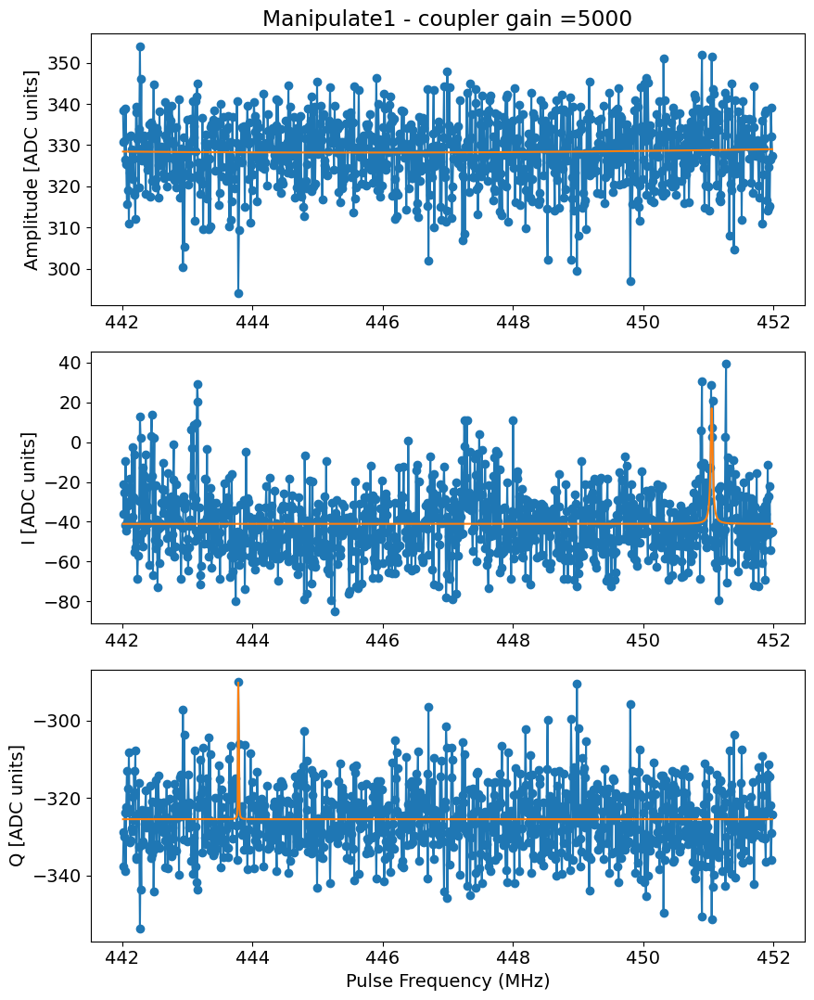

In [88]:
temp_data, attrs = prev_data(expt_path, '00020_FluxSpectroscopyF0g1Experiment.h5')
#temp_data, attrs = prev_data(expt_path, '00122_fluxspectroscopy_f0g1_dc_flux_sweep.h5')

qubit_spectroscopy_display(temp_data, title='Manipulate1 - coupler gain =' + str(attrs['config']['expt']['flux_drive'][2]), vlines=None)
# gain from attrs
#attrs['config']['flux_drive'][2]
#draw vertical lines
# plt.axvline(830, c='k', ls='--')

Found peak in amps at [MHz] 1981.085787223156, HWHM 21.714194394973433
Found peak in I at [MHz] 1981.7895420734933, HWHM -21.765812889308172
Found peak in Q at [MHz] 1981.023470739852, HWHM 25.02922731235247


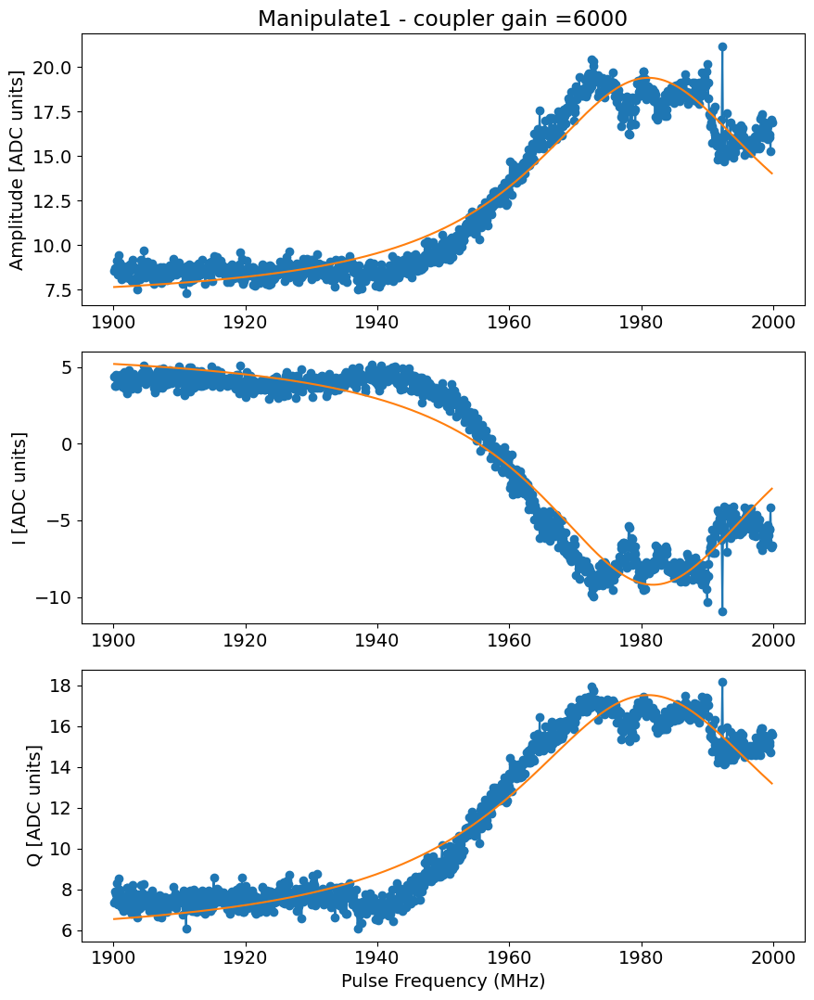

In [85]:
temp_data, attrs = prev_data(expt_path, '00042_FluxSpectroscopyF0g1Experiment.h5')
#temp_data, attrs = prev_data(expt_path, '00122_fluxspectroscopy_f0g1_dc_flux_sweep.h5')

qubit_spectroscopy_display(temp_data, title='Manipulate1 - coupler gain =' + str(attrs['config']['expt']['flux_drive'][2]), vlines=[])
# gain from attrs
#attrs['config']['flux_drive'][2]
#draw vertical lines
# plt.axvline(830, c='k', ls='--')

In [1035]:
attrs['config']['expt']

{'start': 100,
 'step': 0.5,
 'expts': 2000,
 'reps': 1000,
 'qubit': [0],
 'flux_drive': ['low', 337.5, 500, 1.0],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.1063715816226, 3425.0265059169296, 0, 2005.3],
  [3365, 2579, 0, 3000],
  [0.0, 0.0, 0.01, 0.7372316740019226],
  [0, 0, 0, 0],
  [2, 2, 5, 5],
  ['gaussian', 'gaussian', 'flat_top', 'flat_top'],
  [0.03, 0.03, 0.005, 0.005]],
 'post_sweep_pulse': [[2005.3],
  [3000],
  [0.7372316740019226],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'frequency': 1099.5}

Found peak in amps at [MHz] 174.27212959076726, HWHM 0.196826792463268
Found peak in I at [MHz] 174.2729860861592, HWHM 0.15580083777554996
Found peak in Q at [MHz] 174.26692392518476, HWHM 0.2669424217129615


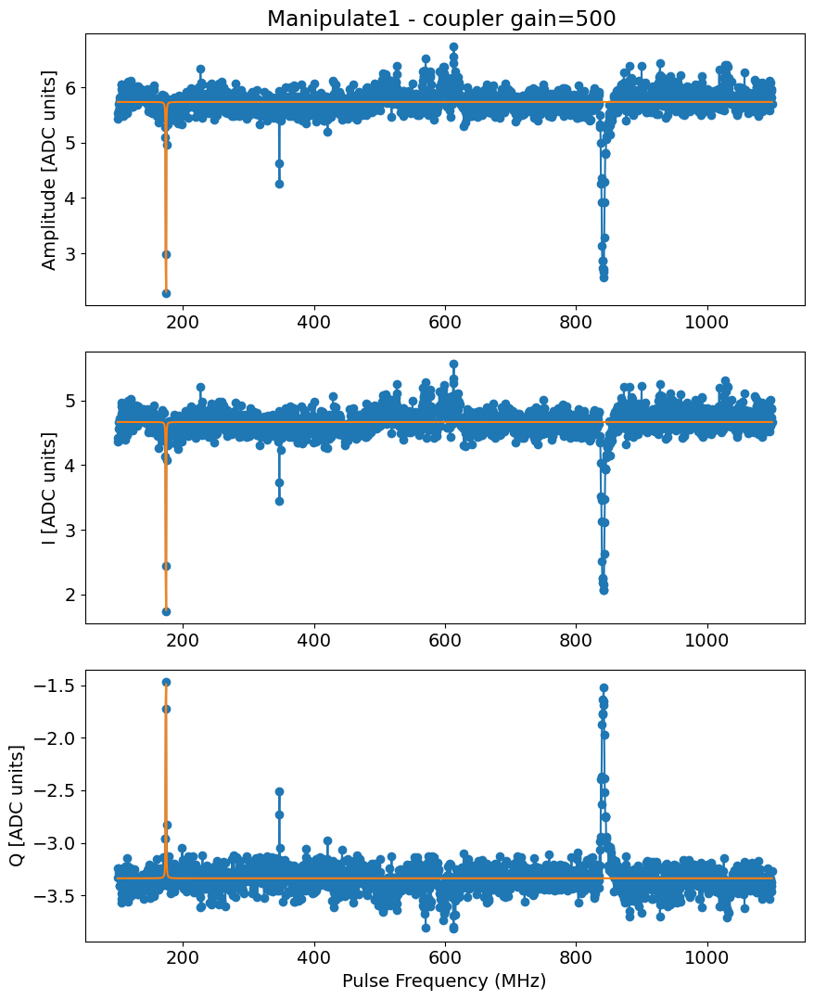

In [1034]:
temp_data, attrs = prev_data(expt_path, '00020_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data, title='Manipulate1 - coupler gain=500 ')

Found peak in amps at [MHz] 1799.6286621562529, HWHM 9.447850425195714
Found peak in I at [MHz] 2173.7941509935013, HWHM 64.62890883586617
Found peak in Q at [MHz] 2582.6935387430017, HWHM 1.7736774326962637


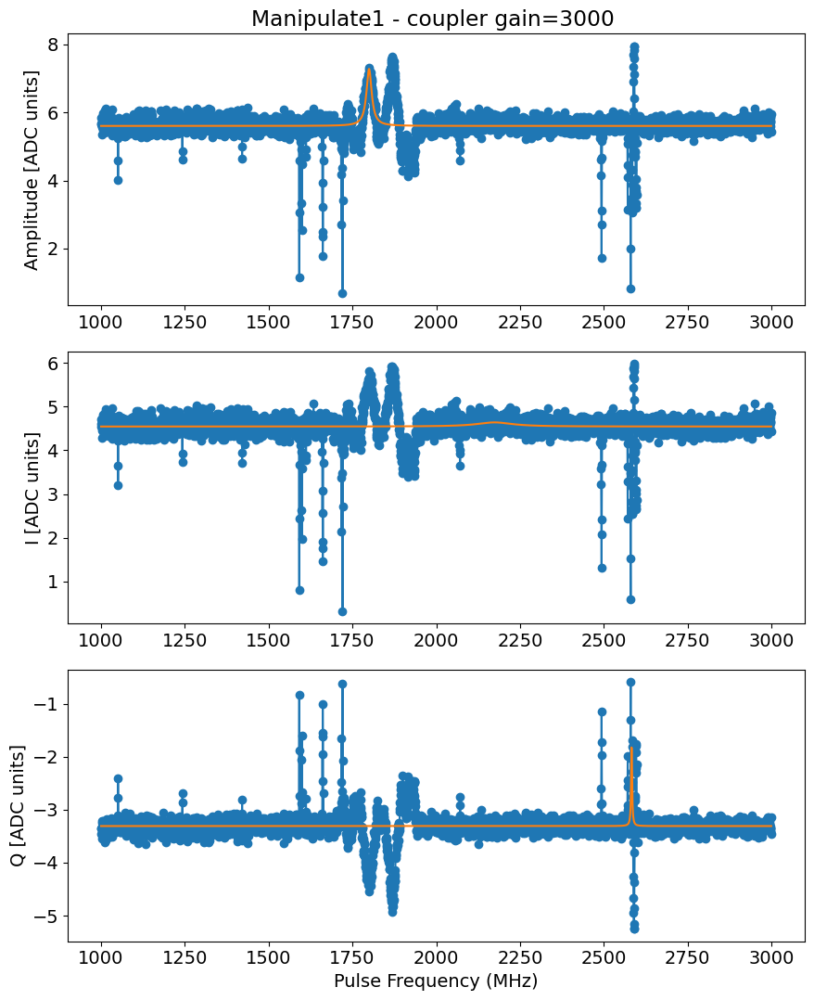

In [555]:
temp_data, attrs = prev_data(expt_path, '00019_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data, title='Manipulate1 - coupler gain=3000 ')

Found peak in amps at [MHz] 174.27212959076726, HWHM 0.196826792463268
Found peak in I at [MHz] 174.2729860861592, HWHM 0.15580083777554996
Found peak in Q at [MHz] 174.26692392518476, HWHM 0.2669424217129615


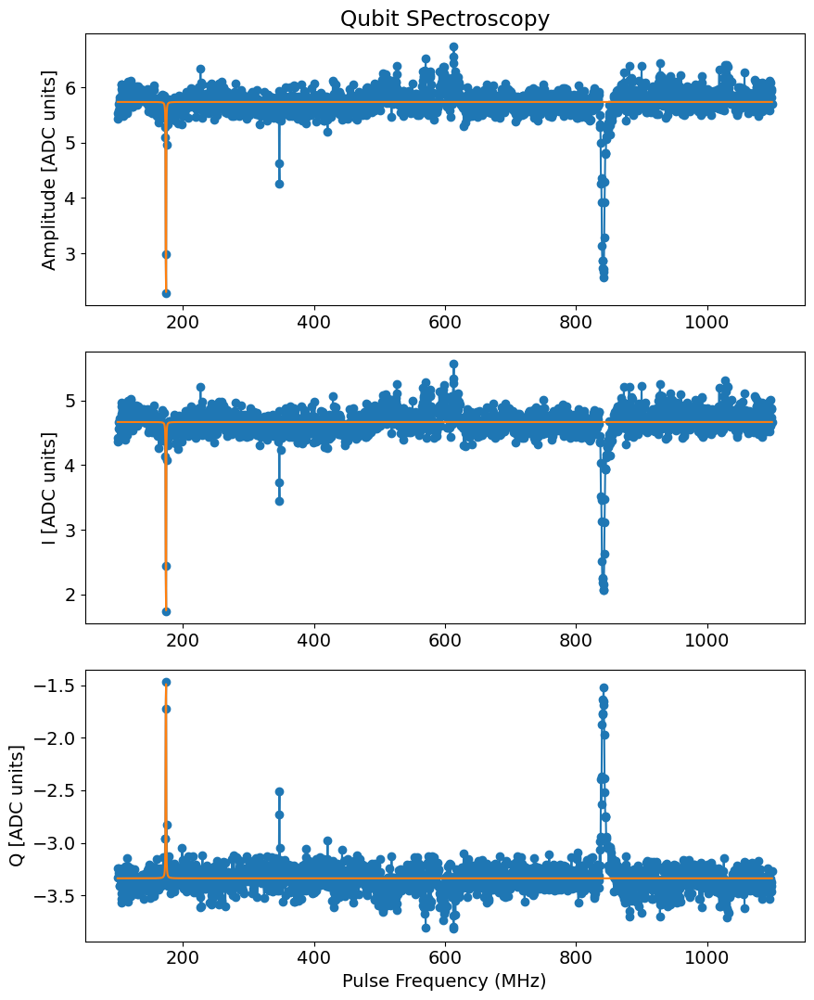

In [560]:
temp_data, attrs = prev_data(expt_path, '00020_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

Found peak in amps at [MHz] 653.9330963480666, HWHM 10.687798388392443
Found peak in I at [MHz] 654.2410013274612, HWHM 11.07514962234971
Found peak in Q at [MHz] 653.7472382866919, HWHM -11.667852565739631


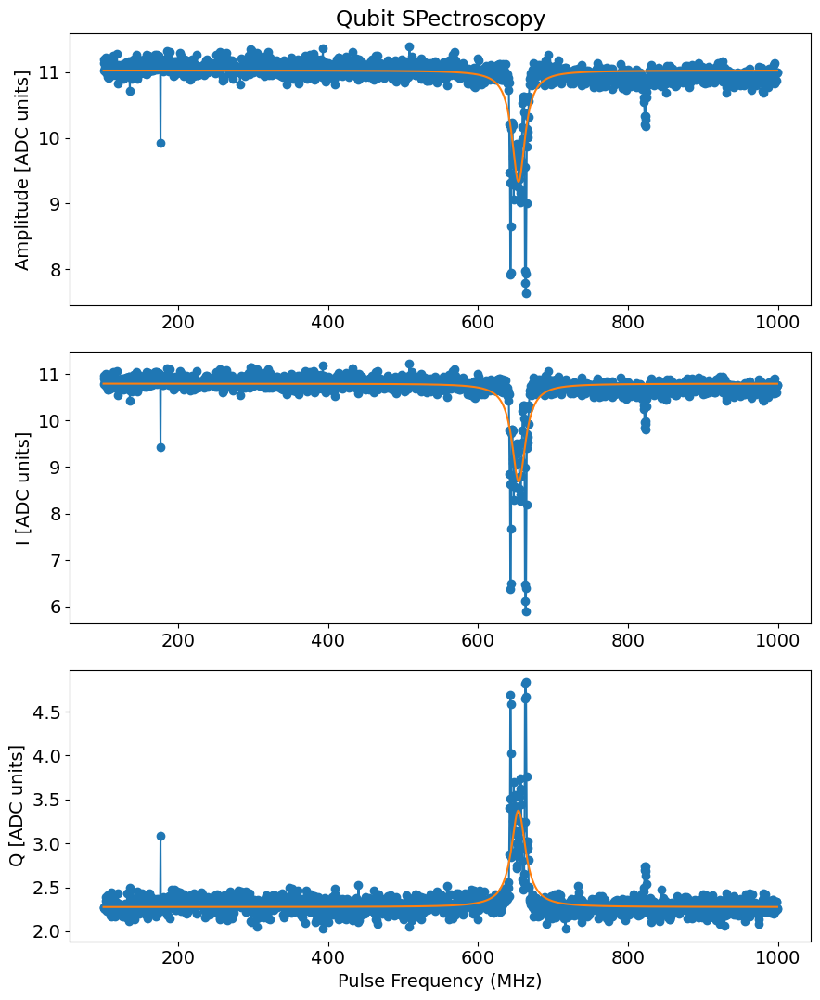

In [448]:
temp_data, attrs = prev_data(expt_path, '00078_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

Found peak in amps at [MHz] 654.0172800622435, HWHM -12.416050564056174
Found peak in I at [MHz] 654.2053479218221, HWHM -12.82689805779113
Found peak in Q at [MHz] 653.6248168900119, HWHM 13.409111869624656


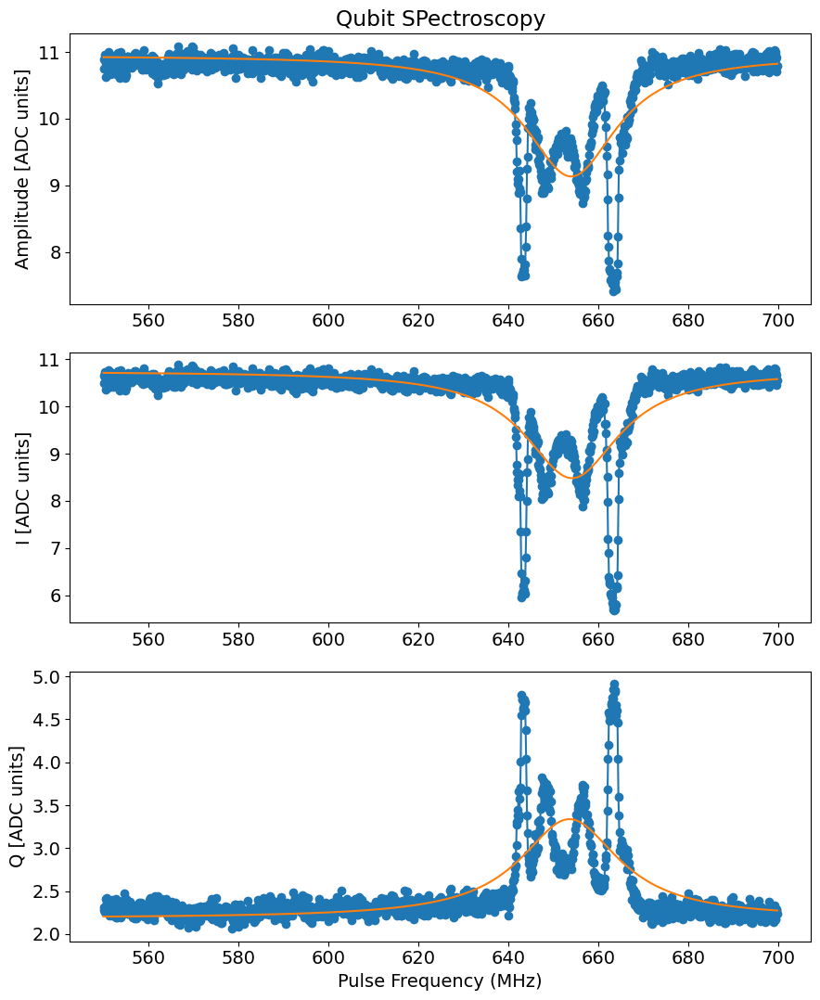

In [451]:
temp_data, attrs = prev_data(expt_path, '00081_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

Found peak in amps at [MHz] 3587.3903974524546, HWHM -707.3633261030079
Found peak in I at [MHz] 3562.6599782866824, HWHM 659.6034768401165
Found peak in Q at [MHz] 4118.35480851369, HWHM 4.075430684715641


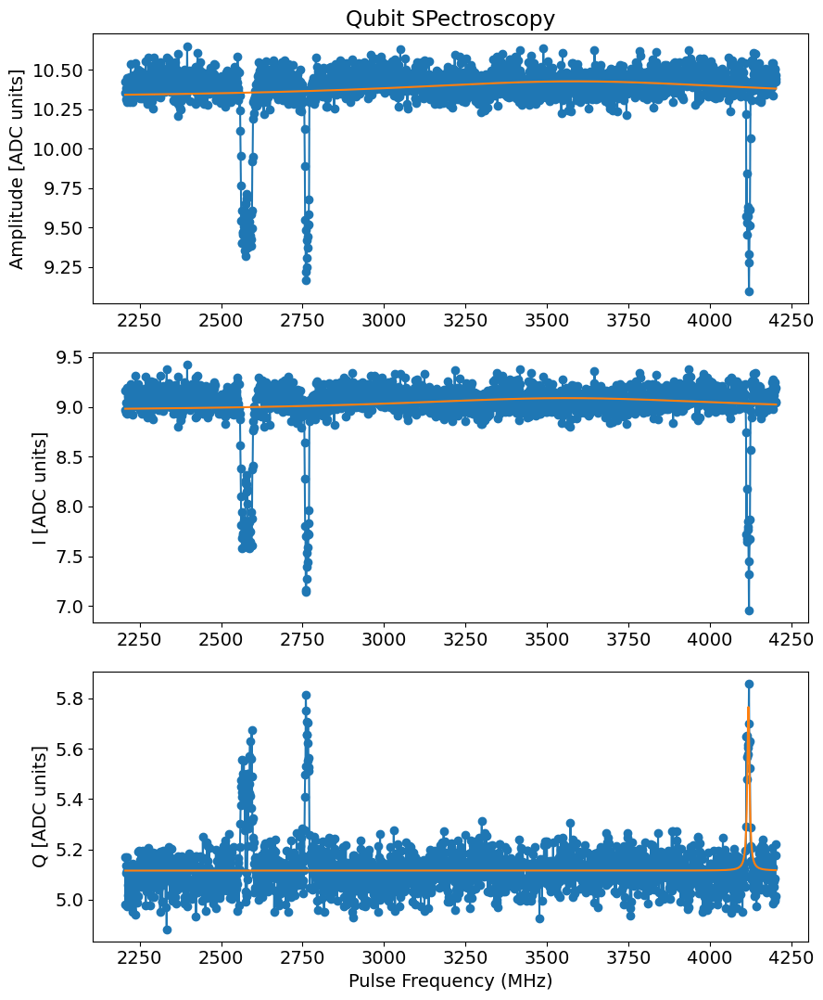

In [485]:
temp_data, attrs = prev_data(expt_path, '00101_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M2 general spectroscopy

Found peak in amps at [MHz] 2094.0708591794487, HWHM -0.21642966963775123
Found peak in I at [MHz] 2094.075824602282, HWHM 0.22859333358493783
Found peak in Q at [MHz] 2094.0777002857412, HWHM -0.2453389989657774


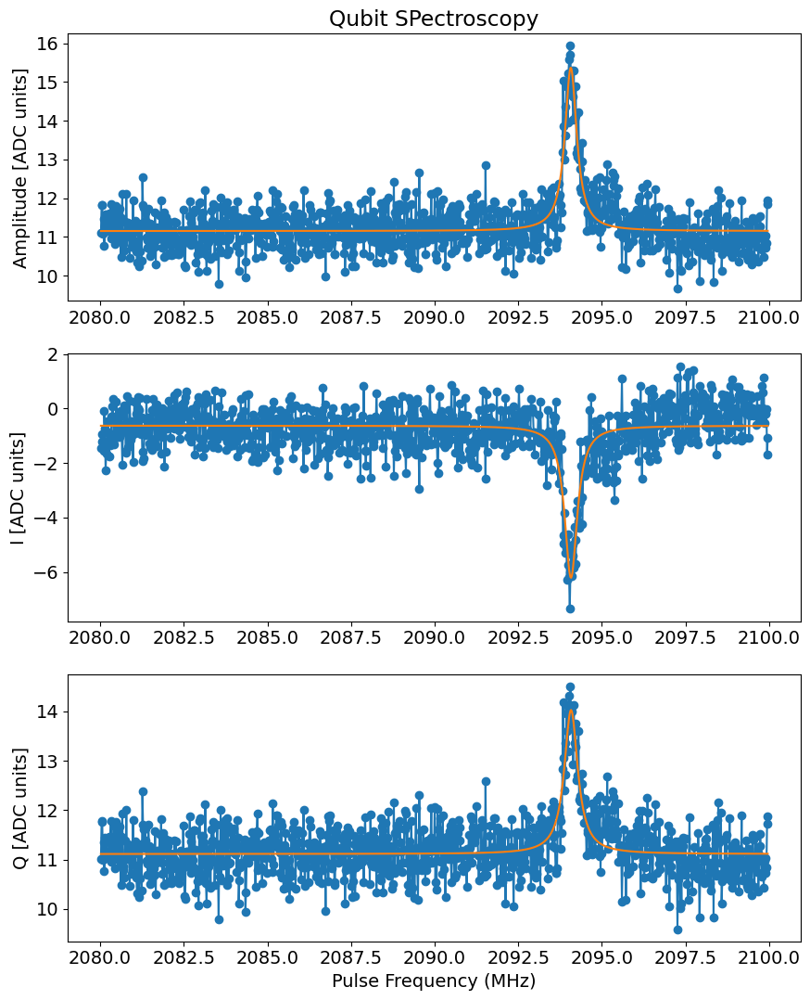

In [976]:
temp_data, attrs = prev_data(expt_path, '00100_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

In [450]:
attrs['config']['expt']

{'start': 160,
 'step': 0.03,
 'expts': 1000,
 'reps': 500,
 'qubit': [0],
 'flux_drive': ['low', 400, 4000, 1],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.1584505031587, 3425.5630733276303, 0, 1834.375],
  [13344, 10300, 0, 20000],
  [0.0, 0.0, 0.01, 0.984364609],
  [0, 0, 0, 0],
  [2, 2, 5, 5],
  ['gaussian', 'gaussian', 'flat_top', 'flat_top'],
  [0.025, 0.025, 0.005, 0.005]],
 'post_sweep_pulse': [[1834.375],
  [20000],
  [0.984364609],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'frequency': 189.97}

Found peak in amps at [MHz] 2219.277291246798, HWHM -1.0113258314599214
Found peak in I at [MHz] 2219.287585967369, HWHM -0.8887395882898752
Found peak in Q at [MHz] 2219.2973695312494, HWHM 0.8528553523203494


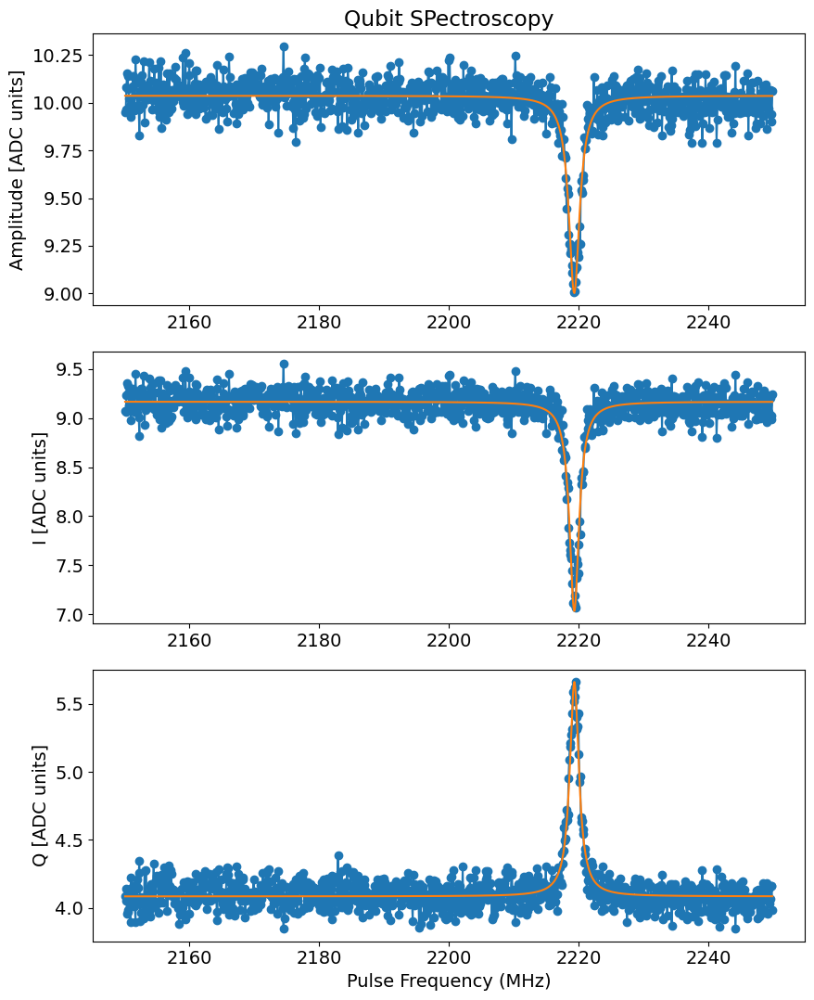

In [470]:
temp_data, attrs = prev_data(expt_path, '00090_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

Found peak in amps at [MHz] 2579.2027454244303, HWHM -13.94262656571863
Found peak in I at [MHz] 2579.0935571758528, HWHM -13.789009428159849
Found peak in Q at [MHz] 2579.1444010125756, HWHM 13.997480136466274


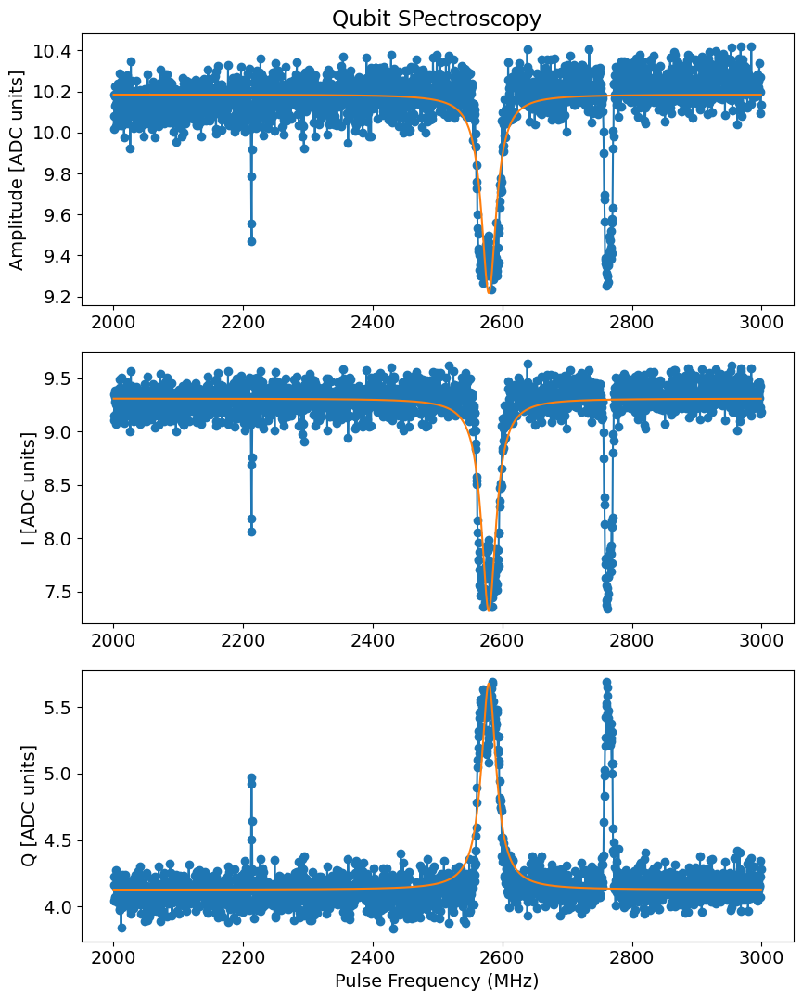

In [464]:
temp_data, attrs = prev_data(expt_path, '00087_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

Found peak in amps at [MHz] 619.8271960847708, HWHM 20.491604615576744
Found peak in I at [MHz] 619.4376008119117, HWHM 20.597174140188987
Found peak in Q at [MHz] 619.7266189842735, HWHM -21.967132128388204


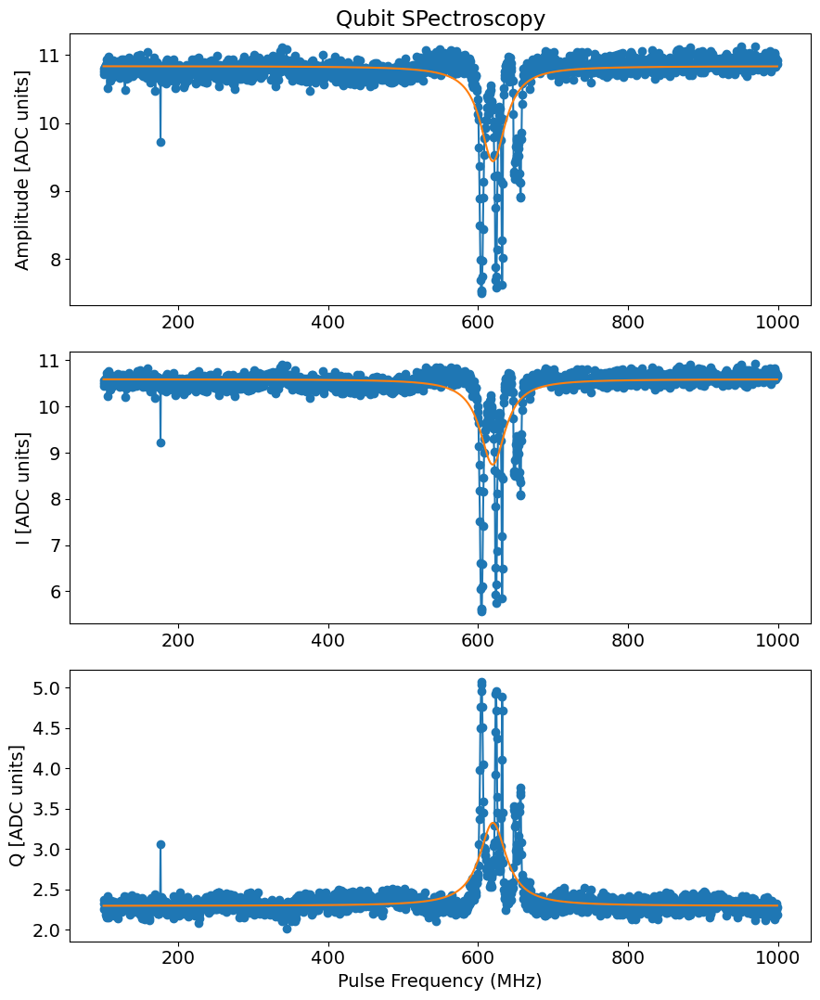

In [449]:
temp_data, attrs = prev_data(expt_path, '00079_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

Found peak in amps at [MHz] 621.6361177538008, HWHM 34.61783702048996
Found peak in I at [MHz] 621.0790362006613, HWHM 33.14782429661215
Found peak in Q at [MHz] 622.128351915104, HWHM 36.273288790965886


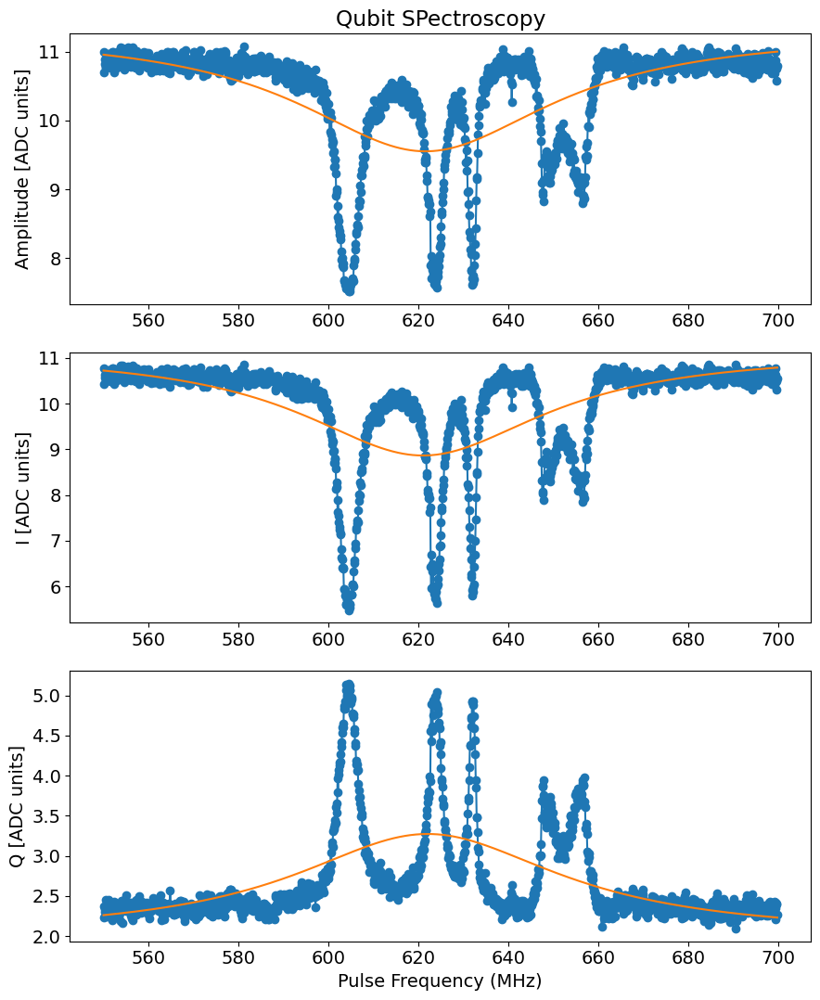

In [450]:
temp_data, attrs = prev_data(expt_path, '00080_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M1-M2 spectroscopy

Found peak in amps at [MHz] 173.59313231091699, HWHM 3.9882590065994403
Found peak in I at [MHz] 173.58203116240244, HWHM 4.410267145127236
Found peak in Q at [MHz] 173.63041912121906, HWHM 4.473939131784318


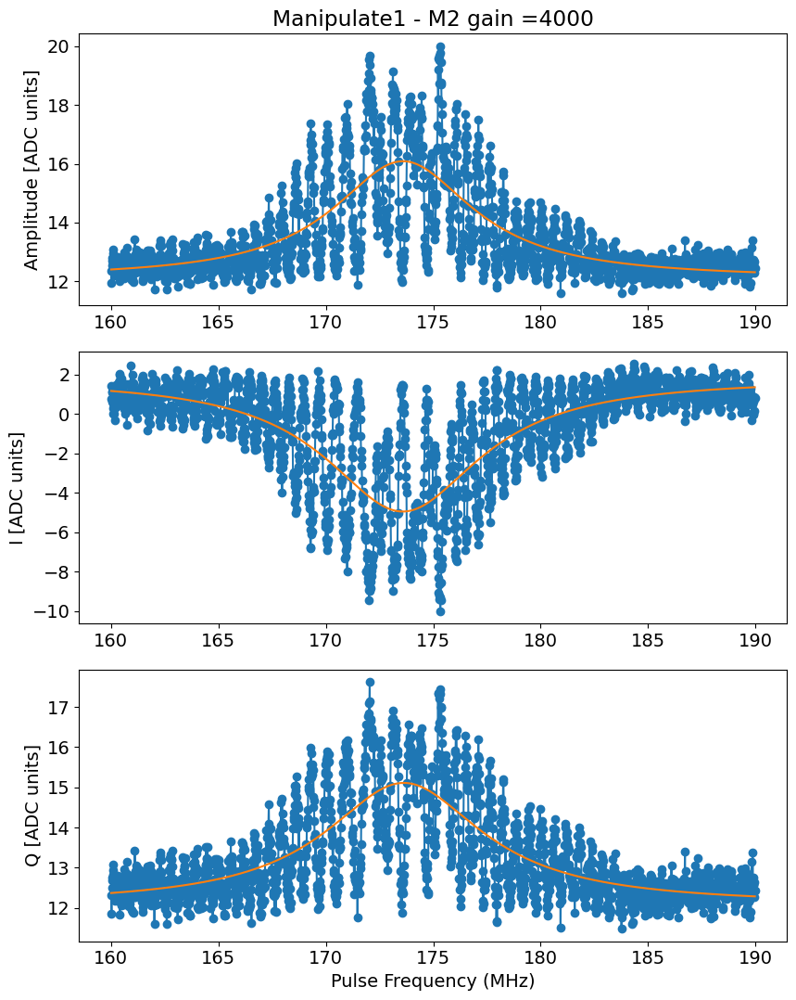

In [38]:
temp_data, attrs = prev_data(expt_path, '00012_FluxSpectroscopyF0g1Experiment.h5')
#temp_data, attrs = prev_data(expt_path, '00122_fluxspectroscopy_f0g1_dc_flux_sweep.h5')

qubit_spectroscopy_display(temp_data, title='Manipulate1 - M2 gain =' + str(attrs['config']['expt']['flux_drive'][2]), vlines=[])
# gain from attrs
#attrs['config']['flux_drive'][2]
#draw vertical lines
# plt.axvline(830, c='k', ls='--')

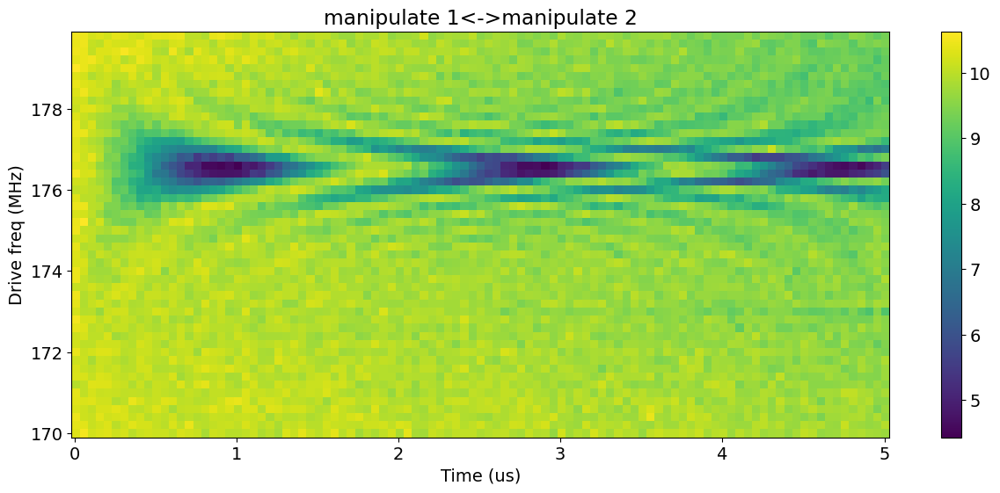

In [281]:
file_list = np.arange(847,897,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=None, vlines=None, title="manipulate 1<->manipulate 2")
    

### M1-S1 spectroscopy

Found peak in amps at [MHz] 348.8020226604854, HWHM 1.7873242166568597
Found peak in I at [MHz] 348.87303333853225, HWHM 1.7497889215423574
Found peak in Q at [MHz] 348.7871234188779, HWHM 1.7736173349497422


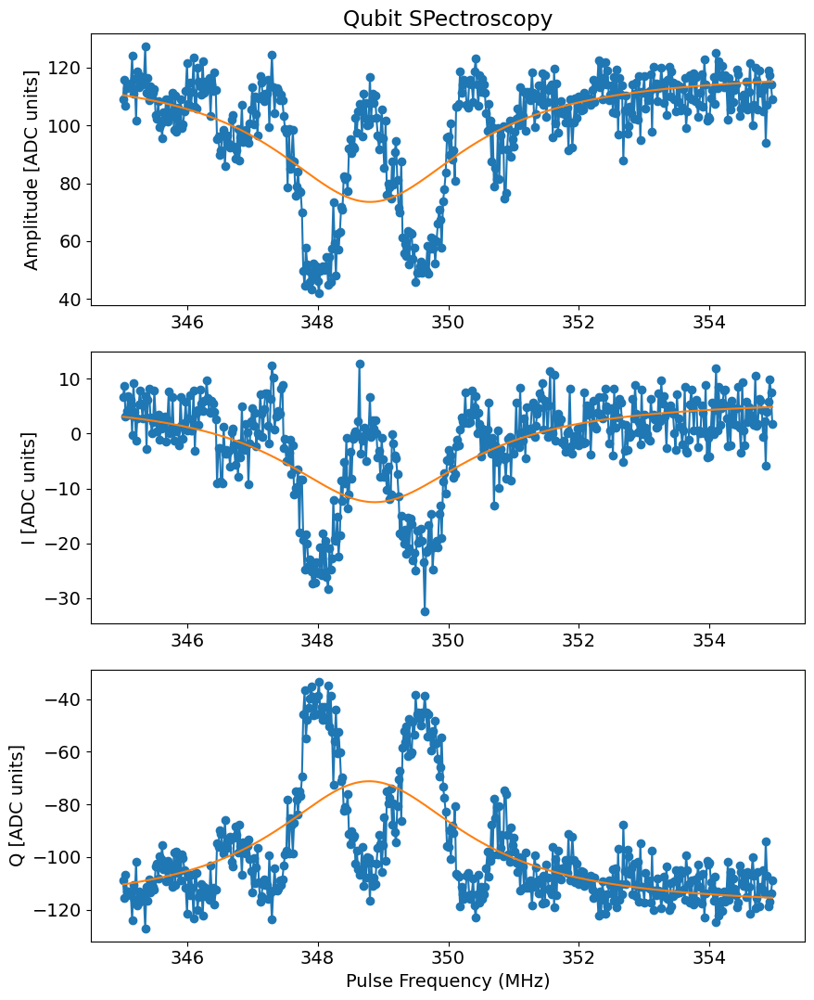

In [13]:
temp_data, attrs = prev_data(expt_path, '00009_FluxSpectroscopyF0g1Experiment.h5')

qubit_spectroscopy_display(temp_data)

In [28]:
expt_path

'H:\\Shared drives\\SLab\\Multimode\\experiment\\250307_qsim\\data'

In [161]:
attrs['config']['expt']

{'start': 330,
 'step': 0.1,
 'expts': 100,
 'reps': 1000,
 'qubit': [0],
 'flux_drive': ['high', 337.5, 1000, 2],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.107150615436, 3425.0250576126327, 0, 1994.7],
  [7203, 2585, 0, 2000],
  [0.0, 0.0, 0.01, 1.1027260782489923],
  [0, 0, 0, 0],
  [2, 2, 5, 5],
  ['gaussian', 'gaussian', 'flat_top', 'flat_top'],
  [0.015, 0.08405005321695154, 0.005, 0.005]],
 'post_sweep_pulse': [[1994.7],
  [2000],
  [1.1027260782489923],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'frequency': 339.9}

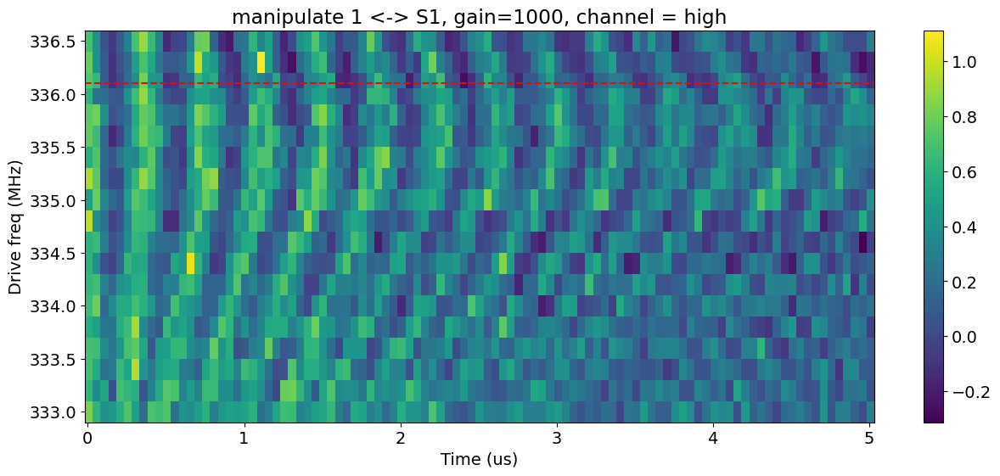

In [260]:
file_list = np.concatenate((np.arange(223,233,1) , np.arange(217,223,1), np.arange(233,236,1)))
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[336.1], vlines=[], title="manipulate 1 <-> S1, gain=1000, channel = high")

Found peak in amps at [MHz] 172.30088248590968, HWHM 0.08805160870833008
Found peak in I at [MHz] 172.30216615140478, HWHM -0.08367614133513425
Found peak in Q at [MHz] 172.30383519397222, HWHM 0.08840494825091892


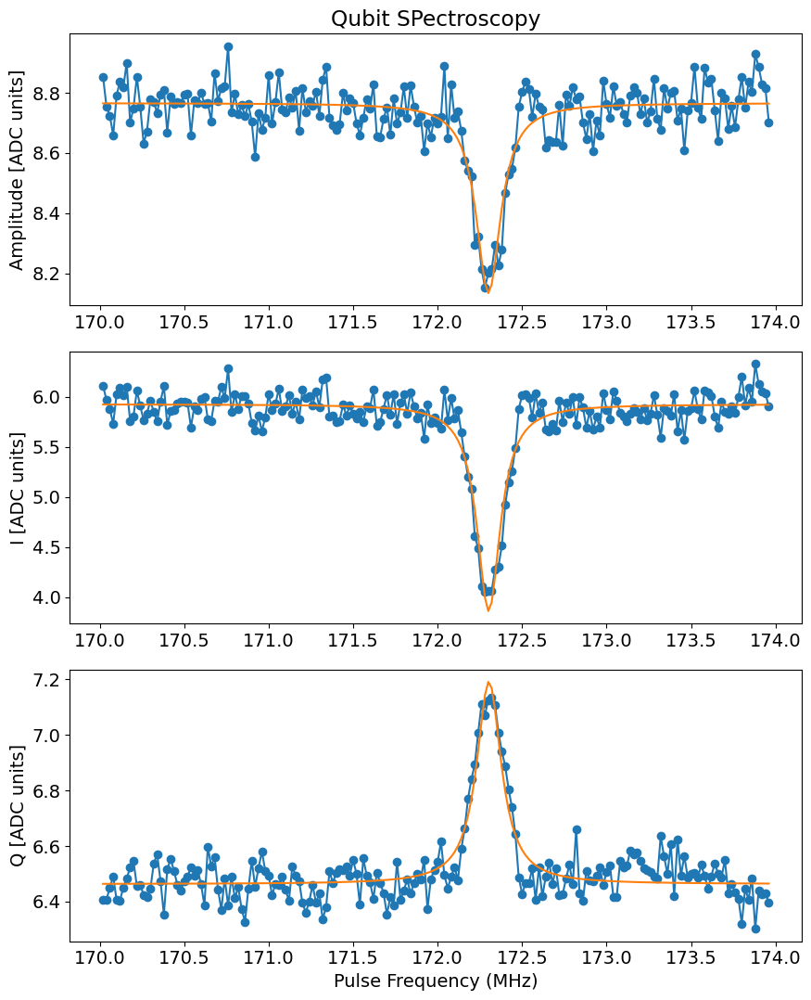

In [359]:
temp_data, attrs = prev_data(expt_path, '00061_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M1-S2 spectroscopy

Found peak in amps at [MHz] 520.6236157065886, HWHM -0.22681191407961193
Found peak in I at [MHz] 520.6271927575292, HWHM -0.31993884045462934
Found peak in Q at [MHz] 520.6310387667507, HWHM -0.3208597231980227


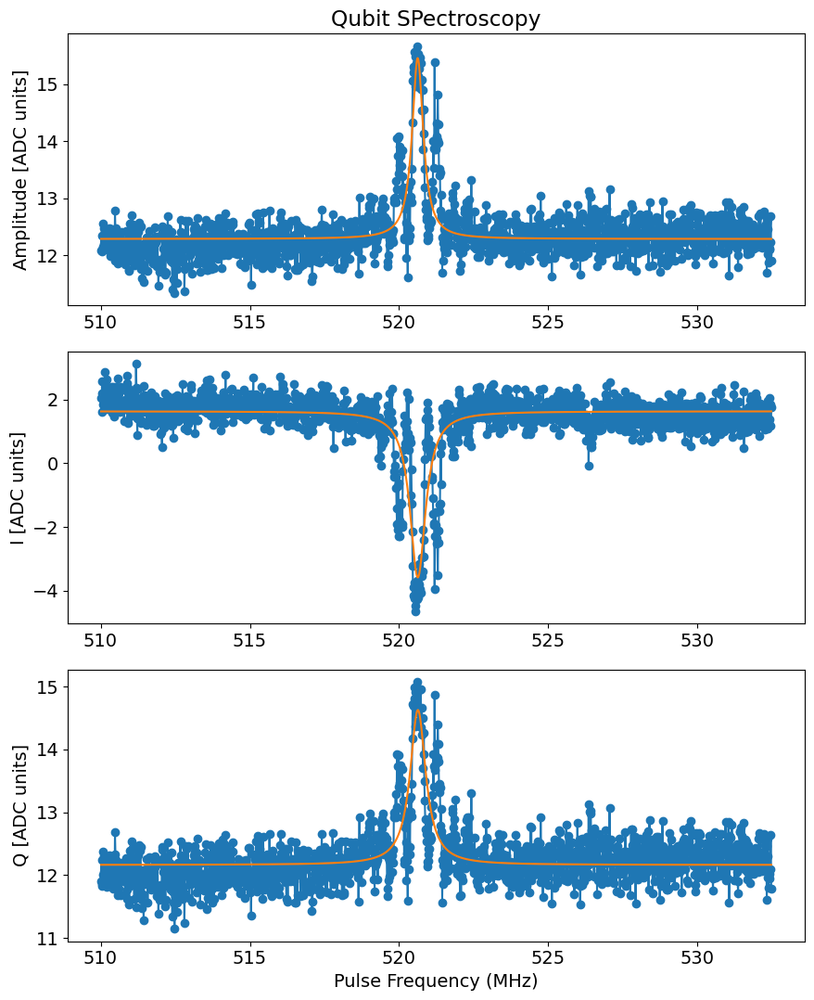

In [41]:
temp_data, attrs = prev_data(expt_path, '00015_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M1-S3 spectroscopy

Found peak in amps at [MHz] 1422.9602454851845, HWHM 0.2822136266861705
Found peak in I at [MHz] 1422.9429411604967, HWHM -0.3511433746593163
Found peak in Q at [MHz] 1422.9679051284372, HWHM -0.3542862379314972


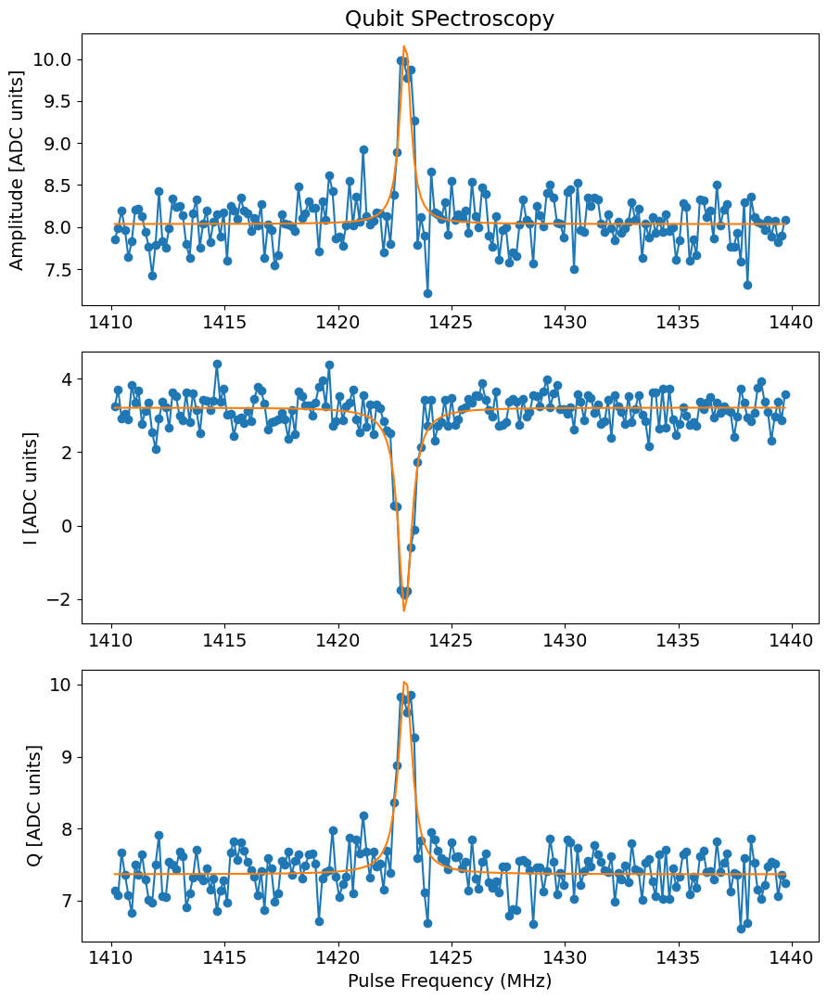

In [29]:
temp_data, attrs = prev_data(expt_path, '00012_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

In [30]:
attrs['config']['expt']

{'start': 1410,
 'step': 0.15,
 'expts': 200,
 'reps': 500,
 'qubit': [0],
 'flux_drive': ['high', 400, 5000, 1],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.187817769269, 3425.557033831784, 2006.76],
  [9653, 7575, 15000],
  [0, 0, 0.6151067375075144],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2006.76],
  [15000],
  [0.6151067375075144],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'frequency': 1439.85}

### M1-S4 spectroscopy

Found peak in amps at [MHz] 873.0347466828171, HWHM 2.0211278688442595
Found peak in I at [MHz] 873.0219186192658, HWHM 1.963382245831401
Found peak in Q at [MHz] 873.0889331266528, HWHM 2.214497842037753


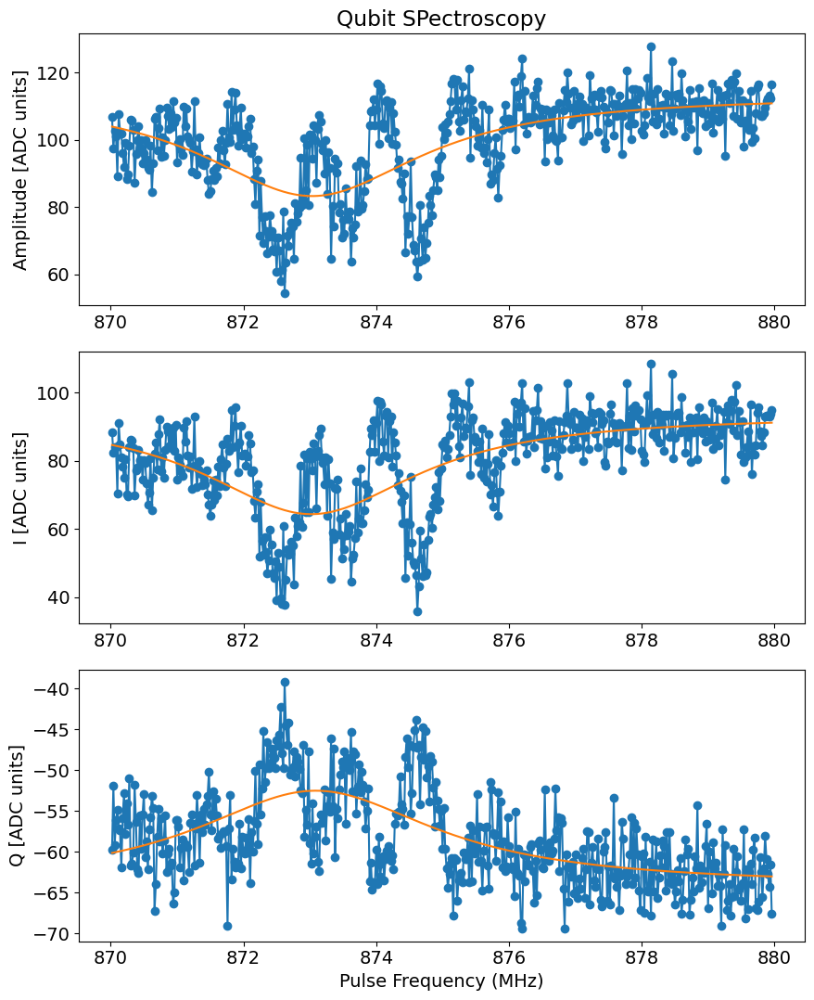

In [10]:
temp_data, attrs = prev_data(expt_path, '00008_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

In [18]:
attrs['config']['expt']

{'start': 1650,
 'step': 0.03,
 'expts': 500,
 'reps': 500,
 'qubit': [0],
 'flux_drive': ['high', 400, 8000, 1],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.187817769269, 3425.557033831784, 2006.76],
  [9653, 7575, 15000],
  [0, 0, 0.6151067375075144],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2006.76],
  [15000],
  [0.6151067375075144],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'frequency': 1664.97}

### M1-S5 spectroscopy

Found peak in amps at [MHz] 1054.120223568331, HWHM 1.326664811989339
Found peak in I at [MHz] 1054.0649454688032, HWHM 1.296557075676926
Found peak in Q at [MHz] 1054.0816394121364, HWHM 1.3812440854340906


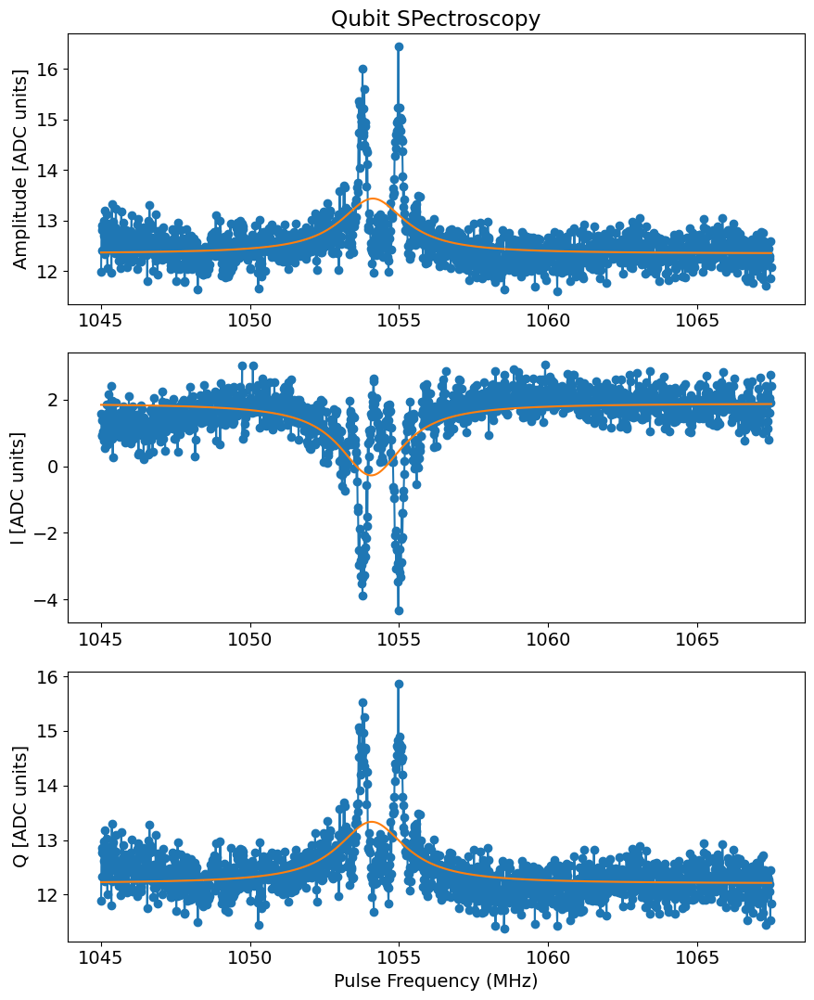

In [51]:
temp_data, attrs = prev_data(expt_path, '00022_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M1-S6 spectroscopy

Found peak in amps at [MHz] 1245.3313293004842, HWHM 0.39795396084897494
Found peak in I at [MHz] 1245.3412399298666, HWHM -0.4396954437311444
Found peak in Q at [MHz] 1245.3574963274157, HWHM 0.4525135507769791


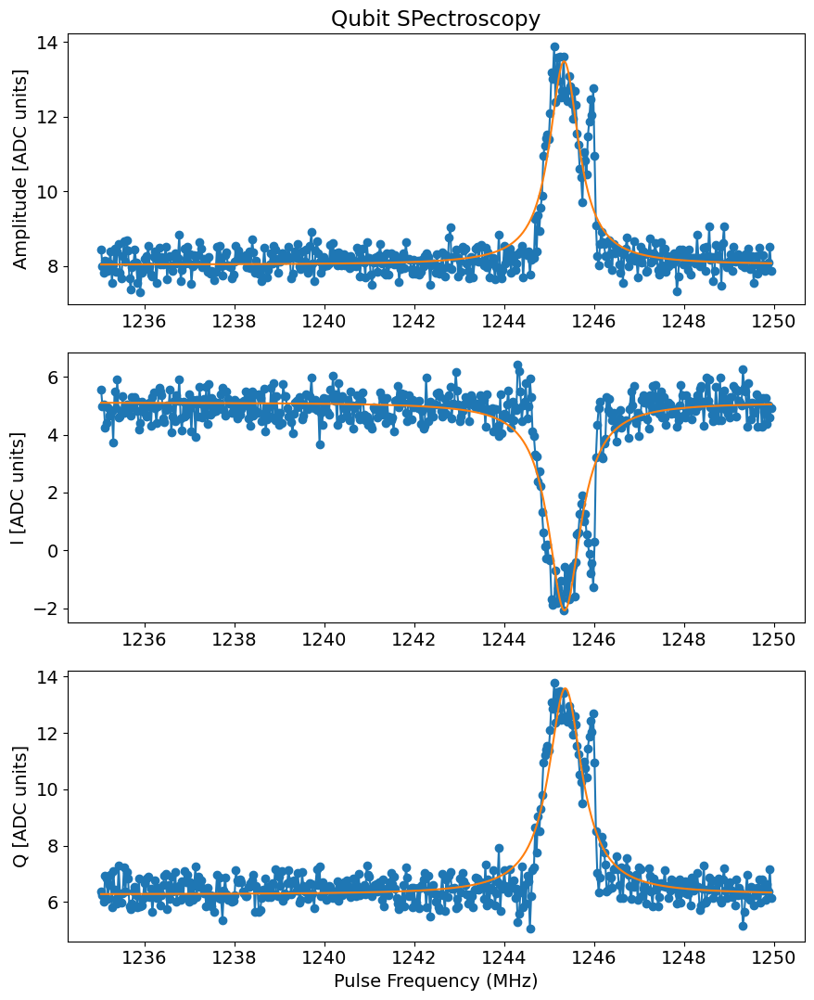

In [109]:
temp_data, attrs = prev_data(expt_path, '00070_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

In [100]:
attrs['config']['expt']

{'start': 1233,
 'step': 0.045,
 'expts': 500,
 'reps': 1000,
 'qubit': [0],
 'flux_drive': ['high', 400, 6000, 2],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.18454806861, 3425.5718094609624, 0, 2006.45],
  [13070, 10144, 0, 15000],
  [0.0, 0.0, 0.01, 0.6124625860870201],
  [0, 0, 0, 0],
  [2, 2, 5, 5],
  ['gaussian', 'gaussian', 'flat_top', 'flat_top'],
  [0.025, 0.025, 0.005, 0.005]],
 'post_sweep_pulse': [[2006.45],
  [15000],
  [0.6124625860870201],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'frequency': 1255.455}

### M1-S7 spectroscopy

Found peak in amps at [MHz] 1422.6941850754367, HWHM 0.46727007455706754
Found peak in I at [MHz] 1422.6838114146767, HWHM 0.46950285653713436
Found peak in Q at [MHz] 1422.6392511629608, HWHM 0.46363603202929443


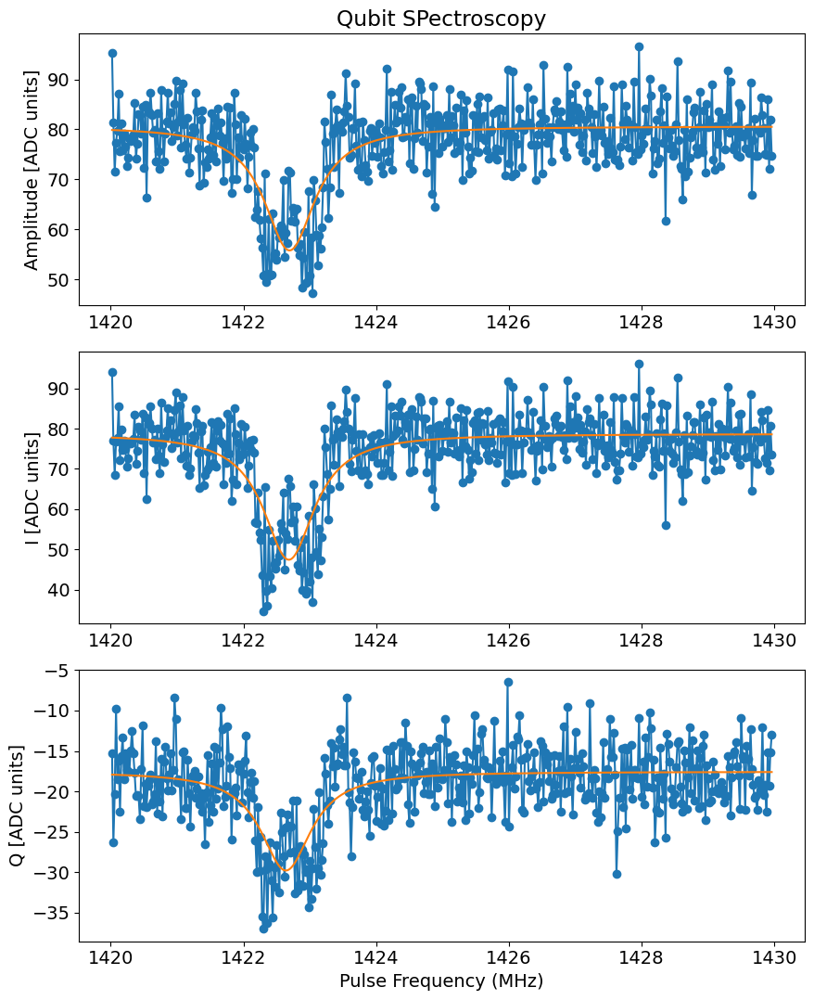

In [42]:
temp_data, attrs = prev_data(expt_path, '00010_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M1-S8 spectroscopy

Found peak in amps at [MHz] 1501.4261567180783, HWHM 66.23324970757915
Found peak in I at [MHz] 1501.3024985521638, HWHM -73.1096640580497
Found peak in Q at [MHz] 1502.5937356817028, HWHM 72.32424325943548


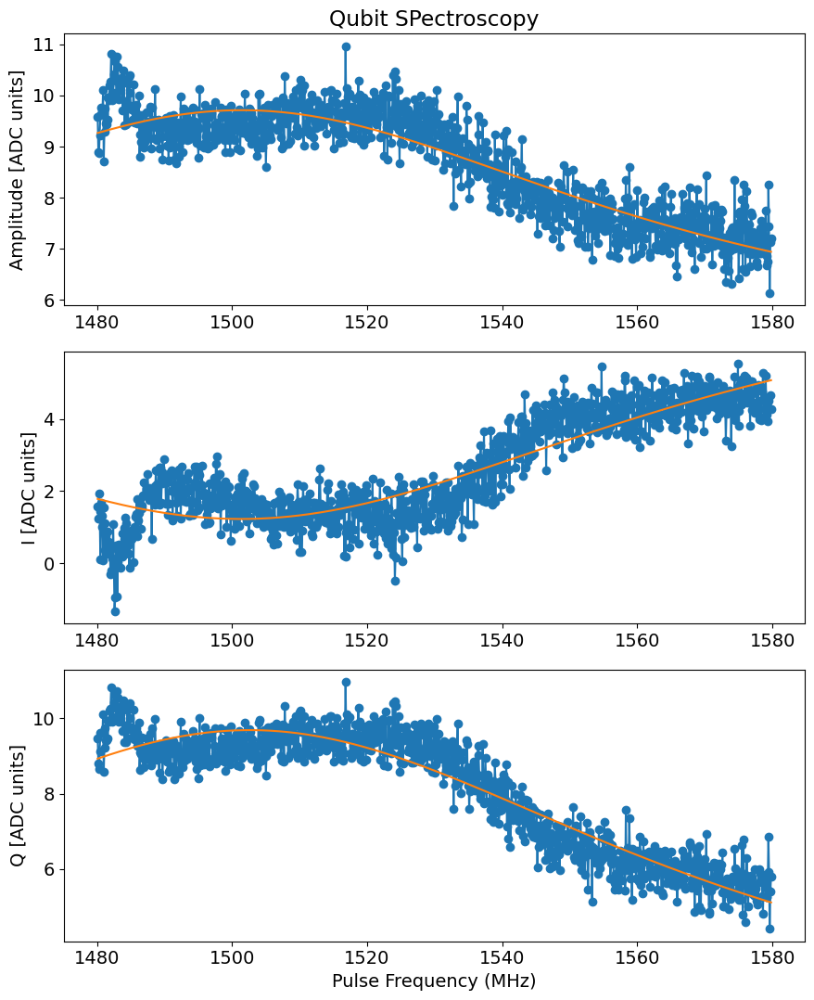

In [515]:
temp_data, attrs = prev_data(expt_path, '00027_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

In [516]:
attrs['config']['expt']

{'start': 1480,
 'step': 0.1,
 'expts': 1000,
 'reps': 500,
 'qubit': [0],
 'flux_drive': ['high', 400, 7500, 1],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.187817769269, 3425.557033831784, 2006.76],
  [9653, 7575, 15000],
  [0, 0, 0.6151067375075144],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2006.76],
  [15000],
  [0.6151067375075144],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'frequency': 1579.9}

In [137]:
attrs['config']['expt']

{'start': 1495,
 'step': 0.1,
 'expts': 200,
 'reps': 500,
 'qubit': [0],
 'flux_drive': ['high', 400, 7500, 1],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.187817769269, 3425.557033831784, 2006.76],
  [9653, 7575, 15000],
  [0, 0, 0.6151067375075144],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2006.76],
  [15000],
  [0.6151067375075144],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'frequency': 1514.9}

### M1-S9 spectroscopy

Found peak in amps at [MHz] 1833.2274884746164, HWHM 17.591611708836684
Found peak in I at [MHz] 1833.2332315610602, HWHM -0.09388897078820613
Found peak in Q at [MHz] 1823.2187013024245, HWHM -1.1073625109462022


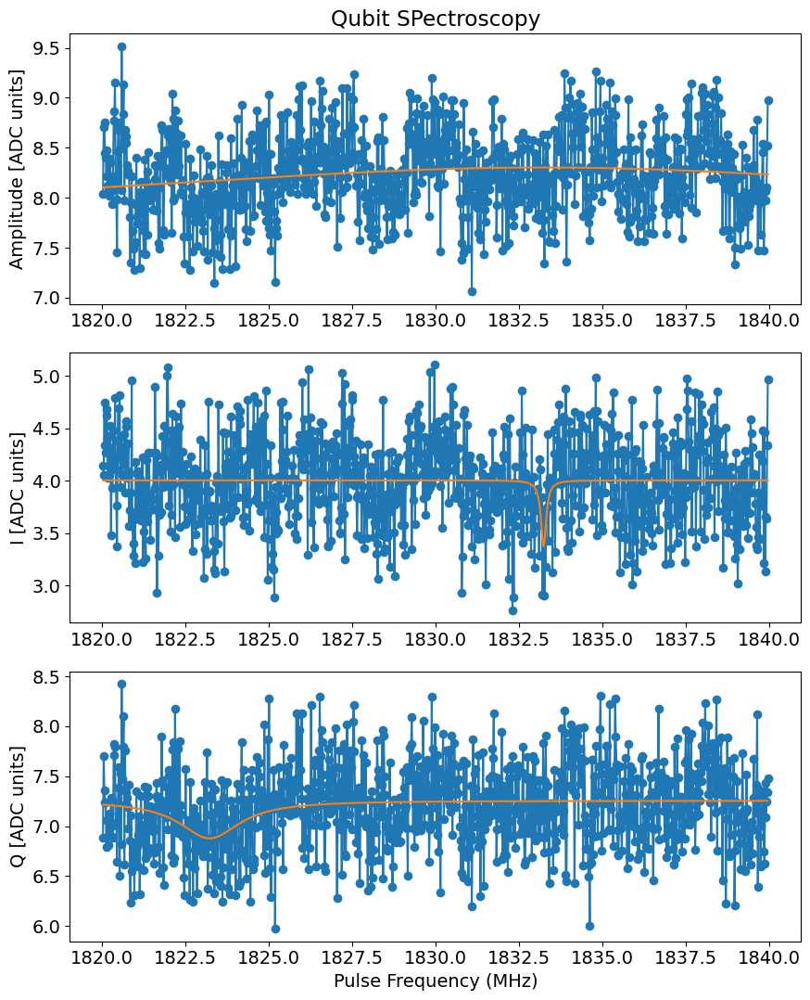

In [86]:
temp_data, attrs = prev_data(expt_path, '00043_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M1-S10 spectroscopy

Found peak in amps at [MHz] 2128.6915327721254, HWHM 387.40052143111575
Found peak in I at [MHz] 2128.5891923020336, HWHM -1309.3164783084492
Found peak in Q at [MHz] 2131.737552230661, HWHM -393.9143708158357


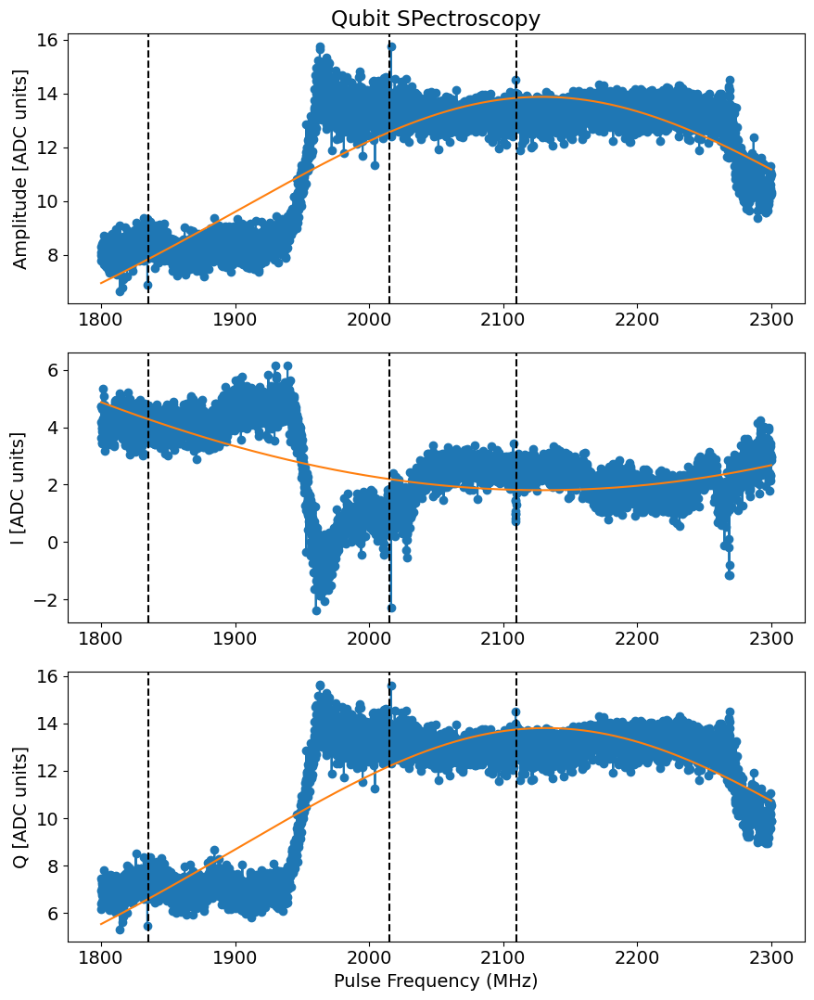

In [71]:
temp_data, attrs = prev_data(expt_path, '00029_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data, vlines=[1835, 2015, 2110])

Found peak in amps at [MHz] 2028.5614941286071, HWHM -1995.4739104169494
Found peak in I at [MHz] 2008.0711369894877, HWHM 4.207352300069871
Found peak in Q at [MHz] 2029.2490671622454, HWHM 2381.938825421368


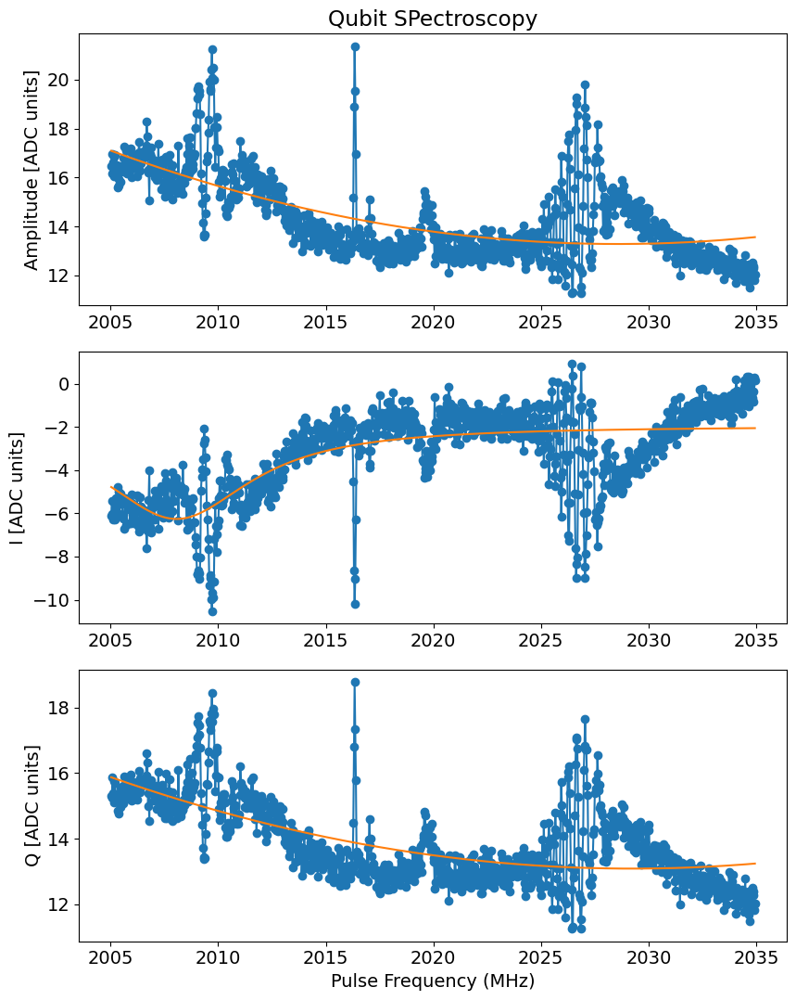

In [73]:
temp_data, attrs = prev_data(expt_path, '00035_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M1-S11 spectroscopy

Found peak in amps at [MHz] 2094.328929029147, HWHM 0.29727943823238717
Found peak in I at [MHz] 2094.331699337278, HWHM 0.37992856276895387
Found peak in Q at [MHz] 2094.323045541596, HWHM 0.33624771291420086


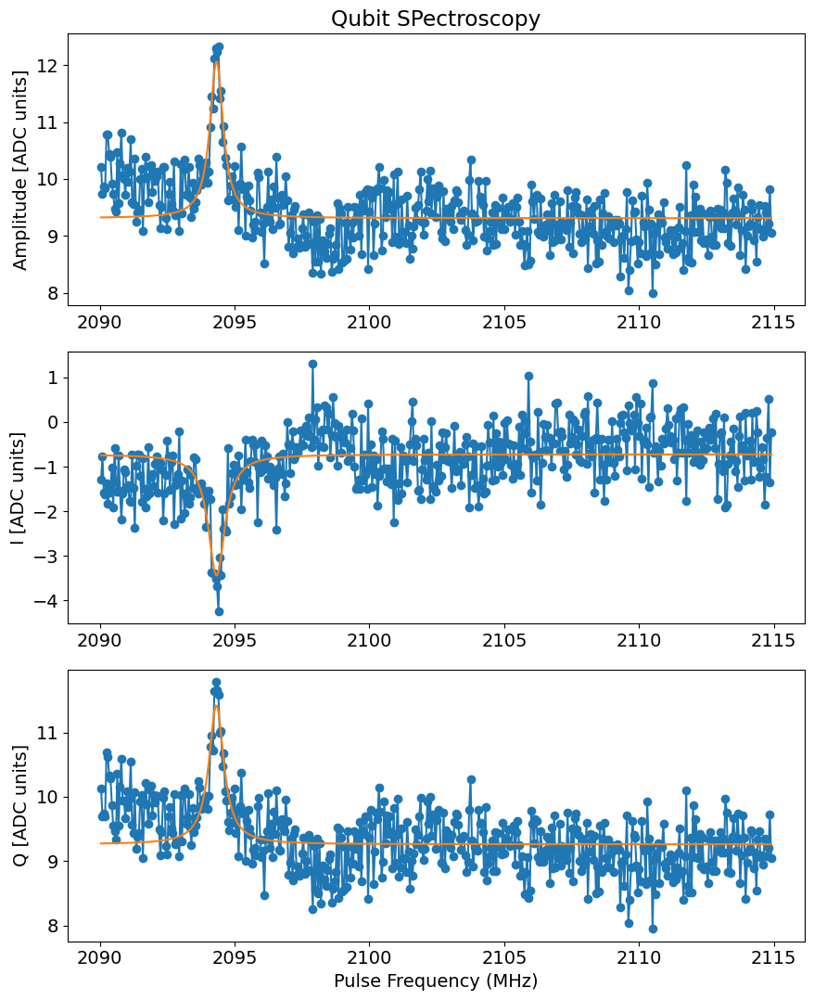

In [152]:
temp_data, attrs = prev_data(expt_path, '00032_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

In [147]:
attrs['config']['expt']

{'start': 2080,
 'step': 0.05,
 'expts': 1000,
 'reps': 500,
 'qubit': [0],
 'flux_drive': ['high', 400, 6000, 2],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.187817769269, 3425.557033831784, 2006.76],
  [9653, 7575, 15000],
  [0, 0, 0.6151067375075144],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2006.76],
  [15000],
  [0.6151067375075144],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'frequency': 2129.95}

### M1-S12 spectroscopy

Found peak in amps at [MHz] 2313.3168705338308, HWHM 0.07730408795798412
Found peak in I at [MHz] 2313.313715900225, HWHM 0.10754518603949366
Found peak in Q at [MHz] 2313.3267709031284, HWHM -0.1111222611759923


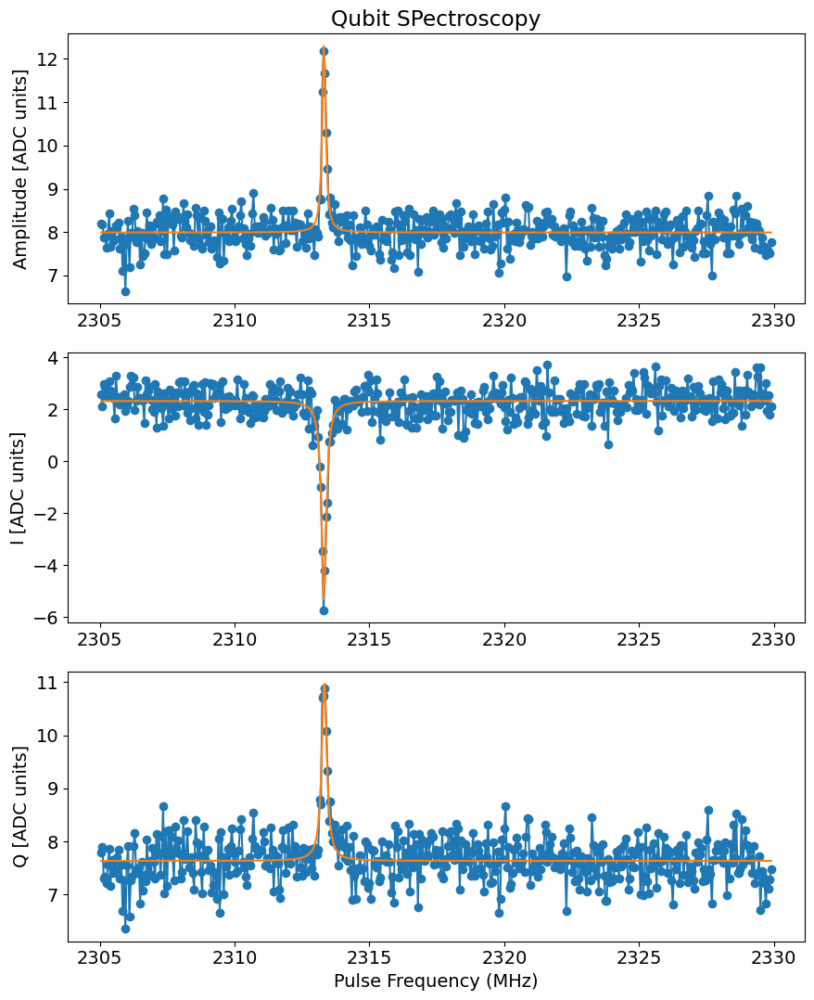

In [540]:
temp_data, attrs = prev_data(expt_path, '00045_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

In [541]:
attrs['config']['expt']

{'start': 2305,
 'step': 0.05,
 'expts': 500,
 'reps': 500,
 'qubit': [0],
 'flux_drive': ['high', 400, 2500, 2],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.182183286917, 3425.55044773984, 2006.76],
  [9653, 7575, 15000],
  [0, 0, 0.6151067375075144],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2006.76],
  [15000],
  [0.6151067375075144],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'frequency': 2329.95}

### M1-S13 spectroscopy

Found peak in amps at [MHz] 2491.9582281523813, HWHM 2.2530134193365865
Found peak in I at [MHz] 2492.0160342274776, HWHM 1.8472838010694852
Found peak in Q at [MHz] 2492.074861385053, HWHM 1.5343063913702764


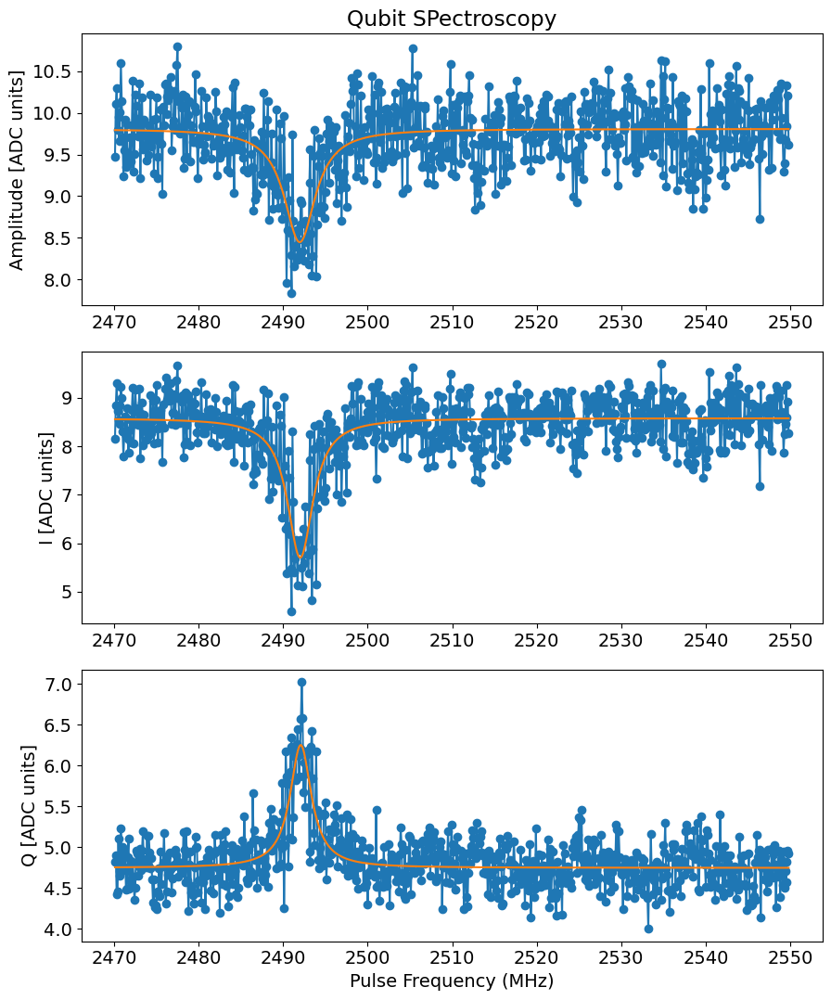

In [629]:
temp_data, attrs = prev_data(expt_path, '00102_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M2-S3 spectroscopy

Found peak in amps at [MHz] 524.018913535424, HWHM -0.46465307793568617
Found peak in I at [MHz] 524.00549149137, HWHM 0.5908746692572369
Found peak in Q at [MHz] 523.992176719951, HWHM 0.6846369439734141


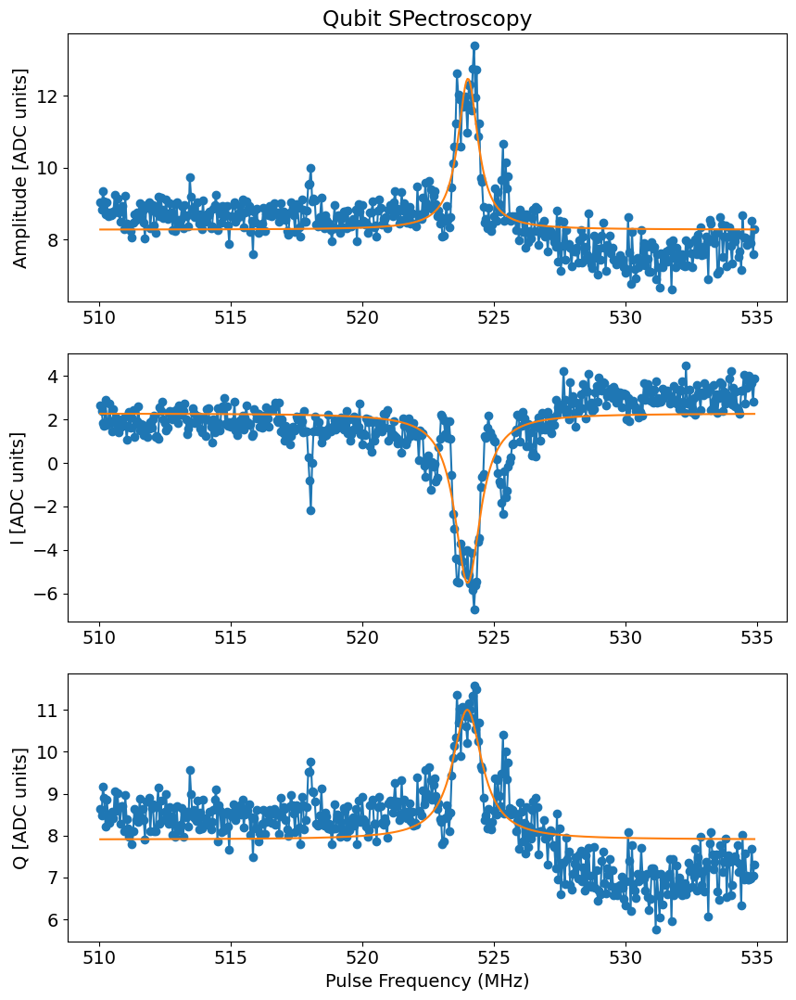

In [32]:
temp_data, attrs = prev_data(expt_path, '00035_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M2 - S4 spectroscopy

Found peak in amps at [MHz] 702.6516876205528, HWHM -0.4334011374723511
Found peak in I at [MHz] 702.631475415811, HWHM -0.45251131695368557
Found peak in Q at [MHz] 702.6460712385534, HWHM -0.47239576794594385


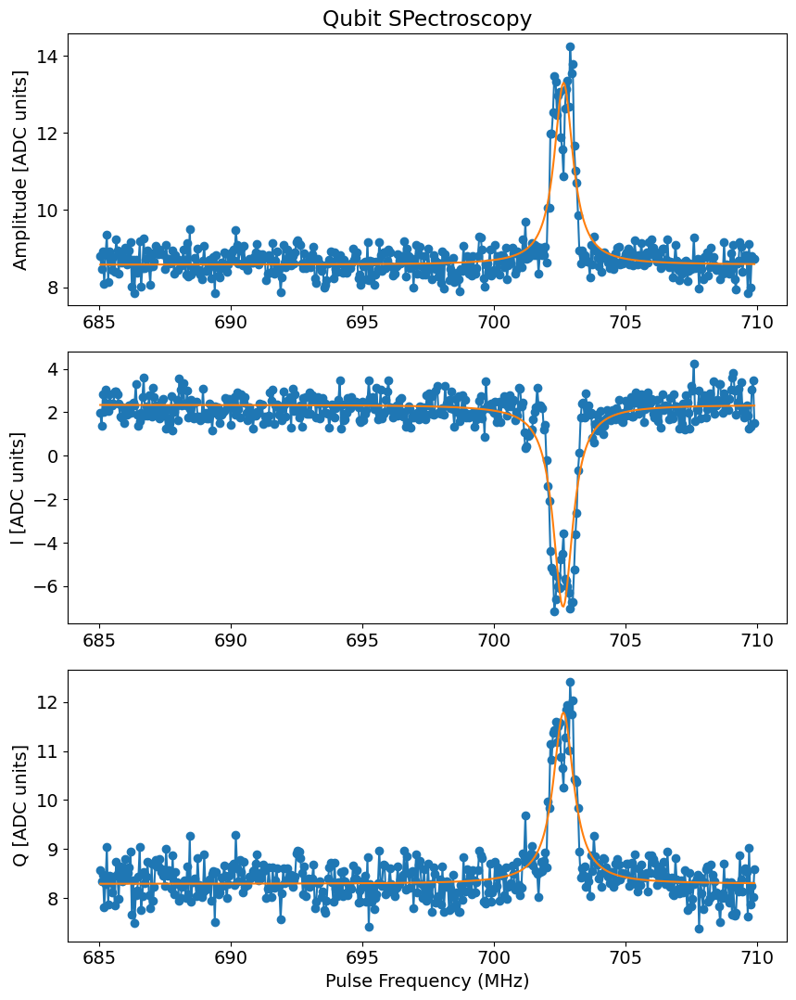

In [31]:
temp_data, attrs = prev_data(expt_path, '00034_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M2 - S5 spectroscopy

Found peak in amps at [MHz] 878.8559501185907, HWHM -0.28011589224511413
Found peak in I at [MHz] 878.8733040986673, HWHM 0.3467744779106859
Found peak in Q at [MHz] 878.8279511572016, HWHM 0.31116816303369865


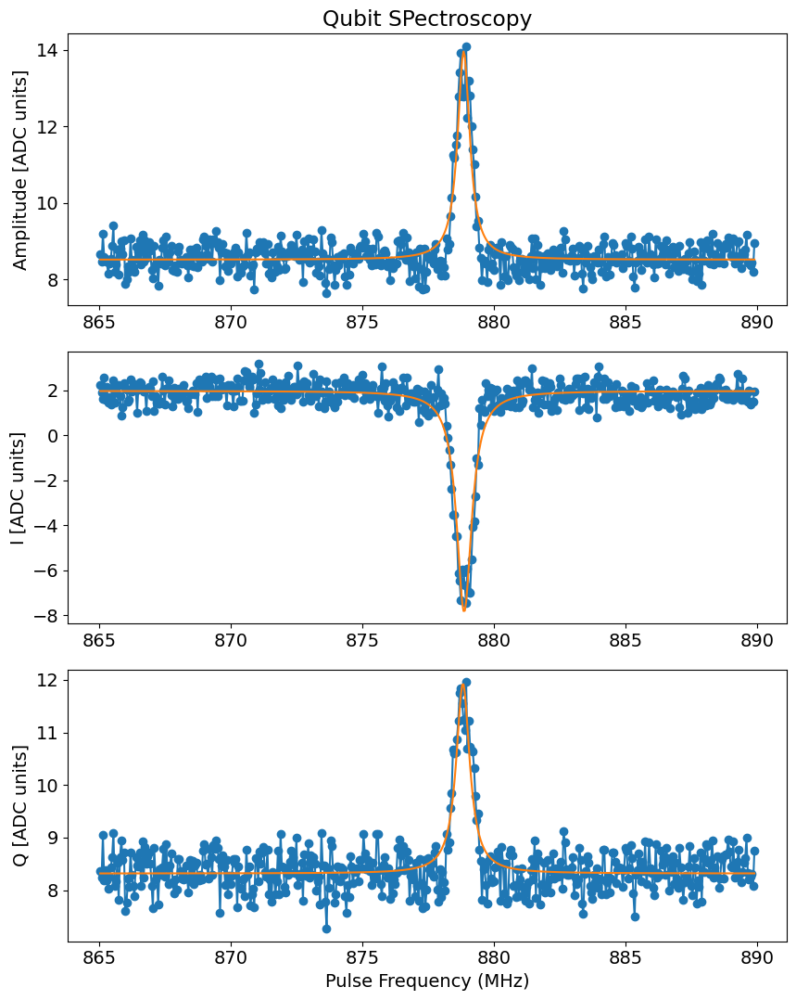

In [33]:
temp_data, attrs = prev_data(expt_path, '00036_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M2 - S6 spectroscopy

Found peak in amps at [MHz] 1070.2572776285729, HWHM -0.23250024083419663
Found peak in I at [MHz] 1070.2160249852361, HWHM 0.261135296287805
Found peak in Q at [MHz] 1070.2707023637015, HWHM -0.2719881709166472


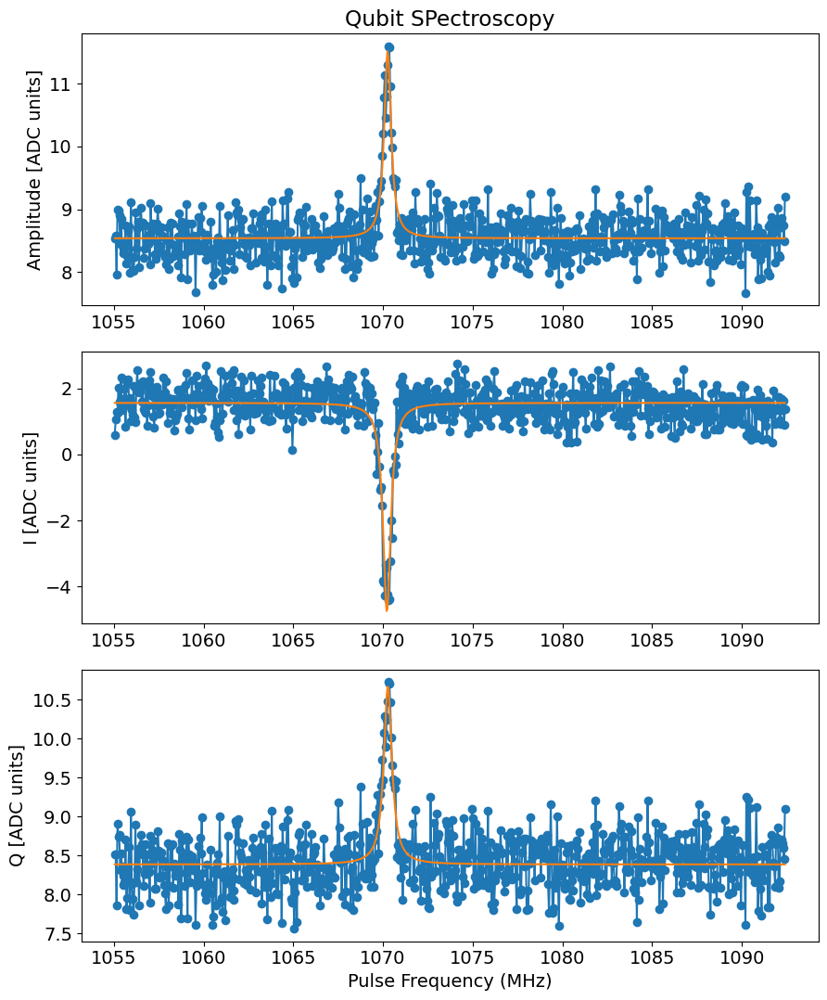

In [37]:
temp_data, attrs = prev_data(expt_path, '00039_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M2 - S7 spectroscopy

Found peak in amps at [MHz] 1249.237619462195, HWHM -0.23905803030002618
Found peak in I at [MHz] 1249.259300232034, HWHM 0.30007695421032526
Found peak in Q at [MHz] 1249.2480226907364, HWHM -0.3004098783186425


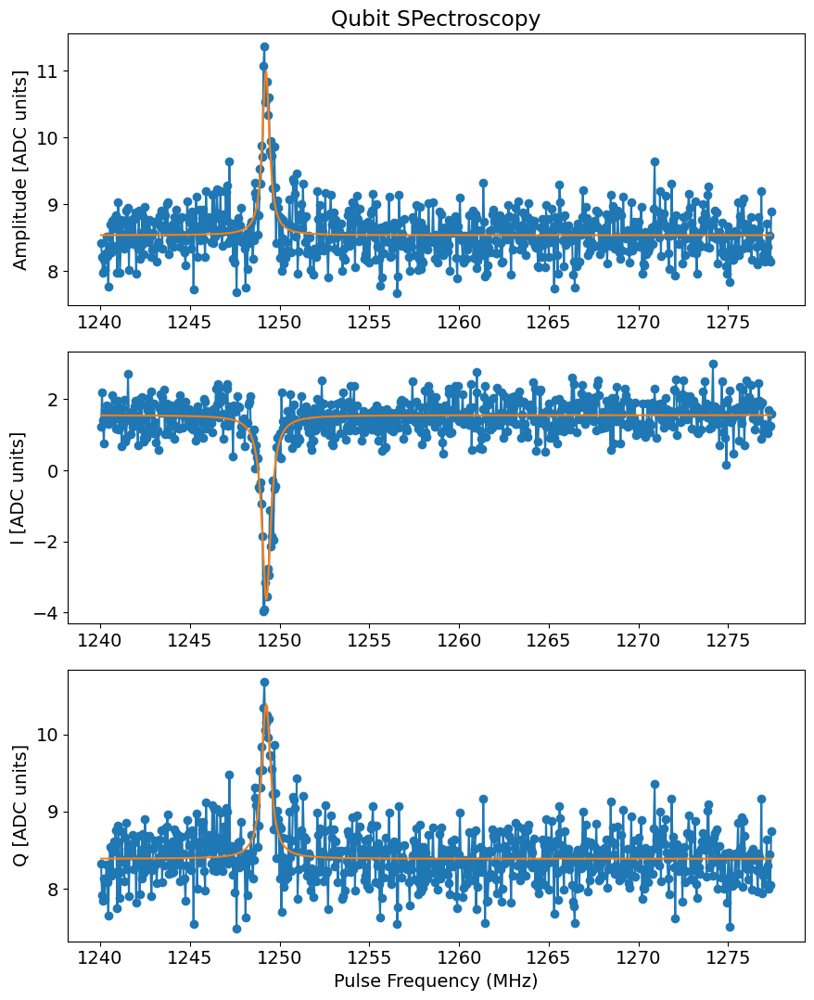

In [38]:
temp_data, attrs = prev_data(expt_path, '00040_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M2 - S8 spectroscopy

Found peak in amps at [MHz] 1967.122241400717, HWHM 19.601165596156598
Found peak in I at [MHz] 1966.1440875575324, HWHM 15.709251703908503
Found peak in Q at [MHz] 1968.0953424204406, HWHM 22.7982324389755


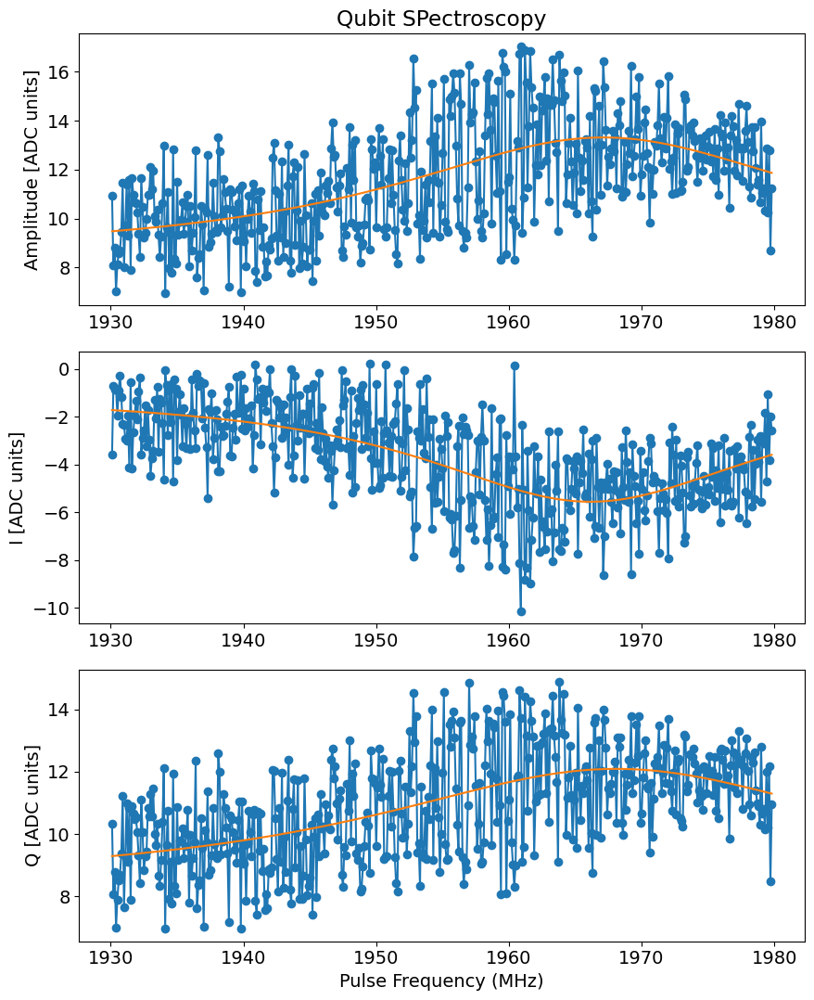

In [854]:
temp_data, attrs = prev_data(expt_path, '00071_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### M2 - lossy spectroscopy

Found peak in amps at [MHz] 1879.6382739475346, HWHM -597.8005471441038
Found peak in I at [MHz] 1977.4478313975198, HWHM 28.371409330996357
Found peak in Q at [MHz] 1980.9037746293473, HWHM 23.93727268315556


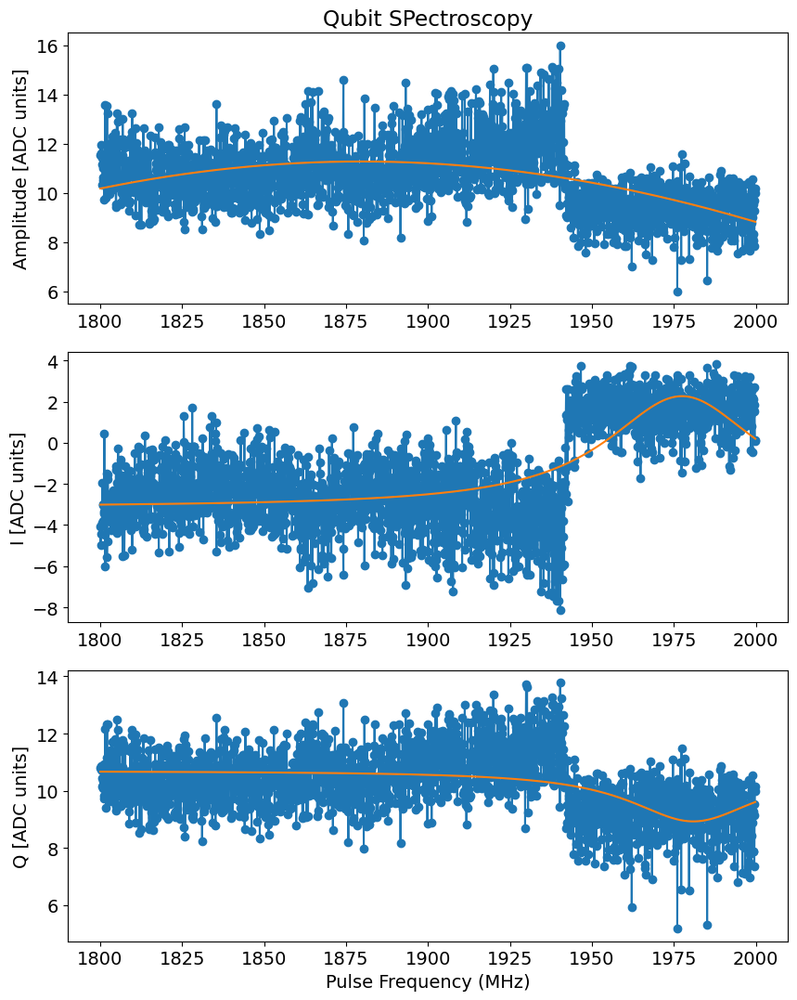

In [855]:
temp_data, attrs = prev_data(expt_path, '00073_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

Found peak in amps at [MHz] 2491.85758673451, HWHM 0.2921926002727756
Found peak in I at [MHz] 2491.850445132995, HWHM -0.367742655153417
Found peak in Q at [MHz] 2491.844142742593, HWHM -0.3310634221224279


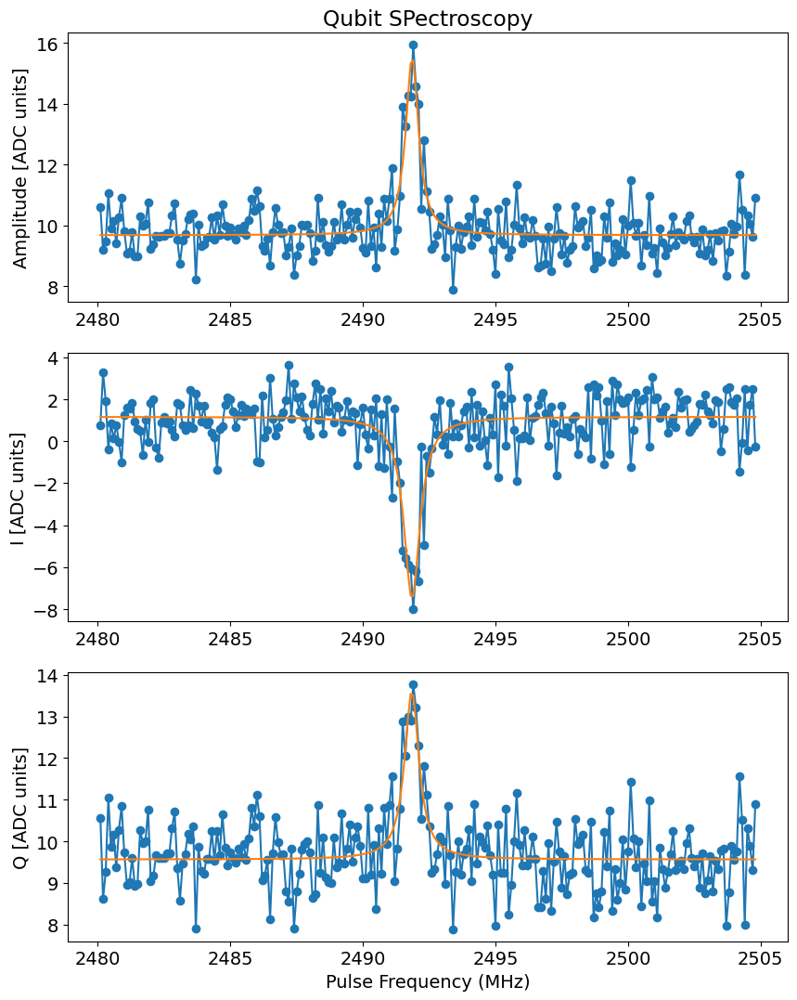

In [861]:
temp_data, attrs = prev_data(expt_path, '00077_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

### Qubit + Man 1  to Lossy Manipulate ()

Found peak in amps at [MHz] 506.1627596482555, HWHM 232.1249486211954
Found peak in I at [MHz] 508.02170465410467, HWHM 246.882290064352
Found peak in Q at [MHz] 505.2920900906492, HWHM 225.0526683660133


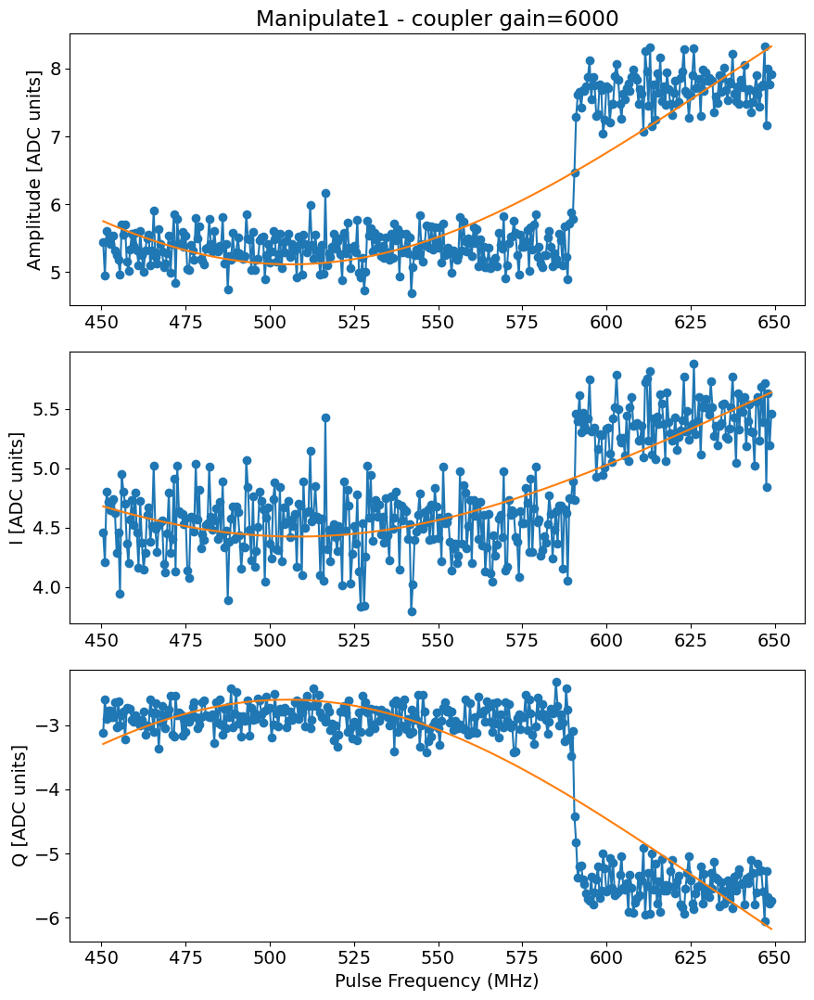

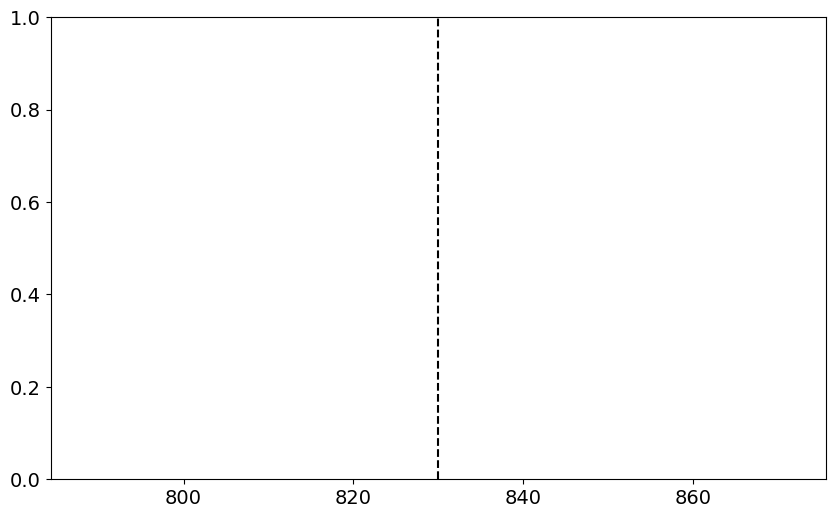

In [1023]:
temp_data, attrs = prev_data(expt_path, '00063_FluxSpectroscopyF0g1Experiment.h5')

qubit_spectroscopy_display(temp_data, title='Manipulate1 - coupler gain=6000', vlines=[])
#draw vertical lines
plt.axvline(830, c='k', ls='--')

### Full scan

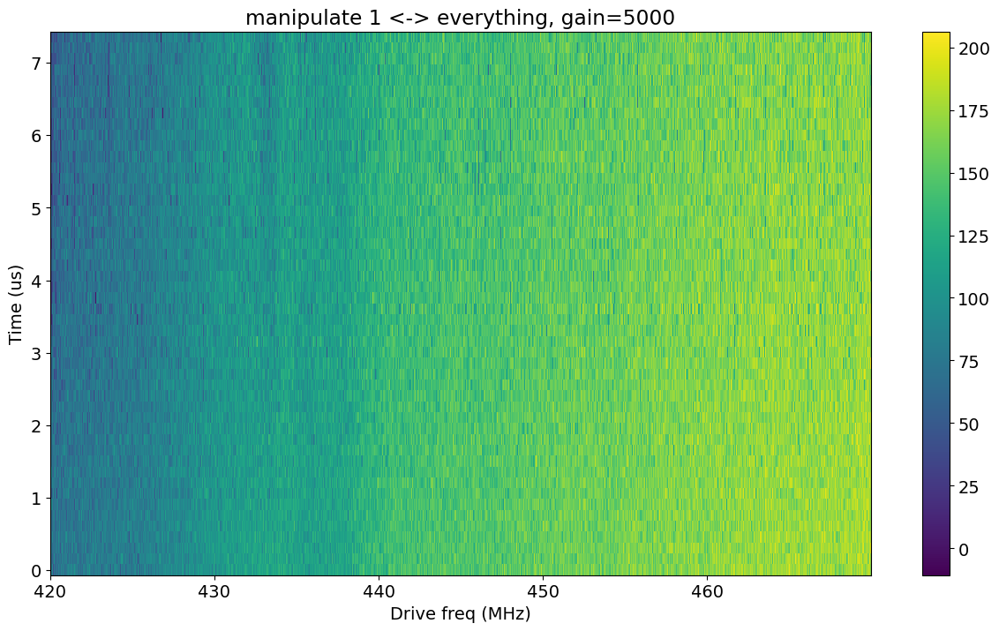

In [90]:
file_list = np.arange(683,2349,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep_long(len_x, freq_list, np.array(y_list), hlines=None, vlines=[], title="manipulate 1 <-> everything, gain=5000")
    

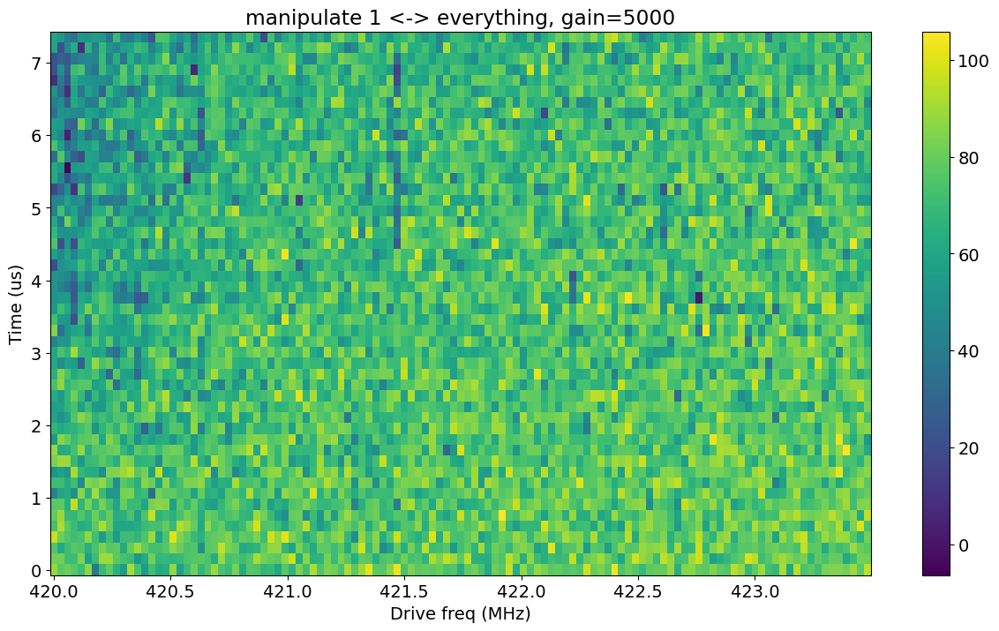

In [12]:
file_list = np.arange(683,800,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep_long(len_x, freq_list, np.array(y_list), hlines=None, vlines=[], title="manipulate 1 <-> everything, gain=5000")
    

In [13]:
attrs

{'config': {'prepulse_qubit': {'freq': [3569.3482778089246],
   'length': [0.06],
   'gain': [30],
   'phase': [0],
   'repeat_time': 10},
  'device': {'qubit': {'T1': [127.0],
    'f_ge': [3568.5139269754336],
    'f_ge_resolved': [3568.5139269754336],
    'f_ge_idle': [3568.5139269754336],
    'f_ef': [3425.3230942891637],
    'f_ef_idle': [3425.3230942891637],
    'ramp_sigma': [0.005],
    'ramp_sigma_num': [3],
    'pulses': {'pi_ge': {'gain': [10973],
      'sigma': [0.035],
      'length': [0],
      'type': ['gauss']},
     'pi_ge_ftop': {'gain': [3000],
      'sigma': [0.005],
      'length': [0.190914187445986],
      'type': ['flat_top']},
     'pi_ge_fast': {'gain': [10682],
      'sigma': [0.035],
      'length': [0],
      'type': ['gauss']},
     'pi_ge_resolved': {'gain': [50],
      'sigma': [0.005],
      'length': [6.553697146578866],
      'type': ['flat_top'],
      'repeat_no': [1]},
     'hpi_ge': {'gain': [5304],
      'length': [0],
      'sigma': [0.035],
    

C:\_Lib\python\multimode_expts\fit_display.py:1906: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  plt.pcolormesh(y_freqlist[:z_datalist.shape[0]],x_timelist,z_datalist.T)


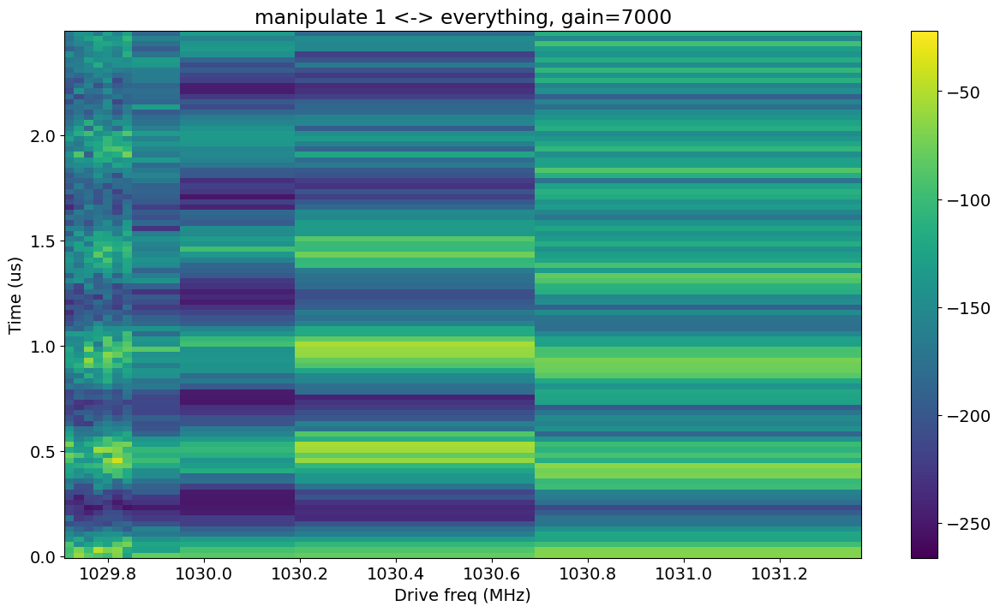

In [10]:
file_list = np.arange(170,199,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgq']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep_long(len_x, freq_list, np.array(y_list), hlines=None, vlines=[], title="manipulate 1 <-> everything, gain=7000")

Attempted to init fitparam 1 to 6.4, which is out of bounds 0.020202020202020204 to 3.0303030303030303. Instead init to 1.5252525252525253
Decay from avgi [us] 9.317022048810523
Rate [MHz] 2.6516637573089374
Pi length from avgi data [us]: 0.17295574885820564
	Pi/2 length from avgi data [us]: 0.08647787442910282

Decay from avgq [us] 2.6505926654064456
Rate [MHz] 1.30442255260826
Pi length from avgq data [us]: 0.29394794853080786
Pi/2 length from avgq data [us]: 0.14697397426540393


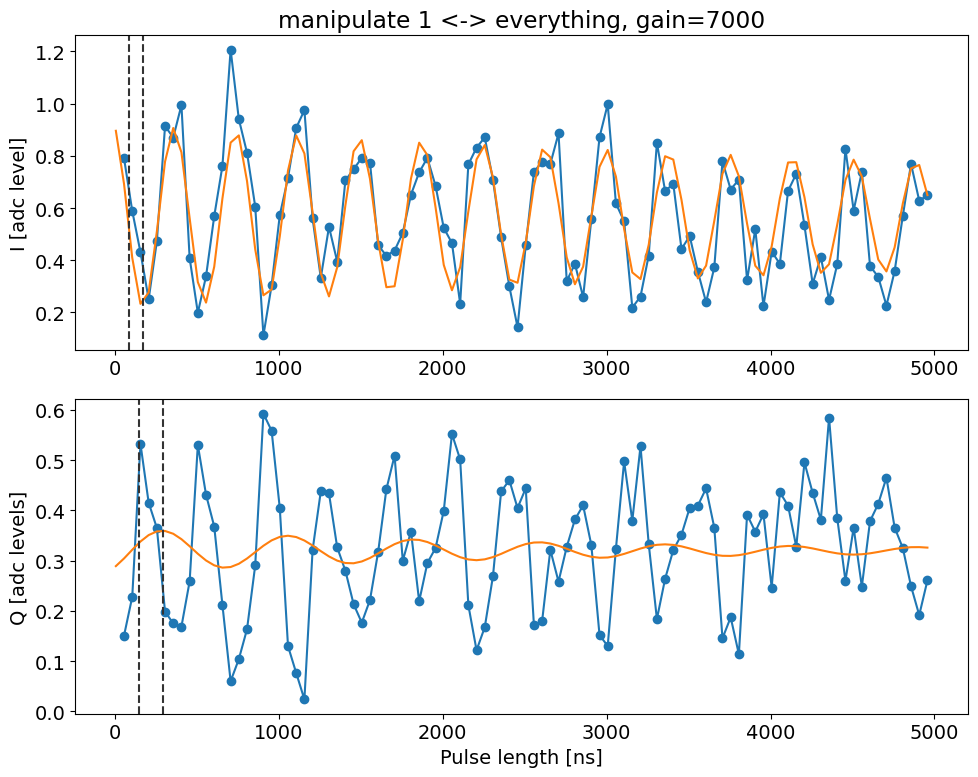

In [212]:
temp_data, attrs = prev_data(expt_path, '00179_sideband_general_sweep.h5')
#plot length rabi 
length_rabi_display(temp_data, fit=True, fitparams=None, title='manipulate 1 <-> everything, gain=7000')

In [214]:
attrs['config']['expt']

{'start': 0.007,
 'step': 0.05,
 'qubits': [0],
 'expts': 101,
 'reps': 50,
 'rounds': 10,
 'flux_drive': ['low', 336.0, 7000, 0.005],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.107150615436, 3425.0250576126327, 0, 1994.7],
  [7203, 2585, 0, 2000],
  [0.0, 0.0, 0.01, 1.1027260782489923],
  [0, 0, 0, 0],
  [2, 2, 5, 5],
  ['gaussian', 'gaussian', 'flat_top', 'flat_top'],
  [0.015, 0.08405005321695154, 0.005, 0.005]],
 'post_sweep_pulse': [[1994.7],
  [2000],
  [1.1027260782489923],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'length_placeholder': 5.007}

### Q- random

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


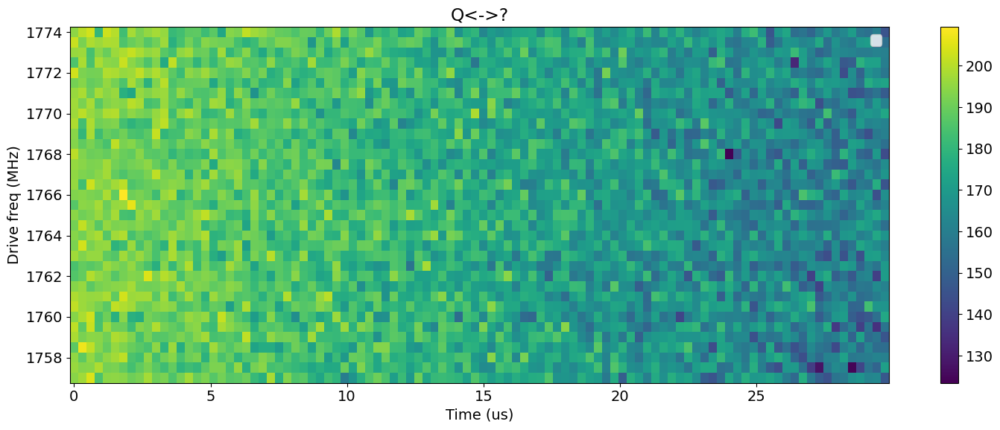

In [12]:
# file_list = np.arange(1297,1313,1)
file_list = np.arange(4166,4201,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="Q<->?")
    

### Manipulate1-manipulate2

Decay from avgi [us] 34.94498311202428
Rate [MHz] 0.5219522451819185
Pi length from avgi data [us]: 0.9731262573194817
	Pi/2 length from avgi data [us]: 0.48656312865974083

Decay from avgq [us] 29.589472285431047
Rate [MHz] 0.5208115625932289
Pi length from avgq data [us]: 0.9637137790257105
Pi/2 length from avgq data [us]: 0.48185688951285527


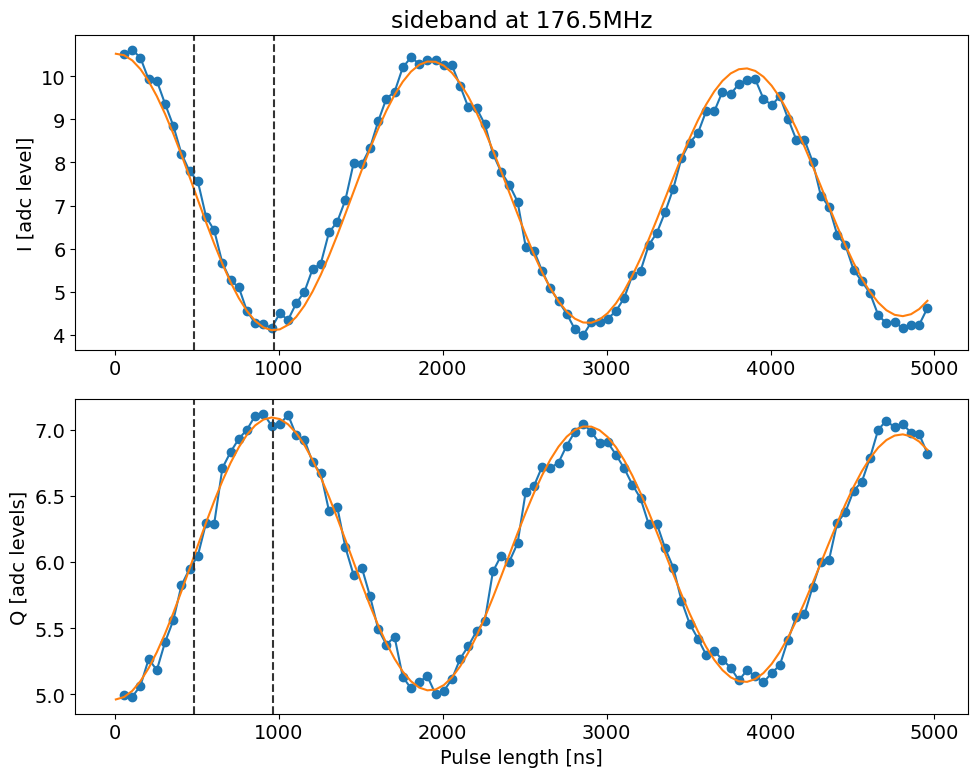

In [288]:
temp_data, attrs = prev_data(expt_path, '00008_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

#### sweep

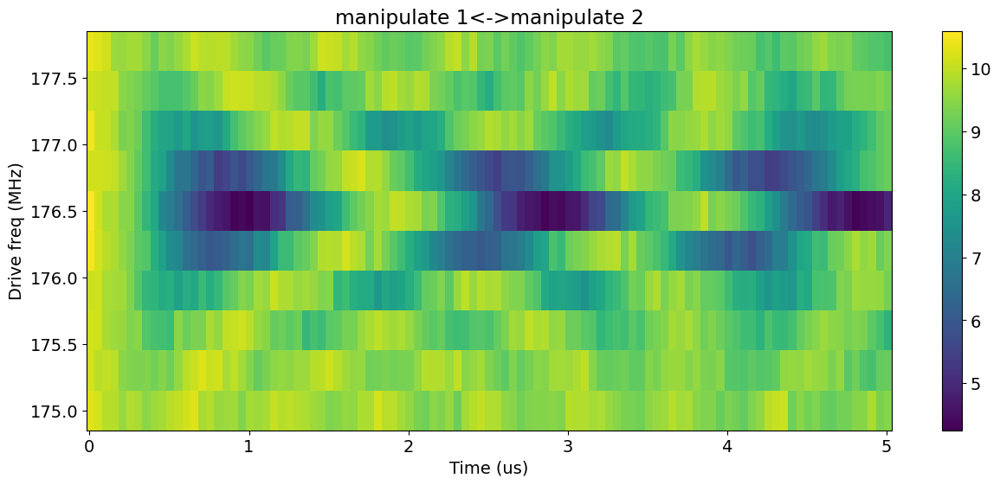

In [287]:
file_list = np.arange(917,927,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=None, vlines=None, title="manipulate 1<->manipulate 2")
    

### Manipulate 1 - Lossy Mode

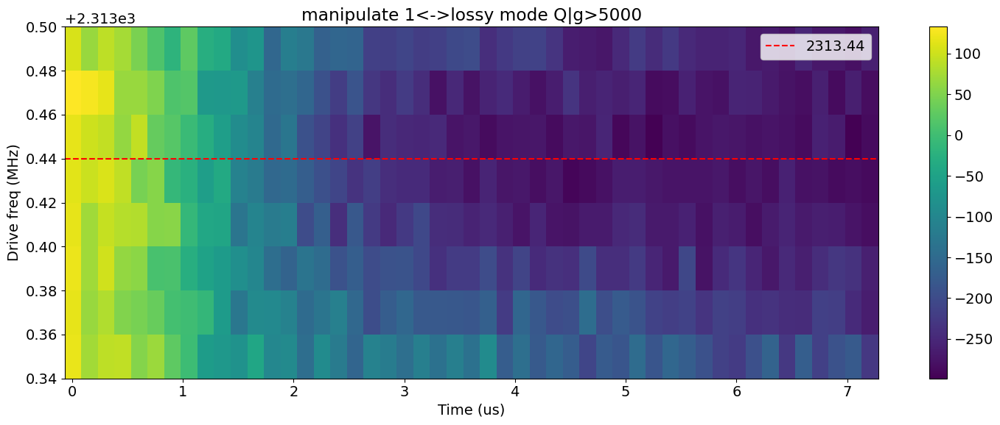

In [58]:
file_list = np.arange(823, 842,1)
#file_list = np.arange(1049, 1059,1)
file_list = np.arange(1150, 1160,1)
file_list = np.arange(637, 645,1)
# file_list = np.concatenate((np.arange(1120, 1129,1), np.arange(1140, 1144,1)))
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi'][0:-1]
    if attrs['config']['expt']['active_reset']:
        # for each time, post select the single shot data
        Ilist = []
        Qlist = []
        threshold = -4#attrs['config']['expt']['threshold'][0]
        readout_per_round = 4#attrs['config']['expt']['readout_per_round']
        for ii in range(len(temp_data['idata'])-1):
            Ig, Qg = filter_data_IQ(temp_data['idata'][ii], temp_data['qdata'][ii], threshold, readout_per_round)
            Ilist.append(np.mean(Ig))
            Qlist.append(np.mean(Qg))
        
        
        signal_y = Ilist
    #print(len(signal_y))
    
    len_x = temp_data['xpts'][0:-1]
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])
plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[2313.44], vlines=None, title="manipulate 1<->lossy mode Q|g>" + str(attrs['config']['expt']['flux_drive'][2]))


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


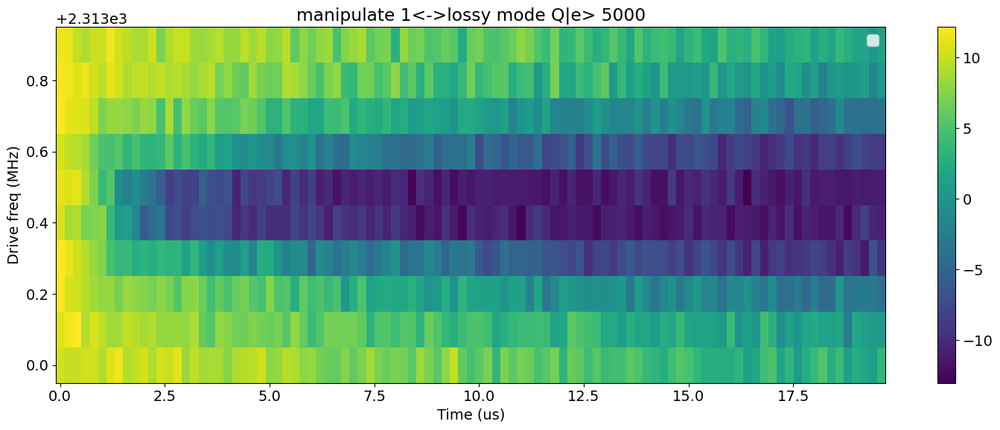

In [1296]:

file_list = np.arange(1160, 1170,1)

y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi'][0:-1]
    if attrs['config']['expt']['active_reset']:
        # for each time, post select the single shot data
        Ilist = []
        Qlist = []
        threshold = -4#attrs['config']['expt']['threshold'][0]
        readout_per_round = 4#attrs['config']['expt']['readout_per_round']
        for ii in range(len(temp_data['idata'])-1):
            Ig, Qg = filter_data_IQ(temp_data['idata'][ii], temp_data['qdata'][ii], threshold, readout_per_round)
            Ilist.append(np.mean(Ig))
            Qlist.append(np.mean(Qg))
        
        
        signal_y = Ilist
    #print(len(signal_y))
    
    len_x = temp_data['xpts'][0:-1]
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])
plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->lossy mode Q|e> " + str(attrs['config']['expt']['flux_drive'][2]))


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


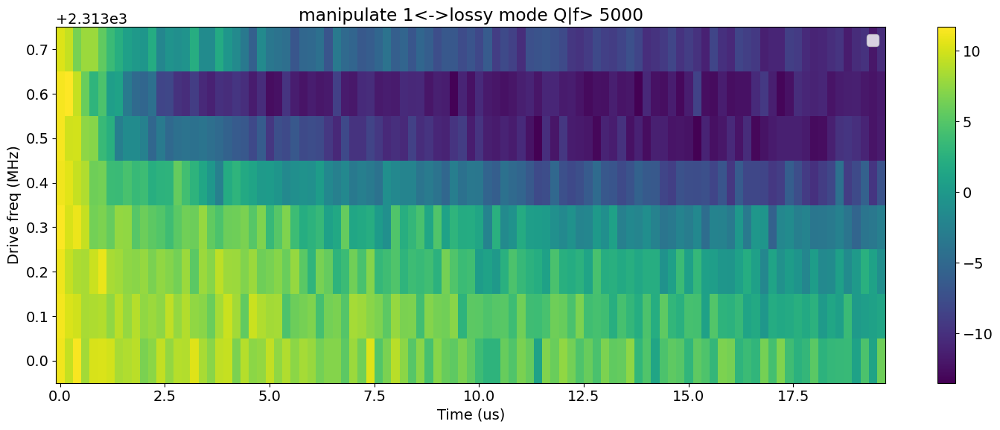

In [1297]:

file_list = np.arange(1170, 1178,1)

y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi'][0:-1]
    if attrs['config']['expt']['active_reset']:
        # for each time, post select the single shot data
        Ilist = []
        Qlist = []
        threshold = -4#attrs['config']['expt']['threshold'][0]
        readout_per_round = 4#attrs['config']['expt']['readout_per_round']
        for ii in range(len(temp_data['idata'])-1):
            Ig, Qg = filter_data_IQ(temp_data['idata'][ii], temp_data['qdata'][ii], threshold, readout_per_round)
            Ilist.append(np.mean(Ig))
            Qlist.append(np.mean(Qg))
        
        
        signal_y = Ilist
    #print(len(signal_y))
    
    len_x = temp_data['xpts'][0:-1]
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])
plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->lossy mode Q|f> " + str(attrs['config']['expt']['flux_drive'][2]))


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Attempted to init fitparam 1 to 100, which is out of bounds 0.00510204081632653 to 0.7653061224489796. Instead init to 0.385204081632653



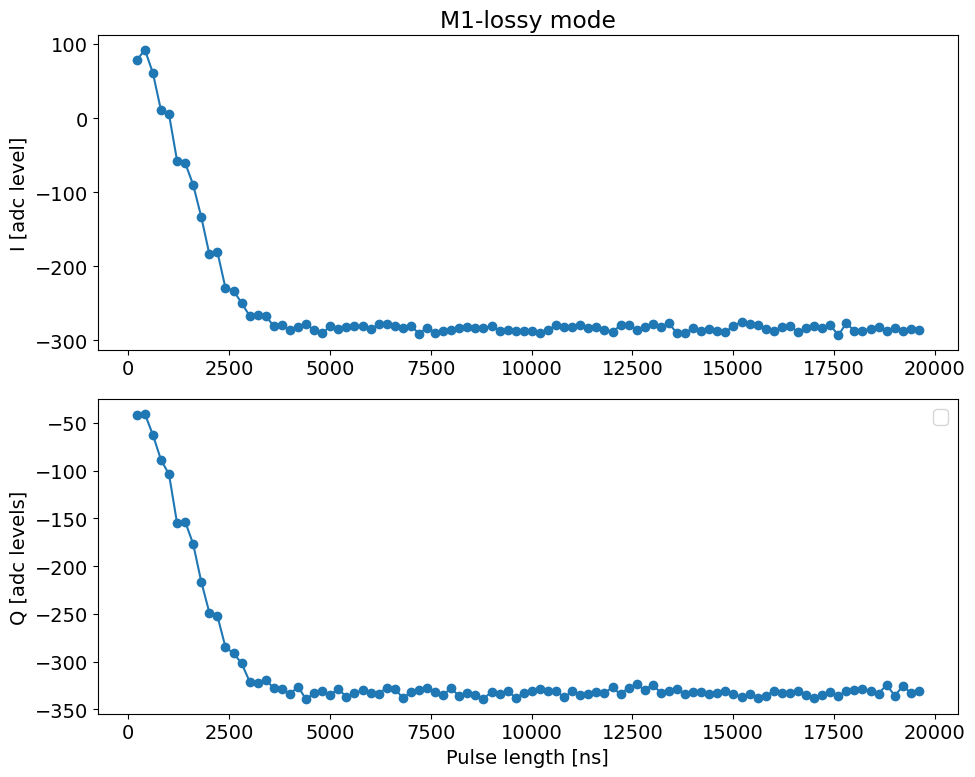

2313.44


In [60]:
#temp_data, attrs = prev_data(expt_path, '00836_sideband_general_sweep.h5')
# temp_data, attrs = prev_data(expt_path, '00055_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00061_SidebandGeneralExperiment.h5')
temp_data, attrs = prev_data(expt_path, '00003_SidebandGeneralExperiment.h5')

length_rabi_display(temp_data, fit=False, fitparams=[20,100,None,None,None,None ], vlines = [560],
                      normalize= [False, 'g_data', 'f_data'],
                       active_reset = False,  title='M1-lossy mode')
print(attrs['config']['expt']['flux_drive'][1])
#draw vertical lines
# plt.axvline(8000, c='k', ls='--')
# plt.show()

In [63]:
freq = attrs['config']['expt']['flux_drive'][1] 
pi_length =10 #temp_data['pi_length']
pi2_length = 0 #temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M1-D1', freq, 0.01, pi_length, pi2_length, gain)

In [64]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.660,0.03,0.942926,0.465943,3000,2025-01-21 16:12:51.119011
1,M1-S2,521.230,0.05,1.069160,0.531718,5000,2025-01-21 16:17:17.763411
2,M1-S3,696.980,0.03,1.256963,0.613370,9000,2025-01-21 16:17:39.113328
3,M1-S4,876.380,0.03,1.235632,0.622603,9000,2025-01-21 16:17:54.523998
4,M1-S5,1053.950,0.03,1.882097,0.985547,7500,2025-01-21 16:18:31.141469
5,M1-S6,1245.525,0.03,1.500950,0.732998,13500,2025-01-21 16:32:20.759195
6,M1-S7,1423.275,0.03,2.153588,1.085899,10000,2025-01-21 16:32:02.177572
7,M1-S8,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3


h:\Shared drives\SLab\Multimode\experiment\240911\experiments\fitting.py:55: RuntimeWarning: overflow encountered in exp
  return y0 + yscale*np.exp(-(x-x0)/decay)


Fit T1 avgi [us]: 0.715703924808425
Fit T1 avgq [us]: 0.6995046977617547


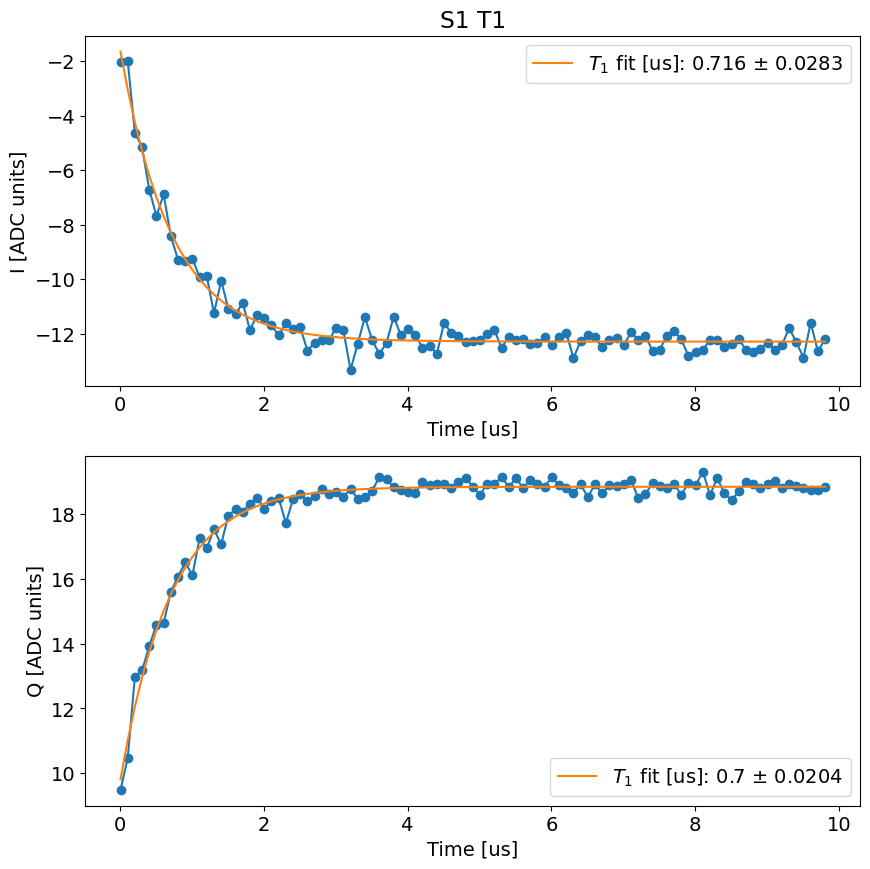

In [1063]:
# t1 meas
temp_data, attrs = prev_data(expt_path, '00006_SidebandT1GeneralExperiment.h5')
t1_display(temp_data, fit=True, fitparams=None, title='S1 T1')


##### Check Man1 Reset

In [1087]:
temp_data, attrs = prev_data(expt_path, '00036_LengthRabiGeneralF0g1Experiment.h5')
# length_rabi_display(temp_data, fit=True, fitparams=[None,None,None,None,None,None ], vlines = None,
#                       normalize= [False, 'g_data', 'f_data'],
#                        active_reset = False,  title='f0-g1 Manipulate1')
np.shape(temp_data['idata'])

(100, 1000)

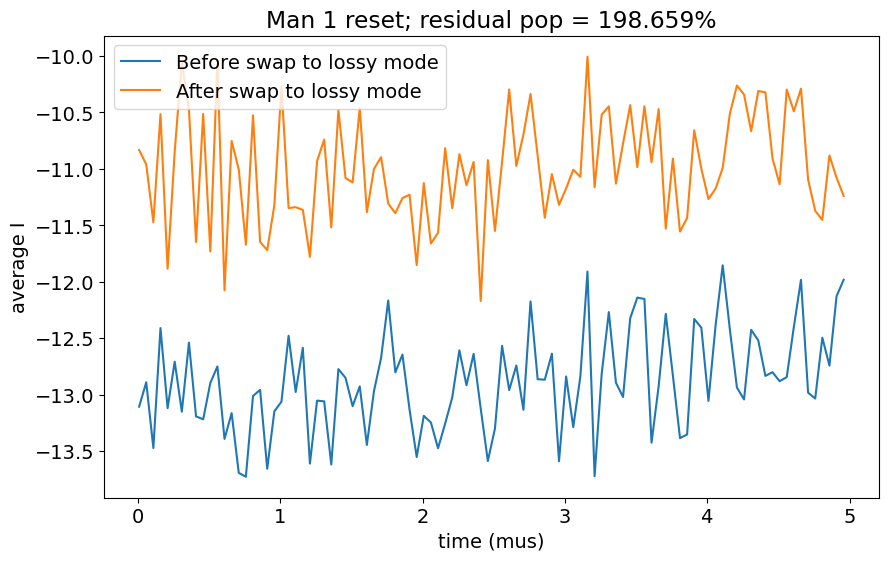

In [1088]:
ydata = temp_data['idata']
ydata1 = [np.average(ydata[_][::2]) for _ in range(len(ydata))]
ydata2 = [np.average(ydata[_][1::2]) for _ in range(len(ydata))]
plt.plot(temp_data['xpts'],  ydata1, label = 'Before swap to lossy mode')
plt.plot(temp_data['xpts'], ydata2 , label = 'After swap to lossy mode')

residual_pop = (max(ydata2) - min(ydata1) )/ (max(ydata1) - min(ydata1)) * 100
#plt.plot(temp_data['xpts'], [np.average(ydata[_][100:200]) for _ in range(len(ydata))] )
# xlabel: time, ylabel: average I
plt.xlabel('time (mus)')
plt.ylabel('average I')
plt.title('Man 1 reset; residual pop = ' + str(round(residual_pop,3)) + '%')
plt.legend()

In [1041]:
attrs['config']['expt']

{'start': 0.006975446428571428,
 'step': 0.02,
 'qubits': [0],
 'expts': 100,
 'reps': 500,
 'rounds': 1,
 'gain': 15000,
 'ramp_sigma': 0.005,
 'freq': 2006.72,
 'pi_ge_before': False,
 'pi_ef_before': False,
 'pi_ef_after': False,
 'normalize': False,
 'active_reset': False,
 'check_man_reset': [True, 0],
 'check_man_reset_pi': [[2006.72],
  [15000],
  [0.6168960348389007],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'prepulse': True,
 'pre_sweep_pulse': [[3568.1904347121535, 3425.5537944060666],
  [9653, 7575],
  [0, 0],
  [0, 0],
  [2, 2],
  ['gaussian', 'gaussian'],
  [0.035, 0.035]],
 'length_placeholder': 1.9869754464285714}

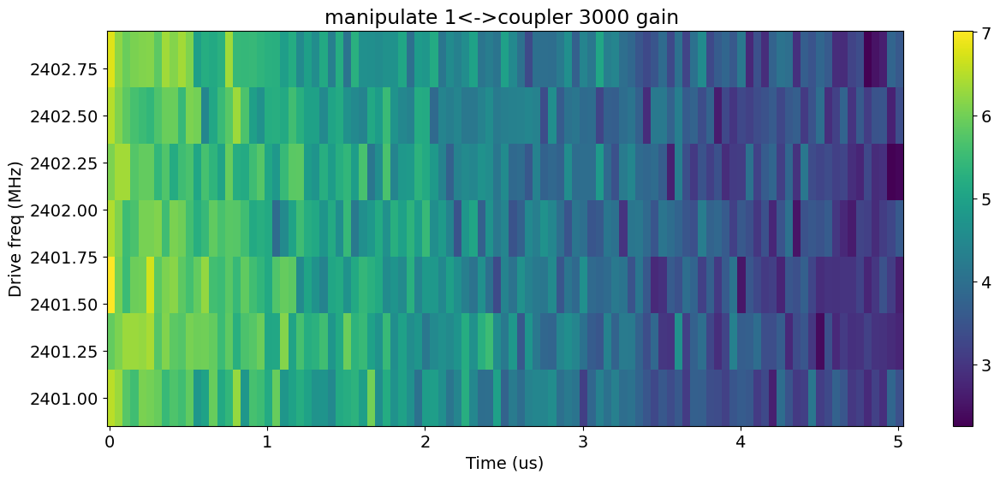

In [1062]:
file_list = np.arange(1806, 1813
                      
                      ,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->lossy mode  7000 gain ")

### Man2 - storage8

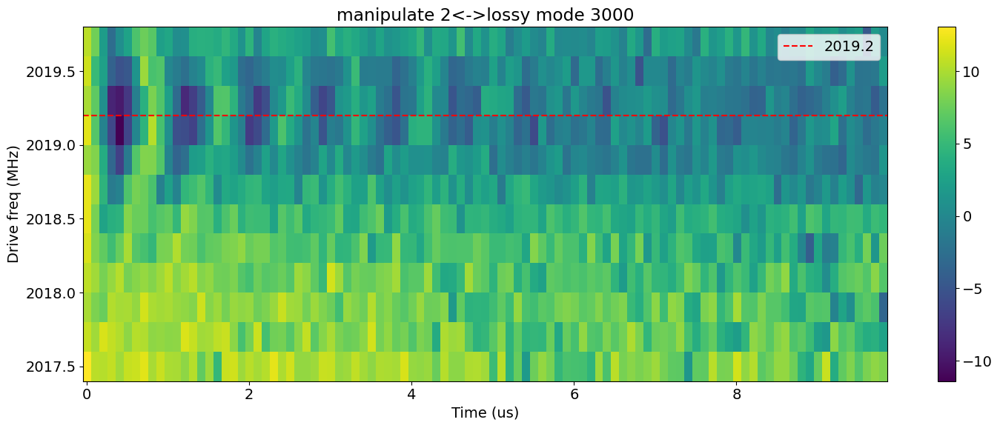

In [901]:

file_list = np.arange(941, 958,1)
file_list = np.arange(964, 976,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi'][0:-1]
    if attrs['config']['expt']['active_reset']:
        # for each time, post select the single shot data
        Ilist = []
        Qlist = []
        threshold = -4#attrs['config']['expt']['threshold'][0]
        readout_per_round = 4#attrs['config']['expt']['readout_per_round']
        for ii in range(len(temp_data['idata'])-1):
            Ig, Qg = filter_data_IQ(temp_data['idata'][ii], temp_data['qdata'][ii], threshold, readout_per_round)
            Ilist.append(np.mean(Ig))
            Qlist.append(np.mean(Qg))
        
        
        signal_y = Ilist
    #print(len(signal_y))
    
    len_x = temp_data['xpts'][0:-1]
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])
plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[2019.2], vlines=None, title="manipulate 2<->lossy mode " + str(attrs['config']['expt']['flux_drive'][2]))


Attempted to init fitparam 4 to -0.9670077987339295, which is out of bounds 0.7994415584415584 to 12.940272727272728. Instead init to 6.869857142857143
[18.14386646  1.1948907  92.07511677  4.25513347 -0.97600695 -1.98609797]
Decay from avgi [us] 4.255133466710466
Rate [MHz] 1.1948906955276277
Pi length from avgi data [us]: 0.41362426587604323
	Pi/2 length from avgi data [us]: 0.20681213293802161
Fit params:  [18.14386646  1.1948907  92.07511677  4.25513347 -0.97600695 -1.98609797]

Decay from avgq [us] 4.253630688313874
Rate [MHz] 1.1939428504547311
Pi length from avgq data [us]: 0.41485186769553484
Pi/2 length from avgq data [us]: 0.20742593384776742
Fit params:  [ 16.37851306   1.19394285 -88.31139172   4.25363069   7.52926537
  -4.00583619]


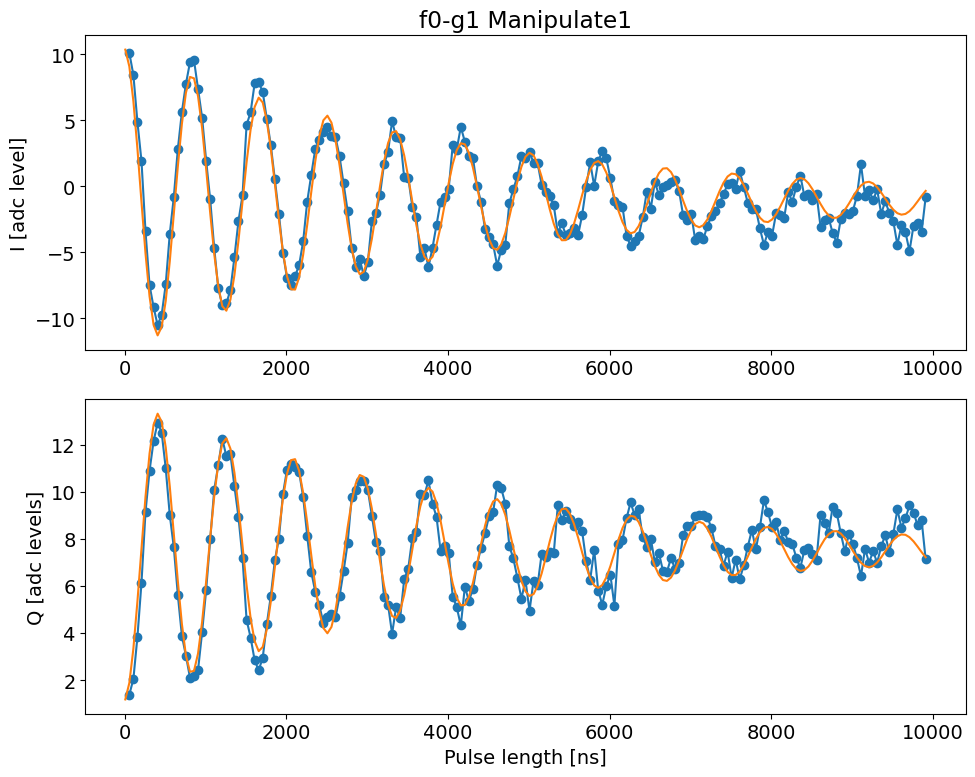

2019.2


In [903]:
#temp_data, attrs = prev_data(expt_path, '00936_sideband_general_sweep.h5')
temp_data, attrs = prev_data(expt_path, '00052_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=[None,None,None,None,None,None ], vlines = [],
                      normalize= [False, 'g_data', 'f_data'],
                       active_reset = False,  title='f0-g1 Manipulate1')
print(attrs['config']['expt']['flux_drive'][1])
#draw vertical lines
#plt.axvline(4000, c='k', ls='--')
plt.show()

Fit T1 avgi [us]: 40.19010896758286
Fit T1 avgq [us]: 38.04800827724407


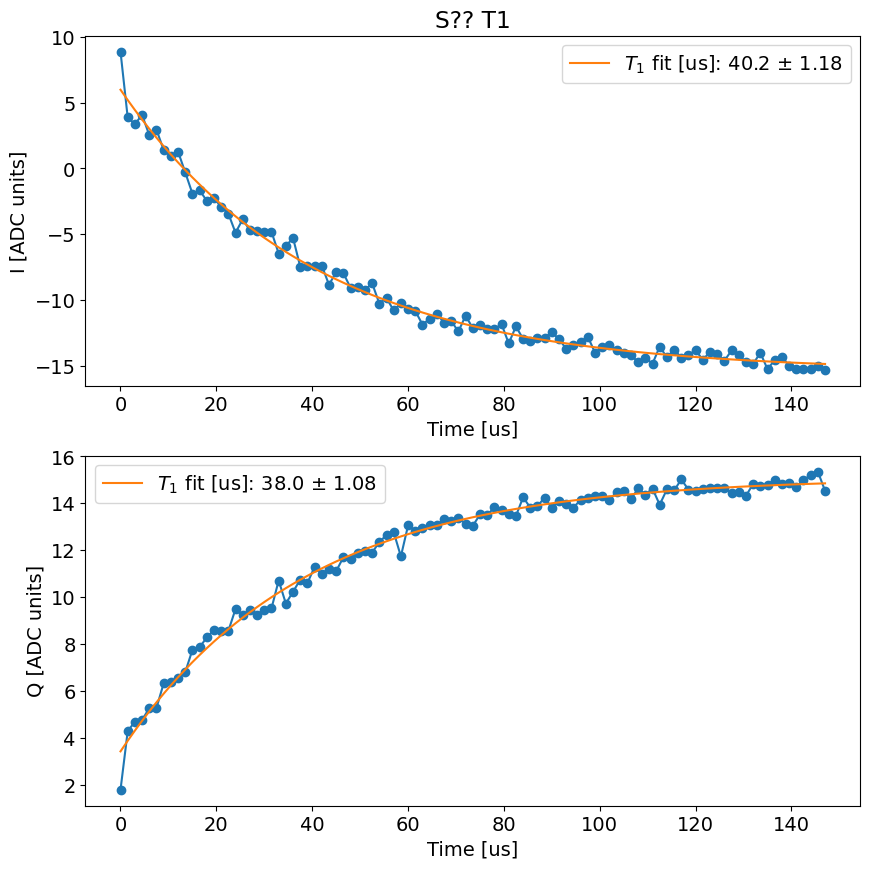

In [906]:
temp_data, attrs = prev_data(expt_path, '00005_SidebandT1GeneralExperiment.h5')
t1_display(temp_data, fit=True, fitparams=None, title='S?? T1')

### Man2 Long scan 

C:\Users\26049\AppData\Local\Temp\ipykernel_17152\3986185201.py:25: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  cax = plt.pcolormesh(x_timelist,y_freqlist[:znew.shape[0]],znew)


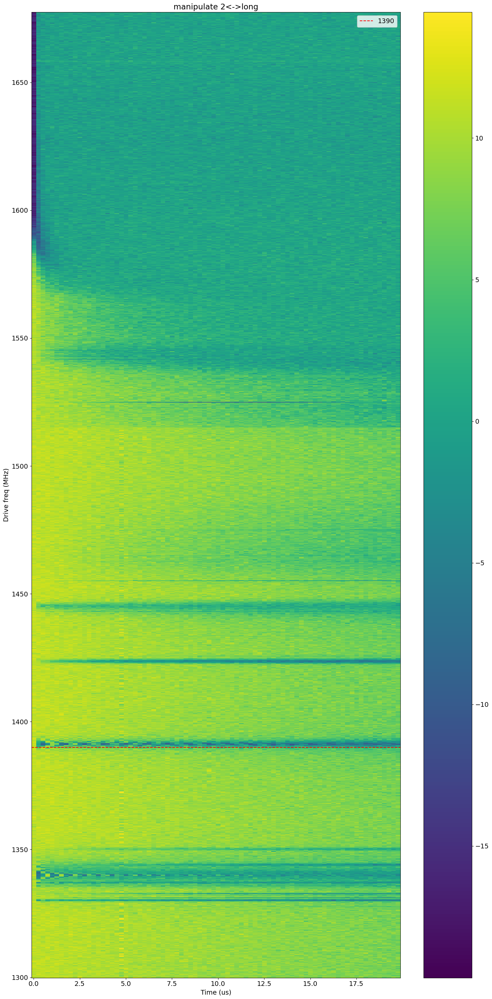

In [47]:
file_list = np.arange(1807,3109,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1390], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->long", factor=5)
    

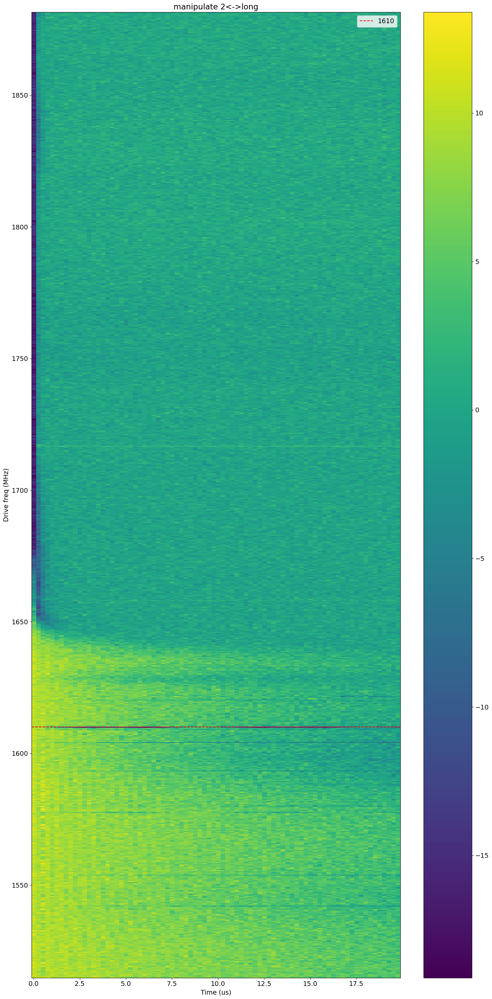

In [65]:
# file_list = np.arange(2540,25,1)
file_list = np.arange(3111,3926,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1610], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->long", factor=5)
    

### Maniplate 2- Lossy Mode

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


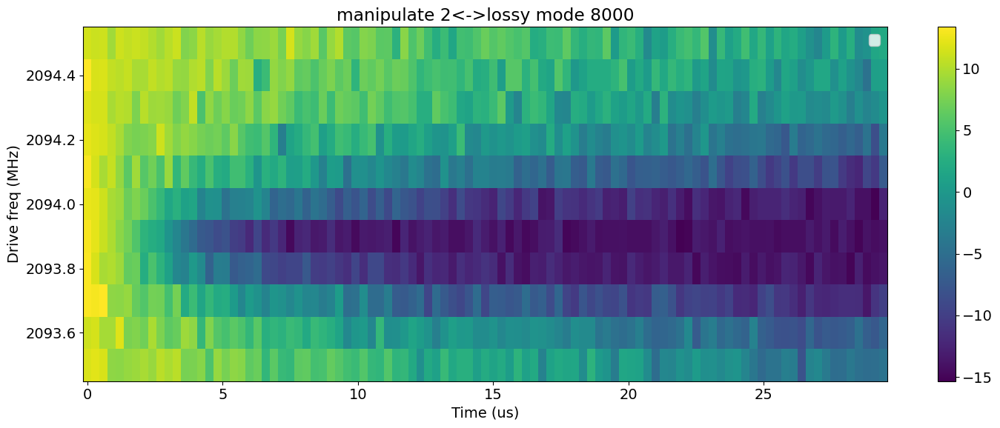

In [1125]:
#file_list = np.arange(823, 842,1)
file_list = np.arange(858, 875,1)
file_list = np.arange(883, 906,1)
file_list = np.arange(908, 921,1)
#file_list = np.arange(924, 929,1)
file_list = np.arange(936, 941,1)
file_list = np.arange(1073, 1084,1) # ------
# file_list = np.arange(1089, 1098,1)
# file_list = np.arange(1098, 1115,1)
# file_list = np.arange(1129, 1140, 1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi'][0:-1]
    if attrs['config']['expt']['active_reset']:
        # for each time, post select the single shot data
        Ilist = []
        Qlist = []
        threshold = -4#attrs['config']['expt']['threshold'][0]
        readout_per_round = 4#attrs['config']['expt']['readout_per_round']
        for ii in range(len(temp_data['idata'])-1):
            Ig, Qg = filter_data_IQ(temp_data['idata'][ii], temp_data['qdata'][ii], threshold, readout_per_round)
            Ilist.append(np.mean(Ig))
            Qlist.append(np.mean(Qg))
        
        
        signal_y = Ilist
    #print(len(signal_y))
    
    len_x = temp_data['xpts'][0:-1]
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])
plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 2<->lossy mode " + str(attrs['config']['expt']['flux_drive'][2]))


Attempted to init fitparam 4 to -11.471665796515042, which is out of bounds -0.8033847402597403 to 18.512873376623375. Instead init to 8.854744318181817



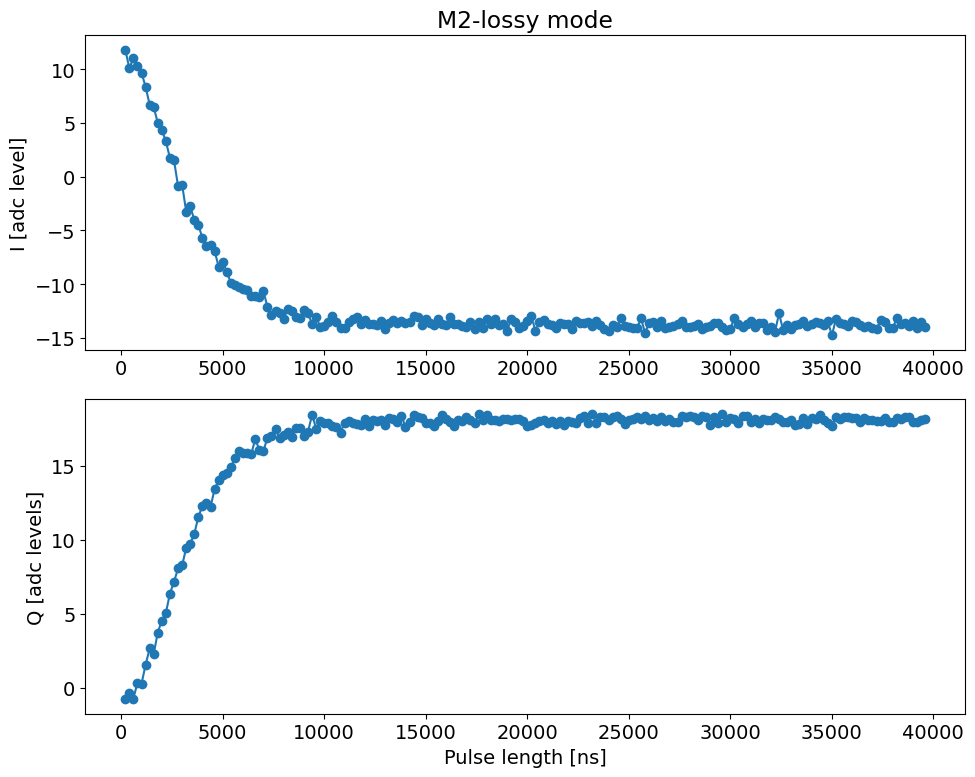

2093.9


In [1124]:
#temp_data, attrs = prev_data(expt_path, '00836_sideband_general_sweep.h5')
temp_data, attrs = prev_data(expt_path, '00058_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=False, fitparams=[30,None,None,None,None,None ], vlines = [4100],
                      normalize= [False, 'g_data', 'f_data'],
                       active_reset = False,  title='M2-lossy mode')
print(attrs['config']['expt']['flux_drive'][1])
#draw vertical lines
# plt.axvline(8000, c='k', ls='--')
# plt.show()

Text(0.5, 0, 'time (mus)')

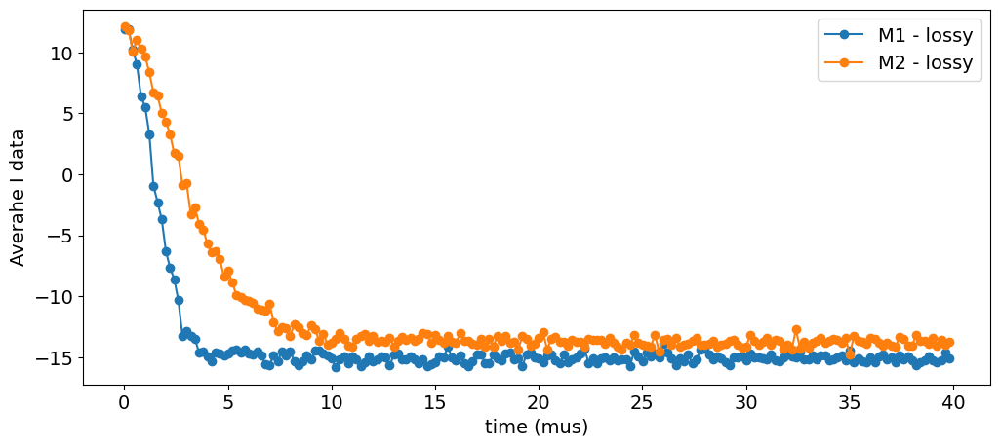

In [271]:
file_list = np.array([55, 58])
labels = ['M1 - lossy', 'M2 - lossy']
fig = plt.figure(figsize=(12, 5))
for idx, file_no in enumerate(file_list): 
    temp_data, attrs = prev_data(expt_path, str(file_no).zfill(5)+'_SidebandGeneralExperiment.h5')
    plt.plot(temp_data['xpts'], temp_data['avgi'],'-o', label = labels[idx])
plt.legend()
plt.ylabel('Averahe I data')
plt.xlabel('time (mus)')

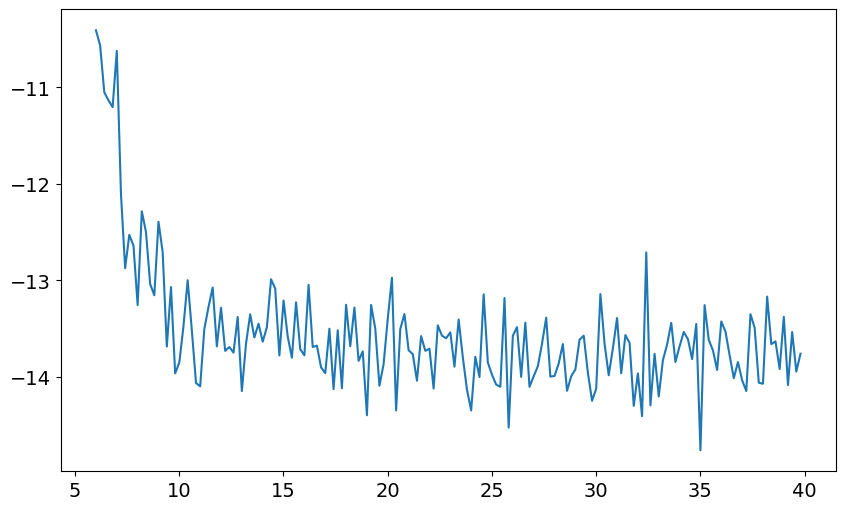

In [1029]:
idx = 30
xdata = temp_data['xpts'][idx:]
ydata = temp_data['avgi'][idx:]
plt.plot(xdata, ydata)

##### Check Man2 Reset

In [1075]:
temp_data, attrs = prev_data(expt_path, '00032_LengthRabiGeneralF0g1Experiment.h5')
# length_rabi_display(temp_data, fit=True, fitparams=[None,None,None,None,None,None ], vlines = None,
#                       normalize= [False, 'g_data', 'f_data'],
#                        active_reset = False,  title='f0-g1 Manipulate1')
np.shape(temp_data['idata'])

(100, 1000)

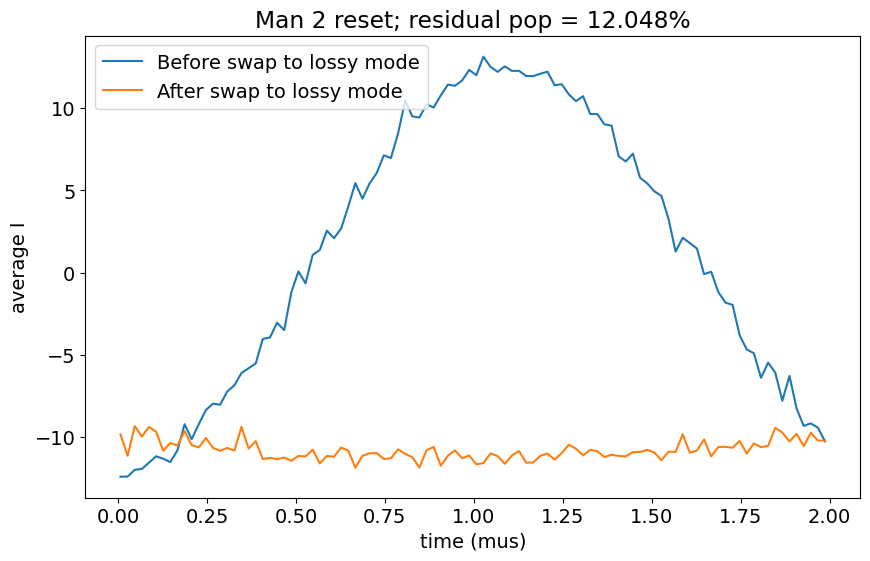

In [1078]:
ydata = temp_data['idata']
ydata1 = [np.average(ydata[_][::2]) for _ in range(len(ydata))]
ydata2 = [np.average(ydata[_][1::2]) for _ in range(len(ydata))]
plt.plot(temp_data['xpts'],  ydata1, label = 'Before swap to lossy mode')
plt.plot(temp_data['xpts'], ydata2 , label = 'After swap to lossy mode')

residual_pop = (max(ydata2) - min(ydata1) )/ (max(ydata1) - min(ydata1)) * 100
#plt.plot(temp_data['xpts'], [np.average(ydata[_][100:200]) for _ in range(len(ydata))] )
# xlabel: time, ylabel: average I
plt.xlabel('time (mus)')
plt.ylabel('average I')
plt.title('Man 2 reset; residual pop = ' + str(round(residual_pop,3)) + '%')
plt.legend()

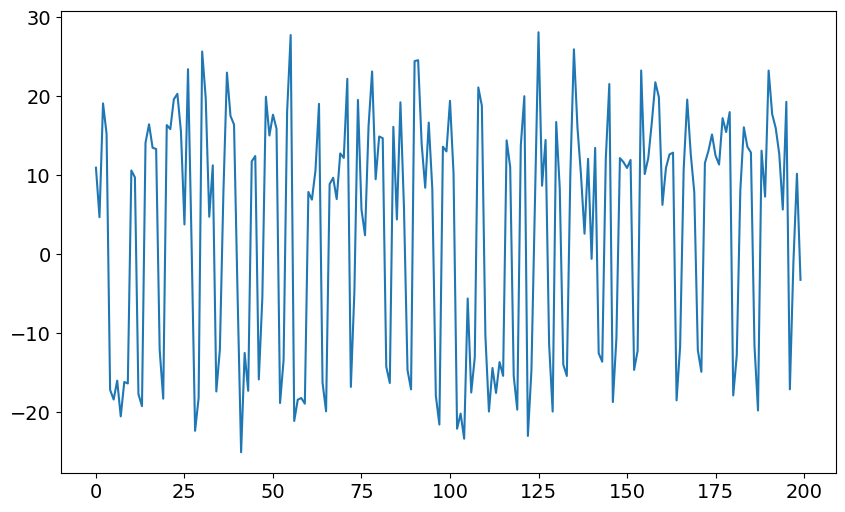

In [ ]:
plt.plot(ydata[50])

### Manipulate 1- Coupler 

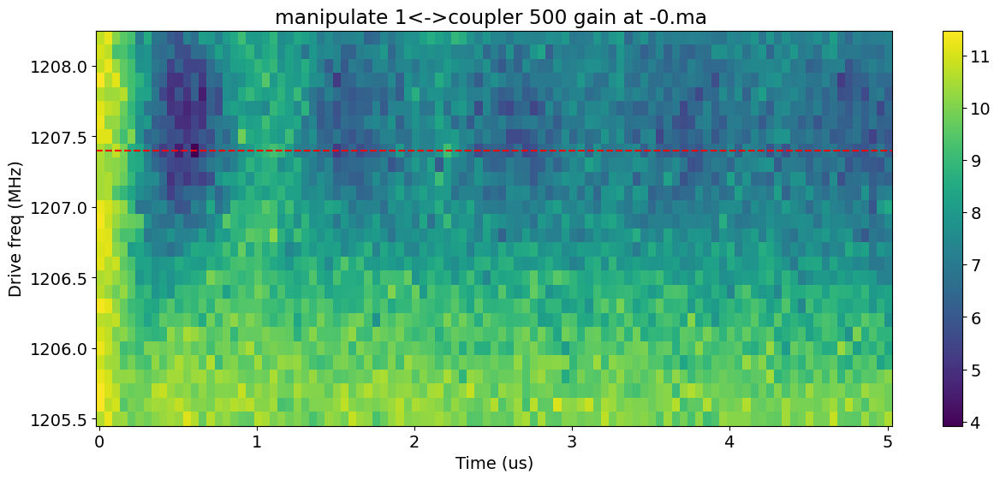

In [554]:
# file_list = #np.concatenate(( np.arange(11, 1211,1),np.arange(1111,1160,1)))
file_list = np.arange(167, 195
                      
                      ,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1207.4], vlines=None, title="manipulate 1<->coupler 500 gain at -0.ma ")

In [ ]:
np.arange(1451, 1470,1)

Decay from avgi [us] 0.9203622614403676
Rate [MHz] 0.8588691741549183
Pi length from avgi data [us]: 0.6608310254971473
	Pi/2 length from avgi data [us]: 0.33041551274857367

Decay from avgq [us] 0.8880000000000001
Rate [MHz] 4.552554979494706
Pi length from avgq data [us]: 0.0575116978148678
Pi/2 length from avgq data [us]: 0.0287558489074339


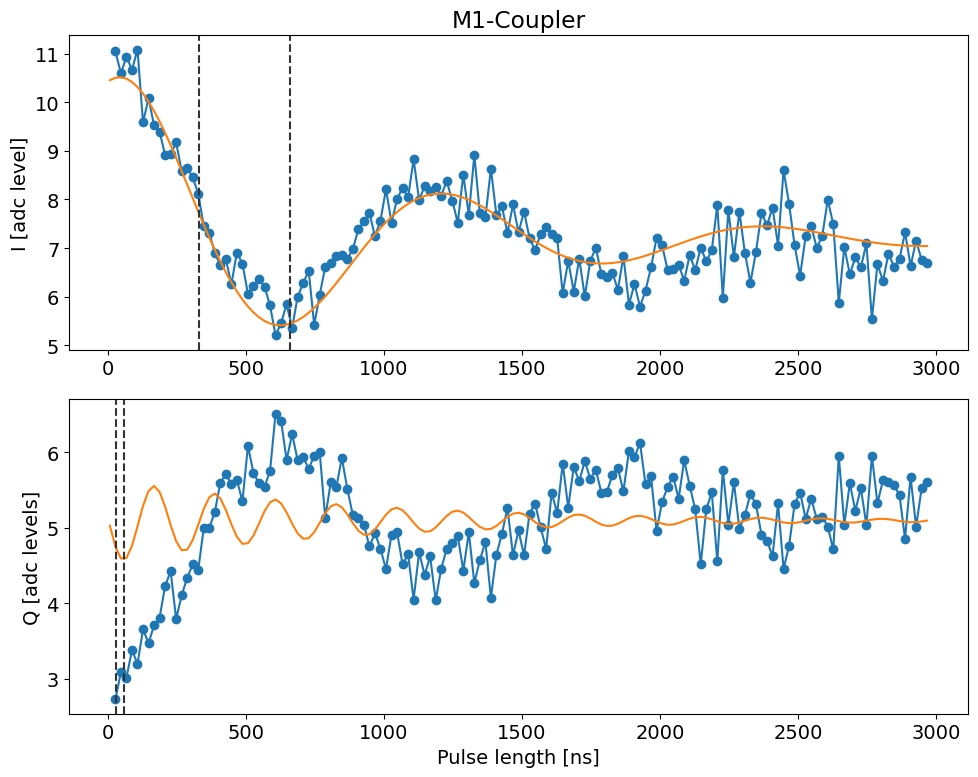

In [552]:
temp_data, attrs = prev_data(expt_path, '00010_SidebandGeneralExperiment.h5')
#fitparams=[amp, freq (non-angular), phase (deg), decay time, amp offset, decay time offset]
length_rabi_display(temp_data, fit=True,  title='M1-Coupler', fitparams=None)#[7, 2, None, 1, None, None],)

In [678]:
temp_data, attrs = prev_data(expt_path, '01283_sideband_general_sweep.h5')
attrs['config']['expt']

{'start': 0.007,
 'step': 0.06,
 'qubits': [0],
 'expts': 51,
 'reps': 100,
 'rounds': 1,
 'flux_drive': ['low', 840.6000000000001, 500, 0.005],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.1063715816226, 3425.0265059169296, 0, 2005.2],
  [3365, 2579, 0, 3000],
  [0.0, 0.0, 0.01, 0.744217976],
  [0, 0, 0, 0],
  [2, 2, 5, 5],
  ['gaussian', 'gaussian', 'flat_top', 'flat_top'],
  [0.03, 0.03, 0.005, 0.005]],
 'post_sweep_pulse': [[2005.2],
  [3000],
  [0.744217976],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'length_placeholder': 3.007}

## RF FLux Sideband Chevrons

### M1 - S1

#### Length rabi sweep

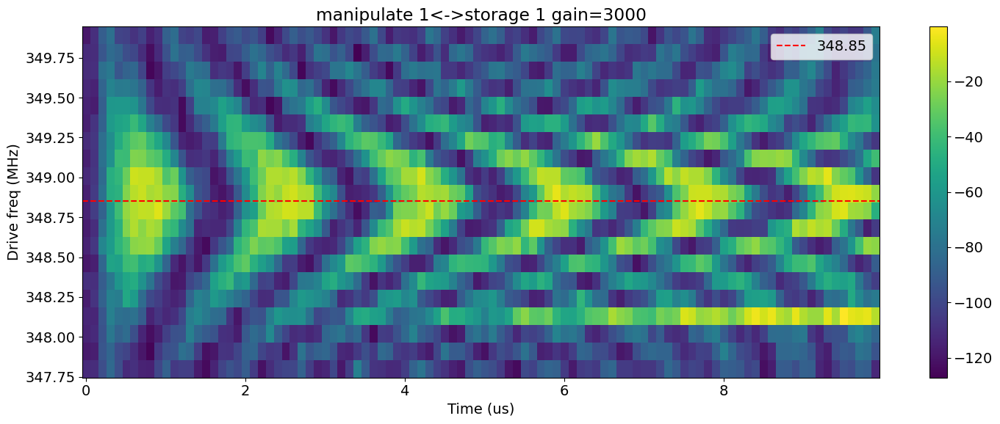

In [ ]:
# file_list = np.arange(74,94,1)
# file_list = np.arange(4027,4036,1)
file_list = np.arange(170,190,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
# name = '_storage_sideband_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    try:
        temp_data, attrs = prev_data(expt_path, full_name)  # ef
        signal_y = temp_data['avgq']
        len_x = temp_data['xpts']
        y_list.append(signal_y)
        freq_list.append(attrs['config']['expt']['flux_drive'][1])
    except FileNotFoundError:
        print(full_name)
        continue

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[348.85], vlines=None, title="manipulate 1<->storage 1 gain=3000")
    

In [29]:
import numpy as np
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt

# Define the decaying sine function
def decaying_sine(t, A, omega, phi, tau, C):
    """
    A decaying sine function.
    t: time
    A: amplitude
    omega: angular frequency
    phi: phase
    tau: decay constant
    C: offset
    """
    return A * np.sin(omega * t + phi) * np.exp(-t / tau) + C

# Function to fit a decaying sine curve to a single slice
def fit_slice(time, response):
    """
    Fit a decaying sine curve to a single frequency slice.
    time: array of time values
    response: array of response values
    Returns the fitted parameters and the contrast (max - min of the fitted curve).
    """
    # Initial guesses for the parameters: A, omega, phi, tau, C
    initial_guess = [np.ptp(response) / 2, 2 * np.pi / (time[-1] - time[0]), 0, (time[-1] - time[0]) / 2, np.mean(response)]
    
    try:
        # Fit the curve
        popt, _ = curve_fit(decaying_sine, time, response, p0=initial_guess)
        # Calculate the fitted curve
        fitted_curve = decaying_sine(time, *popt)
        # Calculate contrast
        contrast = np.max(fitted_curve) - np.min(fitted_curve)
        return popt, contrast
    except RuntimeError:
        # If the fit fails, return None and a contrast of 0
        return None, 0

# Main function to process all frequency slices
def process_2d_data(frequencies, time, response_matrix):
    """
    Process the 2D data to find the frequency with the largest contrast,
    and then refine the search around it to find the frequency with the longest period.
    frequencies: array of frequency values
    time: array of time values
    response_matrix: 2D array of response values (frequency x time)
    Returns the frequency with the largest contrast, the frequency with the longest period,
    and the best fit parameters for plotting.
    """
    max_contrast = 0
    best_frequency_contrast = None
    best_fit_params_contrast = None

    # Step 1: Find the frequency with the largest contrast
    for i, freq in enumerate(frequencies):
        response = response_matrix[i, :]
        fit_params, contrast = fit_slice(time, response)
        
        if fit_params is not None and contrast > max_contrast:
            max_contrast = contrast
            best_frequency_contrast = freq
            best_fit_params_contrast = fit_params

    # Step 2: Refine the search around the frequency with the largest contrast
    if best_frequency_contrast is not None:
        index = np.where(frequencies == best_frequency_contrast)[0][0]
        start = max(0, index - 2)  # 4-5 points around the best frequency
        end = min(len(frequencies), index + 3)
        
        longest_period = 0
        best_frequency_period = None
        best_fit_params_period = None

        for i in range(start, end):
            response = response_matrix[i, :]
            fit_params, _ = fit_slice(time, response)
            
            if fit_params is not None:
                period = 2 * np.pi / fit_params[1]  # Calculate period from angular frequency
                
                if period > longest_period:
                    longest_period = period
                    best_frequency_period = frequencies[i]
                    best_fit_params_period = fit_params

        return best_frequency_contrast, best_frequency_period, best_fit_params_contrast, best_fit_params_period
    else:
        return None, None, None, None



Best frequency (contrast): 348.79000000000013 Hz
Best frequency (period): 348.90000000000015 Hz
Best fit parameters (contrast): [ 55.62676889   3.59787779  -1.25606919 114.32775564 -57.26791155]
Best fit parameters (period): [-3.67713540e+04  5.52087333e-03  1.54311413e+00  2.81246022e+04
  3.67055057e+04]


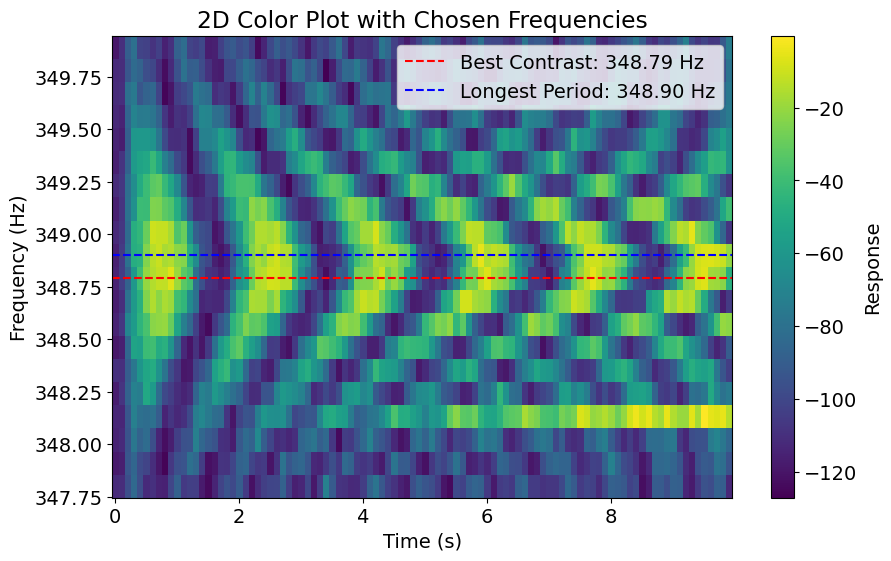

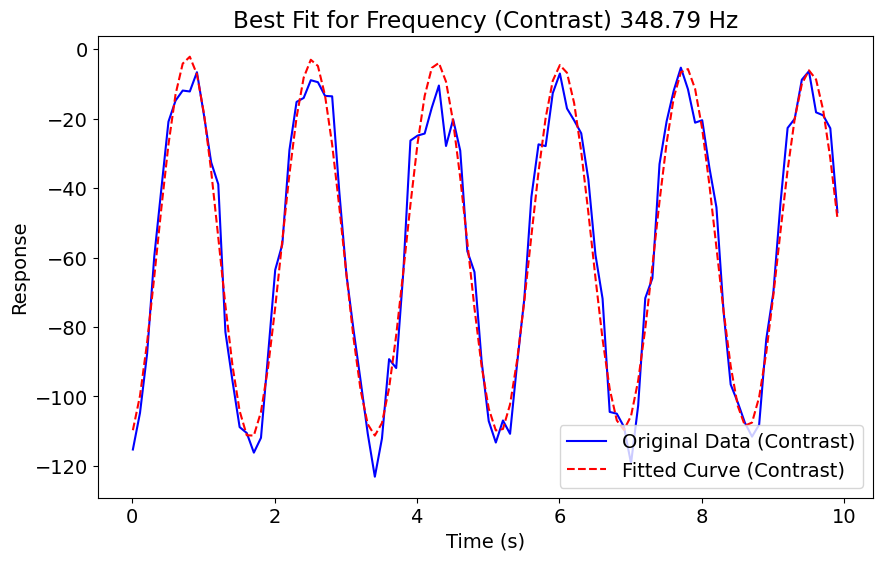

In [30]:
# Process the data
best_frequency_contrast, best_frequency_period, best_fit_params_contrast, best_fit_params_period = process_2d_data(frequencies, time, response_matrix)

# Print the results
print(f"Best frequency (contrast): {best_frequency_contrast} Hz")
print(f"Best frequency (period): {best_frequency_period} Hz")
print(f"Best fit parameters (contrast): {best_fit_params_contrast}")
print(f"Best fit parameters (period): {best_fit_params_period}")

# Plot the initial 2D color plot with red and blue lines for the chosen frequencies
plt.figure(figsize=(10, 6))
plt.pcolormesh(time, frequencies, response_matrix, shading='auto', cmap='viridis')
plt.colorbar(label='Response')
if best_frequency_contrast is not None:
    plt.axhline(best_frequency_contrast, color='red', linestyle='--', label=f'Best Contrast: {best_frequency_contrast:.2f} Hz')
if best_frequency_period is not None:
    plt.axhline(best_frequency_period, color='blue', linestyle='--', label=f'Longest Period: {best_frequency_period:.2f} Hz')
plt.title('2D Color Plot with Chosen Frequencies')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.legend()
plt.show()

# Plot the best fit for the chosen frequency (contrast)
if best_fit_params_contrast is not None:
    best_index_contrast = np.argmin(np.abs(frequencies - best_frequency_contrast))
    best_response_contrast = response_matrix[best_index_contrast, :]
    fitted_curve_contrast = decaying_sine(time, *best_fit_params_contrast)

    plt.figure(figsize=(10, 6))
    plt.plot(time, best_response_contrast, 'b-', label="Original Data (Contrast)")
    plt.plot(time, fitted_curve_contrast, 'r--', label="Fitted Curve (Contrast)")
    plt.title(f"Best Fit for Frequency (Contrast) {best_frequency_contrast:.2f} Hz")
    plt.xlabel("Time (s)")
    plt.ylabel("Response")
    plt.legend()
    plt.show()



In [14]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# Define the Lorentzian function
def lorentzian(f, A, f0, gamma, C):
    return A * (gamma**2 / ((f - f0)**2 + gamma**2)) + C

# Example 2D data (frequency, time, amplitude)
# Replace this with your actual data
frequencies = freq_list  # Frequency axis
times = len_x         # Time axis
data = np.array(y_list)  # Replace with actual amplitude data

# Initialize an array to store resonant frequencies
resonant_frequencies = []

# Loop over each time slice
for i, time_slice in enumerate(data):
    # Perform Lorentzian fitting
    try:
        # Initial guesses for A, f0, gamma, C
        initial_guess = [1, frequencies[np.argmax(time_slice)], 1, 0]
        popt, _ = curve_fit(lorentzian, frequencies, time_slice, p0=initial_guess)
        f0 = popt[1]  # Extract the resonant frequency
        resonant_frequencies.append(f0)
    except RuntimeError:
        # If the fit fails, append NaN
        resonant_frequencies.append(np.nan)

# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(times, resonant_frequencies, marker='o', label='Resonant Frequency')
plt.xlabel('Time')
plt.ylabel('Resonant Frequency')
plt.title('Resonant Frequency vs. Time')
plt.legend()
plt.grid()
plt.show()

IndexError: list index out of range

In [18]:
len(frequencies)

20

Attempted to init fitparam 1 to 0.001, which is out of bounds 0.01020408163265306 to 1.530612244897959. Instead init to 0.770408163265306
Attempted to init fitparam 4 to 51.4046955736224, which is out of bounds -30.012666666666668 to 31.62770731707317. Instead init to 0.8075203252032512
[ 5.00000000e+01  5.67778924e-01  1.09697106e+02  2.65580753e+07
  5.28323023e+01 -9.79300000e+00]
Decay from avgi [us] 26558075.345133163
Rate [MHz] 0.5677789238725556
Pi length from avgi data [us]: 0.7842591523264502
	Pi/2 length from avgi data [us]: 0.3439469295780846
Fit params:  [ 5.00000000e+01  5.67778924e-01  1.09697106e+02  2.65580753e+07
  5.28323023e+01 -9.79300000e+00]

Decay from avgq [us] 22.26077398551292
Rate [MHz] 0.566165701041067
Pi length from avgq data [us]: 0.7773274919964552
Pi/2 length from avgq data [us]: 0.3886637459982276
Fit params:  [ 50.           0.5661657  111.5653808   22.26077399  -0.33755787
  -9.793     ]


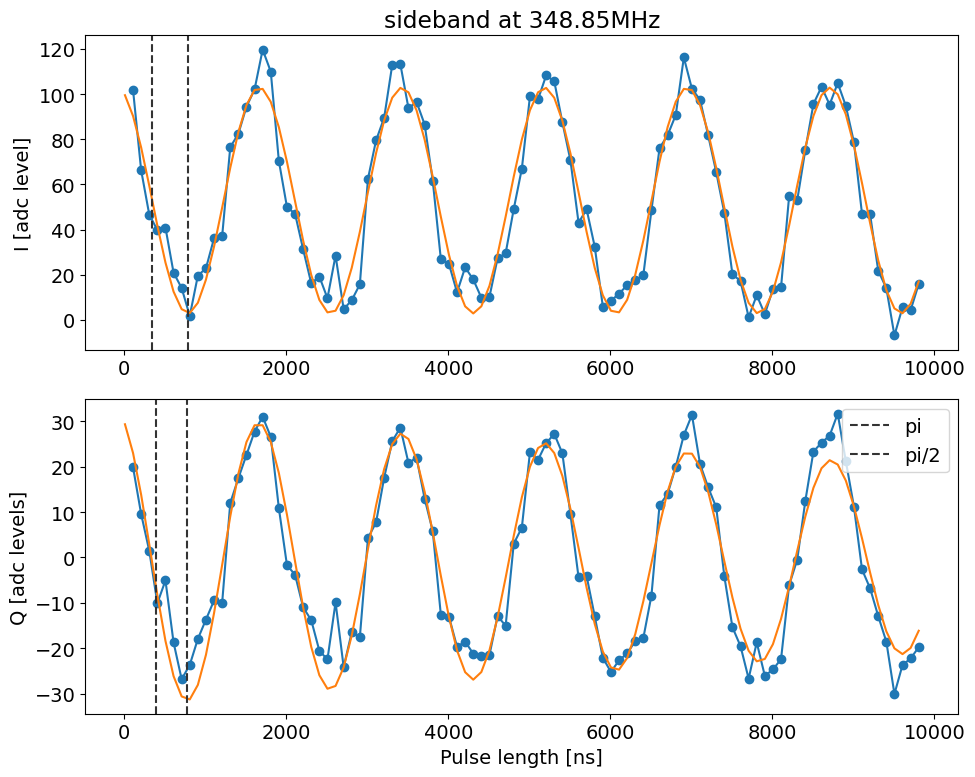

array([100.09679675, 101.6944878 ,  66.21011382,  46.58193496,
        39.75495935,  40.83700813,  20.87621138,  14.08326829,
         1.74076423,  19.56944715,  22.84700813,  36.13790244,
        37.10079675,  76.49554472,  82.36656911,  94.39164228,
       102.03053659, 119.66004878, 109.92595122,  70.38458537,
        49.96107317,  46.97282927,  31.21305691,  16.1479187 ,
        19.15471545,   9.57056911,  28.47515447,   4.71419512,
         8.70549593,  15.6961626 ,  62.42804878,  79.45817886,
        89.46102439, 112.95822764, 113.24487805,  93.75484553,
        96.50143089,  86.50011382,  61.60708943,  26.85943089,
        24.73785366,  12.15900813,  23.22547967,  17.86741463,
         9.80952846,  10.19297561,  27.1700813 ,  29.50682927,
        49.08095935,  66.94686179,  98.91118699,  97.64713821,
       108.21678049, 105.67349593,  87.55479675,  70.61330081,
        43.05252033,  48.88639024,  32.36079675,   5.86068293,
         8.46478049,  11.57001626,  15.34297561,  17.53

In [33]:
# temp_data, attrs = prev_data(expt_path, '00007_SidebandGeneralExperiment.h5')
temp_data, attrs = prev_data(expt_path, '00001_SidebandGeneralExperiment.h5')   
length_rabi_display(temp_data, fit=True, fitparams=[100, 0.001, None, None, None, None], active_reset=False, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

In [36]:
freq = attrs['config']['expt']['flux_drive'][1] 
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M1-S1', freq, 0.01, pi_length, pi2_length, gain)

In [37]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,348.850,0.01,0.784259,0.343947,3000,2025-03-11 12:35:25.500986
1,M1-S2,521.230,0.05,1.069160,0.531718,5000,2025-01-21 16:17:17.763411
2,M1-S3,696.980,0.03,1.256963,0.613370,9000,2025-01-21 16:17:39.113328
3,M1-S4,874.500,0.05,1.087371,0.539636,9000,2025-03-10 16:38:50.696707
4,M1-S5,1053.950,0.03,1.882097,0.985547,7500,2025-01-21 16:18:31.141469
5,M1-S6,1245.525,0.03,1.500950,0.732998,13500,2025-01-21 16:32:20.759195
6,M1-S7,1423.275,0.03,2.153588,1.085899,10000,2025-01-21 16:32:02.177572
7,M1-S8,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3


In [93]:
attrs['config']['expt']

{'start': 45,
 'step': 0.1,
 'qubits': [0],
 'expts': 100,
 'reps': 300,
 'rounds': 1,
 'flux_drive': ['low', 349.43999999999994, 3000, 0.005],
 'prepulse': True,
 'postpulse': True,
 'active_reset': False,
 'man_reset': True,
 'storage_reset': True,
 'pre_sweep_pulse': [[3568.1904347121535, 3425.5537944060666, 2007.09],
  [10819, 8327, 15000],
  [0, 0, 0.615286689634651],
  [0, 0, 0],
  [2, 2, 0],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2007.09],
  [15000],
  [0.615286689634651],
  [0],
  [0],
  ['flat_top'],
  [0.005]],
 'length_placeholder': 54.9}

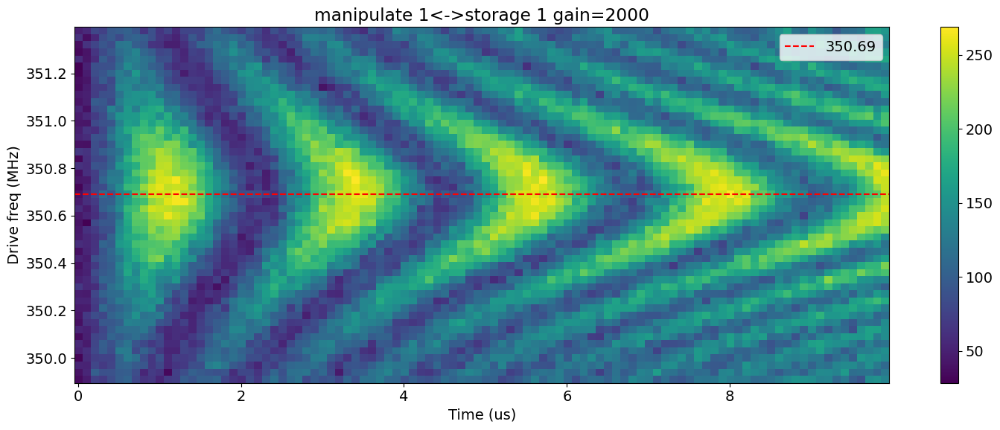

In [45]:
# file_list = np.arange(135,146,1)
file_list = np.arange(779,829,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
# name = '_storage_sideband_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[350.69], vlines=None, title="manipulate 1<->storage 1 gain=2000")
    

In [428]:
def find_on_resonant_frequency(y_list, time_points, frequency_points, fitparams=None):
    """
    Finds the on-resonant frequency and its oscillation rate from a Chevron plot using curve fitting.
    
    Parameters:
    y_list (np.ndarray): 2D array where rows correspond to different frequencies and columns correspond to time points.
    time_points (np.ndarray): 1D array of time points corresponding to the columns of y_list.
    frequency_points (np.ndarray): 1D array of frequency points corresponding to the rows of y_list.
    
    Returns:
    tuple: On-resonant frequency and its oscillation rate.
    """
    max_amplitude = 0
    min_rate = 99999
    on_resonant_frequency = None
    on_resonant_rate = None
    on_resonant_id = None
    
    for i, row in enumerate(y_list):
        # Initial guess for the parameters: amplitude, decay rate, frequency, phase, offset
        # initial_guess = [np.max(row) - np.min(row), 5, 1, 0, np.mean(row)]
        print(i)
        
        try:
            # Perform the curve fitting
            popt, _ = fitter.fitdecaysin(
                    time_points, row, fitparams=fitparams)
            
            
            # Calculate the oscillation rate (as frequency)
            oscillation_rate = popt[1]
            
            # # Check if this frequency has the maximum amplitude
            # if np.abs(popt[0]) > max_amplitude:
            #     max_amplitude = np.abs(popt[0])
            #     on_resonant_frequency = frequency_points[i]
            #     on_resonant_rate = oscillation_rate
            
            # Check if this frequency has the slowst rate (looks more robust)
            print(np.abs(oscillation_rate))
            if np.abs(oscillation_rate) < min_rate and np.abs(popt[0]) > (0.8 * max_amplitude): 
                # the second condition is to block pathological cases where rsonant frequency is not near where amp is max
                max_amplitude = np.abs(popt[0])
                min_rate = np.abs(oscillation_rate)
                on_resonant_frequency = frequency_points[i]
                on_resonant_rate = oscillation_rate
                on_resonant_id = i
                
        except RuntimeError:
            # If the fit fails, we skip this frequency
            continue
    
    return on_resonant_frequency, on_resonant_rate, on_resonant_id

#### Length Rabi

Attempted to init fitparam 4 to -9.462884852384853, which is out of bounds 12.174006493506493 to 16.502967532467533. Instead init to 14.338487012987013



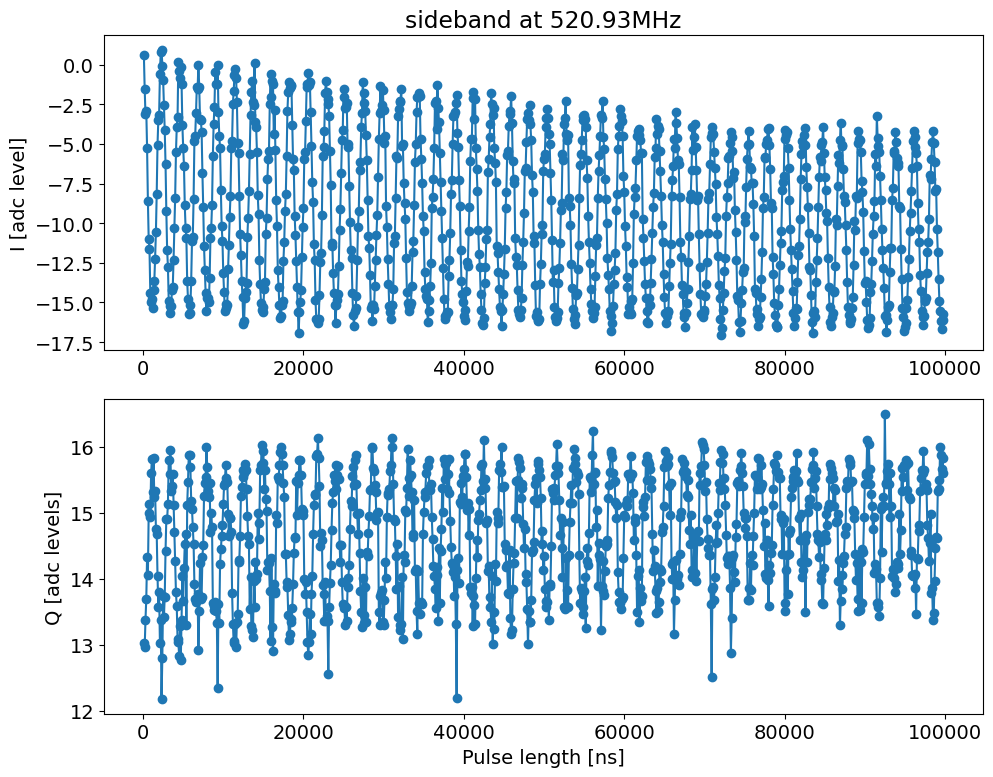

In [86]:
# temp_data, attrs = prev_data(expt_path, '00004_SidebandGeneralExperiment.h5')
temp_data, attrs = prev_data(expt_path, '00085_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=False, fitparams=[13, 0.1, None, None, None, None], active_reset=False, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

In [32]:

temp_data, attrs = prev_data(expt_path, '00001_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00000_rb_bs_optimization.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz', active_reset=True, readout_per_round=4, threshold=-23)

ValueError: Invalid number of FFT data points (0) specified.

In [29]:
freq = attrs['config']['expt']['flux_drive'][1] 
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M1-S1', freq, 0.01, pi_length, pi2_length, gain)

In [30]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.410,0.01,0.915023,0.450925,3000,2024-10-22 09:32:09.542335
1,M1-S2,520.930,0.05,1.055448,0.522985,5000,2024-10-10 09:54:34.968490
2,M1-S3,696.660,0.05,1.252305,0.624012,9000,2024-10-10 09:44:55.996470
3,M1-S4,875.825,0.05,1.185166,0.586429,9000,2024-10-10 10:00:27.299587
4,M1-S5,1053.405,0.05,1.850023,0.924456,7500,2024-10-10 10:10:15.658400
5,M1-S6,1245.170,0.05,1.501549,0.748369,13500,2024-10-10 10:15:45.066438
6,M1-S7,1423.155,0.01,1.291502,0.639894,16500,2024-10-10 10:20:49.676156
7,M1-S8,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3


##### With passive reset on man and storage

[211.86632237   0.53897796  89.95486697 310.21782786 -77.2927105
   3.14482977]
Decay from avgi [us] 310.21782786351883
Rate [MHz] 0.5389779627035418
Pi length from avgi data [us]: 0.9279143195549451
	Pi/2 length from avgi data [us]: 0.464073462785984
Fit params:  [211.86632237   0.53897796  89.95486697 310.21782786 -77.2927105
   3.14482977]

Decay from avgq [us] 145.27240932139108
Rate [MHz] 0.5387893354024481
Pi length from avgq data [us]: 0.9264090427646015
Pi/2 length from avgq data [us]: 0.4632045213823007
Fit params:  [179.90844454   0.53878934  90.30984751 145.27240932 -83.61700735
  -4.15660309]


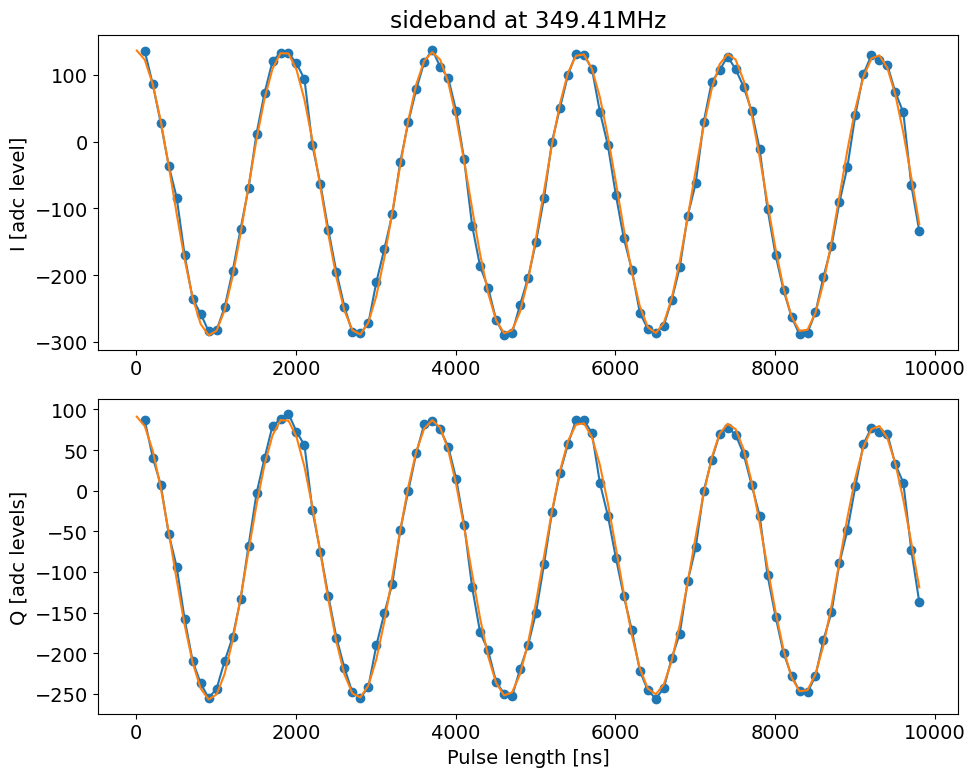

In [54]:
temp_data, attrs = prev_data(expt_path, '00070_SidebandGeneralExperiment.h5')
temp_data, attrs = prev_data(expt_path, '00114_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00037_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=[250, None, None, None, None, None], active_reset=False,threshold=-4.3, readout_per_round=4,
                     title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

In [1151]:
attrs['config']['expt']

{'start': 0.007,
 'step': 0.05,
 'qubits': [0],
 'expts': 100,
 'reps': 500,
 'rounds': 1,
 'flux_drive': ['low', 349.41, 3000, 0.005],
 'prepulse': True,
 'postpulse': True,
 'active_reset': True,
 'man_reset': True,
 'storage_reset': True,
 'pre_sweep_pulse': [[3568.1904347121535, 3425.5537944060666, 2006.72],
  [9653, 7575, 15000],
  [0, 0, 0.6168960348389007],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2006.72],
  [15000],
  [0.6168960348389007],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'length_placeholder': 4.957}

In [1134]:
attrs['config']['expt']

{'start': 0.007,
 'step': 0.05,
 'qubits': [0],
 'expts': 100,
 'reps': 500,
 'rounds': 1,
 'flux_drive': ['high', 349.41, 3000, 0.005],
 'prepulse': True,
 'postpulse': True,
 'active_reset': False,
 'man_reset': False,
 'storage_reset': False,
 'pre_sweep_pulse': [[3568.1904347121535, 3425.5537944060666, 2006.72],
  [9653, 7575, 15000],
  [0, 0, 0.6168960348389007],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2006.72],
  [15000],
  [0.6168960348389007],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'length_placeholder': 4.957}

Attempted to init fitparam 4 to -1.6080274170274171, which is out of bounds -0.3458246753246753 to 16.503902597402597. Instead init to 8.079038961038961
[ 13.83979197   0.50244333  91.02065331 426.74086001  -1.75069712
   5.39331207]
Decay from avgi [us] 426.7408600124034
Rate [MHz] 0.5024433271585131
Pi length from avgi data [us]: 0.9894943868406889
	Pi/2 length from avgi data [us]: 0.49474719342034446
Fit params:  [ 13.83979197   0.50244333  91.02065331 426.74086001  -1.75069712
   5.39331207]

Decay from avgq [us] 106.4009710072286
Rate [MHz] 0.5026323073233923
Pi length from avgq data [us]: 0.9918265262606367
Pi/2 length from avgq data [us]: 0.49591326313031836
Fit params:  [  8.64979011   0.50263231 -89.46865993 106.40097101   8.09913501
  -2.84117314]


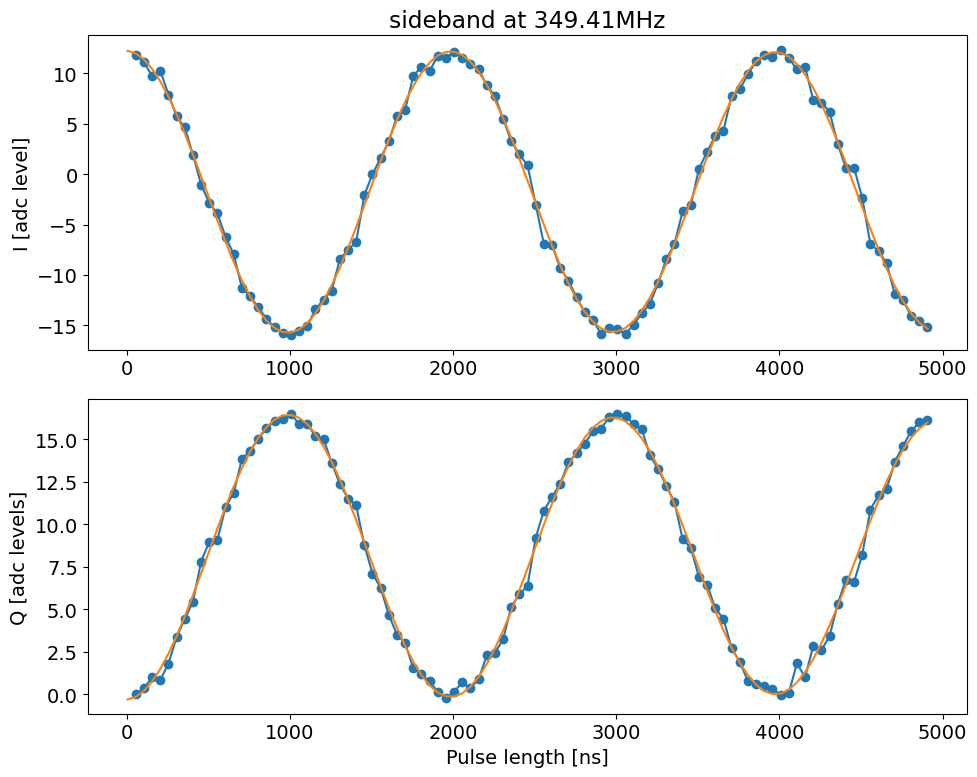

In [620]:
temp_data, attrs = prev_data(expt_path, '00044_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=[13, 0.1, None, None, None, None], 
                    title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz',
                    active_reset=False, readout_per_round=4, threshold=-4.0)

In [617]:
len(temp_data['idata'][0])

2000

In [57]:
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M1-S1', freq, 0.01, pi_length, pi2_length, gain)

In [58]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.41,0.01,0.927914,0.464073,3000,2024-10-09 13:53:04.780058
1,M1-S2,520.93,0.05,1.128904,0.564452,5000,03:56.9
2,M1-S3,696.66,0.05,1.343910,0.671955,9000,50:58.0
3,M1-S4,875.83,0.05,1.275784,0.637892,9000,44:30.4
4,M1-S5,1053.42,0.05,1.956004,0.978002,7500,04:59.0
5,M1-S6,1245.18,0.05,1.605961,0.802981,13500,04:56.2
6,M1-S7,1423.15,0.01,1.372788,0.686394,16500,28:43.5
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


#### Fidelity limit vs gain

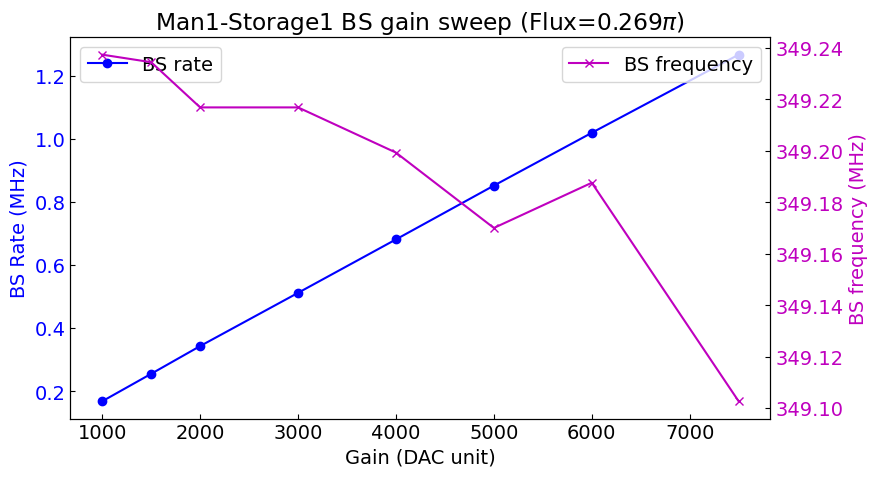

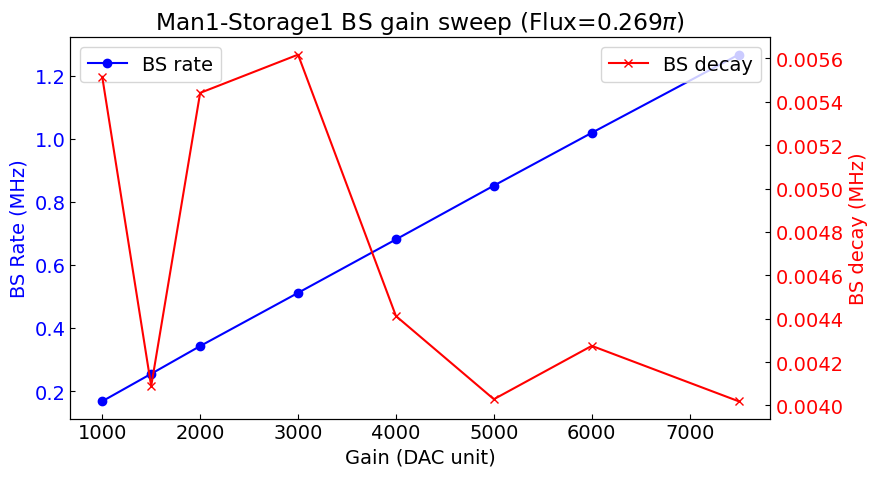

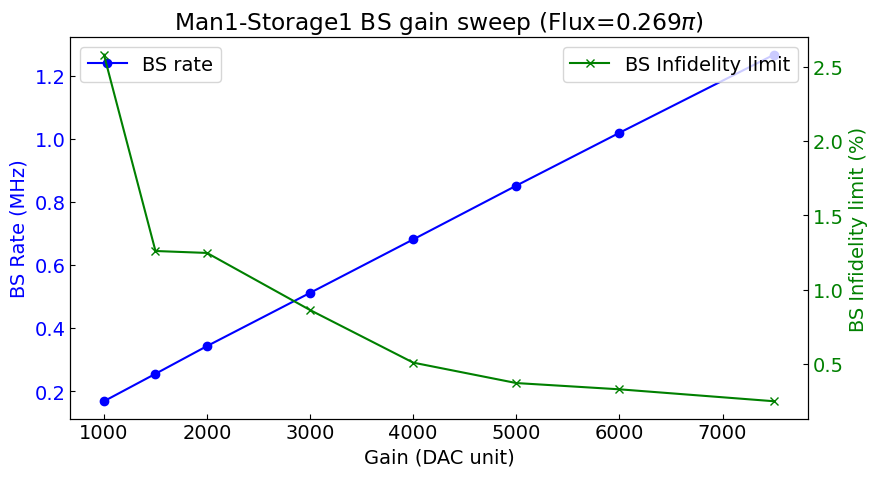

In [641]:
Fidelity_list = [0.9741955687164431, 0.987401246691468, 0.9875317305909992, 0.9913733417252315, 0.9949094204964168, 0.9962826850276068, 0.9967038079751553, 0.9975068957091983]
kappa1_list = [0.005514986541944957, 0.004088651367540104, 0.005441045389357829, 0.005617281709934514, 0.004412170721036704, 0.004028674509959494, 0.004274646407830854, 0.0040192564127688795]
kappa_phi_list = [-0.001964306221768682, -0.00021835318965308633, -0.002066957671082819, -0.008745615383573466, -0.00037473332178033624, -0.0011885382036071462, -0.0003251298441777229, -9.868964160165625e-05]
rate_list = [0.16785722783843368, 0.2548838917787033, 0.34274099440607575, 0.5114150343908294, 0.6807301169658733, 0.8511825294726657, 1.0185387903916323, 1.266179123135241]
gain_list = [1000, 1500, 2000, 3000, 4000, 5000, 6000, 7500]
freq_res_list = [349.2373828125, 349.234453125, 349.216875, 349.216875, 349.199296875, 349.17, 349.187578125, 349.1026171875]

kappa_bs_list = []
for i, a in enumerate(kappa1_list):
    if kappa_phi_list[i] < 0:
        kappa_bs_list.append(a)
    else:
        kappa_bs_list.append(a + kappa_phi_list[i])

# Create a figure and a set of subplots
fig, ax1 = plt.subplots(figsize=(9, 5))

# Plot the first dataset on the primary y-axis
ax1.plot(gain_list, rate_list, color='b', marker='o', label='BS rate')
ax1.set_xlabel('Gain (DAC unit)')  # Set the x-axis label
ax1.set_ylabel('BS Rate (MHz)', color='blue')  # Set the primary y-axis label
ax1.tick_params(axis='y', labelcolor='blue')  # Color the y-axis ticks
ax1.tick_params(axis='both', direction='in')
plt.legend()

# Create a secondary y-axis
ax2 = ax1.twinx()
ax2.plot(gain_list, freq_res_list, color='m', marker='x', label='BS frequency')
ax2.set_ylabel('BS frequency (MHz)', color='m')  # Set the secondary y-axis label
ax2.tick_params(axis='y', labelcolor='m')  # Color the secondary y-axis ticks
ax2.tick_params(axis='both',  direction='in')

# Optionally, add a title and a legend
plt.title('Man1-Storage1 BS gain sweep (Flux=0.269$\pi$)')
plt.legend()
fig.tight_layout()  # Adjust layout to prevent overlap

# Show the plot
plt.show()

# Create a figure and a set of subplots
fig, ax1 = plt.subplots(figsize=(9, 5))

# Plot the first dataset on the primary y-axis
ax1.plot(gain_list, rate_list, color='b', marker='o', label='BS rate')
ax1.set_xlabel('Gain (DAC unit)')  # Set the x-axis label
ax1.set_ylabel('BS Rate (MHz)', color='blue')  # Set the primary y-axis label
ax1.tick_params(axis='y', labelcolor='blue')  # Color the y-axis ticks
ax1.tick_params(axis='both', direction='in')
plt.legend()

# Create a secondary y-axis
ax2 = ax1.twinx()
ax2.plot(gain_list, kappa_bs_list, color='r', marker='x', label='BS decay')
ax2.set_ylabel('BS decay (MHz)', color='r')  # Set the secondary y-axis label
ax2.tick_params(axis='y', labelcolor='r')  # Color the secondary y-axis ticks
ax2.tick_params(axis='both',  direction='in')

# Optionally, add a title and a legend
plt.title('Man1-Storage1 BS gain sweep (Flux=0.269$\pi$)')
plt.legend()
fig.tight_layout()  # Adjust layout to prevent overlap

# Show the plot
plt.show()

fig, ax1 = plt.subplots(figsize=(9, 5))

# Plot the first dataset on the primary y-axis
ax1.plot(gain_list, rate_list, color='b', marker='o', label='BS rate')
ax1.set_xlabel('Gain (DAC unit)')  # Set the x-axis label
ax1.set_ylabel('BS Rate (MHz)', color='blue')  # Set the primary y-axis label
ax1.tick_params(axis='y', labelcolor='blue')  # Color the y-axis ticks
ax1.tick_params(axis='both', direction='in')
plt.legend()

# Create a secondary y-axis
ax2 = ax1.twinx()
ax2.plot(gain_list, [100*(1-x) for x in Fidelity_list], color='g', marker='x', label='BS Infidelity limit')
ax2.set_ylabel('BS Infidelity limit (%)', color='g')  # Set the secondary y-axis label
ax2.tick_params(axis='y', labelcolor='g')  # Color the secondary y-axis ticks
ax2.tick_params(axis='both',  direction='in')

# Optionally, add a title and a legend
plt.title('Man1-Storage1 BS gain sweep (Flux=0.269$\pi$)')
plt.legend()
fig.tight_layout()  # Adjust layout to prevent overlap

# Show the plot
plt.show()

##### Decay Dual rail

Attempted to init fitparam 1 to 0.8500000000000001, which is out of bounds 0.0025031289111389237 to 0.37546933667083854. Instead init to 0.18898623279098872
Decay from avgi [us] 27.991449631554097
Rate [MHz] 0.24545438540933118
Pi length from avgi data [us]: 1.2002627710705507
	Pi/2 length from avgi data [us]: 0.6001313855352753


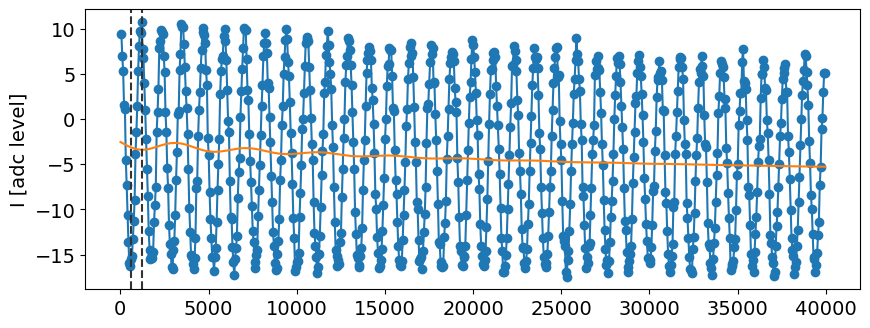

In [514]:
cutoff = 1000
data = temp_data
fitparams=[25, None,180 , None, None, None, None, None]
fitparams = None

p_avgi, pCov_avgi = fitter.fitdecaysin_dualrail(
        data['xpts'][:cutoff], data["avgi"][:cutoff], fitparams=fitparams)
data['fit_avgi'] = p_avgi

data['fit_err_avgi'] = pCov_avgi


xpts_ns = data['xpts']*1e3

    # ## normalize data 
    # if normalize: 
    #     def normalize_data(data, min_val, max_val): 
    #         return (data - min_val) / (max_val - min_val)
    #     avgi = normalize_data(data['avgi'], data['g_data']['avgi'], data['f_data']['avgi'])
    #     avgq = normalize_data(data['avgq'], data['g_data']['avgq'], data['f_data']['avgq'])
    # else:
    #     avgi = data['avgi']
    #     avgq = data['avgq']
plt.figure(figsize=(10, 8))

axi = plt.subplot(
    211, ylabel="I [adc level]")
plt.plot(xpts_ns[1:cutoff], data["avgi"][1:cutoff], 'o-')

p = data['fit_avgi']
# plt.plot(xpts_ns[0:cutoff], fitter.decaysin_dualrail(data["xpts"][0:cutoff], *p))
if p[2] > 180:
    p[2] = p[2] - 360
elif p[2] < -180:
    p[2] = p[2] + 360
if p[2] < 0:
    pi_length = (1/2 - p[2]/180)/2/p[1]
else:
    pi_length = (3/2 - p[2]/180)/2/p[1]
pi2_length = pi_length/2
print('Decay from avgi [us]', p[3])
print('Rate [MHz]', p[1])
print(f'Pi length from avgi data [us]: {pi_length}')
print(f'\tPi/2 length from avgi data [us]: {pi2_length}')
plt.axvline(pi_length*1e3, color='0.2', linestyle='--')
plt.axvline(pi2_length*1e3, color='0.2', linestyle='--')

#### RB Check

In [249]:
#temp_data, attrs = prev_data(expt_path, '00080_SingleBeamSplitterRB.h5')
# temp_data, attrs = prev_data(expt_path, '00178_SingleBeamSplitterRB.h5')
temp_data, attrs = prev_data(expt_path, '00179_SingleBeamSplitterRB.h5')
#temp_data, attrs = prev_data(expt_path, '00017_SingleBeamsplitterRB_sweep_depth.h5')
avg_readout = []
for i in range(len(temp_data['Idata'])):
    counting = 0
    for j in temp_data['Idata'][i]:
        if j>temp_data['thresholds']:
            counting += 1
    avg_readout.append(counting/len(temp_data['Idata'][i]))
#
# avg_readout = RB_extract(temp_data)
mean = np.average(avg_readout)
err = np.std(avg_readout)/np.sqrt(len(avg_readout))
print(mean, err)

0.9097666666666666 0.002755472669004292


#### RB Check Active Reset

In [25]:
def filter_data_BS(a1, a2, a3, threshold):
    # assume the last one is experiment data, the last but one is for post selection
    result_1 = []
    result_2 = []
    
    
    for k in range(len(a1)):

        if a1[k] < threshold:

            result_1.append(a2[k])
            result_2.append(a3[k])
    
    return np.array(result_1), np.array(result_2)

In [35]:
#temp_data, attrs = prev_data(expt_path, '00080_SingleBeamSplitterRB.h5')
 

0.7450296829688432 0.0026451582346640073


In [40]:
#temp_data, attrs = prev_data(expt_path, '00080_SingleBeamSplitterRB.h5')
temp_data, attrs = prev_data(expt_path, '00106_SingleBeamSplitterRBPostSelection.h5')
#temp_data, attrs = prev_data(expt_path, '00017_SingleBeamsplitterRB_sweep_depth.h5')
avg_readout = []
active_reset_selection = False
for i in range(len(temp_data['Idata'])):
    counting = 0
    #  post selection
    if active_reset_selection:
        raw_data, post_select_data = filter_data_BS(temp_data['Idata'][i][2], temp_data['Idata'][i][3], temp_data['Idata'][i][4], temp_data['thresholds'])
    else:
        raw_data = temp_data['Idata'][i][3]
        post_select_data = temp_data['Idata'][i][4]
    
    for j in raw_data:
        if j<temp_data['thresholds']:
            counting += 1
    avg_readout.append(counting/len(raw_data))
#
# avg_readout = RB_extract(temp_data)
mean = np.average(avg_readout)
err = np.std(avg_readout)/np.sqrt(len(avg_readout))
print(mean, err)

0.9311000000000001 0.0025048952073889186


In [41]:
avg_readout

[0.928,
 0.944,
 0.935,
 0.938,
 0.926,
 0.934,
 0.943,
 0.938,
 0.94,
 0.95,
 0.936,
 0.929,
 0.928,
 0.932,
 0.933,
 0.936,
 0.902,
 0.923,
 0.916,
 0.911]

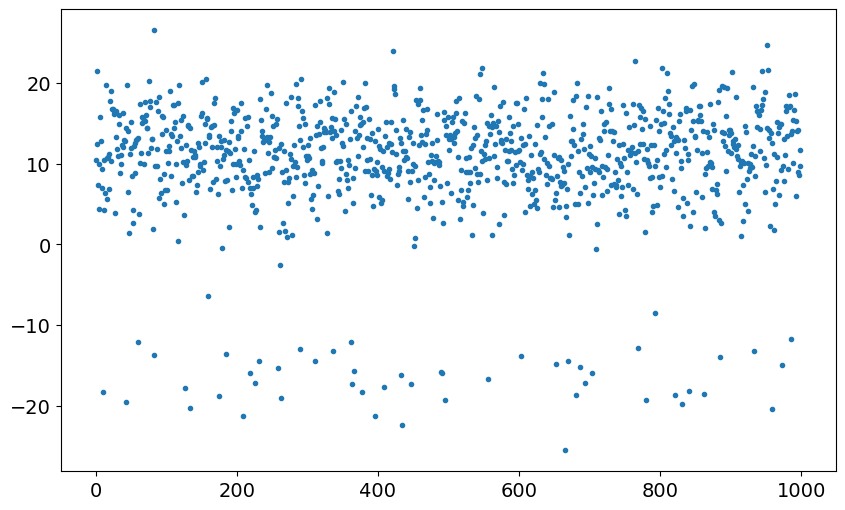

In [33]:
plt.plot(temp_data['Idata'][5][4],'.')

#### Post Selection with Active Reset

In [45]:
# def filter_data_BS(a1, a2, a3, threshold):
#     # assume the last one is experiment data, the last but one is for post selection
#     result_1 = []
#     result_2 = []
    
    
#     for k in range(len(a1)):

#         if a1[k] < threshold:

#             result_1.append(a2[k])
#             result_2.append(a3[k])
    
#     return np.array(result_1), np.array(result_2)
# def RB_extract_postselction_excited(temp_data, active_reset = False):
#     # remember the parity mapping rule:
#     # 00 -> eg, 01 -> ee, 10 -> ge, 11 -> gg
#     gg_list = []
#     ge_list = []
#     eg_list = []
#     ee_list = []
#     fid_raw_list = []
#     fid_post_list = []


#     for aa in range(len(temp_data['Idata'])):
#         gg = 0
#         ge = 0
#         eg = 0
#         ee = 0

#         #  post selection due to active reset
#         if active_reset:
#             data_init, data_post_select = filter_data_BS(temp_data['Idata'][aa][2], temp_data['Idata'][aa][3], temp_data['Idata'][aa][4], temp_data['thresholds'])
#         else: 
#             data_init = temp_data['Idata'][aa][0]
#             data_post_select = temp_data['Idata'][aa][1]
        
#         # beamsplitter post selection 
#         for j in range(len(data_init)):
#             #  check if the counts are the same as initial counts
#             if data_init[j]>temp_data['thresholds'][0]: # classified as e
#                 if data_post_select[j]>temp_data['thresholds'][0]:  # second e
#                     ee += 1
#                 else:
#                     eg +=1
#             else:  # classified as g
#                 if data_post_select[j]>temp_data['thresholds'][0]:  # second e
#                     ge +=1
#                 else:
#                     gg += 1
#         gg_list.append(gg/(eg+ge+gg+ee))
#         ge_list.append(ge/(eg+ge+gg+ee))
#         eg_list.append(eg/(eg+ge+gg+ee))
#         ee_list.append(ee/(eg+ge+gg+ee))
#         fid_raw_list.append((ge+gg)/(eg+ge+gg+ee))
#         fid_post_list.append(ge/(ge+ee))
#     return fid_raw_list, fid_post_list, gg_list, ge_list, eg_list, ee_list

In [39]:
temp_data, attrs = prev_data(expt_path, '00275_SingleBeamSplitterRBPostSelection.h5')
# temp_data, attrs = prev_data(expt_path, '00081_SingleBeamSplitterRBPostSelection_sweep_depth.h5')
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, attrs,  active_reset = True)
print('Raw fidelity', np.average(avg_readout), np.std(avg_readout)/np.sqrt(len(avg_readout)))
print('Post Selection fidelity', np.average(avg_readout_post), np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))

using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new method to calculate post selection fidelity 
using new 

In [69]:
np.shape(temp_data['Idata'])

(30, 5, 1000)

In [48]:
temp_data['thresholds']

array([-5.60117512])

#### Post selection

In [288]:
temp_data, attrs = prev_data(expt_path, '00072_SingleBeamSplitterRBPostSelection.h5')
gg_list = []
ge_list = []
eg_list = []
ee_list = []
fid_raw_list = []
fid_post_list = []
for aa in range(len(temp_data['Idata'])):
    gg = 0
    ge = 0
    eg = 0
    ee = 0
    for j in range(len(temp_data['Idata'][aa][0])):
        #  check if the counts are the same as initial counts
        if temp_data['Idata'][aa][0][j]>temp_data['thresholds'][0]: # classified as e
            if temp_data['Idata'][aa][1][j]>temp_data['thresholds'][0]:  # second e
                ee += 1
            else:
                eg +=1
        else:  # classified as g
            if temp_data['Idata'][aa][1][j]>temp_data['thresholds'][0]:  # second e
                ge +=1
            else:
                gg += 1
    gg_list.append(gg)
    ge_list.append(ge)
    eg_list.append(eg)
    ee_list.append(ee)
    fid_raw_list.append((ge+gg)/(eg+ge+gg+ee))
    #fid_raw_list.append((eg+ee)/(eg+ge+gg+ee))
    fid_post_list.append((ge)/(ee+ge))
print('gg, ge, eg, ee:', gg, ge, eg, ee)
print('00, 01, 10, 11:', eg, ee, ge, gg)
# print('Fidelity after post selection: ', (eg)/(eg+ge))
# print('Fidelity before post selection: ', (eg)/(eg+ge+gg+ee))

# mapping: |00>->|eg>, |01>->|ee>, |10>->|ge>, |11>->|gg>

gg, ge, eg, ee: 11 579 375 35
00, 01, 10, 11: 375 35 579 11


In [289]:
print(np.average( fid_raw_list), np.std(fid_raw_list)/np.sqrt(len(fid_raw_list)))
print(np.average( fid_post_list), np.std(fid_post_list)/np.sqrt(len(fid_post_list)))

0.69005 0.008900414316198991
0.953863620141083 0.0030689133068018963


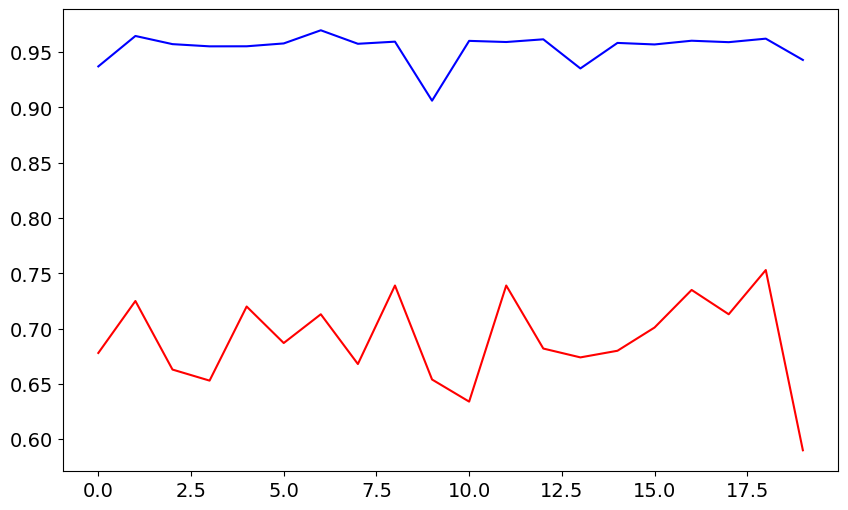

In [290]:
plt.plot(fid_raw_list, c='r')
plt.plot(fid_post_list, c='b')

#### Rb Depth sweep

[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
[349.4, 3000, 0.496739445101523, 0.005]
Fit Decay constant avgi [gates]: 293.48802989579787


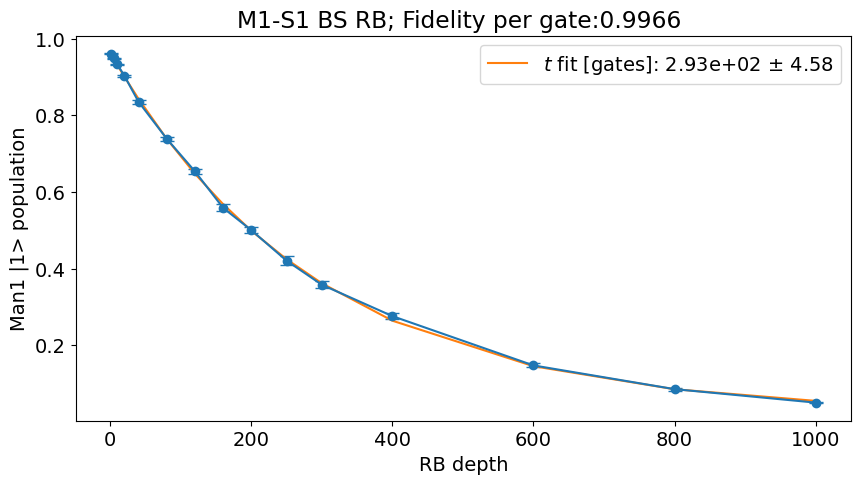

In [34]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
file_list = np.arange(15,30,1)
# file_list = np.arange(40,46,1)
name = '_SingleBeamsplitterRB_sweep_depth.h5'

plt.figure(figsize=(10,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    print(attrs['config']['expt']['bs_para'])
    avg_readout = RB_extract_excited(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'M1-S1 BS RB; Fidelity per gate:{np.exp(-1/fit[3]):.4f} ')
plt.legend()
plt.show()

In [245]:
fids_list

[0.9607666666666664,
 0.9485333333333332,
 0.9328333333333334,
 0.9027999999999999,
 0.8352,
 0.7387333333333331,
 0.6535000000000001,
 0.5581666666666666,
 0.5,
 0.42033333333333334,
 0.35756666666666675,
 0.2757,
 0.14706666666666665,
 0.08513333333333332,
 0.049999999999999996]

In [246]:
xlist

[1, 5, 10, 20, 40, 80, 120, 160, 200, 250, 300, 400, 600, 800, 1000]

##### With other modes displaced alpha =1 

Fit Decay constant avgi [gates] for Other modes Vaccum: 293.48802989579787
Fidelity per gate for Other modes Vaccum: 0.9966
Fit Decay constant avgi [gates] for Other modes displaced alpha = 1: 86.15379287288728
Fidelity per gate for Other modes displaced alpha = 1: 0.9885


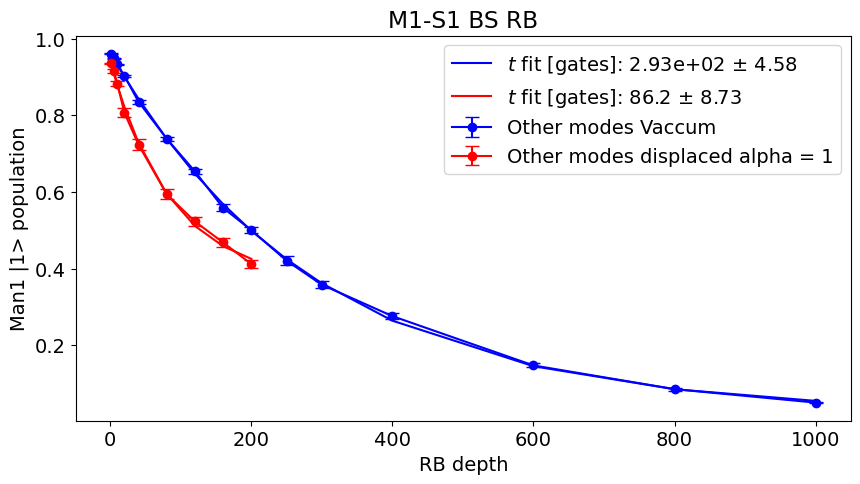

In [160]:
import numpy as np
import matplotlib.pyplot as plt

# Define two file lists
file_list1 = np.arange(15, 30, 1)
file_list2 = np.arange(154, 163, 1)
name = '_SingleBeamsplitterRB_sweep_depth.h5'

# Function to process and plot data for a given file list
def process_and_plot(file_list, label, color):
    fids_list = []
    xlist = []
    ebars_list = []
    for file_no in file_list:
        full_name = str(file_no).zfill(5) + name
        temp_data, attrs = prev_data(expt_path, full_name)
        avg_readout = RB_extract_excited(temp_data)
        fids_list.append(np.average(avg_readout))
        ebars_list.append(np.std(avg_readout) / np.sqrt(len(avg_readout)))
        xlist.append(attrs['config']['expt']['rb_depth'])
    plt.errorbar(xlist, fids_list, yerr=ebars_list, fmt='-o', label=label, color=color, capsize=5)

    # Fitting
    fit, err = fitter.fitexp(xlist, fids_list, fitparams=None)
    captionStr = f'$t$ fit [gates]: {fit[3]:.3} $\pm$ {np.sqrt(err[3][3]):.3}'
    plt.plot(xlist, fitter.expfunc(xlist, *fit), label=captionStr, color=color)
    print(f'Fit Decay constant avgi [gates] for {label}: {fit[3]}')
    print(f'Fidelity per gate for {label}: {np.exp(-1/fit[3]):.4f}')

# Create the plot
plt.figure(figsize=(10, 5))
plt.subplot(111)

# Process and plot data for each file list
process_and_plot(file_list1, label='Other modes Vaccum', color='blue')
process_and_plot(file_list2, label='Other modes displaced alpha = 1', color='red')

# Add labels, title, and legend
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title('M1-S1 BS RB')
plt.legend()
plt.show()

In [46]:
fids_list[5]

0.7387333333333331

Fit Decay constant avgi [gates]: 138.43296908307036


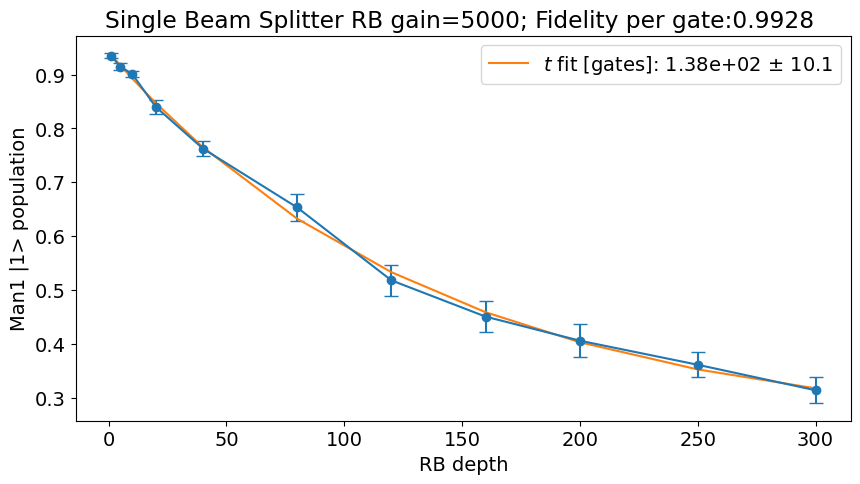

In [645]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
file_list = np.arange(122,133,1)
# file_list = np.arange(40,46,1)
name = '_SingleBeamsplitterRB_sweep_depth.h5'

plt.figure(figsize=(10,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract_excited(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'Single Beam Splitter RB gain=5000; Fidelity per gate:{np.exp(-1/fit[3]):.4f} ')
plt.legend()
plt.show()

Fit Decay constant avgi [gates]: 83.69050907548855


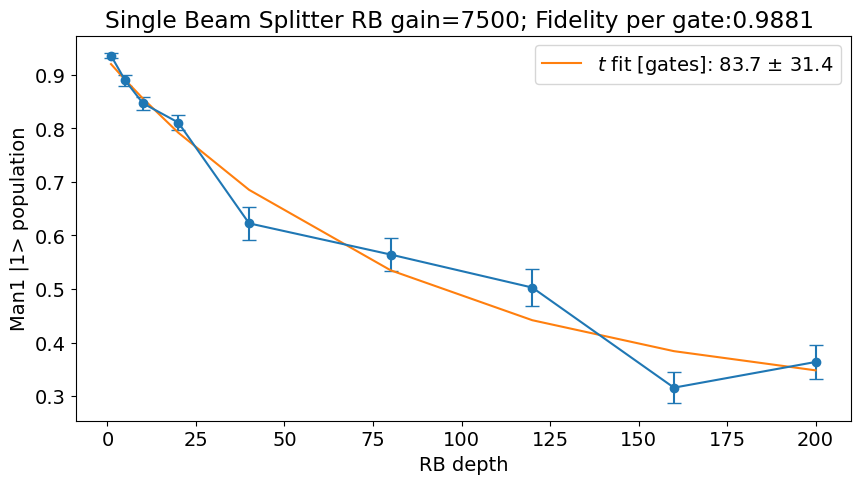

In [646]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
file_list = np.arange(133,142,1)
# file_list = np.arange(40,46,1)
name = '_SingleBeamsplitterRB_sweep_depth.h5'

plt.figure(figsize=(10,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract_excited(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'Single Beam Splitter RB gain=7500; Fidelity per gate:{np.exp(-1/fit[3]):.4f} ')
plt.legend()
plt.show()

##### Post selection

In [195]:
temp_data, attrs = prev_data(expt_path, '00049_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
np.average(avg_readout)

0.8485666666666668

Fit Decay constant avgi [gates]: 4321.249436449693


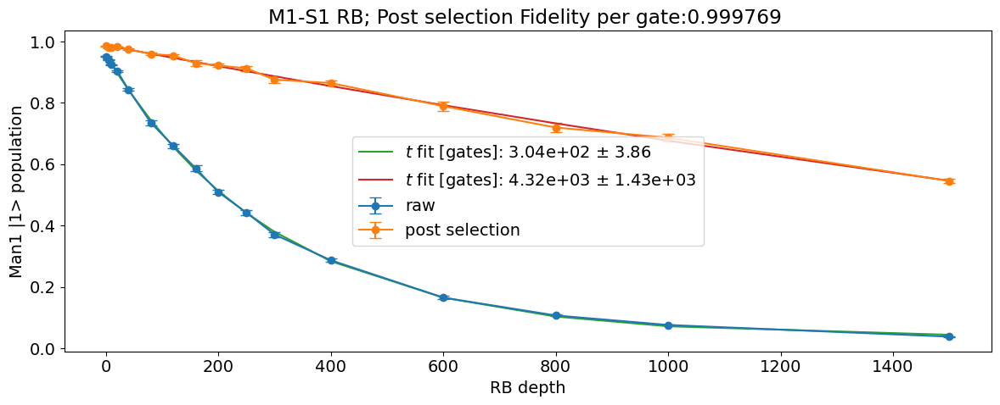

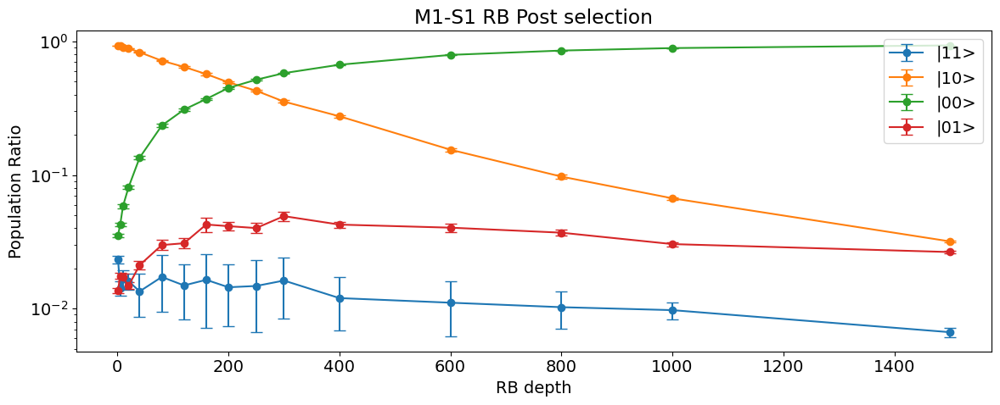

In [302]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
# file_list = np.arange(145,157,1)
file_list = np.arange(0,16,1)
# file_list = np.arange(16,32,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth.h5'

plt.figure(figsize=(12,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data)
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='raw', capsize=5)
plt.errorbar(xlist, fids_post_list, yerr= ebars_post_list,fmt = '-o', label='post selection', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

ypts = fids_post_list
fit_post,err_post = fitter.fitexp(xpts, ypts, fitparams=[None, None, None, None])

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'

p_post = fit_post #data['fit_avgi']
pCov_post = err_post #data['fit_err_avgi']
captionStr_post = f'$t$ fit [gates]: {p_post[3]:.3} $\pm$ {np.sqrt(pCov_post[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.plot(xpts, [fitter.expfunc(x, *fit_post) for x in xpts], label=captionStr_post)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit_post[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'M1-S1 RB; Post selection Fidelity per gate:{np.exp(-1/fit_post[3]):.6f} ')
plt.legend()
plt.tight_layout()

plt.figure(figsize=(12,5))
plt.subplot(111)
plt.errorbar(xlist, gg_list, yerr= gg_list_err,fmt = '-o', label='|11>', capsize=5)
plt.errorbar(xlist, ge_list, yerr= ge_list_err,fmt = '-o', label='|10>', capsize=5)
plt.errorbar(xlist, eg_list, yerr= eg_list_err,fmt = '-o', label='|00>', capsize=5)
plt.errorbar(xlist, ee_list, yerr= ee_list_err,fmt = '-o', label='|01>', capsize=5)
plt.yscale('log')
plt.legend()
plt.title('M1-S1 RB Post selection')
plt.xlabel('RB depth')
plt.ylabel('Population Ratio')
plt.tight_layout()
plt.show()

In [303]:
fit_post

array([-5.17530650e-01,  1.36983673e+00,  4.07757947e+02,  4.32124944e+03])

Raw Fidelity per gate:0.996907
Post selection Fidelity per gate:0.999342


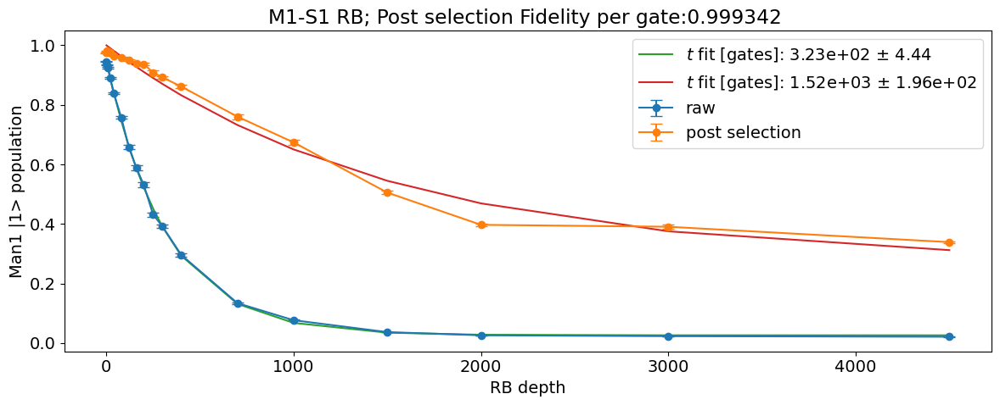

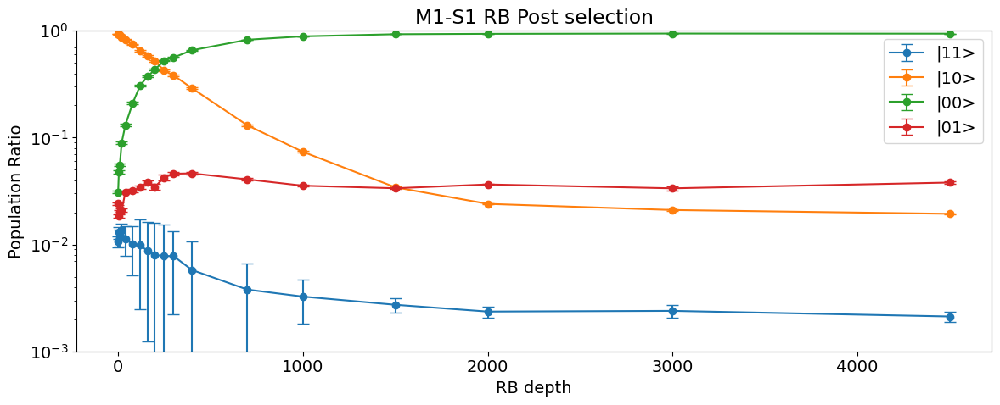

In [342]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
# file_list = np.arange(145,157,1)
file_list = np.arange(48,66, 1)
# file_list = np.arange(16,32,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth.h5'

plt.figure(figsize=(12,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data)
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='raw', capsize=5)
plt.errorbar(xlist, fids_post_list, yerr= ebars_post_list,fmt = '-o', label='post selection', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list 
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

ypts = np.array(fids_post_list) - fids_post_list[-1]*0
fit_post,err_post = fitter.fitexp(xpts, ypts, fitparams=[None, None, None, None])

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'

p_post = fit_post #data['fit_avgi']
pCov_post = err_post #data['fit_err_avgi']
captionStr_post = f'$t$ fit [gates]: {p_post[3]:.3} $\pm$ {np.sqrt(pCov_post[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.plot(xpts, [fitter.expfunc(x, *fit_post)+ fids_post_list[-1]*0 for x in xpts], label=captionStr_post)
plt.xlabel('Time [us]')
plt.legend()
print(f'Raw Fidelity per gate:{np.exp(-1/fit[3]):.6f}')
print(f'Post selection Fidelity per gate:{np.exp(-1/fit_post[3]):.6f}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'M1-S1 RB; Post selection Fidelity per gate:{np.exp(-1/fit_post[3]):.6f} ')
plt.legend()
plt.tight_layout()

plt.figure(figsize=(12,5))
plt.subplot(111)
plt.errorbar(xlist, gg_list, yerr= gg_list_err,fmt = '-o', label='|11>', capsize=5)
plt.errorbar(xlist, ge_list, yerr= ge_list_err,fmt = '-o', label='|10>', capsize=5)
plt.errorbar(xlist, eg_list, yerr= eg_list_err,fmt = '-o', label='|00>', capsize=5)
plt.errorbar(xlist, ee_list, yerr= ee_list_err,fmt = '-o', label='|01>', capsize=5)
plt.yscale('log')
plt.ylim(1e-3, 1)
plt.legend()
plt.title('M1-S1 RB Post selection')
plt.xlabel('RB depth')
plt.ylabel('Population Ratio')
plt.tight_layout()
plt.show()

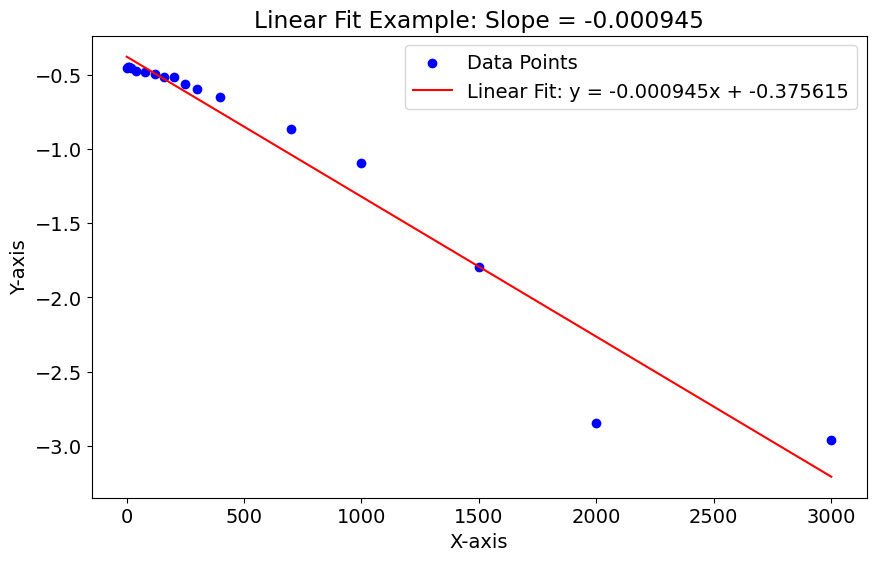

In [353]:
new_fids_post_list = (np.array(fids_post_list) - fids_post_list[-1])[:-1]
log_list = np.log(new_fids_post_list)
new_xlist = xlist[:-1]

#do linear fit 
xpts = np.array(new_xlist)
ypts = log_list

# Perform linear fit
slope, intercept = np.polyfit(xpts, ypts, 1)

# Generate fitted line
fitted_line = slope * xpts + intercept

# Plot original data points
plt.scatter(xpts, ypts, label='Data Points', color='blue')

# Plot fitted line
plt.plot(xpts, fitted_line, label=f'Linear Fit: y = {slope:.6f}x + {intercept:.6f}', color='red')

# Add labels and title
plt.xlabel('X-axis')
plt.ylabel('Y-axis')
#print slope in title
plt.title(f'Linear Fit Example: Slope = {slope:.6f}')
#plt.title('Linear Fit Example')
plt.legend()

# Display the plot
plt.show()
# print slope in title 



In [354]:
np.exp(slope)

0.9990559167575622

In [345]:
fids_post_list[:-1]

[0.9748158194444766,
 0.9802257717272286,
 0.9782516066968647,
 0.9767773981108232,
 0.9640723260343841,
 0.9591584399400083,
 0.9496588651350034,
 0.9379452334808209,
 0.9369700873695306,
 0.9082848563111207,
 0.8921772750871452,
 0.8611639499059449,
 0.7603190542647443,
 0.6737271302320244,
 0.5053942615391306,
 0.3971096438787393,
 0.3906665205179739]

#### POST SELECTION

In [13]:
temp_data, attrs = prev_data(expt_path, '00275_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, attrs, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

960
0.7539165329158758
0.8629322285945609


In [14]:
attrs['config']['expt']

{'qubits': [0],
 'reps': 1000,
 'singleshot_reps': 5000,
 'span': 1000,
 'active_reset': True,
 'man_reset': True,
 'storage_reset': True,
 'threshold': -32.769721213292996,
 'readout_per_round': 4,
 'rb_active_reset': True,
 'rb_man_reset': True,
 'rb_storage_reset': True,
 'rb_reps': 1000,
 'gates_per_wait': 100000,
 'reset_qubit_after_parity': True,
 'rounds': 1,
 'variations': 30,
 'rb_depth': 20,
 'IRB_gate_no': -1,
 'postselection_delay': 2.0,
 'bs_repeat': 1,
 'sync': False,
 'setup': False,
 'bs_para': [349.41, 3000, 0.450925, 0.005],
 'prepulse': True,
 'postpulse': True,
 'f0g1_offset': 0,
 'pre_sweep_pulse': [[3568.1751638611518, 3425.5537944060666, 2007.09],
  [10682, 8229, 15000],
  [0, 0, 0.6152866896346518],
  [0, 0, 0],
  [2, 2, 0],
  ['g', 'g', 'f'],
  [0.035, 0.035, 0.005]],
 'qubit': 0,
 'pulse_e': True,
 'pulse_f': False,
 'running_list': [1,
  5,
  6,
  5,
  6,
  3,
  1,
  3,
  2,
  2,
  6,
  3,
  6,
  3,
  3,
  1,
  1,
  3,
  6,
  1,
  6]}

968
977
979
981
1964
1946
2957
2941
2937
2951
2940
4921
9851
9857
9820
9838
9830
9802
9824
9796
9779
Fit Decay constant avgi [gates]: 1765.8147586969387
Raw Fidelity per gate:0.997094


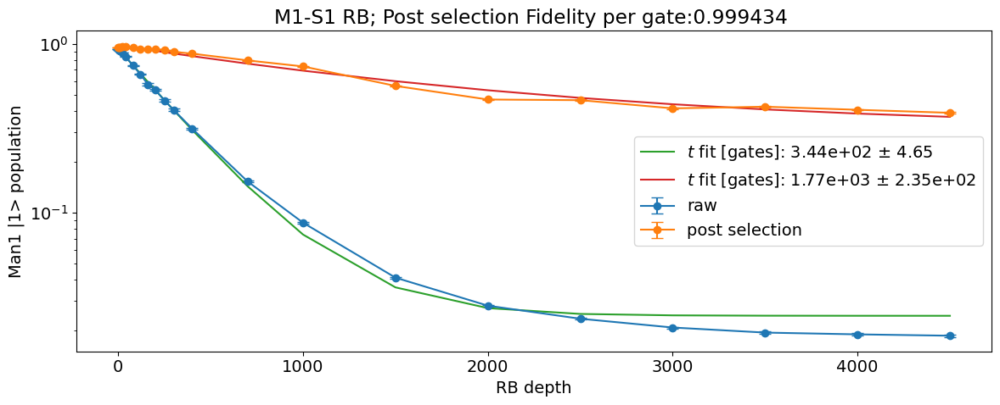

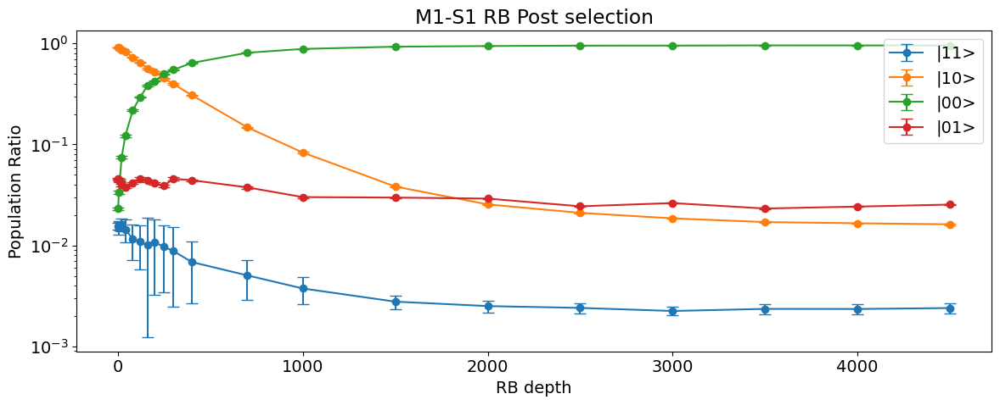

In [21]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
# file_list = np.arange(145,157,1)
# file_list = np.arange(0,16,1)
# file_list = np.arange(16,32,1)
file_list = np.arange(105,126,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth.h5'

plt.figure(figsize=(12,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
depth_list = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data,attrs, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
    depth_list.append(attrs['config']['expt']['rb_depth'])


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='raw', capsize=5)
plt.errorbar(xlist, fids_post_list, yerr= ebars_post_list,fmt = '-o', label='post selection', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

ypts = fids_post_list
fit_post,err_post = fitter.fitexp(xpts, ypts, fitparams=[None, None, None, None])

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'

p_post = fit_post #data['fit_avgi']
pCov_post = err_post #data['fit_err_avgi']
captionStr_post = f'$t$ fit [gates]: {p_post[3]:.3} $\pm$ {np.sqrt(pCov_post[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.plot(xpts, [fitter.expfunc(x, *fit_post) for x in xpts], label=captionStr_post)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit_post[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'M1-S1 RB; Post selection Fidelity per gate:{np.exp(-1/fit_post[3]):.6f} ')
print(f'Raw Fidelity per gate:{np.exp(-1/fit[3]):.6f}')
plt.yscale('log')
plt.legend()
plt.tight_layout()

plt.figure(figsize=(12,5))
plt.subplot(111)
plt.errorbar(xlist, gg_list, yerr= gg_list_err,fmt = '-o', label='|11>', capsize=5)
plt.errorbar(xlist, ge_list, yerr= ge_list_err,fmt = '-o', label='|10>', capsize=5)
plt.errorbar(xlist, eg_list, yerr= eg_list_err,fmt = '-o', label='|00>', capsize=5)
plt.errorbar(xlist, ee_list, yerr= ee_list_err,fmt = '-o', label='|01>', capsize=5)
plt.yscale('log')
plt.legend()
plt.title('M1-S1 RB Post selection')
plt.xlabel('RB depth')
plt.ylabel('Population Ratio')
plt.tight_layout()
plt.show()

In [20]:
fids_post_list

[0.9523024525900182,
 0.9532464297916327,
 0.9541146540401221,
 0.9564479953618777,
 0.9564104774142069,
 0.9460667141178714,
 0.9337966759790911,
 0.9273002854096505,
 0.9263165143916733,
 0.9197859949797924,
 0.8955991220170366,
 0.8736826959628062,
 0.7965640289714945,
 0.7336473110589677,
 0.5624127351578704,
 0.46708705550064133,
 0.46289995943497597,
 0.41398380316651145,
 0.4233816278779015,
 0.4058807294430472,
 0.38958823962994477]

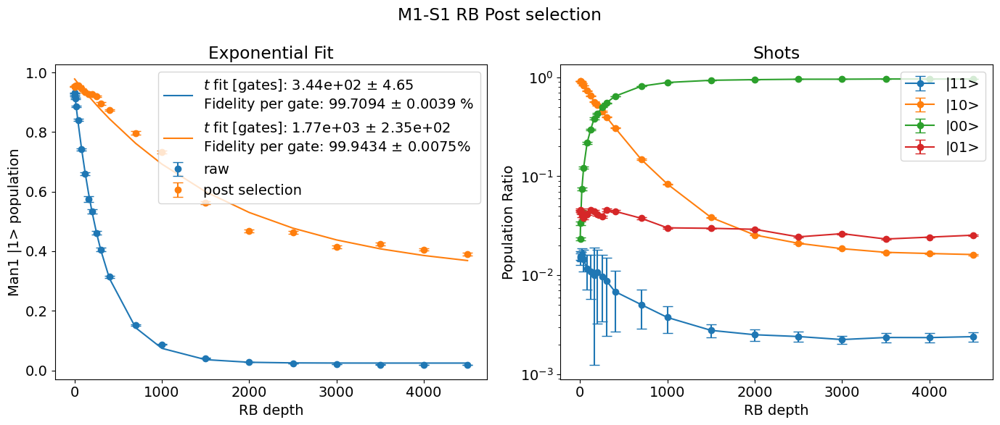

In [23]:
plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list,  ebars_list=ebars_list, ebars_post_list=ebars_post_list,
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            title='M1-S1 RB Post selection')

### `M1 - S2`

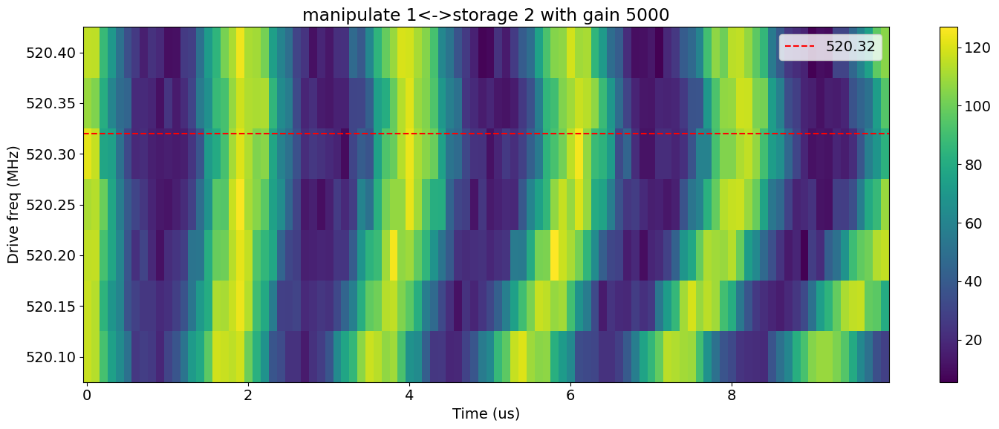

In [127]:
file_list = np.arange(268,275,1)
y_list = []
freq_list = []
# name = '_storage_sideband_sweep.h5'
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[520.32], vlines=None, title="manipulate 1<->storage 2 with gain " + str(attrs['config']['expt']['flux_drive'][2]))
    

In [61]:
1/300 * 2 *( np.pi)

0.020943951023931956

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


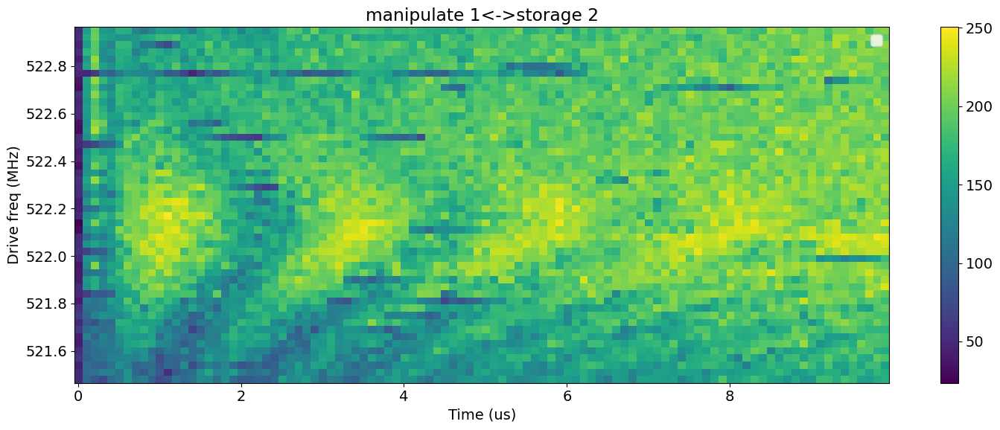

In [44]:
# file_list = np.arange(99,113,1)
# file_list = np.arange(4076,4079,1)
file_list = np.arange(829, 879, 1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
name = '_storage_sideband_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->storage 2")
    

In [101]:
attrs['config']

{'prepulse_qubit': {'freq': [3568.1751638611518],
  'length': [0.06],
  'gain': [30],
  'phase': [0],
  'repeat_time': 10},
 'device': {'qubit': {'T1': [127.0],
   'f_ge': [3568.1751638611518],
   'f_ge_resolved': [3568.1751638611518],
   'f_ge_idle': [3568.1751638611518],
   'f_ef': [3425.5537944060666],
   'f_ef_idle': [3425.5537944060666],
   'ramp_sigma': [0.01],
   'ramp_sigma_num': [2],
   'pulses': {'pi_ge': {'gain': [10819],
     'sigma': [0.035],
     'length': [0],
     'type': ['gauss']},
    'pi_ge_fast': {'gain': [10819],
     'sigma': [0.035],
     'length': [0],
     'type': ['gauss']},
    'pi_ge_resolved': {'gain': [50],
     'sigma': [0.005],
     'length': [6.553697146578866],
     'type': ['flat_top'],
     'repeat_no': [1]},
    'hpi_ge': {'gain': [5272],
     'length': [0],
     'sigma': [0.035],
     'type': ['gauss']},
    'hpi_ge_fast': {'gain': [5272],
     'length': [0],
     'sigma': [0.035],
     'type': ['gauss']},
    'pi_ef_new': {'gain': [3000],
     's

[ 66.90630894   0.48539306 105.60123255 122.5674866   55.80056095
  -6.853     ]
Decay from avgi [us] 122.56748660154561
Rate [MHz] 0.48539305887790324
Pi length from avgi data [us]: 0.9408112344723606
	Pi/2 length from avgi data [us]: 0.42576472643631236
Fit params:  [ 66.90630894   0.48539306 105.60123255 122.5674866   55.80056095
  -6.853     ]

Decay from avgq [us] 104.9315619403219
Rate [MHz] 0.4851638644195712
Pi length from avgq data [us]: 0.9324746053519706
Pi/2 length from avgq data [us]: 0.4662373026759853
Fit params:  [ 28.31291707   0.48516386 107.13492612 104.93156194 -12.70568476
  -6.853     ]


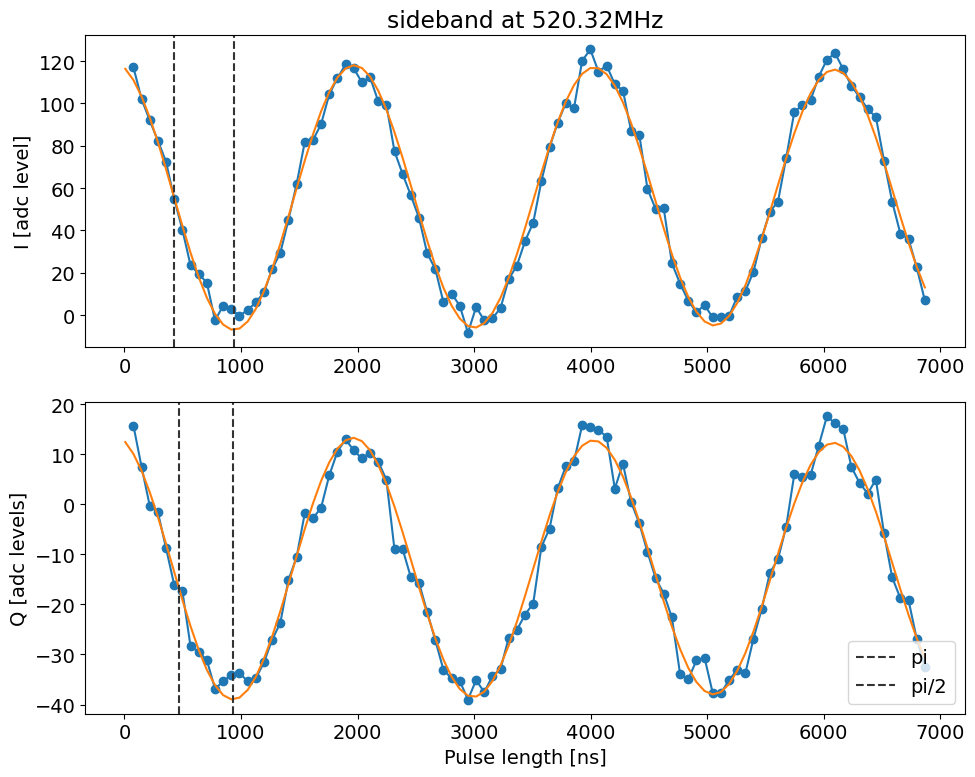

array([118.64638699, 117.07897236, 102.1196878 ,  91.94884553,
        82.43102439,  72.44285528,  54.86110569,  40.35890081,
        23.59981789,  19.45352846,  15.34096911,  -2.5064065 ,
         4.47988293,   2.66121626,  -0.25844553,   2.38636748,
         6.0638374 ,  10.72820163,  21.73413984,  29.2894374 ,
        45.00733008,  61.86267967,  81.72135285,  82.63143415,
        90.20515772, 104.25785366, 111.90407805, 118.42540488,
       116.62783089, 109.9675252 , 112.35891382, 101.07147967,
        99.43480976,  77.37386016,  66.57819837,  56.60372033,
        45.98453984,  29.29054309,  21.76228293,   6.09773659,
        10.15255285,   4.43213008,  -8.32842927,   3.77902439,
        -2.44327154,  -1.55641626,   3.39693659,  17.05029593,
        23.37108293,  34.94673821,  43.67499187,  63.1969626 ,
        79.26987317,  90.87756748, 100.22470244,  97.77400976,
       120.18478049, 125.48418862, 115.04018211, 117.88814309,
       109.11268943, 106.07957724,  86.98669919,  85.25

In [128]:
# temp_data, attrs = prev_data(expt_path, '00002_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00082_SidebandGeneralExperiment.h5')
temp_data, attrs = prev_data(expt_path, '00007_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, active_reset = False,  title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

In [166]:
attrs['config']['expt']

{'start': 0.007,
 'step': 0.05,
 'qubits': [0],
 'expts': 100,
 'reps': 200,
 'rounds': 1,
 'flux_drive': ['low', 520.93, 5000, 0.005],
 'prepulse': True,
 'postpulse': True,
 'active_reset': False,
 'man_reset': True,
 'storage_reset': True,
 'pre_sweep_pulse': [[3568.1751638611518, 3425.5537944060666, 2007.09],
  [10819, 8327, 15000],
  [0, 0, 0.6152866896346518],
  [0, 0, 0],
  [2, 2, 0],
  ['g', 'g', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2007.09],
  [15000],
  [0.615286689634651],
  [0],
  [0],
  ['flat_top'],
  [0.005]],
 'length_placeholder': 4.957}

##### With passive reset on man and storage

Attempted to init fitparam 4 to -1.7967759420950669, which is out of bounds -0.8987603305785121 to 15.192240259740258. Instead init to 7.146739964580873
[11.37672042  0.43796867 88.61283383 32.68095513 -2.56753812  4.87800748]
Decay from avgi [us] 32.68095513114512
Rate [MHz] 0.4379686738324567
Pi length from avgi data [us]: 1.1504321415628909
	Pi/2 length from avgi data [us]: 0.5752160707814454
Fit params:  [11.37672042  0.43796867 88.61283383 32.68095513 -2.56753812  4.87800748]

Decay from avgq [us] 1.4700000000011897
Rate [MHz] 0.02040816328796611
Pi length from avgq data [us]: 12.36704161797036
Pi/2 length from avgq data [us]: 6.18352080898518
Fit params:  [13.48168117  0.02040816 -0.8598977   1.47        2.49702027  3.15954713]


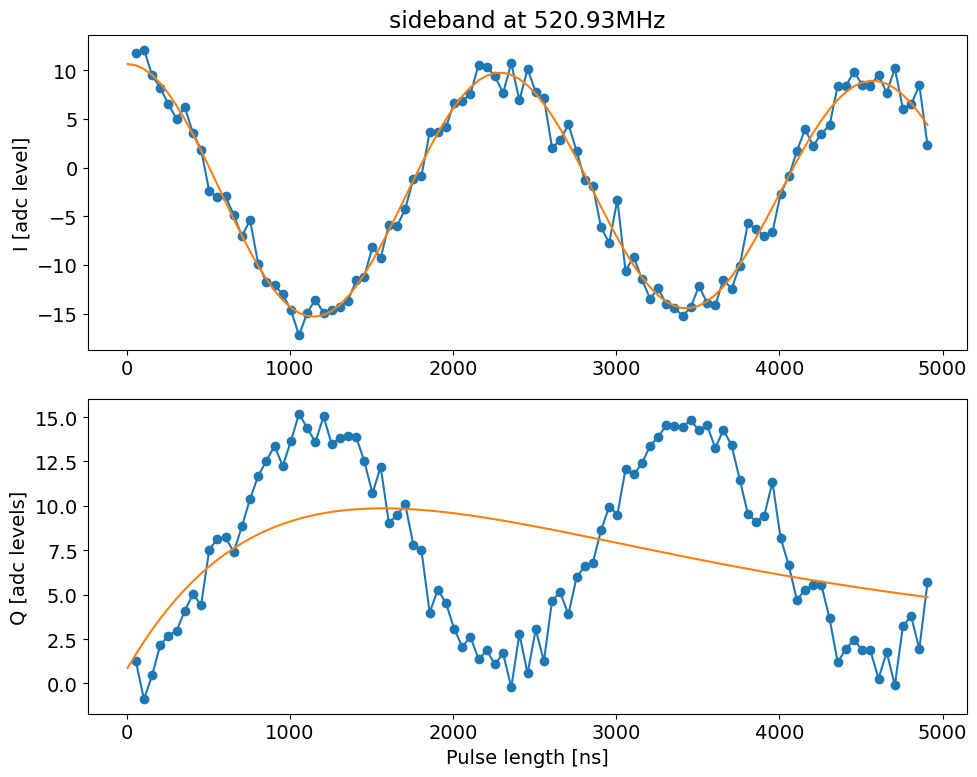

In [1196]:
temp_data, attrs = prev_data(expt_path, '00091_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00037_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=[13, 0.1, None, None, None, None], active_reset=True,threshold=-4.3, readout_per_round=4,
                     title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

In [129]:
# update ds 
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M1-S2', freq, 0.05, pi_length, pi2_length, gain)
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,348.85,0.01,0.784259,0.343947,3000,2025-03-11 12:35:25.500986
1,M1-S2,520.32,0.05,0.940811,0.425765,5000,2025-03-12 12:37:50.001793
2,M1-S3,696.02,0.05,1.134706,0.527018,9000,2025-03-12 11:21:11.606511
3,M1-S4,874.50,0.05,1.087371,0.539636,9000,2025-03-10 16:38:50.696707
4,M1-S5,1052.65,0.05,1.735148,0.820643,7500,2025-03-12 10:41:05.165443
5,M1-S6,1244.52,0.05,1.372186,0.637996,13500,2025-03-12 09:53:56.486329
6,M1-S7,1422.35,0.05,1.964983,0.927853,10000,2025-03-12 09:14:13.544748
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


#### Fidelity limit vs gain

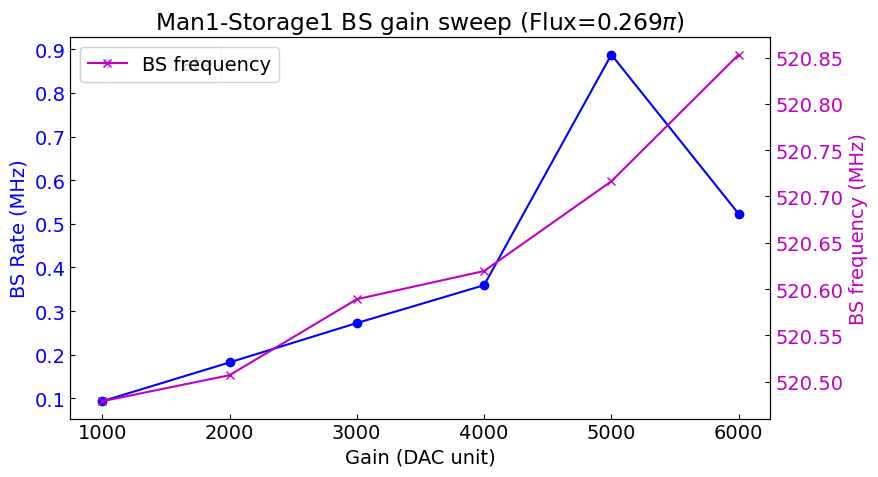

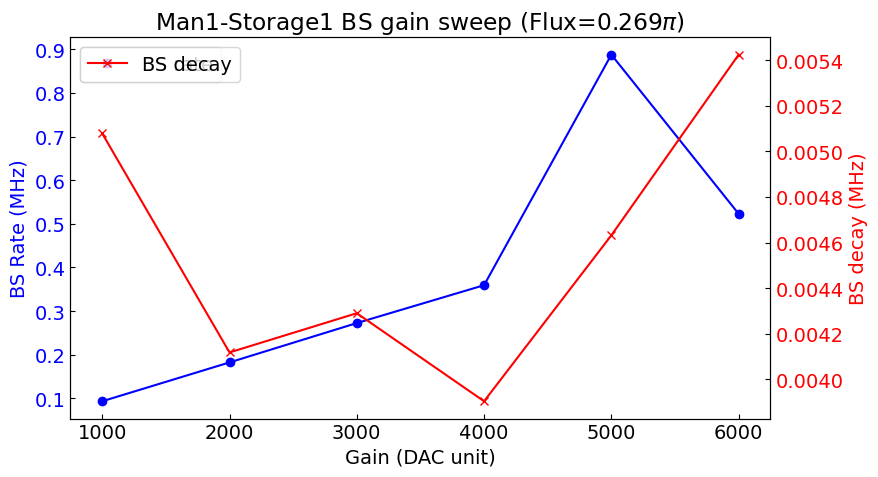

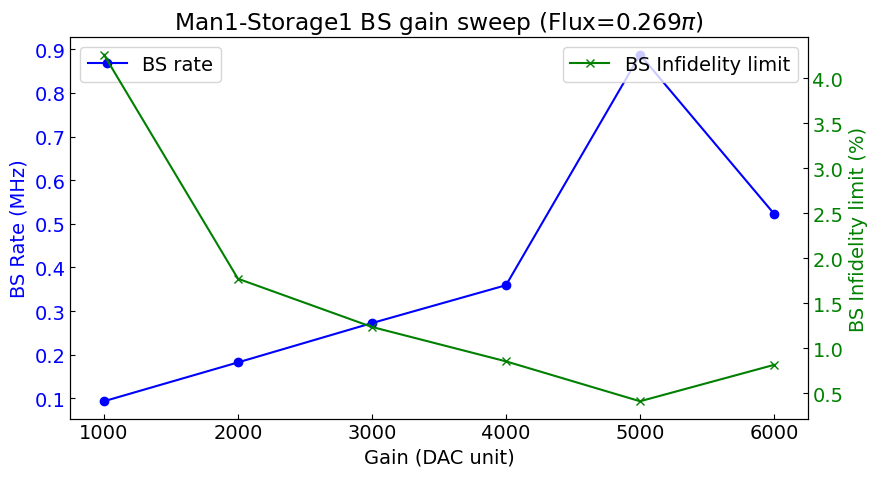

In [41]:
Fidelity_list = [0.9573714678526144, 0.9822796949789723, 0.9876424105220817, 0.9914679479735189, 0.9959014788609505, 0.9918557078294741]
kappa1_list = [0.005078081313978616, 0.004118563815275938, 0.0042904230395514435, 0.003904629806049002, 0.004631869076981334, 0.005423545097852213]
kappa_phi_list = [-0.00231386640831423, -0.0012865244918359858, -0.007186704849616964, -0.008295525101981359, -0.003534516756700447, -0.010755817195031502]
rate_list = [0.0935597717461239, 0.1825427075050038, 0.2726818512205061, 0.3594315961622909, 0.8876034410309936, 0.5230218010070806]
gain_list = [1000, 2000, 3000, 4000, 5000, 6000]
freq_res_list = [520.4789062500001, 520.50703125, 520.5890625, 520.61953125, 520.7164062500002, 520.8531249999999]

kappa_bs_list = []
for i, a in enumerate(kappa1_list):
    if kappa_phi_list[i] < 0:
        kappa_bs_list.append(a)
    else:
        kappa_bs_list.append(a + kappa_phi_list[i])

# Create a figure and a set of subplots
fig, ax1 = plt.subplots(figsize=(9, 5))

# Plot the first dataset on the primary y-axis
ax1.plot(gain_list, rate_list, color='b', marker='o', label='BS rate')
ax1.set_xlabel('Gain (DAC unit)')  # Set the x-axis label
ax1.set_ylabel('BS Rate (MHz)', color='blue')  # Set the primary y-axis label
ax1.tick_params(axis='y', labelcolor='blue')  # Color the y-axis ticks
ax1.tick_params(axis='both', direction='in')
plt.legend()

# Create a secondary y-axis
ax2 = ax1.twinx()
ax2.plot(gain_list, freq_res_list, color='m', marker='x', label='BS frequency')
ax2.set_ylabel('BS frequency (MHz)', color='m')  # Set the secondary y-axis label
ax2.tick_params(axis='y', labelcolor='m')  # Color the secondary y-axis ticks
ax2.tick_params(axis='both',  direction='in')

# Optionally, add a title and a legend
plt.title('Man1-Storage1 BS gain sweep (Flux=0.269$\pi$)')
plt.legend()
fig.tight_layout()  # Adjust layout to prevent overlap

# Show the plot
plt.show()

# Create a figure and a set of subplots
fig, ax1 = plt.subplots(figsize=(9, 5))

# Plot the first dataset on the primary y-axis
ax1.plot(gain_list, rate_list, color='b', marker='o', label='BS rate')
ax1.set_xlabel('Gain (DAC unit)')  # Set the x-axis label
ax1.set_ylabel('BS Rate (MHz)', color='blue')  # Set the primary y-axis label
ax1.tick_params(axis='y', labelcolor='blue')  # Color the y-axis ticks
ax1.tick_params(axis='both', direction='in')
plt.legend()

# Create a secondary y-axis
ax2 = ax1.twinx()
ax2.plot(gain_list, kappa_bs_list, color='r', marker='x', label='BS decay')
ax2.set_ylabel('BS decay (MHz)', color='r')  # Set the secondary y-axis label
ax2.tick_params(axis='y', labelcolor='r')  # Color the secondary y-axis ticks
ax2.tick_params(axis='both',  direction='in')

# Optionally, add a title and a legend
plt.title('Man1-Storage1 BS gain sweep (Flux=0.269$\pi$)')
plt.legend()
fig.tight_layout()  # Adjust layout to prevent overlap

# Show the plot
plt.show()

fig, ax1 = plt.subplots(figsize=(9, 5))

# Plot the first dataset on the primary y-axis
ax1.plot(gain_list, rate_list, color='b', marker='o', label='BS rate')
ax1.set_xlabel('Gain (DAC unit)')  # Set the x-axis label
ax1.set_ylabel('BS Rate (MHz)', color='blue')  # Set the primary y-axis label
ax1.tick_params(axis='y', labelcolor='blue')  # Color the y-axis ticks
ax1.tick_params(axis='both', direction='in')
plt.legend()

# Create a secondary y-axis
ax2 = ax1.twinx()
ax2.plot(gain_list, [100*(1-x) for x in Fidelity_list], color='g', marker='x', label='BS Infidelity limit')
ax2.set_ylabel('BS Infidelity limit (%)', color='g')  # Set the secondary y-axis label
ax2.tick_params(axis='y', labelcolor='g')  # Color the secondary y-axis ticks
ax2.tick_params(axis='both',  direction='in')

# Optionally, add a title and a legend
plt.title('Man1-Storage1 BS gain sweep (Flux=0.269$\pi$)')
plt.legend()
fig.tight_layout()  # Adjust layout to prevent overlap

# Show the plot
plt.show()

#### RB check

In [408]:
#temp_data, attrs = prev_data(expt_path, '00080_SingleBeamSplitterRB.h5')
temp_data, attrs = prev_data(expt_path, '00008_SingleBeamsplitterRB_sweep_depth.h5')
avg_readout = []
for i in range(len(temp_data['Idata'])):
    counting = 0
    for j in temp_data['Idata'][i]:
        if j>temp_data['thresholds']:
            counting += 1
    avg_readout.append(counting/len(temp_data['Idata'][i]))
#
# avg_readout = RB_extract(temp_data)
mean = np.average(avg_readout)
err = np.std(avg_readout)/np.sqrt(len(avg_readout))
print(mean, err)

0.5967666666666667 0.003601136651834417


Fit Decay constant avgi [gates]: 408.0649471422718


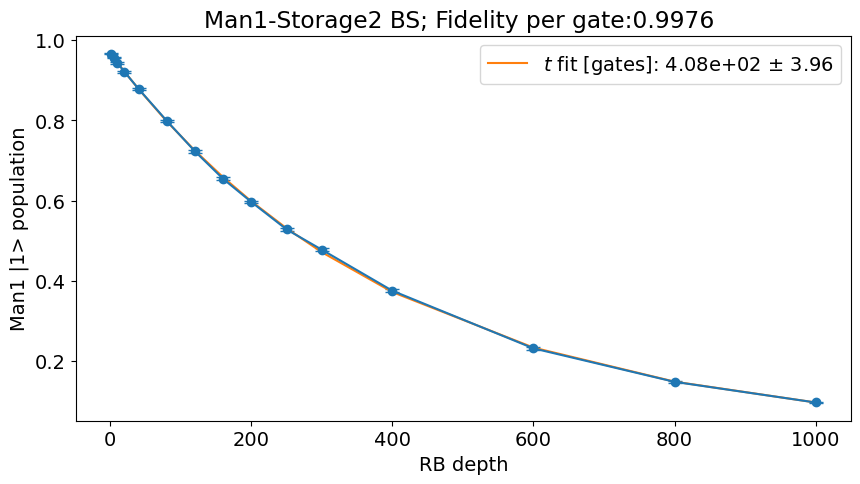

In [402]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
file_list = np.arange(0,15,1)
#file_list = np.arange(169,184,1)
# file_list = np.arange(40,46,1)
name = '_SingleBeamsplitterRB_sweep_depth.h5'

plt.figure(figsize=(10,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract_excited(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'Man1-Storage2 BS; Fidelity per gate:{np.exp(-1/fit[3]):.4f} ')
plt.legend()
plt.show()

In [362]:
ypts

[0.9667666666666668,
 0.9570333333333333,
 0.9436666666666667,
 0.9215666666666668,
 0.8790333333333334,
 0.7992999999999998,
 0.7230333333333334,
 0.6542999999999999,
 0.5967666666666667,
 0.5282000000000001,
 0.4775666666666666,
 0.3752333333333333,
 0.2315333333333333,
 0.14806666666666668,
 0.09656666666666669]

In [363]:
xpts

[1, 5, 10, 20, 40, 80, 120, 160, 200, 250, 300, 400, 600, 800, 1000]

#### POST SELECTION

In [365]:
temp_data, attrs = prev_data(expt_path, '00075_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

0.7612
0.9438778039018351


1000
1000
1000
1000
2000
2000
3000
3000
3000
3000
3000
5000
10000
10000
10000
10000
10000
10000
10000
Fit Decay constant avgi [gates]: 934.4145702333057
Raw Fidelity per gate:0.997630


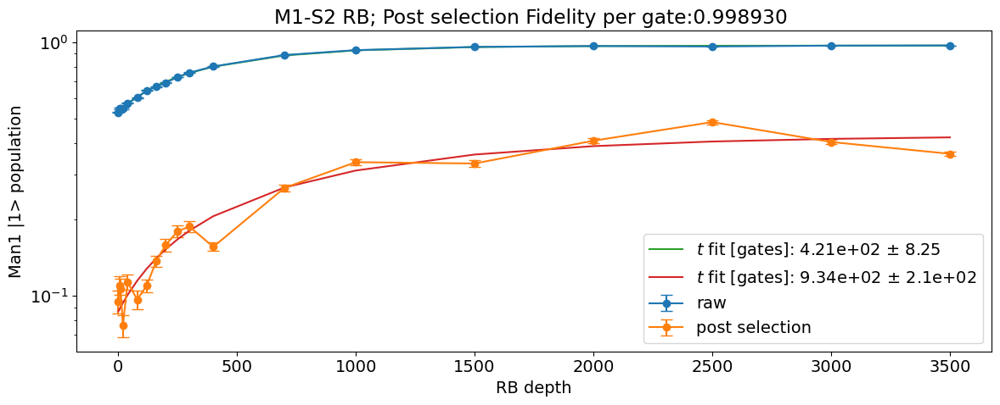

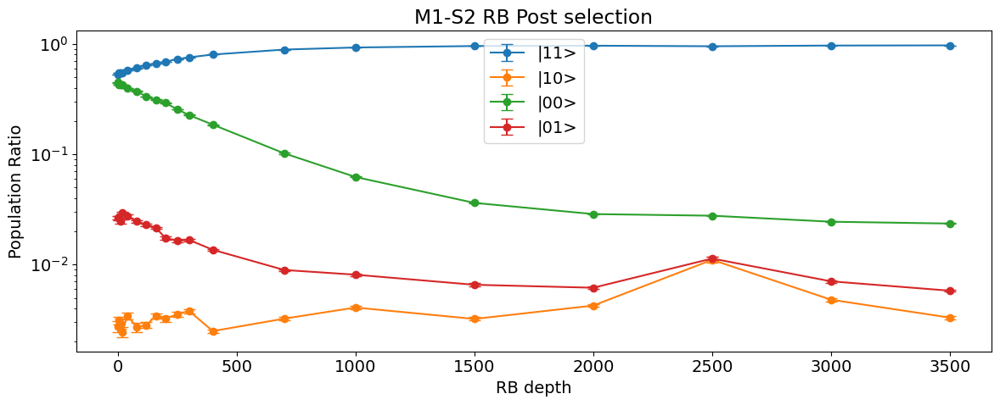

In [293]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
# file_list = np.arange(145,157,1)
# file_list = np.arange(0,16,1)
# file_list = np.arange(16,32,1)
file_list = np.arange(84,103,1) #np.arange(84,105,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth.h5'

plt.figure(figsize=(12,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=False)
    #avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_excited(temp_data, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='raw', capsize=5)
plt.errorbar(xlist, fids_post_list, yerr= ebars_post_list,fmt = '-o', label='post selection', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

ypts = fids_post_list
fit_post,err_post = fitter.fitexp(xpts, ypts, fitparams=[None, None, None, None])

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'

p_post = fit_post #data['fit_avgi']
pCov_post = err_post #data['fit_err_avgi']
captionStr_post = f'$t$ fit [gates]: {p_post[3]:.3} $\pm$ {np.sqrt(pCov_post[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.plot(xpts, [fitter.expfunc(x, *fit_post) for x in xpts], label=captionStr_post)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit_post[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'M1-S2 RB; Post selection Fidelity per gate:{np.exp(-1/fit_post[3]):.6f} ')
print(f'Raw Fidelity per gate:{np.exp(-1/fit[3]):.6f}')
plt.yscale('log')
plt.legend()
plt.tight_layout()

plt.figure(figsize=(12,5))
plt.subplot(111)
plt.errorbar(xlist, gg_list, yerr= gg_list_err,fmt = '-o', label='|11>', capsize=5)
plt.errorbar(xlist, ge_list, yerr= ge_list_err,fmt = '-o', label='|10>', capsize=5)
plt.errorbar(xlist, eg_list, yerr= eg_list_err,fmt = '-o', label='|00>', capsize=5)
plt.errorbar(xlist, ee_list, yerr= ee_list_err,fmt = '-o', label='|01>', capsize=5)
plt.yscale('log')
plt.legend()
plt.title('M1-S2 RB Post selection')
plt.xlabel('RB depth')
plt.ylabel('Population Ratio')
plt.tight_layout()
plt.show()

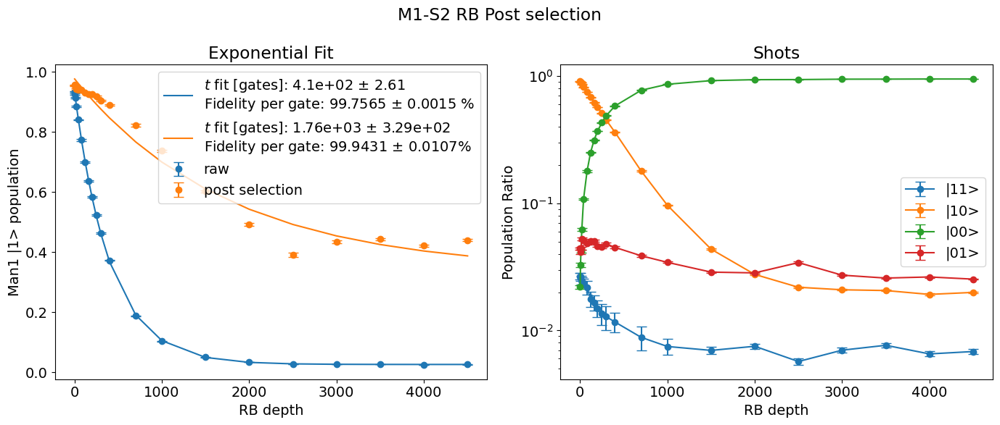

In [284]:
plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            title='M1-S2 RB Post selection')

In [154]:
fids_list

[0.9340846071667863,
 0.9259914478809106,
 0.9139089199379192,
 0.8854666696466649,
 0.8407838039633606,
 0.7729899594144339,
 0.6994072404230905,
 0.6362465913808426,
 0.5845499298315731,
 0.5239369835380779,
 0.4629435566856035,
 0.37288791746401717,
 0.18795356506446398,
 0.103808583704923,
 0.0505285436138388,
 0.03508101420141442,
 0.027550469568921845,
 0.02786858938345393,
 0.028236378406719977,
 0.025737508448431045,
 0.02673345534177927]

Fit Decay constant avgi [gates]: 331.05176060638337


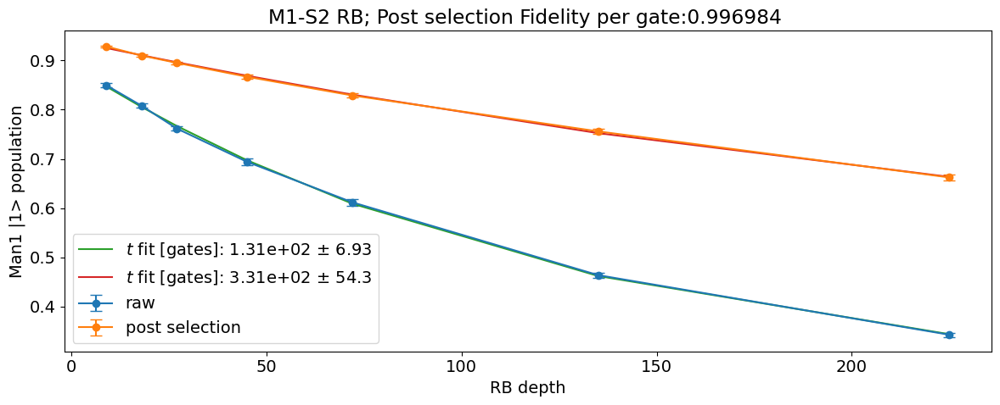

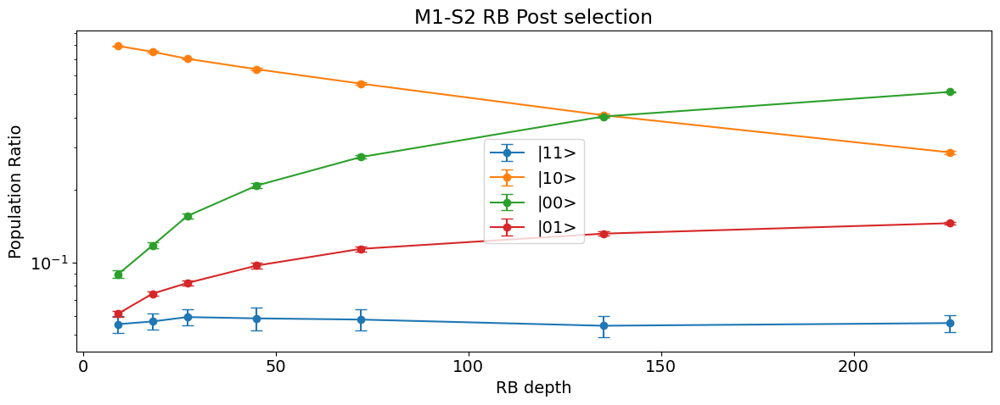

In [186]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
# file_list = np.arange(145,157,1)
# file_list = np.arange(0,16,1)
file_list = np.arange(32,39,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth.h5'

plt.figure(figsize=(12,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data)
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='raw', capsize=5)
plt.errorbar(xlist, fids_post_list, yerr= ebars_post_list,fmt = '-o', label='post selection', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

ypts = fids_post_list
fit_post,err_post = fitter.fitexp(xpts, ypts, fitparams=[None, None, None, None])

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'

p_post = fit_post #data['fit_avgi']
pCov_post = err_post #data['fit_err_avgi']
captionStr_post = f'$t$ fit [gates]: {p_post[3]:.3} $\pm$ {np.sqrt(pCov_post[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.plot(xpts, [fitter.expfunc(x, *fit_post) for x in xpts], label=captionStr_post)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit_post[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'M1-S2 RB; Post selection Fidelity per gate:{np.exp(-1/fit_post[3]):.6f} ')
plt.legend()
plt.tight_layout()

plt.figure(figsize=(12,5))
plt.subplot(111)
plt.errorbar(xlist, gg_list, yerr= gg_list_err,fmt = '-o', label='|11>', capsize=5)
plt.errorbar(xlist, ge_list, yerr= ge_list_err,fmt = '-o', label='|10>', capsize=5)
plt.errorbar(xlist, eg_list, yerr= eg_list_err,fmt = '-o', label='|00>', capsize=5)
plt.errorbar(xlist, ee_list, yerr= ee_list_err,fmt = '-o', label='|01>', capsize=5)
plt.yscale('log')
plt.legend()
plt.title('M1-S2 RB Post selection')
plt.xlabel('RB depth')
plt.ylabel('Population Ratio')
plt.tight_layout()
plt.show()

### M1 - S3

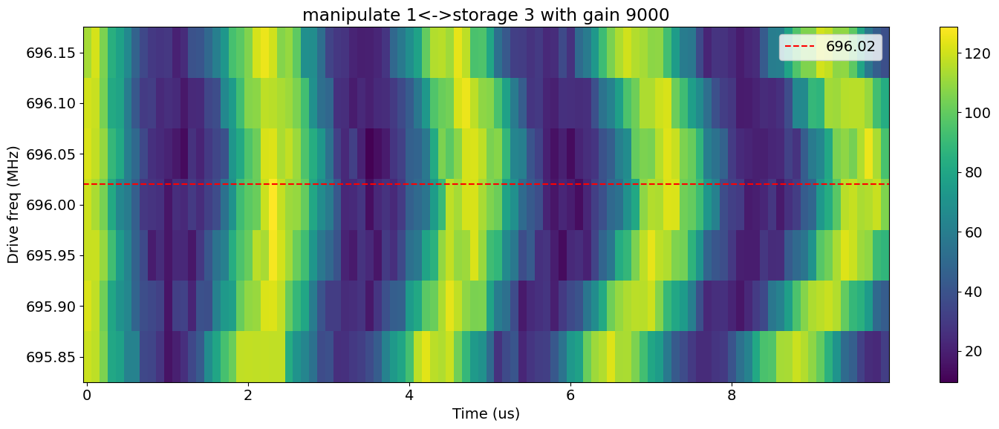

In [115]:
file_list = np.concatenate((np.arange(252,257,1), np.arange(258,260,1)))
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[696.02], vlines=None, title="manipulate 1<->storage 3 with gain " + str(attrs['config']['expt']['flux_drive'][2]))
    

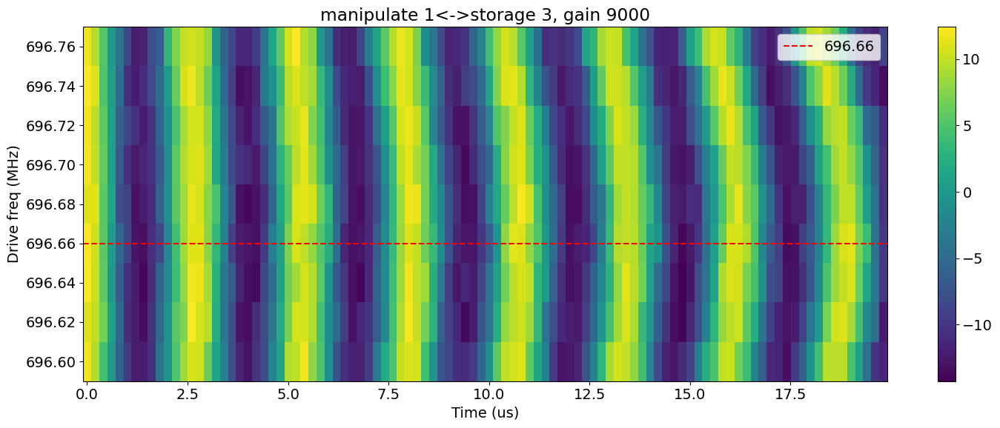

In [316]:
file_list = np.arange(155,164,1)
y_list = []
freq_list = []
#name = '_sideband_general_sweep.h5'
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[696.66], vlines=None, title="manipulate 1<->storage 3, gain " + str(attrs['config']['expt']['flux_drive'][2]))
    

[ 65.46591545   0.41139498 101.94754168 115.58023401  60.41194437
  -6.853     ]
Decay from avgi [us] 115.5802340071635
Rate [MHz] 0.4113949803268093
Pi length from avgi data [us]: 1.1347060770122481
	Pi/2 length from avgi data [us]: 0.5270175733717766
Fit params:  [ 65.46591545   0.41139498 101.94754168 115.58023401  60.41194437
  -6.853     ]

Decay from avgq [us] 114.50718705206256
Rate [MHz] 0.41116063553884064
Pi length from avgq data [us]: 1.1304719299254344
Pi/2 length from avgq data [us]: 0.5652359649627172
Fit params:  [ 32.47154146   0.41116064 102.66999942 114.50718705 -16.61403898
  -6.853     ]


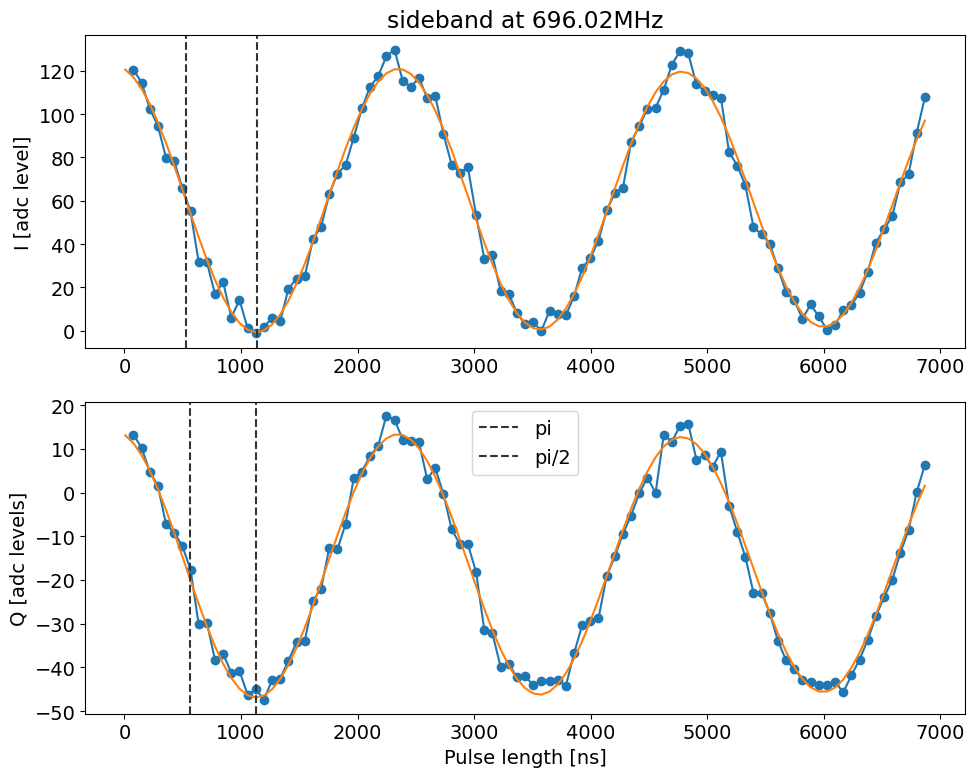

array([ 1.19503538e+02,  1.20462959e+02,  1.14543063e+02,  1.02555961e+02,
        9.45565008e+01,  7.98170276e+01,  7.81731122e+01,  6.59350764e+01,
        5.50693333e+01,  3.15877268e+01,  3.17209171e+01,  1.69309854e+01,
        2.23949724e+01,  6.13395122e+00,  1.42712000e+01,  1.24349268e+00,
       -1.16364878e+00,  1.83767154e+00,  5.96414959e+00,  4.68077398e+00,
        1.93894894e+01,  2.41328585e+01,  2.50881041e+01,  4.21374439e+01,
        4.80612943e+01,  6.29327285e+01,  7.25158764e+01,  7.64453008e+01,
        8.90720780e+01,  1.02571831e+02,  1.12569659e+02,  1.17463083e+02,
        1.26590946e+02,  1.29768182e+02,  1.15428826e+02,  1.12490192e+02,
        1.16814933e+02,  1.07407987e+02,  1.08192163e+02,  9.07965008e+01,
        7.66586341e+01,  7.29383610e+01,  7.53736911e+01,  5.33884423e+01,
        3.33565268e+01,  3.47918504e+01,  1.84698797e+01,  1.71628618e+01,
        8.21306667e+00,  3.07438049e+00,  3.98167805e+00, -6.91317073e-02,
        9.26575610e+00,  

In [118]:
temp_data, attrs = prev_data(expt_path, '00006_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00005_storage_sideband_sweep.h5')
length_rabi_display(temp_data, fit=True, active_reset=False,  fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

In [119]:
# update ds 
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M1-S3', freq, 0.05, pi_length, pi2_length, gain)
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,348.85,0.01,0.784259,0.343947,3000,2025-03-11 12:35:25.500986
1,M1-S2,521.23,0.05,1.069160,0.531718,5000,2025-01-21 16:17:17.763411
2,M1-S3,696.02,0.05,1.134706,0.527018,9000,2025-03-12 11:21:11.606511
3,M1-S4,874.50,0.05,1.087371,0.539636,9000,2025-03-10 16:38:50.696707
4,M1-S5,1052.65,0.05,1.735148,0.820643,7500,2025-03-12 10:41:05.165443
5,M1-S6,1244.52,0.05,1.372186,0.637996,13500,2025-03-12 09:53:56.486329
6,M1-S7,1422.35,0.05,1.964983,0.927853,10000,2025-03-12 09:14:13.544748
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


#### RB check

In [51]:
#temp_data, attrs = prev_data(expt_path, '00080_SingleBeamSplitterRB.h5')
# temp_data, attrs = prev_data(expt_path, '00030_SingleBeamSplitterRB.h5')
temp_data, attrs = prev_data(expt_path, '00157_SingleBeamSplitterRB.h5')
avg_readout = []
for i in range(len(temp_data['Idata'])):
    counting = 0
    for j in temp_data['Idata'][i]:
        if j>temp_data['thresholds']:
            counting += 1
    avg_readout.append(counting/len(temp_data['Idata'][i]))
#
# avg_readout = RB_extract(temp_data)
mean = np.average(avg_readout)
err = np.std(avg_readout)/np.sqrt(len(avg_readout))
print(mean, err)

0.5431 0.011909039517199621


In [50]:
attrs['config']['expt']['bs_para']

[696.66, 9000, 0.6719551418304632, 0.005]

Fit Decay constant avgi [gates]: 317.77243820121873


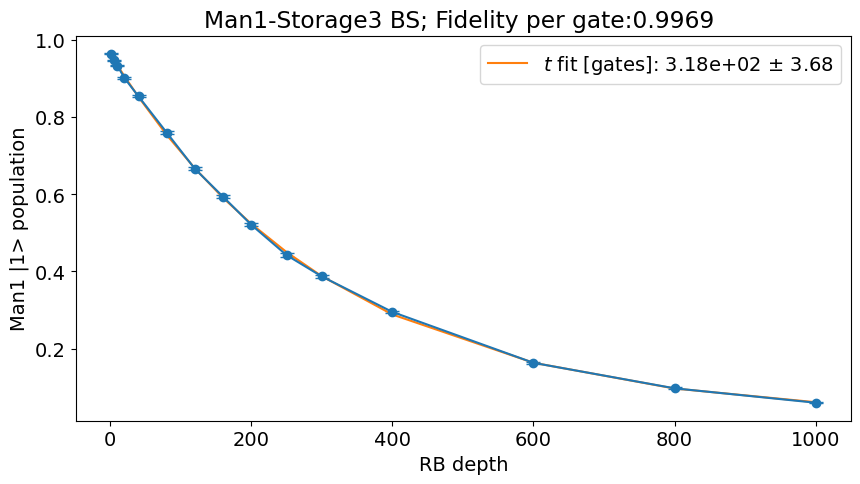

In [353]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
file_list = np.arange(30,45,1)
# file_list = np.arange(40,46,1)
name = '_SingleBeamsplitterRB_sweep_depth.h5'

plt.figure(figsize=(10,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract_excited(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'Man1-Storage3 BS; Fidelity per gate:{np.exp(-1/fit[3]):.4f} ')
plt.legend()
plt.show()

Fit Decay constant avgi [gates]: 298.03702635296577


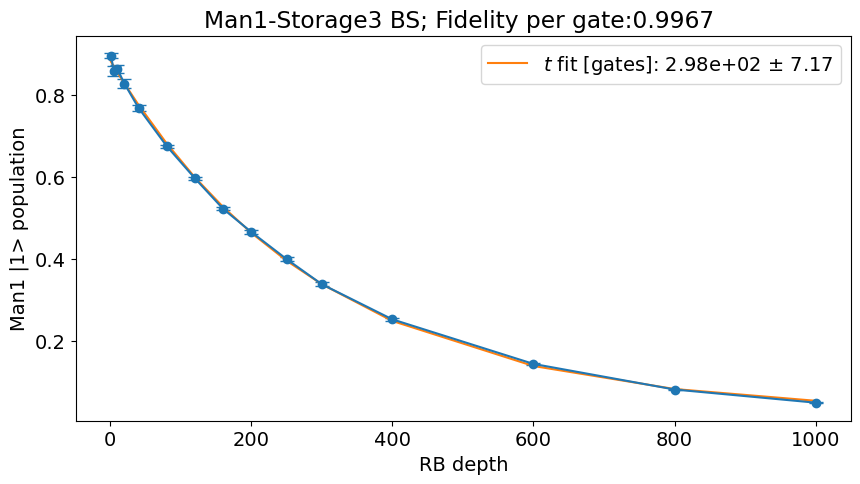

In [355]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
file_list = np.arange(45,60,1)
# file_list = np.arange(40,46,1)
name = '_SingleBeamsplitterRB_sweep_depth.h5'

plt.figure(figsize=(10,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract_ground(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'Man1-Storage3 BS; Fidelity per gate:{np.exp(-1/fit[3]):.4f} ')
plt.legend()
plt.show()

#### POST SELECTION

In [87]:
temp_data, attrs = prev_data(expt_path, '00126_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

973
0.7010971280226599
0.9232384103117913


950
973
978
973
1953
1966
2934
2937
2919
2948
2940
4809
9822
9638
9776
9790
9782
9830
9802
9789
9758
Fit Decay constant avgi [gates]: 1543.579919758417
Raw Fidelity per gate:0.997125


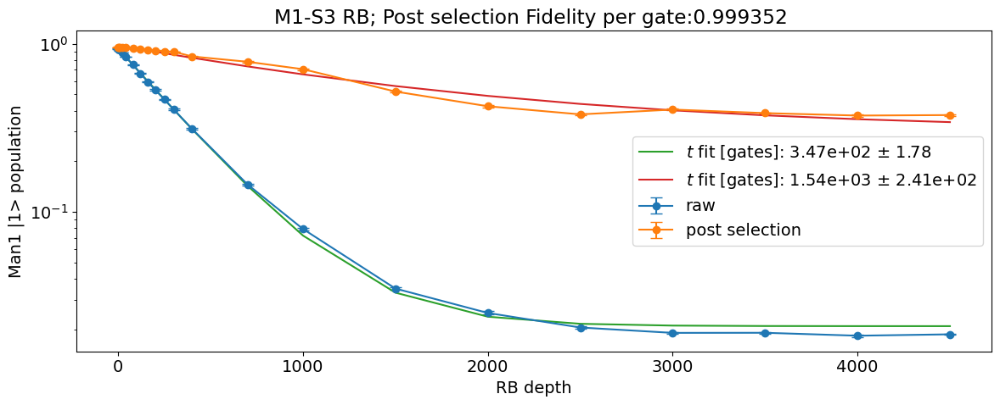

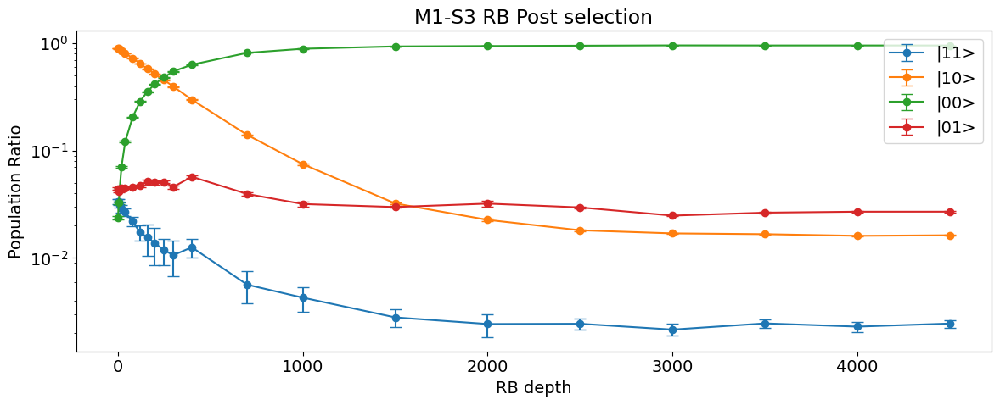

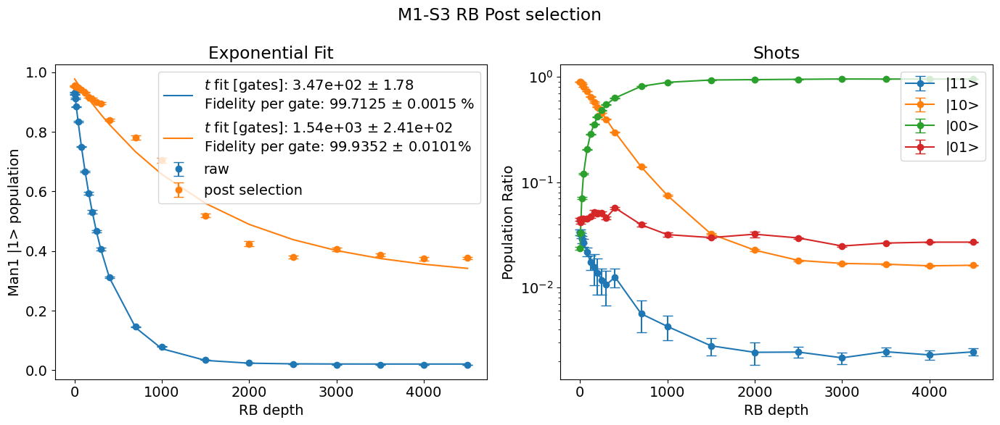

In [285]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
# file_list = np.arange(145,157,1)
# file_list = np.arange(0,16,1)
# file_list = np.arange(16,32,1)
file_list = np.arange(5,26,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth_storsweep.h5'

plt.figure(figsize=(12,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
depth_list = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
    depth_list.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='raw', capsize=5)
plt.errorbar(xlist, fids_post_list, yerr= ebars_post_list,fmt = '-o', label='post selection', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

ypts = fids_post_list
fit_post,err_post = fitter.fitexp(xpts, ypts, fitparams=[None, None, None, None])

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'

p_post = fit_post #data['fit_avgi']
pCov_post = err_post #data['fit_err_avgi']
captionStr_post = f'$t$ fit [gates]: {p_post[3]:.3} $\pm$ {np.sqrt(pCov_post[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.plot(xpts, [fitter.expfunc(x, *fit_post) for x in xpts], label=captionStr_post)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit_post[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'M1-S3 RB; Post selection Fidelity per gate:{np.exp(-1/fit_post[3]):.6f} ')
print(f'Raw Fidelity per gate:{np.exp(-1/fit[3]):.6f}')
plt.yscale('log')
plt.legend()
plt.tight_layout()

plt.figure(figsize=(12,5))
plt.subplot(111)
plt.errorbar(xlist, gg_list, yerr= gg_list_err,fmt = '-o', label='|11>', capsize=5)
plt.errorbar(xlist, ge_list, yerr= ge_list_err,fmt = '-o', label='|10>', capsize=5)
plt.errorbar(xlist, eg_list, yerr= eg_list_err,fmt = '-o', label='|00>', capsize=5)
plt.errorbar(xlist, ee_list, yerr= ee_list_err,fmt = '-o', label='|01>', capsize=5)
plt.yscale('log')
plt.legend()
plt.title('M1-S3 RB Post selection')
plt.xlabel('RB depth')
plt.ylabel('Population Ratio')
plt.tight_layout()
plt.show()

plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            title='M1-S3 RB Post selection')

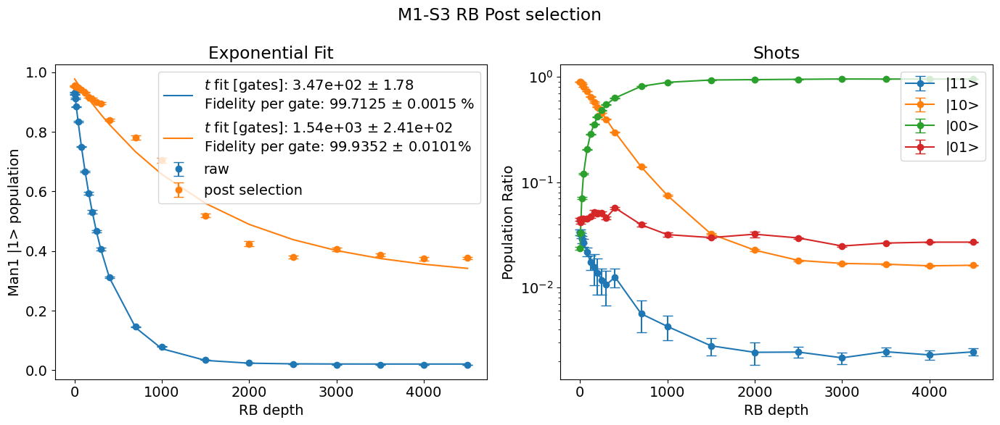

In [286]:
plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            title='M1-S3 RB Post selection')

In [156]:
fids_list

[0.9321784818204327,
 0.9253747874205992,
 0.9119126819731519,
 0.8840574770907641,
 0.8342537251501339,
 0.7498842610282423,
 0.6659039609146156,
 0.5930590591677213,
 0.5316372294262957,
 0.46674443614438493,
 0.4065681658619151,
 0.3114045721710166,
 0.145641560371321,
 0.07915851265167272,
 0.03504115564381781,
 0.025092738412640626,
 0.02056787499573579,
 0.01910843984988876,
 0.019132079931356134,
 0.018383205167513208,
 0.0187345621838612]

### M1 - S4

874.7999999999993
9000


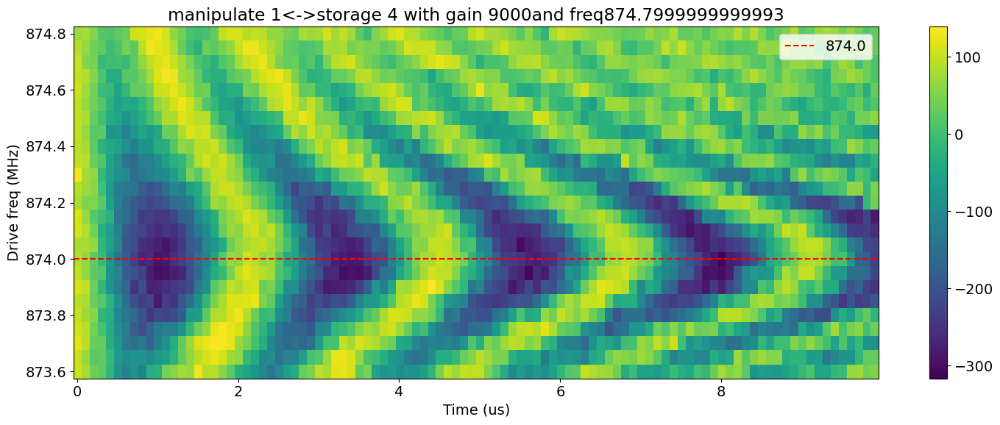

In [186]:
file_list = np.concatenate((np.arange(300, 308), np.arange(280,297,1)))
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[874.], vlines=None, title="manipulate 1<->storage 4 with gain " + str(attrs['config']['expt']['flux_drive'][2]) + 'and freq' + str(attrs['config']['expt']['flux_drive'][1]))
# print gain and frequency 
print(attrs['config']['expt']['flux_drive'][1])
print(attrs['config']['expt']['flux_drive'][2])

In [ ]:
attrs['config']['expt']

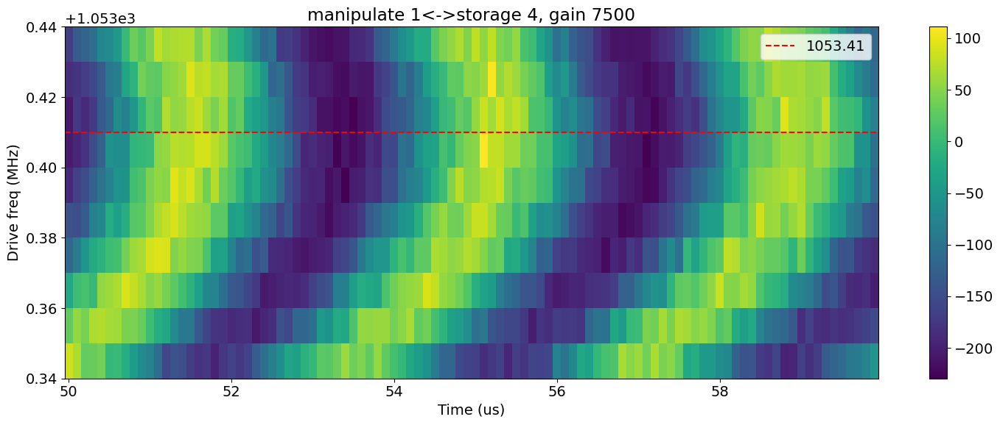

In [68]:
file_list = np.arange(47,57,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'

name = '_storage_sideband_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1053.41], vlines=None, title="manipulate 1<->storage 4, gain " + str(attrs['config']['expt']['flux_drive'][2]))
    

[292.78312783   0.31453171   5.69824121   5.364      198.17589093
  -6.65978874]
Decay from avgi [us] 5.364000000005999
Rate [MHz] 0.31453171080198916
Pi length from avgi data [us]: 2.334173398080395
	Pi/2 length from avgi data [us]: 1.5393409808256993
Fit params:  [292.78312783   0.31453171   5.69824121   5.364      198.17589093
  -6.65978874]

Decay from avgq [us] 9.469201438284967
Rate [MHz] 0.4997585028024364
Pi length from avgq data [us]: 0.9321657515576598
Pi/2 length from avgq data [us]: 0.4660828757788299
Fit params:  [ 54.49546386   0.4997585  102.29120627   9.46920144  80.9057521
  -6.55445131]


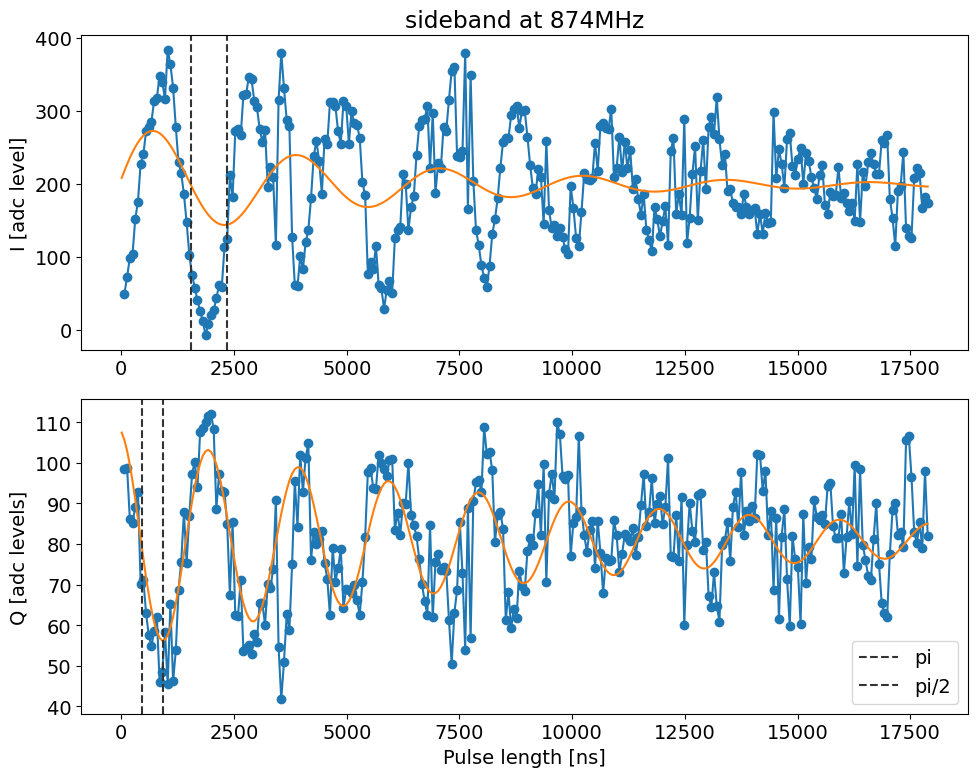

array([ 46.09493506,  48.77626623,  72.63408279,  97.6811526 ,
       102.96689123, 151.20736201, 175.01165584, 227.22169643,
       239.78169643, 271.2954789 , 277.50667208, 284.85475649,
       313.73118506, 317.533125  , 346.93044643, 339.26590909,
       315.68299513, 383.42896916, 363.27706169, 331.48593344,
       277.53148539, 229.12089286, 214.21246753, 185.69191558,
       146.96931006, 102.39318182,  74.90581169,  57.15400162,
        40.05223214,  25.08826299,  11.49480519,  -7.97357143,
         7.80008929,  20.3725    ,  26.28150974,  42.81230519,
        61.0842289 ,  58.17573864, 112.81747565, 123.63321429,
       211.31298701, 181.25169643, 272.03215097, 274.6625974 ,
       265.87661526, 321.05161526, 322.28434253, 345.83228896,
       342.93809253, 313.46984578, 304.37332792, 275.24696429,
       257.33335227, 273.49497565, 195.15482955, 222.71113636,
       208.2994237 , 115.64862825, 314.61797078, 378.60858766,
       330.9176461 , 286.80459416, 278.7518263 , 127.14

In [12]:
# temp_data, attrs = prev_data(expt_path, '00007_SidebandGeneralExperiment.h5')
temp_data, attrs = prev_data(expt_path, '00010_SidebandGeneralExperiment.h5')   
length_rabi_display(temp_data, fit=True, fitparams=None,#[400, 0.00001, None, None, None, None],
                     active_reset=False, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

In [193]:
# update ds 
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M1-S4', freq, 0.05, pi_length, pi2_length, gain)
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,348.85,0.01,0.784259,0.343947,3000,2025-03-11 12:35:25.500986
1,M1-S2,520.32,0.05,0.940811,0.425765,5000,2025-03-12 12:37:50.001793
2,M1-S3,696.02,0.05,1.134706,0.527018,9000,2025-03-12 11:21:11.606511
3,M1-S4,874.00,0.05,1.052531,0.476289,9000,2025-03-13 12:59:55.218434
4,M1-S5,1052.65,0.05,1.735148,0.820643,7500,2025-03-12 10:41:05.165443
5,M1-S6,1244.52,0.05,1.372186,0.637996,13500,2025-03-12 09:53:56.486329
6,M1-S7,1422.35,0.05,1.964983,0.927853,10000,2025-03-12 09:14:13.544748
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


In [49]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.660,0.03,0.942926,0.465943,3000,2025-01-21 16:12:51.119011
1,M1-S2,521.230,0.05,1.069160,0.531718,5000,2025-01-21 16:17:17.763411
2,M1-S3,696.980,0.03,1.256963,0.613370,9000,2025-01-21 16:17:39.113328
3,M1-S4,876.380,0.03,1.235632,0.622603,9000,2025-01-21 16:17:54.523998
4,M1-S5,1053.950,0.03,1.882097,0.985547,7500,2025-01-21 16:18:31.141469
5,M1-S6,1245.525,0.03,1.500950,0.732998,13500,2025-01-21 16:32:20.759195
6,M1-S7,1423.275,0.03,2.153588,1.085899,10000,2025-01-21 16:32:02.177572
7,M1-S8,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3


In [48]:
ds.df['freq (MHz)'][:7].array

<PandasArray>
[349.66, 521.23, 696.98, 876.38, 1053.95, 1245.5249999999999,
 1423.2749999999999]
Length: 7, dtype: float64

#### RB check

In [388]:
#temp_data, attrs = prev_data(expt_path, '00080_SingleBeamSplitterRB.h5')
temp_data, attrs = prev_data(expt_path, '00079_SingleBeamSplitterRB.h5')
avg_readout = []
for i in range(len(temp_data['Idata'])):
    counting = 0
    for j in temp_data['Idata'][i]:
        if j>temp_data['thresholds']:
            counting += 1
    avg_readout.append(counting/len(temp_data['Idata'][i]))
#
# avg_readout = RB_extract(temp_data)
mean = np.average(avg_readout)
err = np.std(avg_readout)/np.sqrt(len(avg_readout))
print(mean, err)

0.5253333333333334 0.005158236850650366


Fit Decay constant avgi [gates]: 163.56219656716306


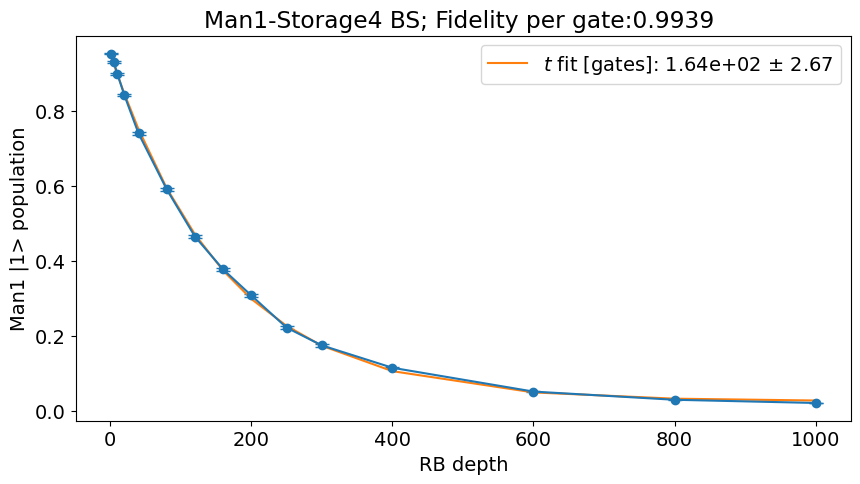

In [89]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
file_list = np.arange(79,94,1)
# file_list = np.arange(40,46,1)
name = '_SingleBeamsplitterRB_sweep_depth.h5'

plt.figure(figsize=(10,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract_excited(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)#[ 2.08106600e-02,  1.03139150e+00, -1.38398390e+01,  1.43275996e+02])

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'Man1-Storage4 BS; Fidelity per gate:{np.exp(-1/fit[3]):.4f} ')
plt.legend()
plt.show()

In [90]:
fids_list

[0.9518,
 0.9295333333333334,
 0.8978666666666667,
 0.8407000000000001,
 0.7392333333333334,
 0.5903333333333334,
 0.46456666666666663,
 0.37703333333333333,
 0.3075666666666666,
 0.22196666666666667,
 0.1746,
 0.11506666666666668,
 0.05163333333333334,
 0.029833333333333337,
 0.021300000000000003]

#### POST SELECTION

In [94]:
temp_data, attrs = prev_data(expt_path, '00130_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

971
0.49826619736909683
0.8630367078980208


985
977
969
972
1948
1941
2937
2918
2921
2927
2935
4895
9805
9779
9825
9821
9767
9752
9745
9807
9730


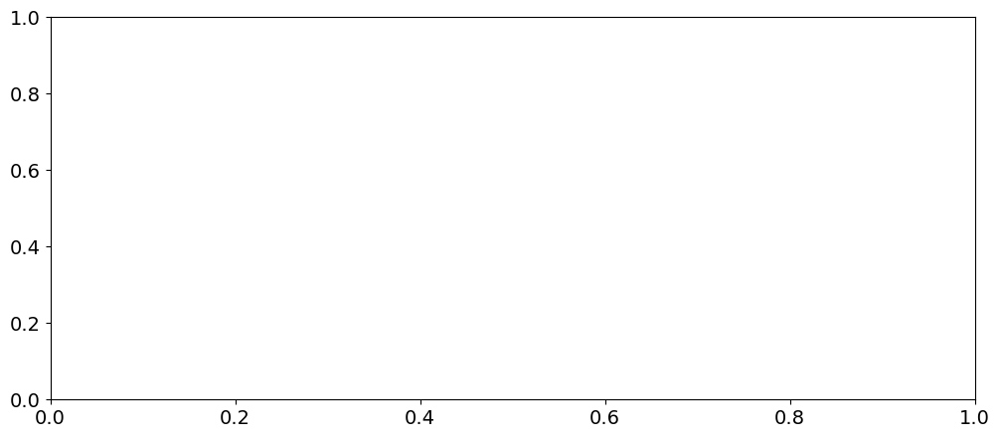

In [311]:
file_list = np.arange(26,47,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth_storsweep.h5'

plt.figure(figsize=(12,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
depth_list = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
    depth_list.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])


In [313]:
depth_list

[1,
 5,
 10,
 20,
 40,
 80,
 120,
 160,
 200,
 250,
 300,
 400,
 700,
 1000,
 1500,
 2000,
 2500,
 3000,
 3500,
 4000,
 4500]

In [312]:
fids_list

[0.9251238606461528,
 0.9094092536547341,
 0.8757956711438445,
 0.8273452523412205,
 0.7223552472791003,
 0.5776298441919643,
 0.4770920882578707,
 0.37946372144409285,
 0.31454123040267934,
 0.24819554692130513,
 0.1978785970559129,
 0.13339647961919324,
 0.057415083662152915,
 0.03739435196328013,
 0.026741538229687674,
 0.02394347359667544,
 0.02196847380090148,
 0.021336847926463173,
 0.020742578641054332,
 0.021443371167228244,
 0.020819213701139646]

h:\Shared drives\SLab\Multimode\experiment\240911\experiments\fitting.py:55: RuntimeWarning: overflow encountered in exp
  return y0 + yscale*np.exp(-(x-x0)/decay)


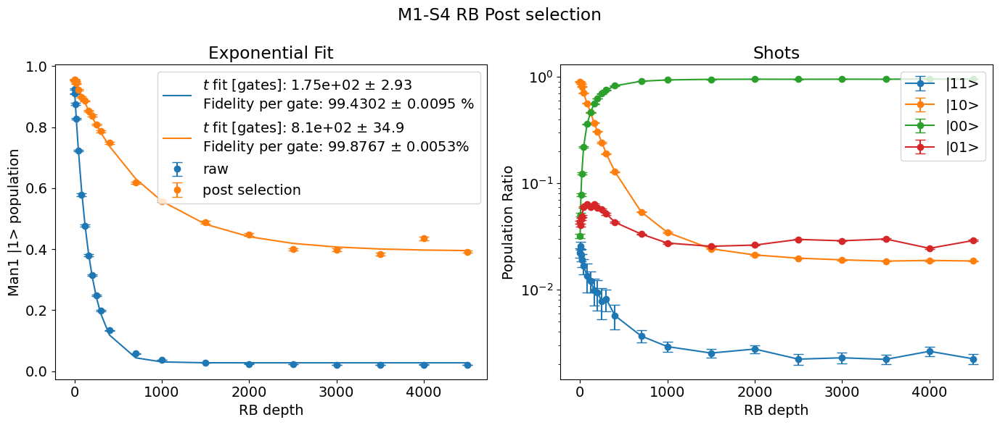

In [288]:
plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            title='M1-S4 RB Post selection')

In [252]:
ee_list_err

[0.0014533047191205143,
 0.001122826381261697,
 0.001158824444775928,
 0.0013901315103082546,
 0.00099322628505287,
 0.0010504447462161674,
 0.0009992739054858074,
 0.0009479862946931145,
 0.0010098327875412325,
 0.0008838038744888161,
 0.0009513894189466599,
 0.000626712211062552,
 0.00037297548405406506,
 0.00035112438289532934,
 0.0003875579399598775,
 0.00036110764486839447,
 0.00025677163338090267,
 0.0003657796454236741,
 0.00043894470587798516,
 0.0003608332295079412,
 0.00036174396136488666]

In [ ]:
def f(a, dt): 
    '''
    a is the fidelity 
    dt is error
    '''
    return 1/a/a * exp(-1/a) * dt

In [210]:
a = 1271 #p[3]
e = 4 #np.sqrt(pCov[3][3])
err = np.exp(-1/a)  * e / (a**2)
print(np.exp(-1/a) *100)
print(err*100)

99.921352737048
0.0002474156660306331


### M1 - S5

1053.7499999999995
7500


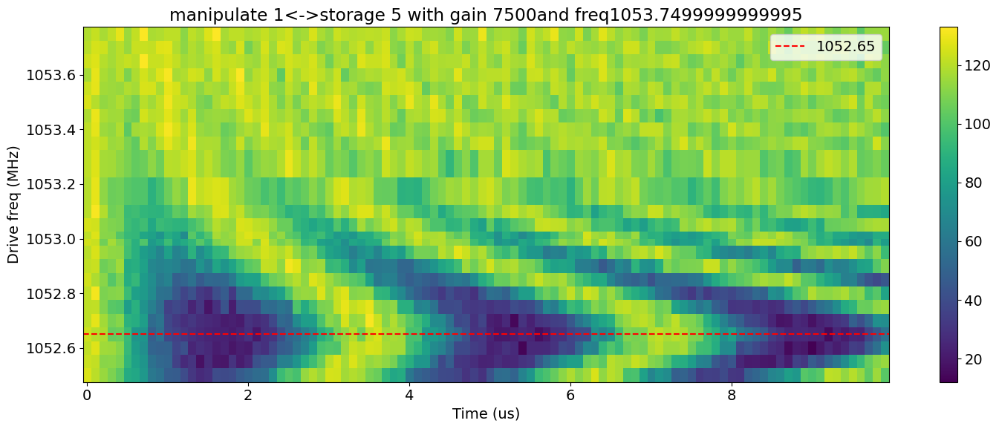

In [87]:
file_list = np.concatenate((np.arange(237,243,1), np.arange(232,237,1), np.arange(227, 231, 1),np.arange(214, 224,1)))
y_list = []
freq_list = []
name = '_storage_sideband_sweep.h5'
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1052.65], vlines=None, title="manipulate 1<->storage 5 with gain " + str(attrs['config']['expt']['flux_drive'][2]) + 'and freq' + str(attrs['config']['expt']['flux_drive'][1]))
# print gain and frequency 
print(attrs['config']['expt']['flux_drive'][1])
print(attrs['config']['expt']['flux_drive'][2])

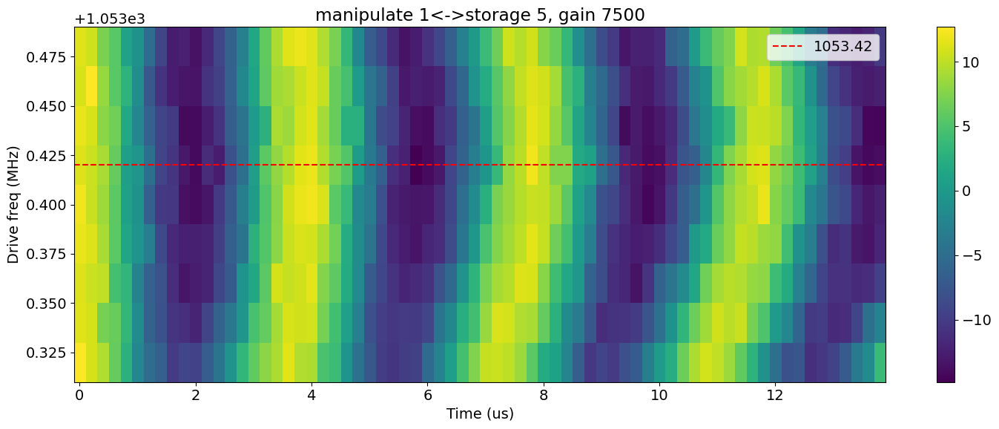

In [563]:
file_list = np.arange(250,256,1)
file_list = np.concatenate(( np.arange(257,260,1), file_list))
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1053.42], vlines=None, title="manipulate 1<->storage 5, gain " + str(attrs['config']['expt']['flux_drive'][2]))
    

[ 60.56088354   0.27337181  99.23739806 149.82079029  65.03176706
  -6.84949445]
Decay from avgi [us] 149.8207902868846
Rate [MHz] 0.27337181228760343
Pi length from avgi data [us]: 1.7351480277837854
	Pi/2 length from avgi data [us]: 0.8206426224606312
Fit params:  [ 60.56088354   0.27337181  99.23739806 149.82079029  65.03176706
  -6.84949445]

Decay from avgq [us] 69.7696638285786
Rate [MHz] 0.273368763703787
Pi length from avgq data [us]: 1.7381473887698184
Pi/2 length from avgq data [us]: 0.8690736943849092
Fit params:  [ 35.14225482   0.27336876  98.94412699  69.76966383 -18.94996404
  -6.85298738]


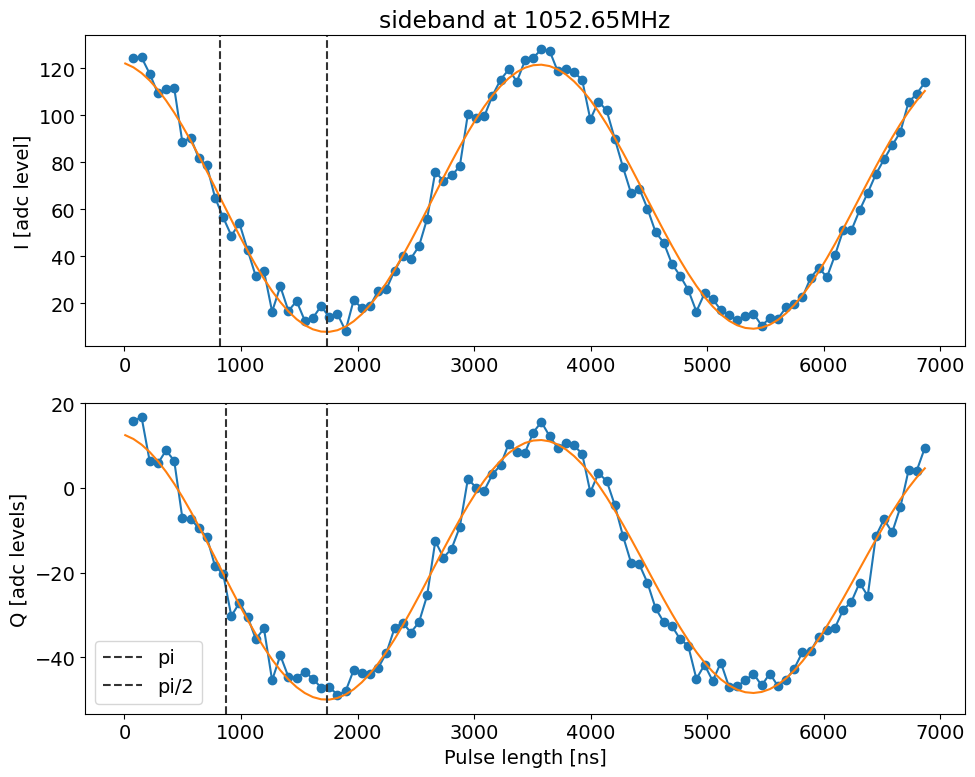

array([124.86277073, 124.49507642, 124.59543415, 117.62461789,
       109.29309919, 111.17530407, 111.65918699,  88.52264715,
        90.53345691,  81.8478439 ,  78.67867967,  65.03025041,
        56.58104065,  48.84469593,  53.98708943,  42.66418211,
        31.5161561 ,  33.78385041,  16.49045854,  27.24677724,
        16.80005854,  20.99909593,  12.67306016,  13.82924228,
        18.84473496,  14.15330081,  15.50653008,   8.35659837,
        21.44334309,  17.94593821,  18.89901138,  25.31422439,
        26.02853984,  33.88403902,  39.98218537,  39.0448    ,
        44.30970407,  55.99895935,  76.01869919,  71.96201626,
        74.41110894,  78.2705626 , 100.65850407,  98.96515772,
        99.53060813, 108.29082276, 115.10888455, 119.46878049,
       114.33659187, 123.41379512, 124.47277398, 127.98890407,
       127.48329756, 118.74755772, 119.60150244, 118.26701789,
       115.09605203,  98.21826992, 105.84468943, 102.0822374 ,
        89.94507317,  77.94818862,  66.76718699,  68.85

In [88]:
# temp_data, attrs = prev_data(expt_path, '00013_SidebandGeneralExperiment.h5')
temp_data, attrs = prev_data(expt_path, '00004_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, active_reset = False,  title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

In [89]:
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M1-S5', freq, 0.05, pi_length, pi2_length, gain)
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,348.85,0.01,0.784259,0.343947,3000,2025-03-11 12:35:25.500986
1,M1-S2,521.23,0.05,1.069160,0.531718,5000,2025-01-21 16:17:17.763411
2,M1-S3,696.98,0.03,1.256963,0.613370,9000,2025-01-21 16:17:39.113328
3,M1-S4,874.50,0.05,1.087371,0.539636,9000,2025-03-10 16:38:50.696707
4,M1-S5,1052.65,0.05,1.735148,0.820643,7500,2025-03-12 10:41:05.165443
5,M1-S6,1244.52,0.05,1.372186,0.637996,13500,2025-03-12 09:53:56.486329
6,M1-S7,1422.35,0.05,1.964983,0.927853,10000,2025-03-12 09:14:13.544748
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


In [ ]:
ds.df

#### RB check

In [306]:
#temp_data, attrs = prev_data(expt_path, '00080_SingleBeamSplitterRB.h5')
temp_data, attrs = prev_data(expt_path, '00188_SingleBeamSplitterRB.h5')
avg_readout = []
for i in range(len(temp_data['Idata'])):
    counting = 0
    for j in temp_data['Idata'][i]:
        if j<temp_data['thresholds']:
            counting += 1
    avg_readout.append(counting/len(temp_data['Idata'][i]))
#
# avg_readout = RB_extract(temp_data)
mean = np.average(avg_readout)
err = np.std(avg_readout)/np.sqrt(len(avg_readout))
print(mean, err)

0.8270999999999998 0.003830100085724477


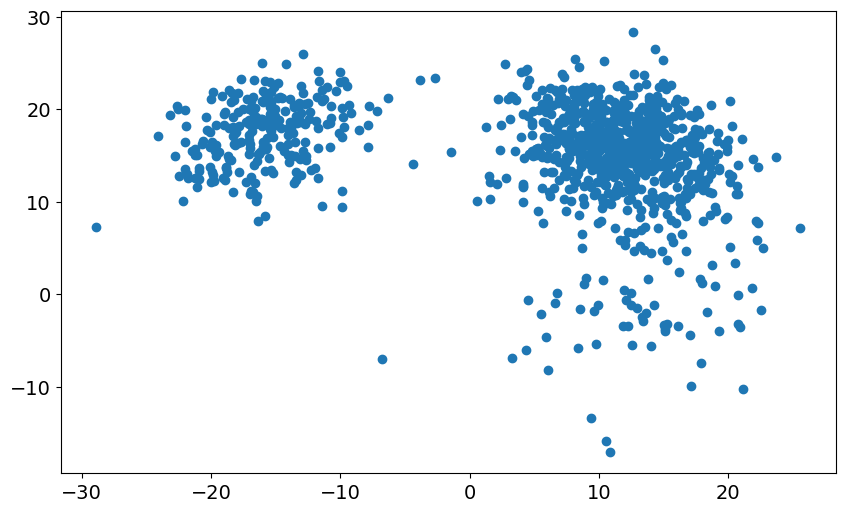

In [304]:
i = 15
plt.plot(temp_data['Idata'][i], temp_data['Qdata'][i], 'o')

Fit Decay constant avgi [gates]: 143.27599629561763


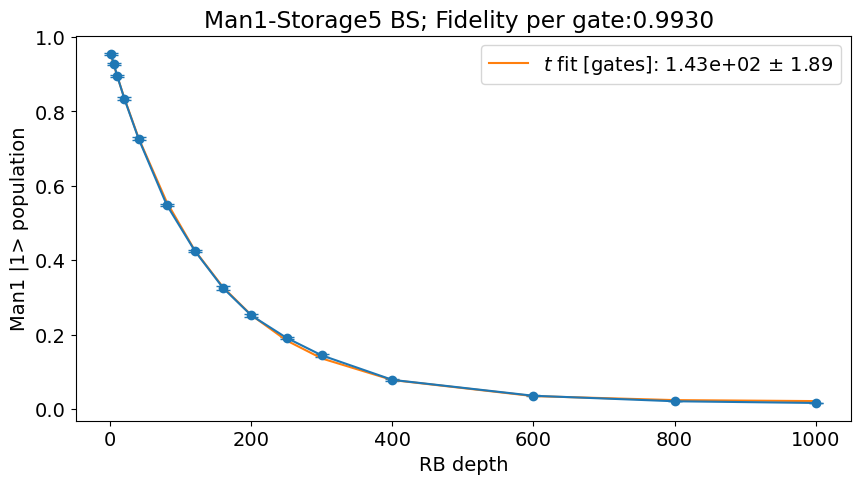

In [361]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
file_list = np.arange(94,109,1)
# file_list = np.arange(40,46,1)
name = '_SingleBeamsplitterRB_sweep_depth.h5'

plt.figure(figsize=(10,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract_excited(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'Man1-Storage5 BS; Fidelity per gate:{np.exp(-1/fit[3]):.4f} ')
plt.legend()
plt.show()

In [363]:
xlist

[1, 5, 10, 20, 40, 80, 120, 160, 200, 250, 300, 400, 600, 800, 1000]

In [362]:
fids_list

[0.9545666666666666,
 0.9274,
 0.8941999999999998,
 0.8338333333333332,
 0.7272666666666666,
 0.5488666666666667,
 0.4248333333333333,
 0.3254666666666666,
 0.2518,
 0.19153333333333336,
 0.14443333333333333,
 0.0787,
 0.036000000000000004,
 0.021233333333333337,
 0.01666666666666667]

In [298]:
attrs['config']['expt']

{'qubit': 0,
 'singleshot_reps': 10000,
 'span': 60,
 'reps': 1000,
 'rounds': 1,
 'variations': 30,
 'rb_depth': 1000,
 'IRB_gate_no': -1,
 'bs_para': [1053.42, 7500, 0.978002, 0.005],
 'prepulse': True,
 'postpulse': True,
 'f0g1_offset': 0,
 'pre_sweep_pulse': [[3568.187817769269, 3425.557033831784, 0, 2006.76],
  [9653, 7575, 0, 15000],
  [0.0, 0.0, 0.01, 0.621500217304513],
  [0, 0, 0, 0],
  [2, 2, 5, 5],
  ['gaussian', 'gaussian', 'flat_top', 'flat_top'],
  [0.035, 0.035, 0.005, 0.005]],
 'post_sweep_pulse': [[2006.76, 3425.559887601728],
  [15000, 7575],
  [0.621500217304513, 0.0],
  [0, 0],
  [5, 2],
  ['flat_top', 'gaussian'],
  [0.005, 0.035]],
 'running_list': [1,
  3,
  3,
  3,
  3,
  5,
  5,
  3,
  2,
  1,
  1,
  6,
  3,
  3,
  3,
  2,
  2,
  4,
  5,
  3,
  5,
  3,
  1,
  3,
  1,
  1,
  6,
  4,
  2,
  3,
  5,
  4,
  2,
  1,
  6,
  4,
  3,
  5,
  4,
  4,
  3,
  3,
  2,
  1,
  2,
  3,
  2,
  3,
  5,
  5,
  5,
  5,
  4,
  1,
  1,
  2,
  4,
  2,
  1,
  2,
  6,
  1,
  6,
  6,
 

In [61]:
fids_list[0]

0.9545666666666666

In [132]:
np.exp(np.log(0.25)/100)

0.9862327044933592

#### Other Gains

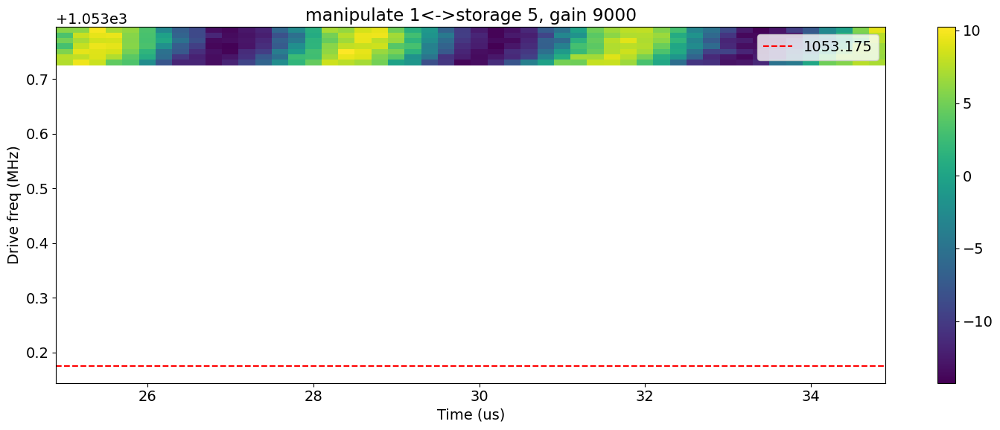

In [562]:
#file_list = np.arange(235,249)
#file_list = np.arange(263,270)
#file_list = np.arange(270,279)
#file_list = np.arange(295,307)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1053.175], vlines=None, title="manipulate 1<->storage 5, gain " + str(attrs['config']['expt']['flux_drive'][2]))
    

[ 13.68095764   0.20191778  89.0665158  123.68330625  -0.96307393
  -6.85299037]
Decay from avgi [us] 123.68330624676298
Rate [MHz] 0.2019177763778047
Pi length from avgi data [us]: 2.489097397442358
	Pi/2 length from avgi data [us]: 1.244548698721179

Decay from avgq [us] 170.98089402265862
Rate [MHz] 0.20203307159821998
Pi length from avgq data [us]: 2.493376619988429
Pi/2 length from avgq data [us]: 1.2466883099942145


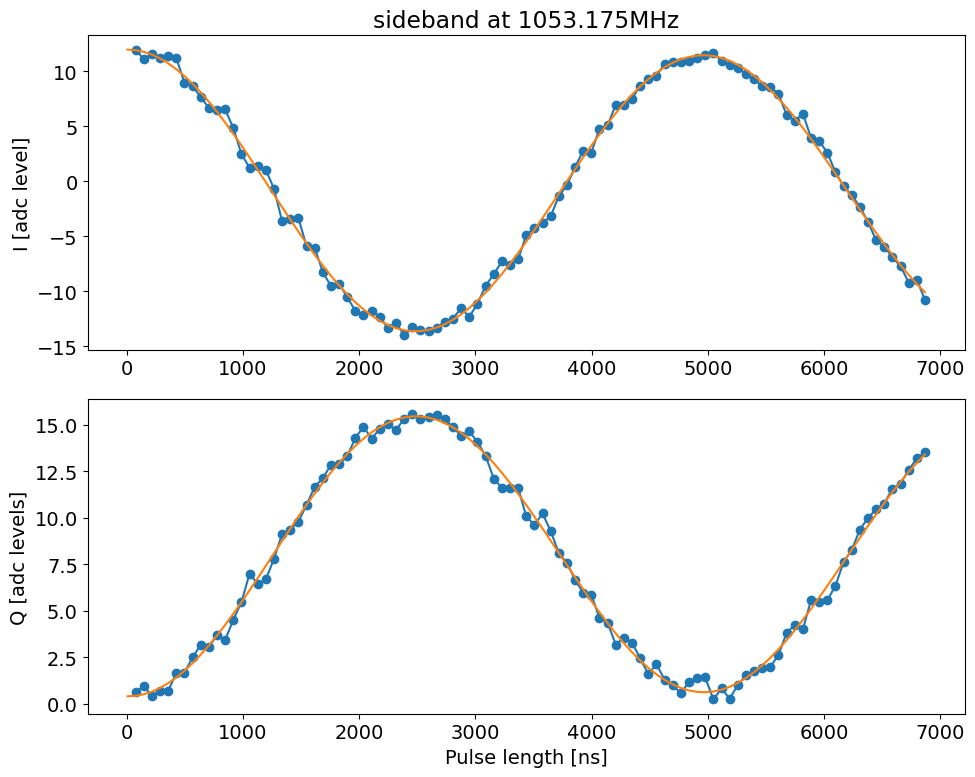

In [544]:
temp_data, attrs = prev_data(expt_path, '00016_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

479
488
482
481
479
488


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


480
479
476
484


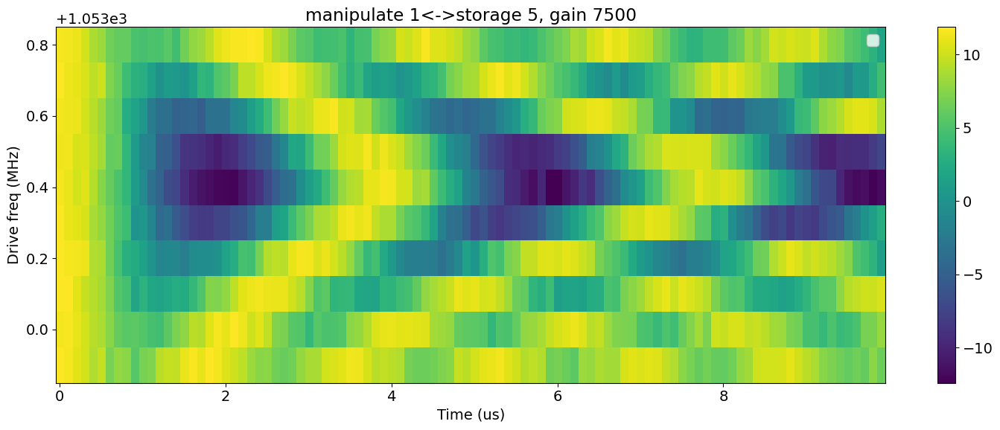

In [125]:
file_list = np.arange(1200,1210)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->storage 5, gain " + str(attrs['config']['expt']['flux_drive'][2])
                    ,active_reset=True, readout_per_round=4, threshold=-4.0)
    

[ 13.23350057   0.31340815  91.09219378 191.62781931  -1.34253637
  -6.79049944]
Decay from avgi [us] 191.62781931325225
Rate [MHz] 0.31340814822166085
Pi length from avgi data [us]: 1.585683496768477
	Pi/2 length from avgi data [us]: 0.7928417483842385

Decay from avgq [us] 199.16032743783168
Rate [MHz] 0.3132798413129414
Pi length from avgq data [us]: 1.5905221191860508
Pi/2 length from avgq data [us]: 0.7952610595930254


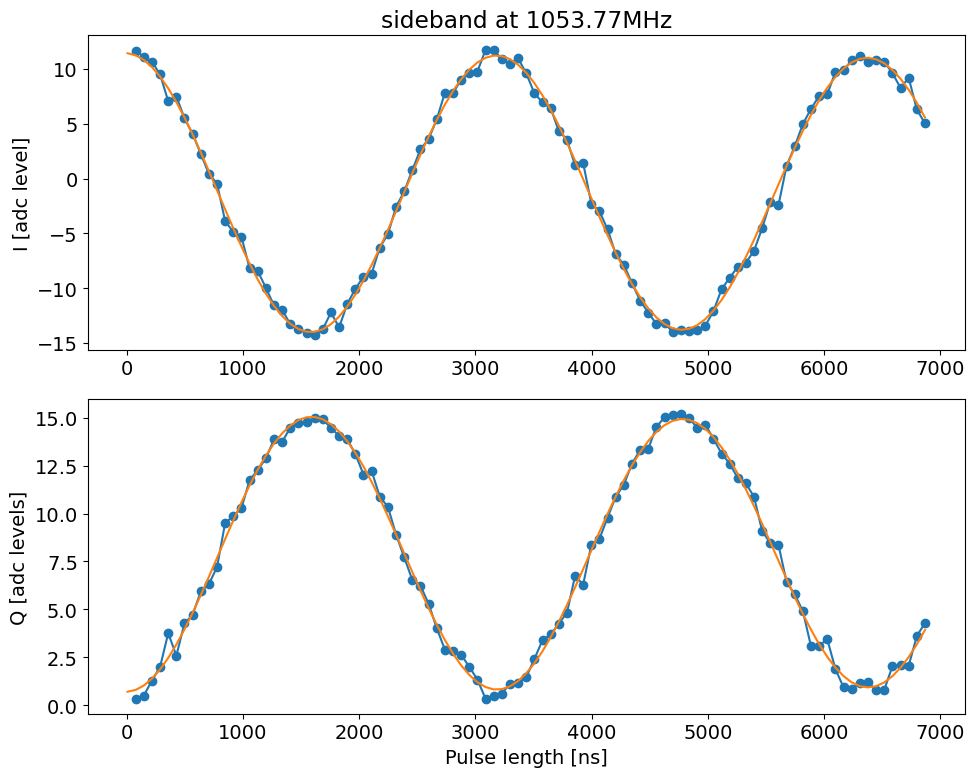

In [469]:
temp_data, attrs = prev_data(expt_path, '00012_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

#### POST SELECTION

In [353]:
temp_data, attrs = prev_data(expt_path, '00090_SingleBeamSplitterRBPostSelection_sweep_depth_storsweep.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
# avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited_old(temp_data)#, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

1953
0.6918087626754925
0.92296400180319


In [352]:
avg_readout

[0.8622816032887975,
 0.8746177370030581,
 0.8842213114754098,
 0.8728382502543235,
 0.890020366598778,
 0.9025641025641026,
 0.8860630722278738,
 0.8900308324768756,
 0.8912820512820513,
 0.8926380368098159,
 0.8862944162436548,
 0.8953252032520326,
 0.8809766022380467,
 0.8995901639344263,
 0.8657786885245902,
 0.8774259448416751,
 0.8908163265306123,
 0.8858307849133538,
 0.8729508196721312,
 0.8960244648318043,
 0.899492385786802,
 0.8852791878172589,
 0.8742331288343558,
 0.8672114402451481,
 0.895112016293279,
 0.9036511156186613,
 0.8696098562628337,
 0.867274569402229,
 0.8775510204081632,
 0.8773006134969326]

980
978
987
976
1953
1956
2950
2938
2939
2967
2952
4928
9897
9899
9871
9864
9862
9870
9841
9855


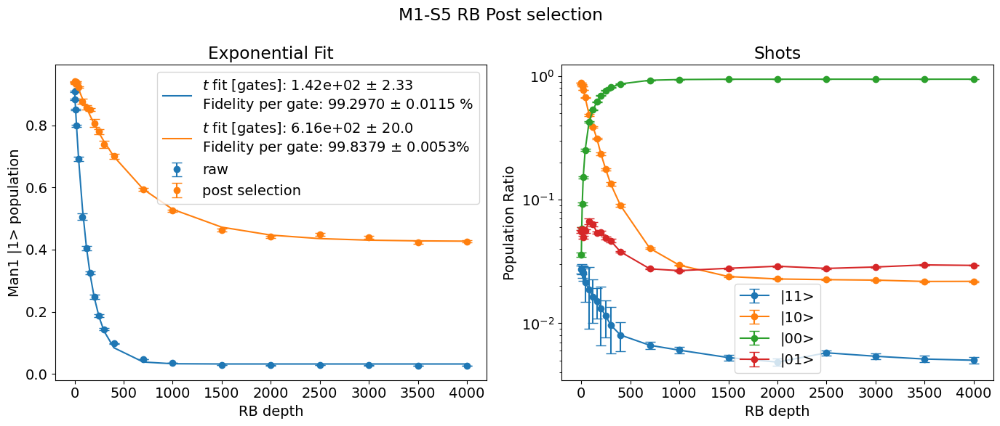

In [368]:
file_list = np.arange(86,106,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth_storsweep.h5'

# plt.figure(figsize=(12,5))
# plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
depth_list = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
    depth_list.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])


plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            title='M1-S5 RB Post selection')

### M1 - S6
losing signal above 9000

at 7500, max rb found in 0.48 

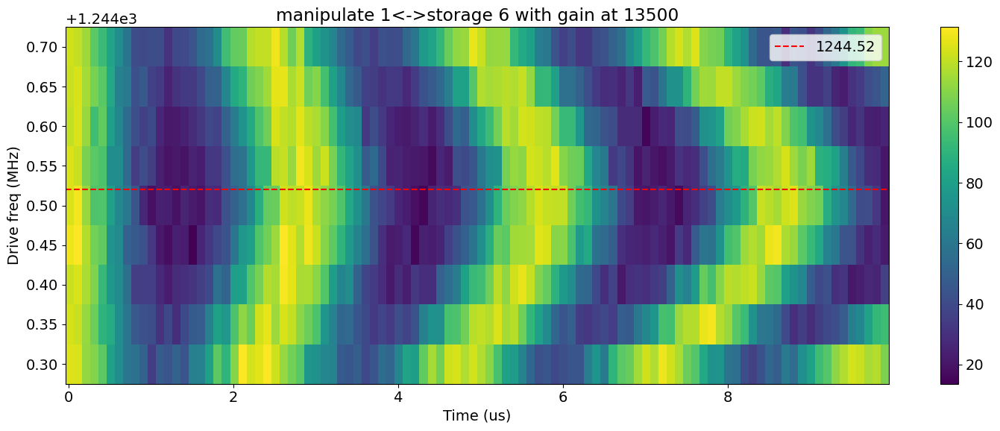

In [71]:
file_list = np.arange(203,212,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1244.52], vlines=None, title="manipulate 1<->storage 6 with gain at " + str(attrs['config']['expt']['flux_drive'][2]))

In [135]:
attrs['config']['expt']

{'start': 45,
 'step': 0.1,
 'qubits': [0],
 'expts': 100,
 'reps': 200,
 'rounds': 1,
 'flux_drive': ['high', 1245.22, 13500, 0.005],
 'prepulse': True,
 'postpulse': True,
 'active_reset': False,
 'man_reset': True,
 'storage_reset': True,
 'pre_sweep_pulse': [[3568.1904347121535, 3425.5537944060666, 2007.09],
  [10819, 8327, 15000],
  [0, 0, 0.615286689634651],
  [0, 0, 0],
  [2, 2, 0],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2007.09],
  [15000],
  [0.615286689634651],
  [0],
  [0],
  ['flat_top'],
  [0.005]],
 'length_placeholder': 54.9}

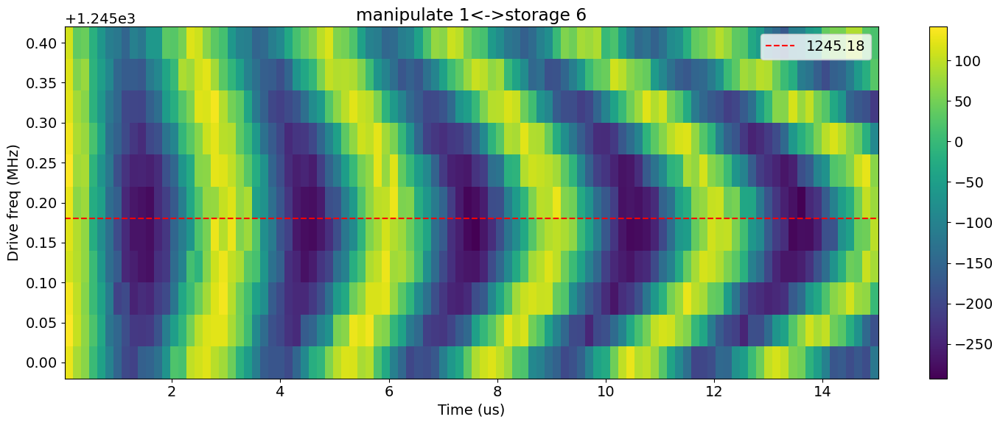

In [43]:
#file_list = np.arange(379,419,1)[10:-10]
# file_list = np.arange(411,422,1)
# file_list = np.arange(331, 353, 1)# ----
# file_list = np.arange(371, 389, 1) 
file_list = np.arange(4016, 4027, 1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
#name = '_storage_sideband_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1245.18], vlines=None, title="manipulate 1<->storage 6")
    

[ 62.0549977    0.3405109  101.79199974  98.89056167  66.2392493
  -4.88802259]
Decay from avgi [us] 98.89056167400503
Rate [MHz] 0.34051089884123337
Pi length from avgi data [us]: 1.372186460864359
	Pi/2 length from avgi data [us]: 0.6379955704971023
Fit params:  [ 62.0549977    0.3405109  101.79199974  98.89056167  66.2392493
  -4.88802259]

Decay from avgq [us] 58.2430492491232
Rate [MHz] 0.3411212908561274
Pi length from avgq data [us]: 1.3782196179457515
Pi/2 length from avgq data [us]: 0.6891098089728758
Fit params:  [ 35.98245203   0.34112129 100.74958014  58.24304925 -19.01453517
  -4.893     ]


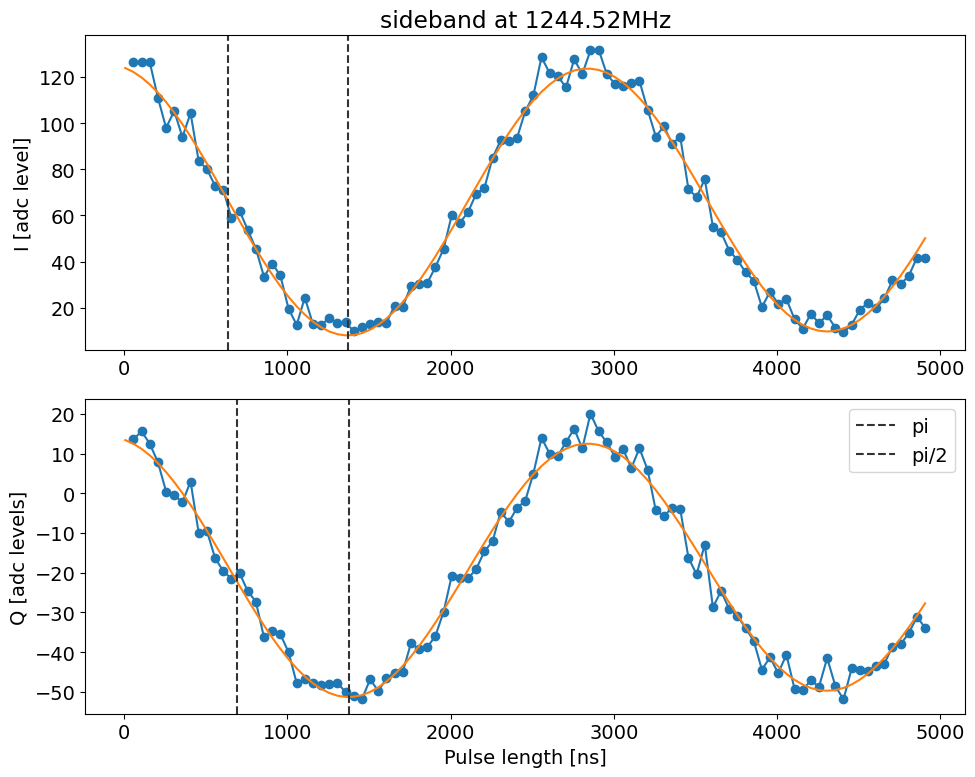

array([120.79605203, 126.55848455, 126.29173984, 126.38721301,
       111.00270569,  97.94910569, 105.24915122,  93.96444878,
       104.28107967,  83.44174309,  80.12005854,  72.82209431,
        71.21162927,  58.90429919,  61.99003577,  53.7879935 ,
        45.6262439 ,  33.38033821,  39.1356813 ,  33.96373333,
        19.59261789,  12.55869919,  24.37819837,  12.83560976,
        12.59319675,  15.49303415,  13.25255285,  13.59499837,
         9.78107317,  11.68013008,  13.14855935,  13.81285854,
        13.35415285,  20.9348878 ,  20.42626341,  29.40599675,
        30.4732878 ,  30.61533008,  37.65826341,  45.43252683,
        60.06649106,  56.75914146,  61.50125528,  69.37778211,
        71.8516813 ,  84.88680976,  92.6044748 ,  92.29715122,
        93.57540813, 105.05689756, 111.96169756, 128.61157073,
       121.55321626, 120.288     , 115.43928455, 127.62857886,
       121.27367805, 131.55236423, 131.8331122 , 121.16681626,
       116.94083252, 115.92452033, 117.19261789, 118.26

In [73]:

# temp_data, attrs = prev_data(expt_path, '00021_SidebandGeneralExperiment.h5')
temp_data, attrs = prev_data(expt_path, '00003_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00000_rb_bs_optimization.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, 
                    active_reset=False, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

In [61]:
temp_data

{'avgi': array([ 154.16148052,  135.73291558,  101.72099351,  104.55381169,
          79.18335714,   17.16038312,    1.68899351,  -67.83661039,
        -118.33607792, -151.56368831, -186.01098701, -246.04833766,
        -251.58372078, -275.17037662, -287.45833766, -294.40167532,
        -285.02822727, -274.10827273, -255.47056494, -204.88774026,
        -196.04094156, -149.87275974, -101.59824675,  -69.94664935,
         -13.60632468,   33.35337662,   57.55192208,   81.71366234,
         121.44405195,  132.36390909,  110.90945455,  111.23533117,
         127.00091558,   87.95205844,   48.20292857,   15.48700649,
           7.3230974 ,  -58.75605844,  -99.76096753, -153.13499351,
        -182.40818831, -229.58604545, -254.28692208, -288.83783766,
        -280.31680519, -294.16629221, -291.73943506, -282.69602597,
        -260.30862987, -238.57677922, -197.22658442, -152.23242208,
        -112.45425974,  -60.33458442,  -26.09823377,   33.92504545,
          56.93334416,   68.45787662,  1

In [74]:
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M1-S6', freq, 0.05, pi_length, pi2_length, gain)

In [75]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,348.85,0.01,0.784259,0.343947,3000,2025-03-11 12:35:25.500986
1,M1-S2,521.23,0.05,1.069160,0.531718,5000,2025-01-21 16:17:17.763411
2,M1-S3,696.98,0.03,1.256963,0.613370,9000,2025-01-21 16:17:39.113328
3,M1-S4,874.50,0.05,1.087371,0.539636,9000,2025-03-10 16:38:50.696707
4,M1-S5,1053.95,0.03,1.882097,0.985547,7500,2025-01-21 16:18:31.141469
5,M1-S6,1244.52,0.05,1.372186,0.637996,13500,2025-03-12 09:53:56.486329
6,M1-S7,1422.35,0.05,1.964983,0.927853,10000,2025-03-12 09:14:13.544748
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


#### RB check


In [720]:
# temp_data, attrs = prev_data(expt_path, '00127_SingleBeamsplitterRB_sweep_depth.h5')
temp_data, attrs = prev_data(expt_path, '00126_SingleBeamSplitterRB.h5')
#temp_data, attrs = prev_data(expt_path, '00001_rb_bs_optimization.h5')
avg_readout = []
for i in range(len(temp_data['Idata'])):
    counting = 0
    for j in temp_data['Idata'][i]:
        if j>temp_data['thresholds']:
            counting += 1
    avg_readout.append(counting/len(temp_data['Idata'][i]))
#
# avg_readout = RB_extract(temp_data)
mean = np.average(avg_readout)
err = np.std(avg_readout)/np.sqrt(len(avg_readout))
print(mean, err)

0.6388666666666667 0.0036495763325908683


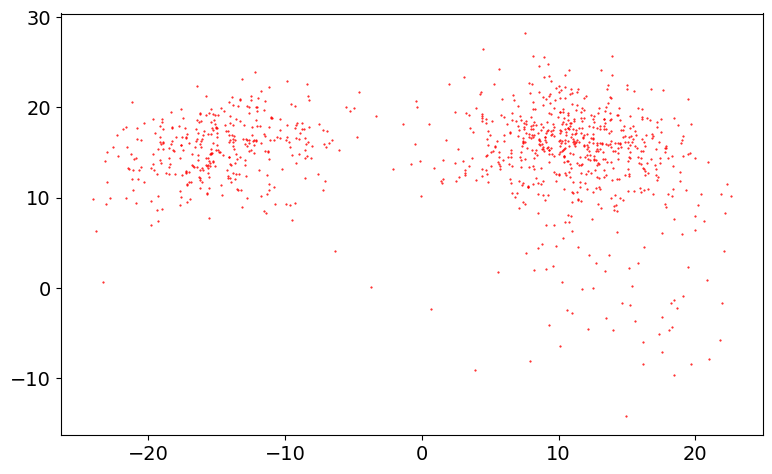

In [721]:
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(8, 5))
fig.tight_layout()

axs.scatter(temp_data['Idata'][1], temp_data['Qdata'][1], label='e', color='r', marker='.', s=1)

Fit Decay constant avgi [gates]: 252.79921678934093


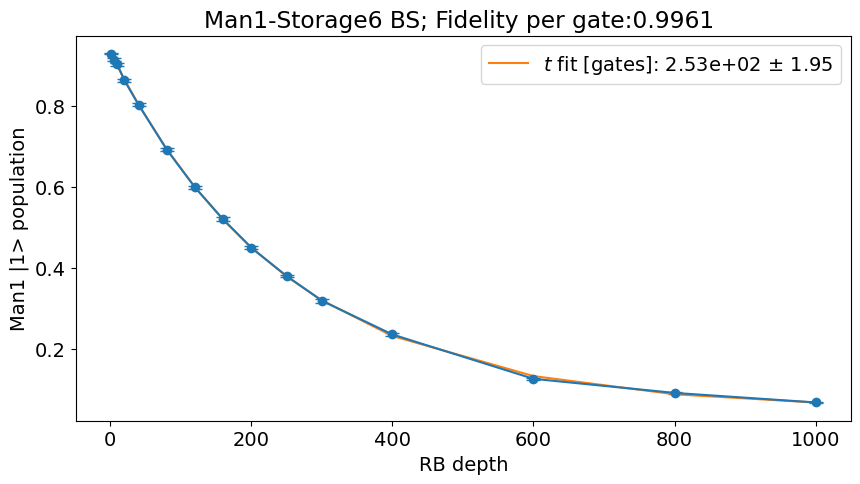

In [129]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
file_list = np.arange(124,139,1)
# file_list = np.arange(40,46,1)
name = '_SingleBeamsplitterRB_sweep_depth.h5'

plt.figure(figsize=(10,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract_excited(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'Man1-Storage6 BS; Fidelity per gate:{np.exp(-1/fit[3]):.4f} ')
plt.legend()
plt.show()

292
290
293
286
284
283
281
285
283
288
282
292
290
293
283
286


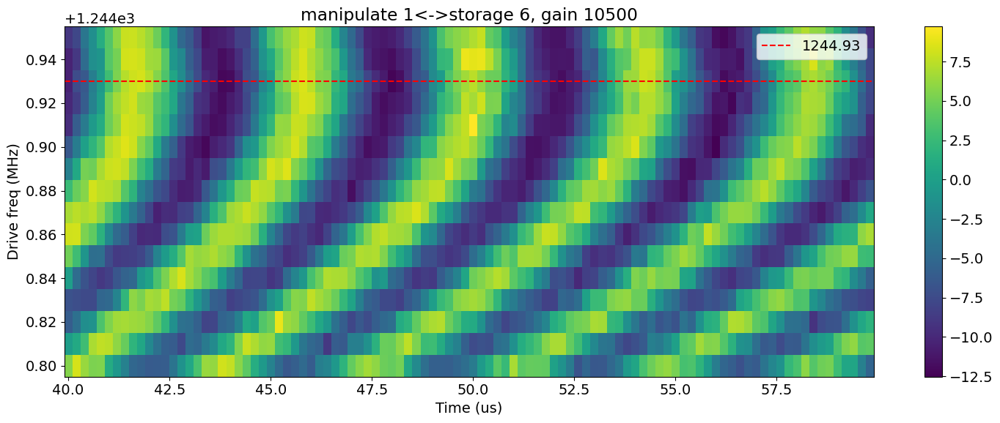

In [141]:
file_list = np.arange(1230,1246)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1244.93], vlines=None, title="manipulate 1<->storage 6, gain " + str(attrs['config']['expt']['flux_drive'][2])
                    ,active_reset=True, readout_per_round=4, threshold=-4.0)
    

[ 1.12475397e+01  2.39911828e-01  9.02466702e+01  7.44486172e+03
 -2.52124714e-01  1.04679292e+00]
Decay from avgi [us] 7444.861723428143
Rate [MHz] 0.2399118279057683
Pi length from avgi data [us]: 2.081242969408218
	Pi/2 length from avgi data [us]: 1.040621484704109
Fit params:  [ 1.12475397e+01  2.39911828e-01  9.02466702e+01  7.44486172e+03
 -2.52124714e-01  1.04679292e+00]

Decay from avgq [us] 250.77912054410984
Rate [MHz] 0.23986991340192104
Pi length from avgq data [us]: 2.0812148440544256
Pi/2 length from avgq data [us]: 1.0406074220272128
Fit params:  [ 1.02485707e+01  2.39869913e-01 -8.97194968e+01  2.50779121e+02
  8.01919583e+00 -1.37093442e-01]


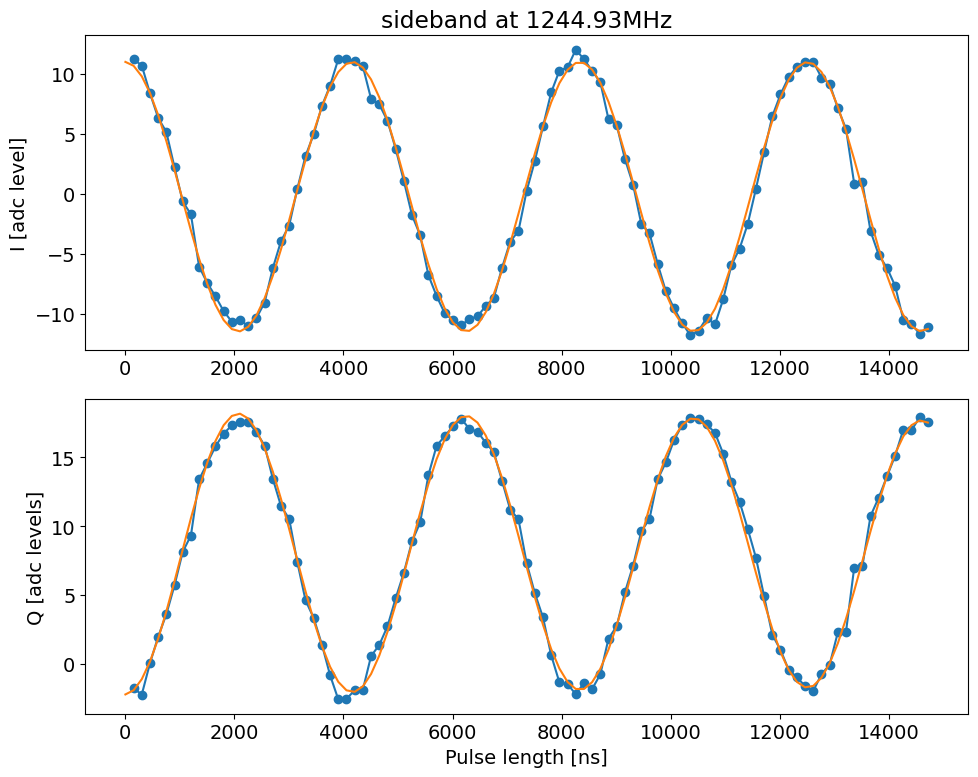

In [142]:
temp_data, attrs = prev_data(expt_path, '00092_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00037_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=[13, 0.1, None, None, None, None], active_reset=True,threshold=-4.3, readout_per_round=4,
                     title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

#### POST SELECTION

979
980
973
982
1951
1948
2917
2924
2942
2921
2938
4874
9776
9768
9778
9701
9703
9675
9626
9578
9460


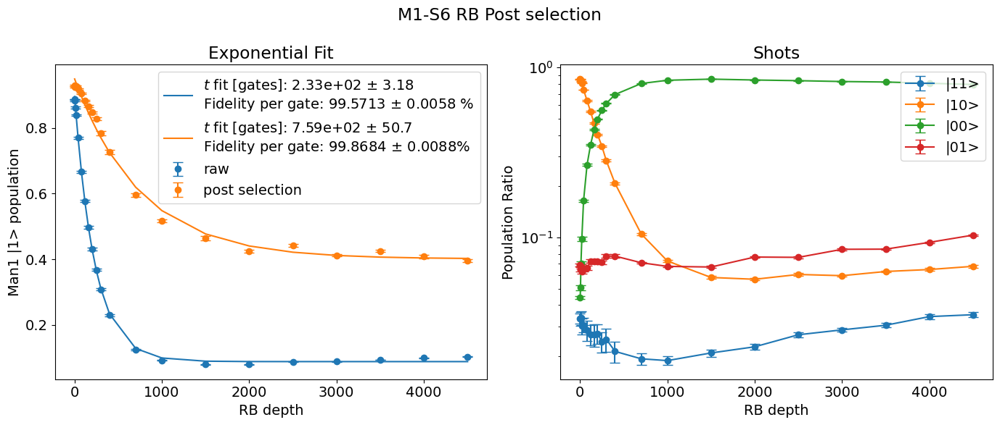

In [373]:
file_list = np.arange(107,128,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth_storsweep.h5'

# plt.figure(figsize=(12,5))
# plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
depth_list = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
    depth_list.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])


plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            title='M1-S6 RB Post selection')

In [249]:
ee_list_err

[0.022194354668848046,
 0.01746999123543166,
 0.01976888294076458,
 0.01816811904522979,
 0.015026574197470615,
 0.012225363954749284,
 0.010783268462112833,
 0.008878481949697224,
 0.007768745593991658,
 0.006312050841263853,
 0.005077758912710863,
 0.0010933773837265887,
 0.0006510605441319146,
 0.0006290317067983081,
 0.0010224417578072664,
 0.0005086938763565319]

In [148]:
temp_data, attrs = prev_data(expt_path, '00138_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

979
0.3330099296378467
0.6965545672515991


In [147]:
print(gg[0],ge[0],eg[0],ee[0])

0.789 0.016 0.168 0.027


### M1 - S7

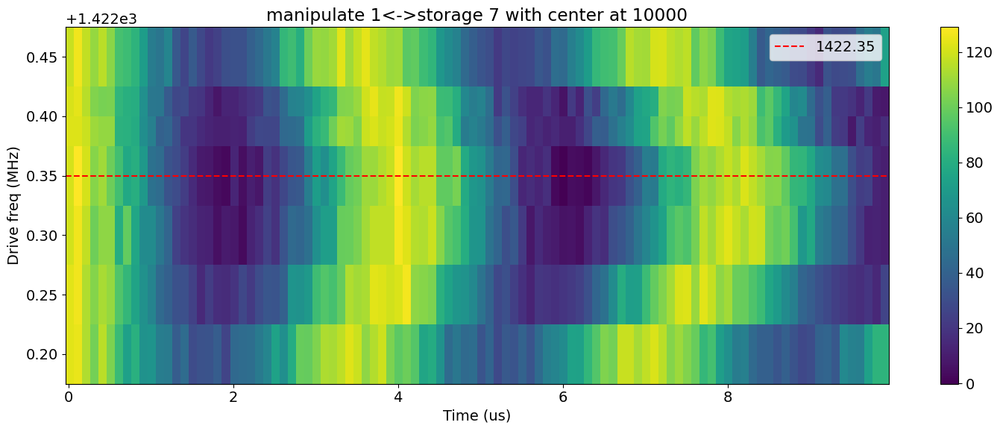

In [51]:
file_list = np.arange(196,203,1)
y_list = []
freq_list = []
name = '_storage_sideband_sweep.h5'
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1422.35], vlines=None, title="manipulate 1<->storage 7 with center at " + str(attrs['config']['expt']['flux_drive'][2]))

C:\Users\26049\AppData\Local\Temp\ipykernel_17676\1203605475.py:25: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  cax = plt.pcolormesh(x_timelist,y_freqlist[:znew.shape[0]],znew)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


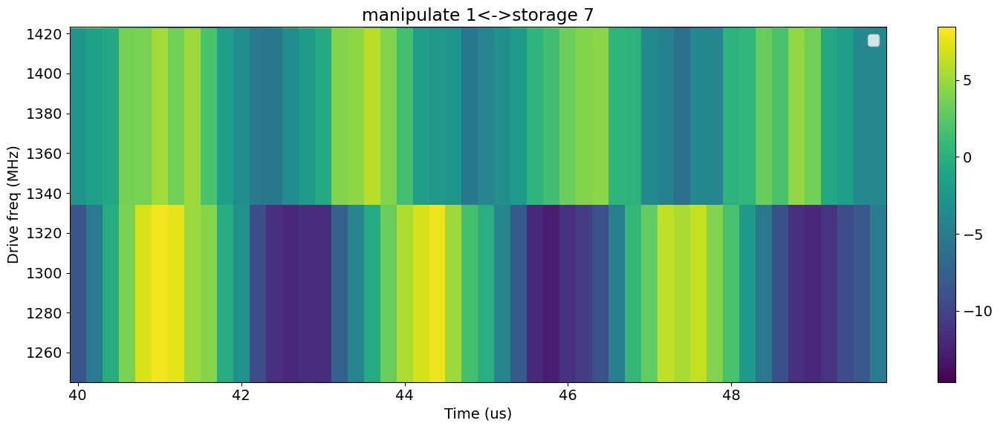

In [263]:
file_list = np.arange(419,459,1)
# file_list = np.arange(426, 439, 1)# ----
#file_list = np.arange(444, 450, 1)# ----
# file_list = np.arange(451, 457, 1)# ----
#file_list = np.arange(472, 486, 1)# ----
y_list = []
freq_list = []
#name = '_storage_sideband_sweep.h5'
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->storage 7")
    

In [200]:
232.8480158856536/2

116.4240079428268

In [37]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.400,0.05,0.993479,0.496739,3000,2024-09-14 19:09:56.961915
1,M1-S2,520.930,0.05,1.128904,0.564452,5000,2024-09-14 22:03:56.910498
2,M1-S3,696.660,0.05,1.343910,0.671955,9000,2024-09-15 00:50:57.969835
3,M1-S4,875.830,0.05,1.275784,0.637892,9000,2024-09-15 01:44:30.384256
4,M1-S5,1053.420,0.05,1.956004,0.978002,7500,2024-09-15 06:04:59.007994
5,M1-S6,1245.180,0.05,1.605961,0.802981,13500,2024-09-16 01:04:56.166820
6,M1-S7,1423.150,0.01,1.372788,0.686394,16500,2024-09-16 13:37:54.593971
7,M1-S8,-1.000,-1.00,-1.000000,-1.000000,-1,2024-09-10 04:51:31.277170
8,M1-S9,-1.000,-1.00,-1.000000,-1.000000,-1,2024-09-10 04:51:31.277170
9,M1-S10,-1.000,-1.00,-1.000000,-1.000000,-1,2024-09-10 04:51:31.277170


Attempted to init fitparam 4 to 68.76186646957379, which is out of bounds -50.41416585365854 to 17.588455284552847. Instead init to -16.412855284552847
[70.59540438  0.24104979 99.48285552 48.13187908 62.34497548 -4.88136626]
Decay from avgi [us] 48.131879080954704
Rate [MHz] 0.24104979491661166
Pi length from avgi data [us]: 1.96498293980624
	Pi/2 length from avgi data [us]: 0.9278528311227434
Fit params:  [70.59540438  0.24104979 99.48285552 48.13187908 62.34497548 -4.88136626]

Decay from avgq [us] 9.035340232791288
Rate [MHz] 0.23049560531498203
Pi length from avgq data [us]: 1.941654858345607
Pi/2 length from avgq data [us]: 0.9708274291728035
Fit params:  [ 68.51263415   0.23049561 108.88455172   9.03534023 -15.77818182
  -4.893     ]


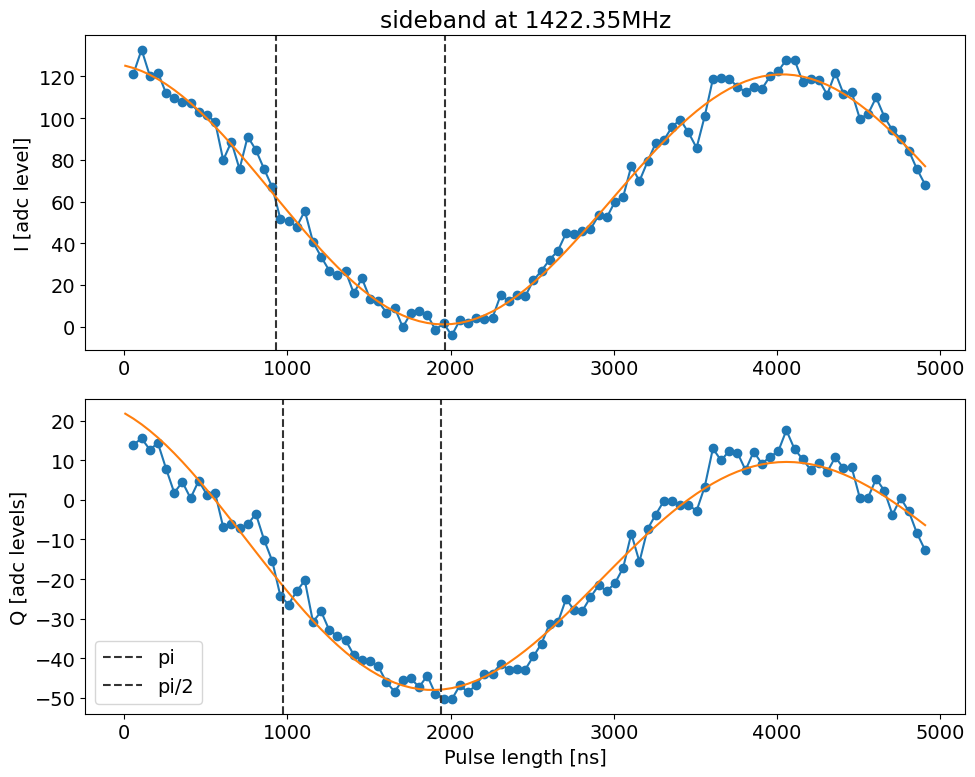

array([124.92499512, 121.25462764, 132.86776585, 120.40068943,
       121.85050407, 111.91995447, 109.86780488, 107.58234146,
       107.25709919, 102.91688455, 101.39538862,  98.37214959,
        79.87752195,  88.67982439,  75.57741138,  91.17315772,
        84.78805203,  75.71005528,  66.97604553,  51.76379187,
        50.79463415,  47.91425691,  55.5486374 ,  40.67761951,
        33.48199024,  26.89630569,  24.77462764,  26.54040976,
        16.02398049,  23.13705366,  13.30262764,  12.15253333,
         6.75259837,   9.20116423,  -0.23475122,   6.58897561,
         7.41506992,   5.79114146,  -1.51255285,   1.62937886,
        -4.15750244,   3.12597724,   1.85915447,   4.02293984,
         3.8611122 ,   4.39205854,  15.19922602,  12.2750439 ,
        15.09342439,  14.55300813,  22.22021463,  26.82649106,
        32.20187317,  36.34734309,  44.80794146,  44.6374439 ,
        46.01157724,  46.78533333,  53.3887935 ,  52.43322927,
        59.9472065 ,  62.23361951,  77.06555447,  69.86

In [53]:
# temp_data, attrs = prev_data(expt_path, '00129_SidebandGeneralExperiment.h5')
temp_data, attrs = prev_data(expt_path, '00002_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00020_rb_bs_optimization.h5')


length_rabi_display(temp_data, fit=True, active_reset= False, fitparams=[None, None, None, None, None, None], 
                    title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

In [848]:
np.exp(np.log(0.6)/43)


0.9881906189646007

In [54]:
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M1-S7', freq, 0.05, pi_length, pi2_length, gain)

In [55]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,348.850,0.01,0.784259,0.343947,3000,2025-03-11 12:35:25.500986
1,M1-S2,521.230,0.05,1.069160,0.531718,5000,2025-01-21 16:17:17.763411
2,M1-S3,696.980,0.03,1.256963,0.613370,9000,2025-01-21 16:17:39.113328
3,M1-S4,874.500,0.05,1.087371,0.539636,9000,2025-03-10 16:38:50.696707
4,M1-S5,1053.950,0.03,1.882097,0.985547,7500,2025-01-21 16:18:31.141469
5,M1-S6,1245.525,0.03,1.500950,0.732998,13500,2025-01-21 16:32:20.759195
6,M1-S7,1422.350,0.05,1.964983,0.927853,10000,2025-03-12 09:14:13.544748
7,M1-S8,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3


#### RB check

In [47]:
# check rb
#temp_data, attrs = prev_data(expt_path, '00140_SingleBeamSplitterRB.h5')
temp_data, attrs = prev_data(expt_path, '00021_rb_bs_optimization.h5')
avg_readout = []
for i in range(len(temp_data['Idata'])):
    counting = 0
    for j in temp_data['Idata'][i]:
        if j>temp_data['thresholds']:
            counting += 1
    avg_readout.append(counting/len(temp_data['Idata'][i]))
#
# avg_readout = RB_extract(temp_data)
mean = np.average(avg_readout)
err = np.std(avg_readout)/np.sqrt(len(avg_readout))
print(mean, err)

0.5247333333333334 0.003449294077000342


In [48]:
temp_data['confusion_matrix']

array([0.9898, 0.0102, 0.0406, 0.9594])

Fit Decay constant avgi [gates]: 160.10523810485705


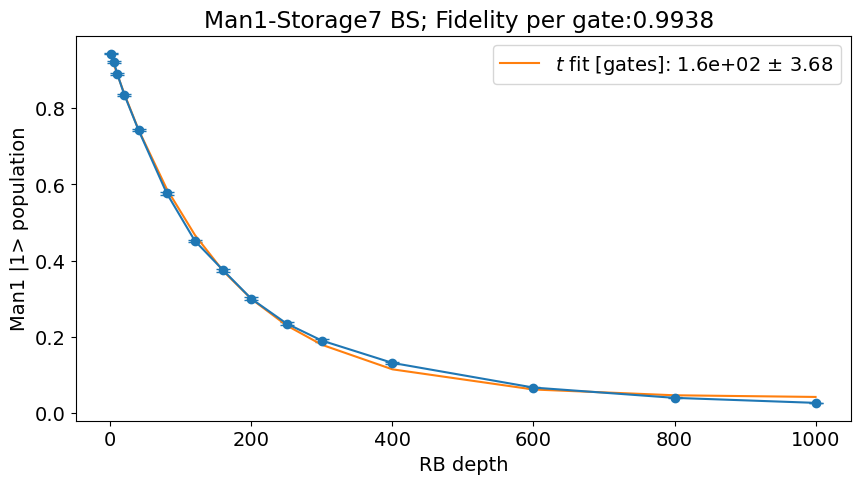

In [93]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
file_list = np.arange(139,154,1)
# file_list = np.arange(40,46,1)
name = '_SingleBeamsplitterRB_sweep_depth.h5'

plt.figure(figsize=(10,5))
plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract_excited(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit Decay constant avgi [gates]: {fit[3]}')
#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Man1 |1> population')
plt.title(f'Man1-Storage7 BS; Fidelity per gate:{np.exp(-1/fit[3]):.4f} ')
plt.legend()
plt.show()

#### POST SELECTION

954
939
951
943
1889
1895
2843
2872
2864
2885
2850
4772
9547
9448
9362
9471
9263
9320
9391
9153
9328


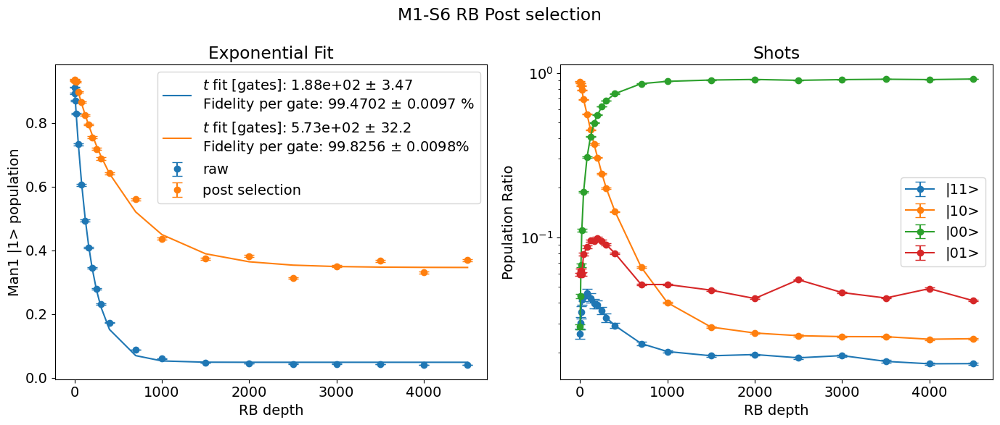

In [376]:
file_list = np.arange(128,149,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth_storsweep.h5'

# plt.figure(figsize=(12,5))
# plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
depth_list = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
    depth_list.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])


plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            title='M1-S6 RB Post selection')

### M1 - S8

282
286
289
285
285
293
288
284
289
293
283
291
292
284
293
287
288
281
291
290
286
287
286
280
284
291
280
286
282
284
270
281
284


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


289
287
283
294
284
293
272


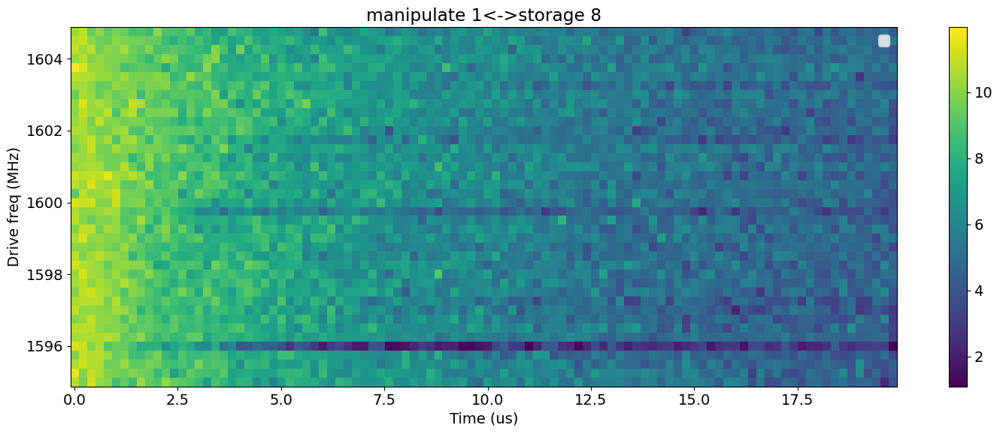

In [412]:
file_list = np.arange(1249,1289,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 1<->storage 8")
    

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


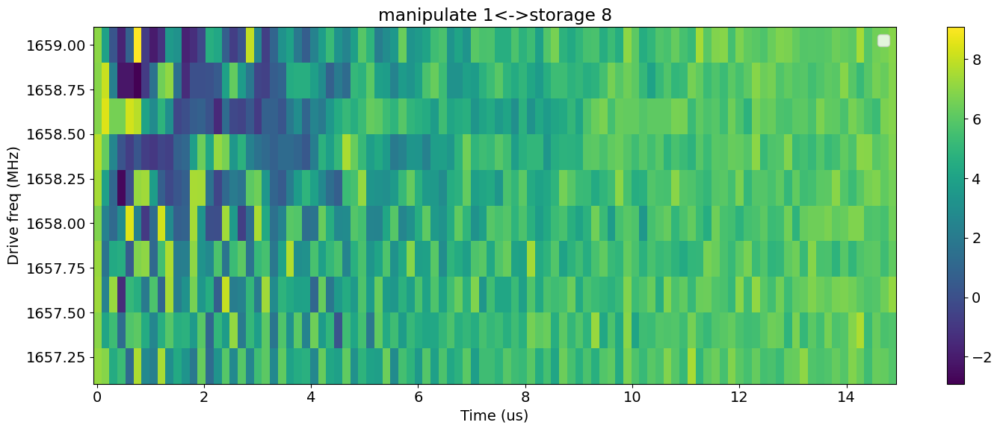

In [155]:
file_list = np.arange(28,38, 1)
y_list = []
freq_list = []
name = '_storage_t1_result_S8.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->storage 8")

### M1 - S10

In [ ]:
file_list = np.arange(286,326,1)
y_list = []
freq_list = []
name = '_storage_sideband_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->storage 10")
    

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


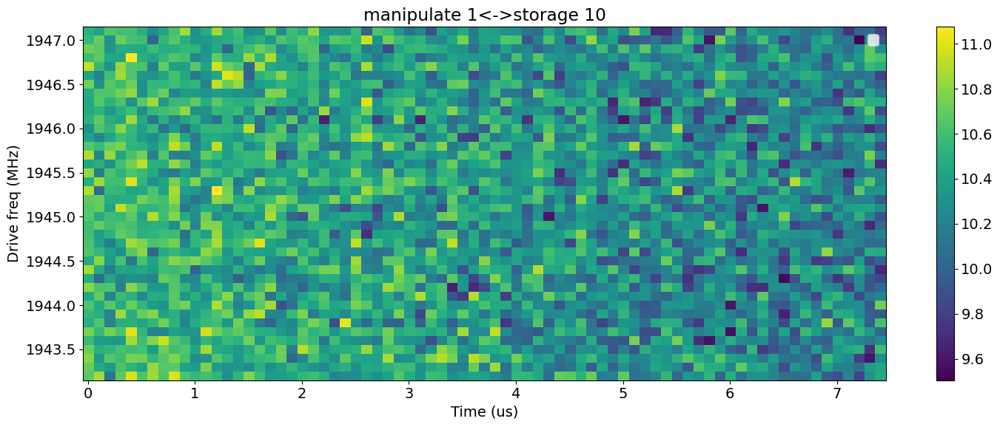

In [652]:
file_list = np.arange(286,326,1)
y_list = []
freq_list = []
name = '_storage_sideband_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->storage 10")
    

### M1 - S11

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


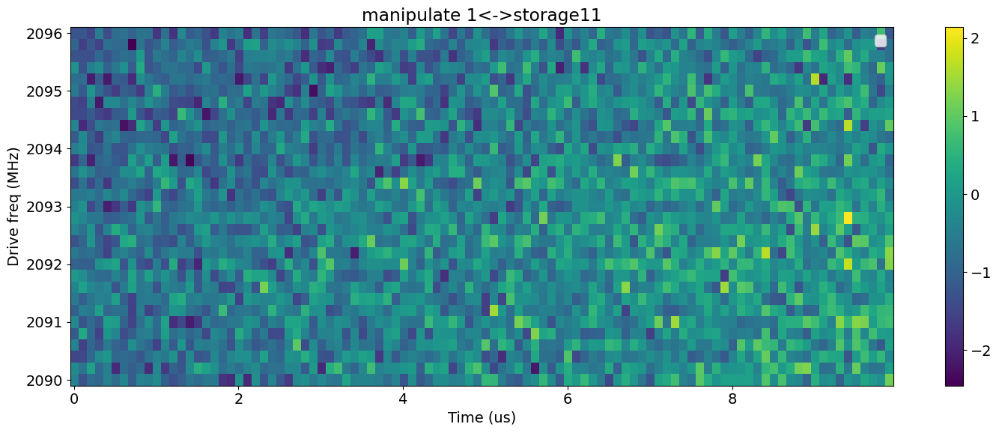

In [170]:
file_list = (np.arange(14,45,1))
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgq']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->storage11")
    

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


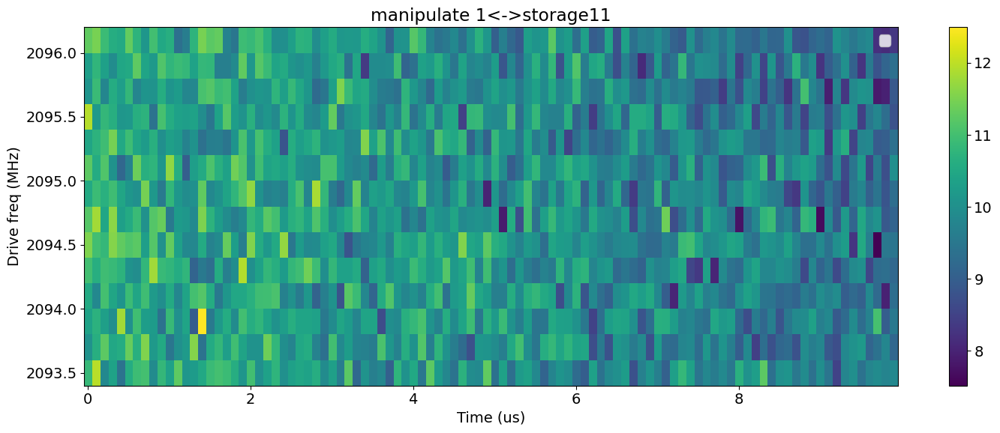

In [163]:
file_list = (np.arange(0,14,1))
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->storage11")
    

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


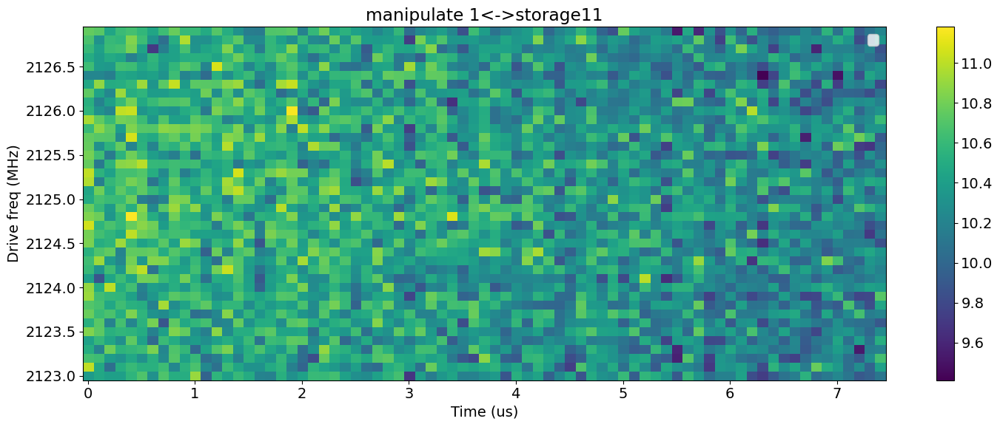

In [653]:
file_list = np.arange(326,366,1)
y_list = []
freq_list = []
name = '_storage_sideband_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->storage11")
    

### M1 - S12

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


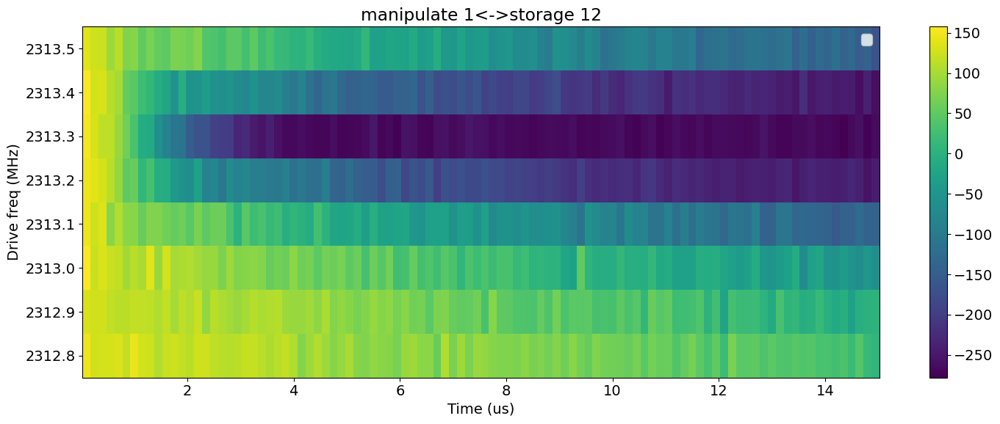

In [77]:
file_list = np.arange(722,726,1)
file_list = np.arange(4046,4054,1)
y_list = []
freq_list = []
name = '_storage_sideband_sweep.h5'
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->storage 12")
    

[ 2.37645640e+01  5.08172390e-02  1.11940500e+02  2.94000000e+00
 -1.20496453e+01  2.70970833e-01]
Decay from avgi [us] 2.9400000000000004
Rate [MHz] 0.050817239040491576
Pi length from avgi data [us]: 8.639866619922577
	Pi/2 length from avgi data [us]: 4.319933309961288
Fit params:  [ 2.37645640e+01  5.08172390e-02  1.11940500e+02  2.94000000e+00
 -1.20496453e+01  2.70970833e-01]

Decay from avgq [us] 2.9400000000000004
Rate [MHz] 1.306806552914874
Pi length from avgq data [us]: 0.5366465414305988
Pi/2 length from avgq data [us]: 0.2683232707152994
Fit params:  [  10.22577477    1.30680655 -162.4655581     2.94         12.4504677
   -4.81287515]


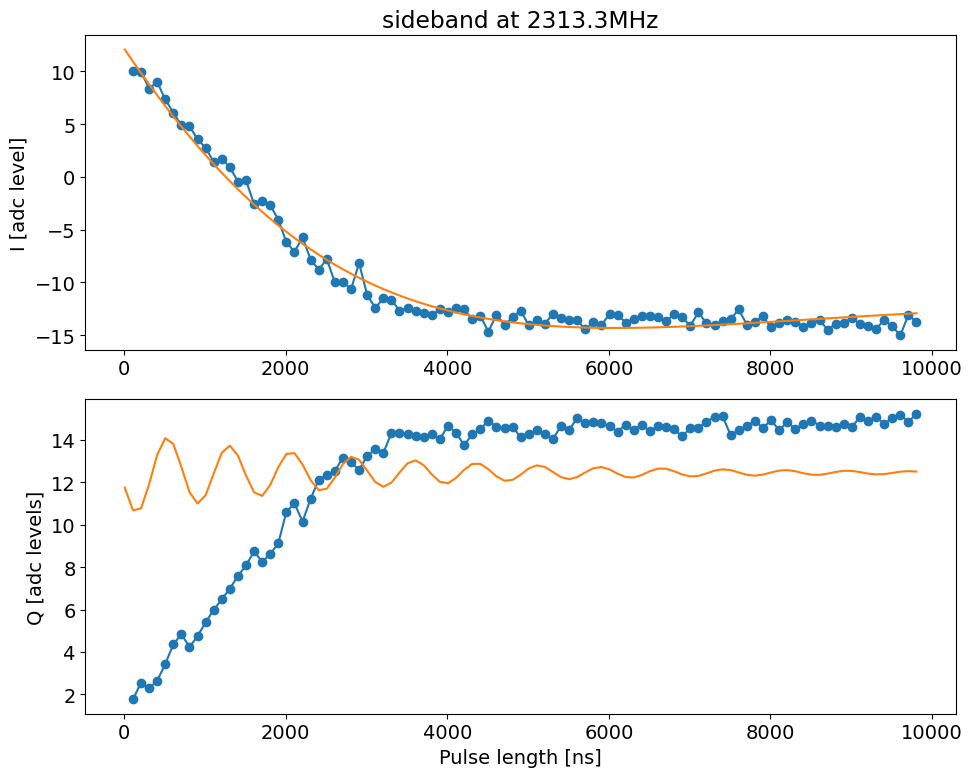

In [528]:
temp_data, attrs = prev_data(expt_path, '00039_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

### `M1 - S13`

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


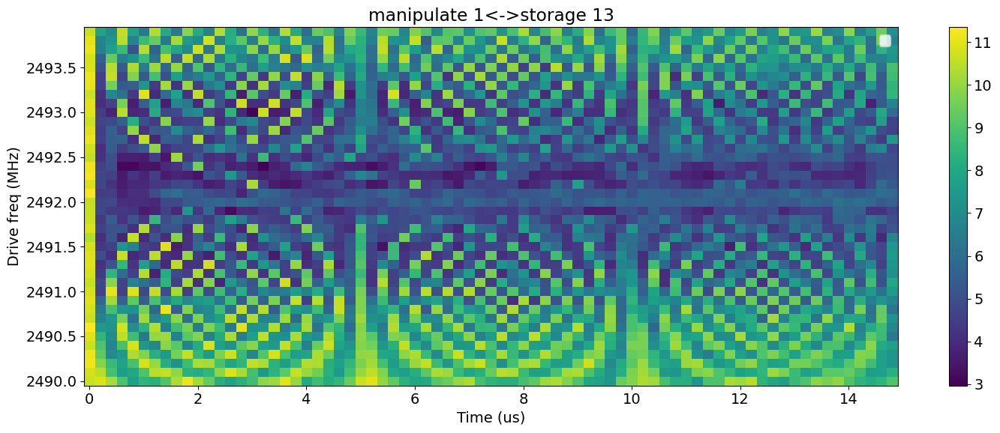

In [661]:
file_list = np.arange(759,799,1)
y_list = []
freq_list = []
name = '_storage_sideband_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->storage 13")
    

Decay from avgi [us] 154.83435625475983
Rate [MHz] 0.18062424510466205
Pi length from avgi data [us]: 2.768394852282626
	Pi/2 length from avgi data [us]: 1.384197426141313

Decay from avgq [us] 126.92711809113715
Rate [MHz] 0.18052018091835892
Pi length from avgq data [us]: 2.7708527246042767
Pi/2 length from avgq data [us]: 1.3854263623021383


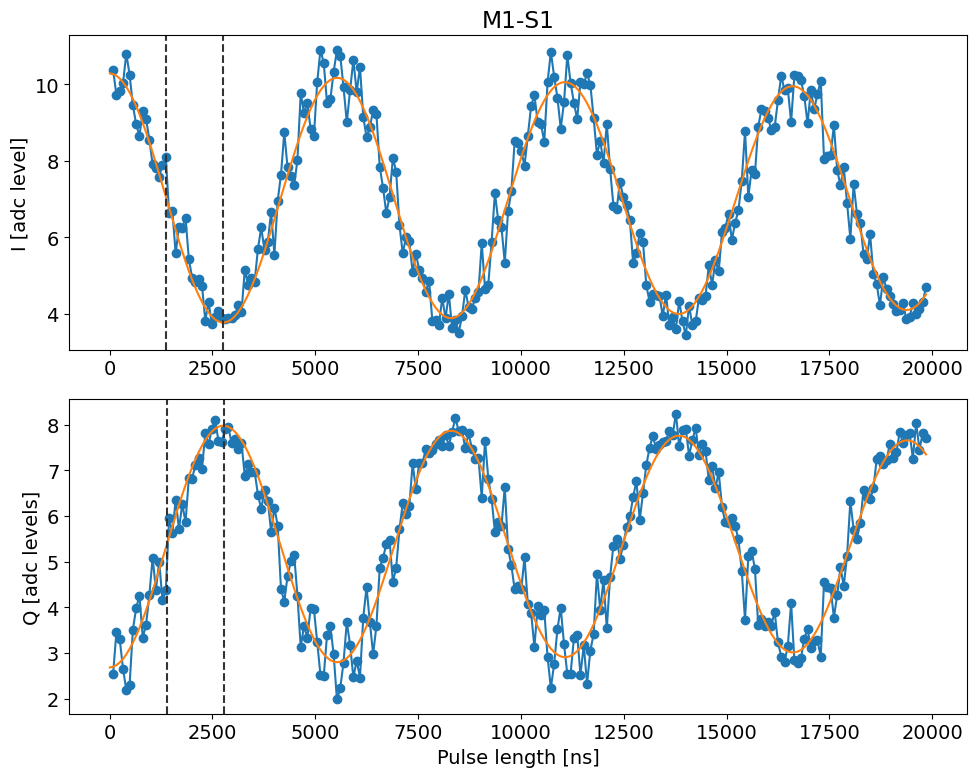

In [160]:
temp_data, attrs = prev_data(expt_path, '00001_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='M1-S1')

In [393]:
attrs['config']['expt']

{'start': 0.007,
 'step': 0.05,
 'qubits': [0],
 'expts': 201,
 'reps': 100,
 'rounds': 3,
 'flux_drive': ['low', 347.3, 2000, 0.005],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.108373272796, 3425.0273756372135, 0, 2006.4],
  [7219, 2576, 0, 2000],
  [0.0, 0.0, 0.01, 1.1297094577509874],
  [0, 0, 0, 0],
  [2, 2, 5, 5],
  ['gaussian', 'gaussian', 'flat_top', 'flat_top'],
  [0.015, 0.03, 0.005, 0.005]],
 'post_sweep_pulse': [[2006.4],
  [2000],
  [1.1297094577509874],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'length_placeholder': 10.007}

Decay from avgi [us] 5.940000000000001
Rate [MHz] 0.18966164269431682
Pi length from avgi data [us]: 3.5196481276668465
	Pi/2 length from avgi data [us]: 1.7598240638334233

Decay from avgq [us] 5.940000000000001
Rate [MHz] 0.19322001431535954
Pi length from avgq data [us]: 3.3967935373262406
Pi/2 length from avgq data [us]: 1.6983967686631203


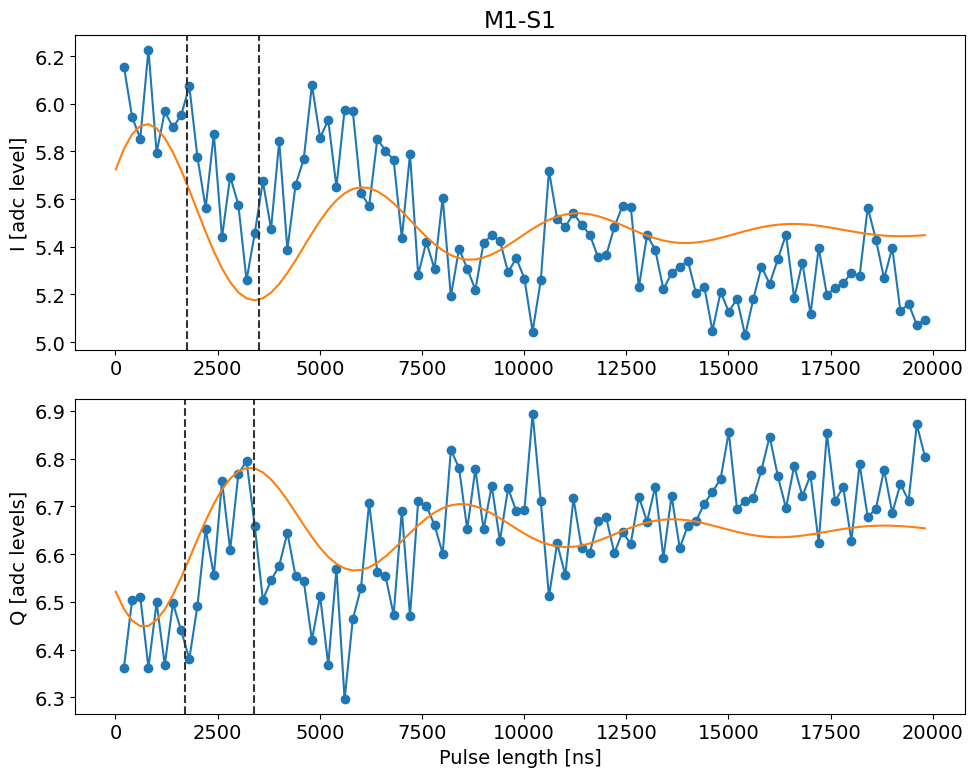

In [360]:
temp_data, attrs = prev_data(expt_path, '00018_SidebandGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='M1-S1')

### M1- Coupler

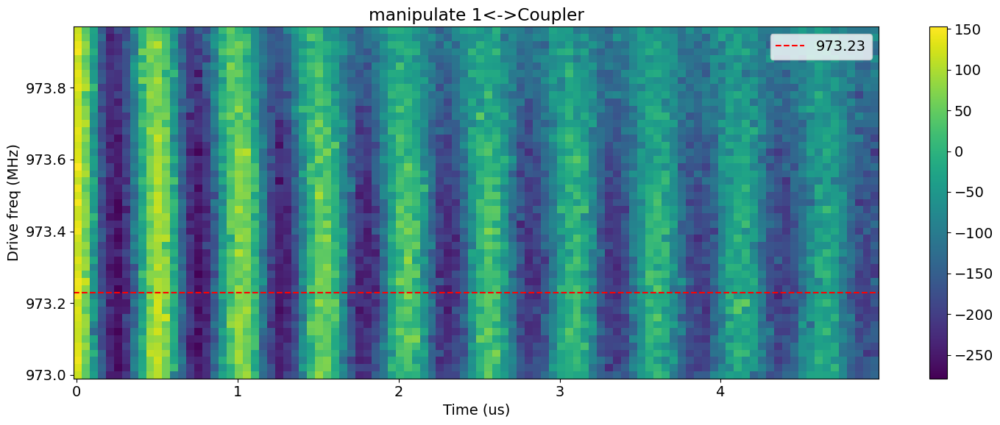

In [122]:
file_list = np.arange(46 ,95,1)
# file_list = np.arange(25, 40, 1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[973.23], vlines=None, title="manipulate 1<->Coupler")
    

In [115]:
file_no = 25
name = '_sideband_general_sweep.h5'

full_name = str(file_no).zfill(5)+name
temp_data, attrs = prev_data(expt_path, full_name)
attrs['config']['device']['readout']

{'trig_offset': [450],
 'frequency': [748.8],
 'gain': [700],
 'phase': [71],
 'threshold': [-111.51358024894762],
 'threshold_list': [-111.51358024894762],
 'man1_drive_list': [0],
 'man2_drive_list': [0],
 'readout_length': [1],
 'relax_delay': [2500],
 'confusion_matrix_with_reset': [0.9964530022802125,
  0.0035469977197875036,
  0.013768302080657598,
  0.9862316979193424],
 'confusion_matrix_without_reset': [0.9911499999999999,
  0.008850000000000136,
  0.023799999999999998,
  0.9762]}

[228.54322676   1.94828811  92.94737715   5.6585047  -80.34602816
  -0.83322969]
Decay from avgi [us] 5.658504696854689
Rate [MHz] 1.948288111864841
Pi length from avgi data [us]: 0.2524333224890898
	Pi/2 length from avgi data [us]: 0.12411554521706827
Fit params:  [228.54322676   1.94828811  92.94737715   5.6585047  -80.34602816
  -0.83322969]

Decay from avgq [us] 5.6051662891495155
Rate [MHz] 1.9456172713556785
Pi length from avgq data [us]: 0.2522682964568825
Pi/2 length from avgq data [us]: 0.12613414822844124
Fit params:  [ 191.09534594    1.94561727   93.30568034    5.60516629 -160.67590275
   -0.84550528]


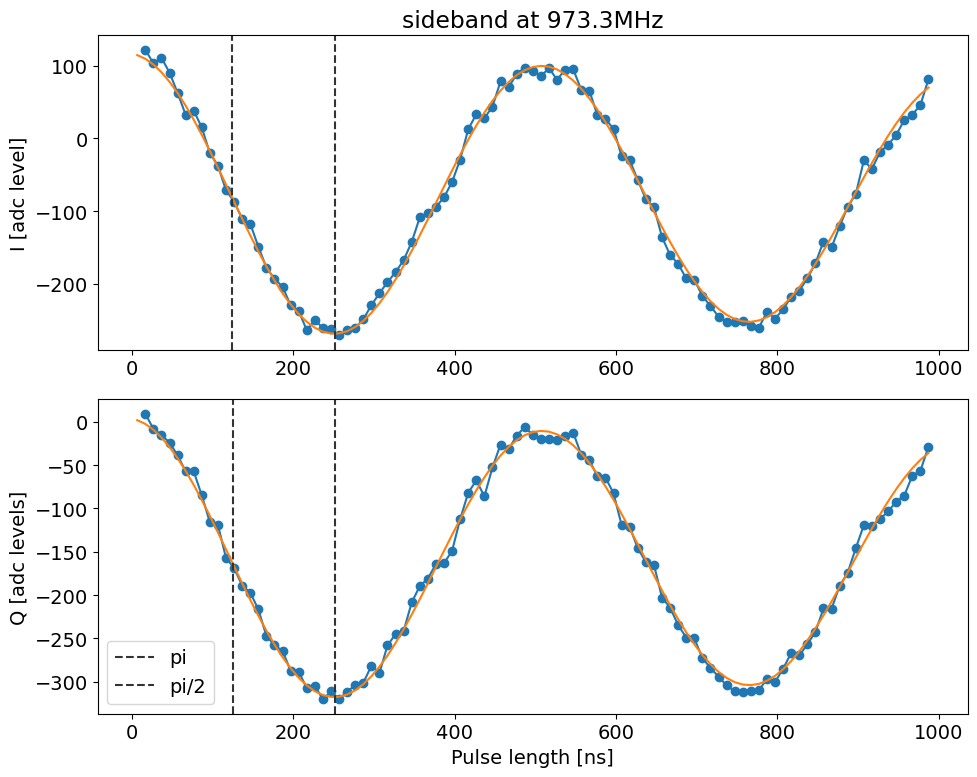

array([ 112.09027922,  122.35211039,  103.43588961,  111.04686364,
         90.83605844,   62.75414286,   32.62197403,   38.28271429,
         15.11243506,  -20.33065584,  -37.5926039 ,  -71.50691558,
        -86.88037662, -110.8004026 , -117.42783117, -149.04381818,
       -177.77109091, -193.29035065, -204.21483117, -229.89708442,
       -237.65544805, -264.07079221, -250.36208442, -260.89112987,
       -262.73286364, -271.24653896, -264.20638961, -260.7057013 ,
       -249.22753896, -229.82458442, -213.17902597, -198.02501299,
       -183.98486364, -167.81385714, -142.51679221, -108.83895455,
       -102.68207143,  -94.51603247,  -81.04891558,  -59.9215974 ,
        -28.99819481,   12.70709091,   33.41597403,   27.89127273,
         43.93642208,   78.51611688,   70.69561688,   88.34015584,
         97.57814286,   93.53216883,   85.49968831,   97.0670974 ,
         80.74631818,   94.86834416,   95.49945455,   66.83866234,
         65.87513636,   31.81485714,   26.63313636,   13.34709

In [46]:

temp_data, attrs = prev_data(expt_path, '00000_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00000_rb_bs_optimization.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz')

In [47]:
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M1-C', freq, 0.02, pi_length, pi2_length, gain)

In [48]:
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.415,0.01,0.977143,0.488571,3000,2024-10-26 17:42:46.915401
1,M1-S2,520.925,0.01,1.130904,0.565452,5000,2024-10-26 17:43:09.376354
2,M1-S3,696.665,0.01,1.333910,0.666955,9000,2024-10-26 17:43:34.019332
3,M1-S4,875.845,0.01,1.254287,0.627144,9000,2024-10-26 17:43:51.867832
4,M1-S5,1053.395,0.01,1.973198,0.986599,7500,2024-10-26 17:44:14.975970
5,M1-S6,1245.160,0.01,1.595310,0.797655,13500,2024-10-26 17:44:34.143253
6,M1-S7,1423.040,0.01,1.685008,0.842504,13500,2024-10-26 17:44:51.587301
7,M1-S8,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.000,-1.00,-1.000000,-1.000000,-1,51:31.3


### M2 - M1

##### Spectroscopy

Found peak in amps at [MHz] 174.24702942889982, HWHM 6.0951481747599106
Found peak in I at [MHz] 174.22510961807575, HWHM 6.636718293674202
Found peak in Q at [MHz] 174.2638777250749, HWHM 6.681965875188658


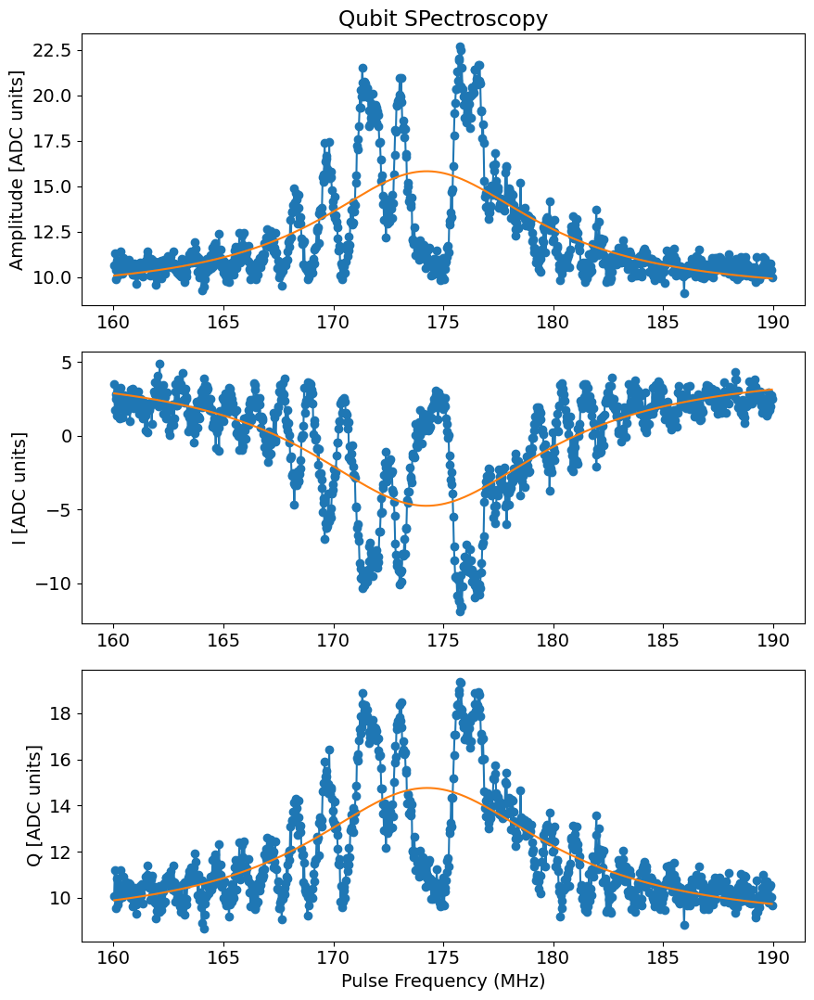

In [427]:
temp_data, attrs = prev_data(expt_path, '00065_FluxSpectroscopyF0g1Experiment.h5')
qubit_spectroscopy_display(temp_data)

#### Length rabi sweep

285
286
283
283
279
288
282
286
289
286
276
283
284
284
283
277
282
285
281
284


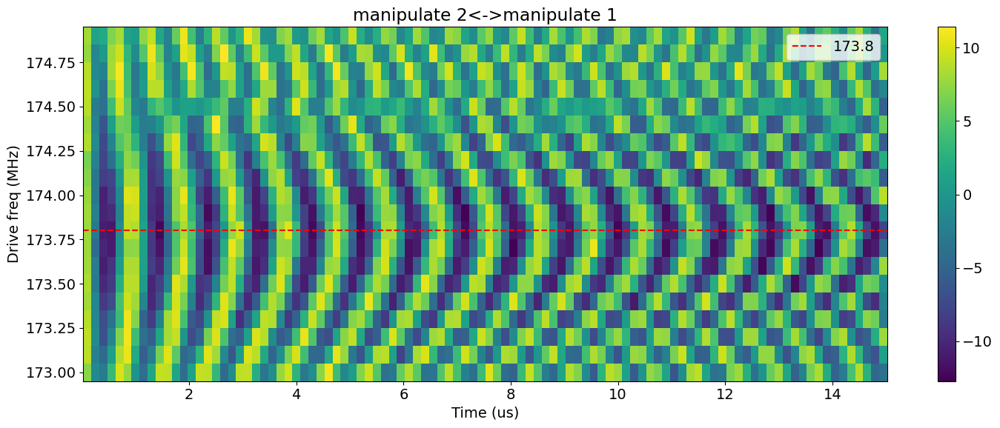

In [132]:
# file_list = np.arange(1297,1313,1)
file_list = np.arange(1718,1738,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[173.8], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->manipulate 1")
    

275
286
278
280
278
278
287
283
279
278


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


281
281
276
284
285
283
287


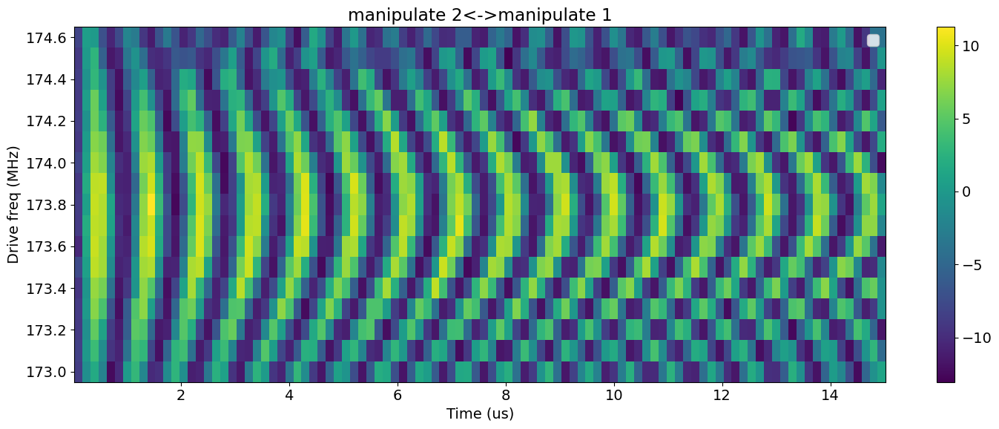

In [131]:
# file_list = np.arange(1297,1313,1)
file_list = np.arange(1738,1755,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->manipulate 1")
    

282
281
279
285
284
280
281
282
278
283
282
288
283
280
280
287
280
282


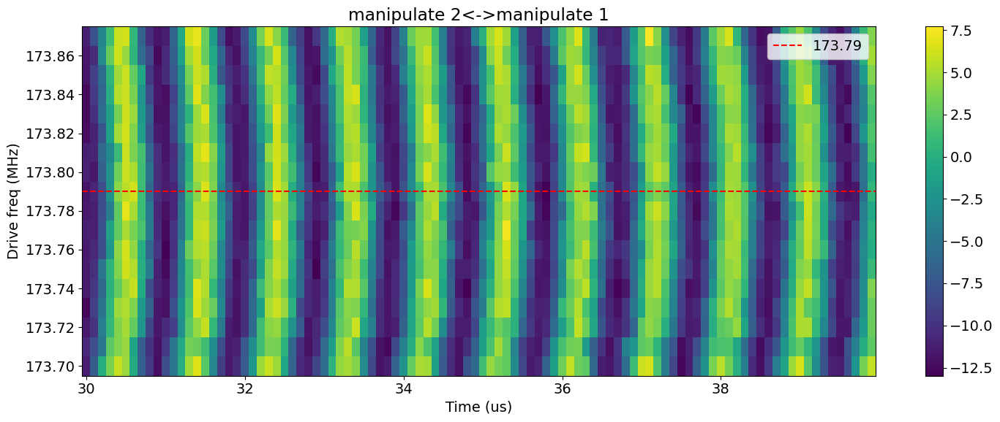

In [137]:
# file_list = np.arange(1297,1313,1)
file_list = np.arange(1758,1776,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[173.79], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->manipulate 1")
    

[12.17173303  1.04146231 96.22868364 45.86360577 -1.02906489 -2.92279934]
Decay from avgi [us] 45.86360577440237
Rate [MHz] 1.0414623101609104
Pi length from avgi data [us]: 0.46348110372931306
	Pi/2 length from avgi data [us]: 0.23174055186465653
Fit params:  [12.17173303  1.04146231 96.22868364 45.86360577 -1.02906489 -2.92279934]

Decay from avgq [us] 53.821285472227906
Rate [MHz] 1.042197763660582
Pi length from avgq data [us]: 0.46358751322158254
Pi/2 length from avgq data [us]: 0.23179375661079127
Fit params:  [ 12.27882315   1.04219776 -83.93395303  53.82128547   9.59314427
  -2.86208168]


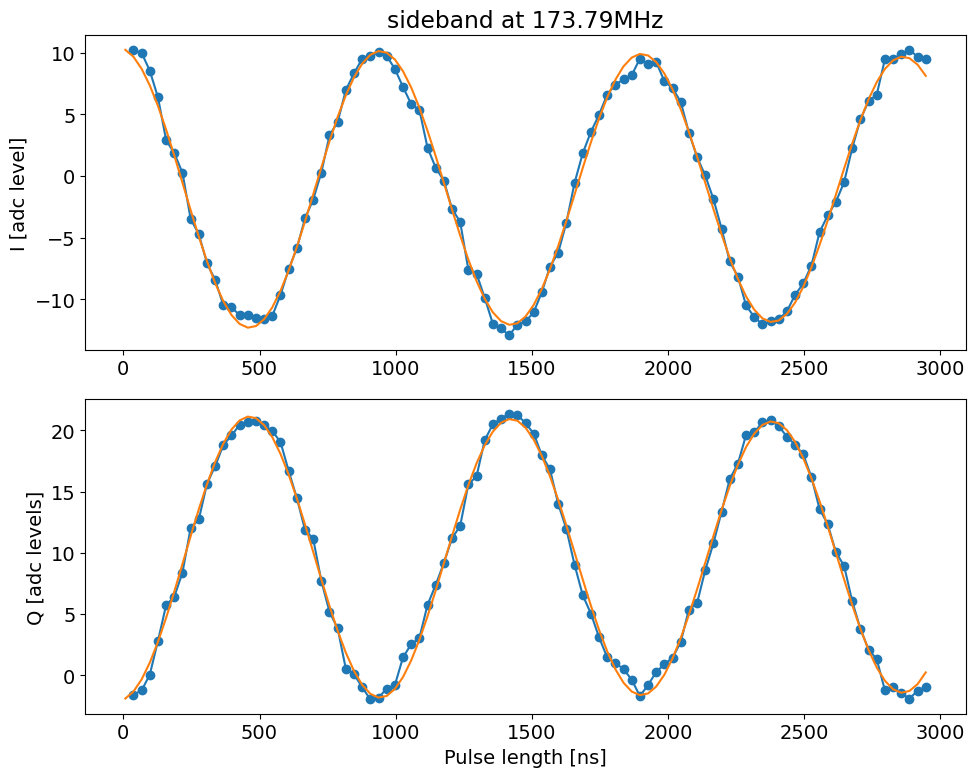

In [18]:

temp_data, attrs = prev_data(expt_path, '00110_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00000_rb_bs_optimization.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz', active_reset=True, readout_per_round=4, threshold=-4.0)

In [19]:
#ds.append_dataset('M2-S1', attrs['config']['expt']['flux_drive'][1], 0.05, temp_data['pi_length'], temp_data['pi2_length'], attrs['config']['expt']['flux_drive'][2])
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M2-M1', freq, 0.01, pi_length, pi2_length, gain)
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.41,0.05,0.993722,0.496861,3000,50:22.5
1,M1-S2,520.93,0.05,1.128904,0.564452,5000,03:56.9
2,M1-S3,696.66,0.05,1.343910,0.671955,9000,50:58.0
3,M1-S4,875.83,0.05,1.275784,0.637892,9000,44:30.4
4,M1-S5,1053.42,0.05,1.956004,0.978002,7500,04:59.0
5,M1-S6,1245.18,0.05,1.605961,0.802981,13500,04:56.2
6,M1-S7,1423.15,0.01,1.372788,0.686394,16500,28:43.5
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


#### RB Check

In [20]:
temp_data, attrs = prev_data(expt_path, '00266_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

929
0.33770306699126257
0.5522253368501604


In [120]:
attrs['config']['expt']['bs_para']

[175.63, 1000, 1.086742197465221, 0.005]

### M2 - S2

#### Length rabi sweep

296
296
293
292
287
297
292
294
292


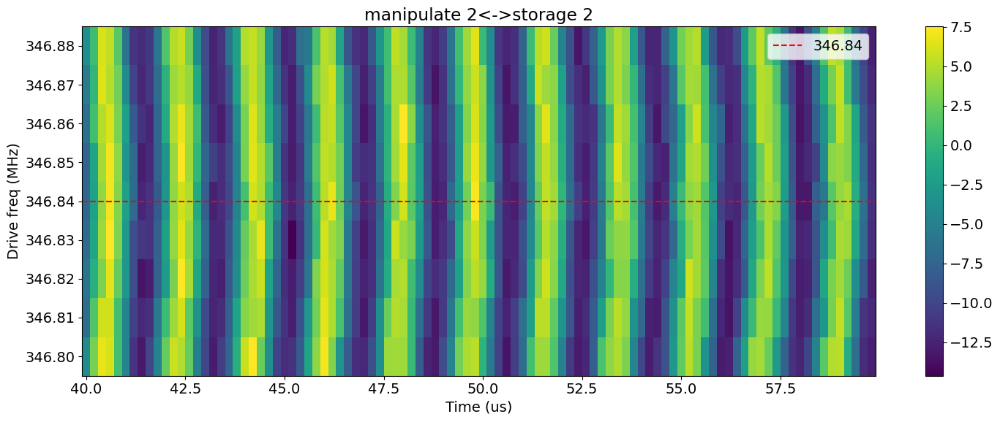

In [29]:
file_list = np.arange(1297,1313,1)
file_list = np.arange(1316,1325,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[346.84], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->storage 2")
    

[ 13.02345955   0.54180746  92.73117556 114.06304159  -1.18964048
  -9.78350695]
Decay from avgi [us] 114.06304159181532
Rate [MHz] 0.5418074605073723
Pi length from avgi data [us]: 0.9088346637964616
	Pi/2 length from avgi data [us]: 0.4544173318982308
Fit params:  [ 13.02345955   0.54180746  92.73117556 114.06304159  -1.18964048
  -9.78350695]

Decay from avgq [us] 126.07201499485767
Rate [MHz] 0.5419488396249492
Pi length from avgq data [us]: 0.9096438884490595
Pi/2 length from avgq data [us]: 0.45482194422452976
Fit params:  [ 10.41580143   0.54194884 -87.47296193 126.07201499   7.93469986
  -9.13550345]


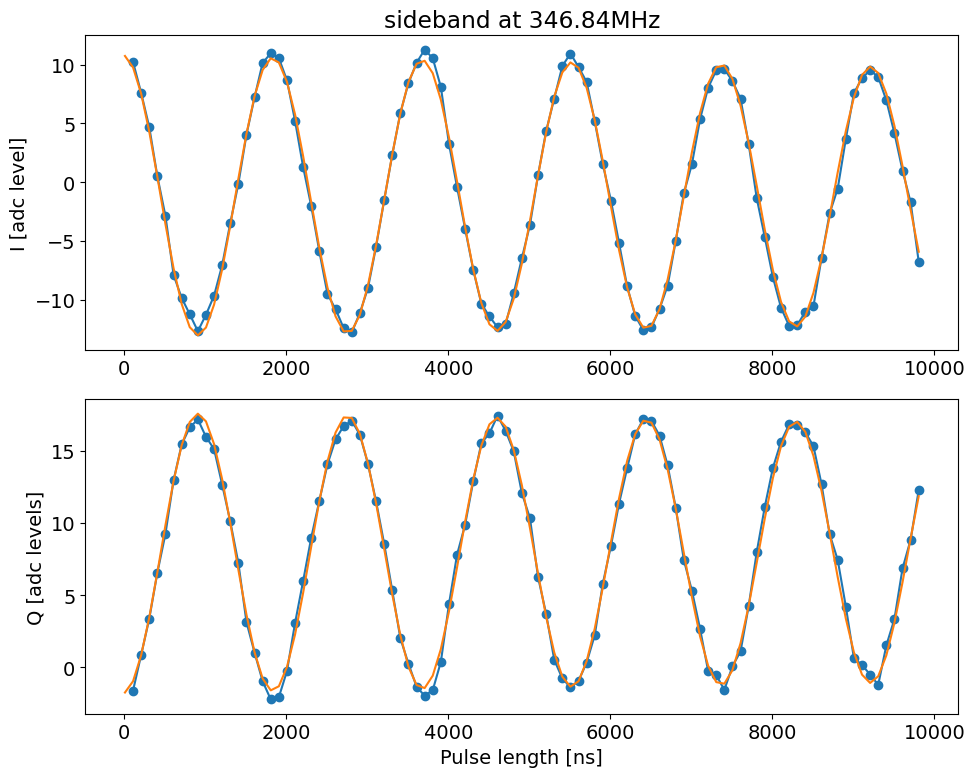

In [30]:

temp_data, attrs = prev_data(expt_path, '00094_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00000_rb_bs_optimization.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz', active_reset=True, readout_per_round=4, threshold=-4.0)

In [31]:
#ds.append_dataset('M2-S1', attrs['config']['expt']['flux_drive'][1], 0.05, temp_data['pi_length'], temp_data['pi2_length'], attrs['config']['expt']['flux_drive'][2])
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M2-S2', freq, 0.01, pi_length, pi2_length, gain)
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.41,0.05,0.993722,0.496861,3000,50:22.5
1,M1-S2,520.93,0.05,1.128904,0.564452,5000,03:56.9
2,M1-S3,696.66,0.05,1.343910,0.671955,9000,50:58.0
3,M1-S4,875.83,0.05,1.275784,0.637892,9000,44:30.4
4,M1-S5,1053.42,0.05,1.956004,0.978002,7500,04:59.0
5,M1-S6,1245.18,0.05,1.605961,0.802981,13500,04:56.2
6,M1-S7,1423.15,0.01,1.372788,0.686394,16500,28:43.5
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


#### RB Check

In [51]:
temp_data, attrs = prev_data(expt_path, '00165_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

966
0.7066824456800075
0.9340305502470782


#### M2-S2 with m1 |1>


Attempted to init fitparam 4 to -6.6461875573921025, which is out of bounds 9.89272077922078 to 12.025704545454545. Instead init to 10.959212662337663
[  2.54847732   6.28639853 156.75649445   0.588       -6.63871932
  -0.79954719]
Decay from avgi [us] 0.5880000000000015
Rate [MHz] 6.286398525389148
Pi length from avgi data [us]: 0.05003903139683906
	Pi/2 length from avgi data [us]: 0.02501951569841953
Fit params:  [  2.54847732   6.28639853 156.75649445   0.588       -6.63871932
  -0.79954719]

Decay from avgq [us] 1.0039070093207747
Rate [MHz] 6.468796610725778
Pi length from avgq data [us]: 0.05118809026991507
Pi/2 length from avgq data [us]: 0.025594045134957534
Fit params:  [  1.89721104   6.46879661 -29.20512415   1.00390701  10.92697229
  -1.953     ]


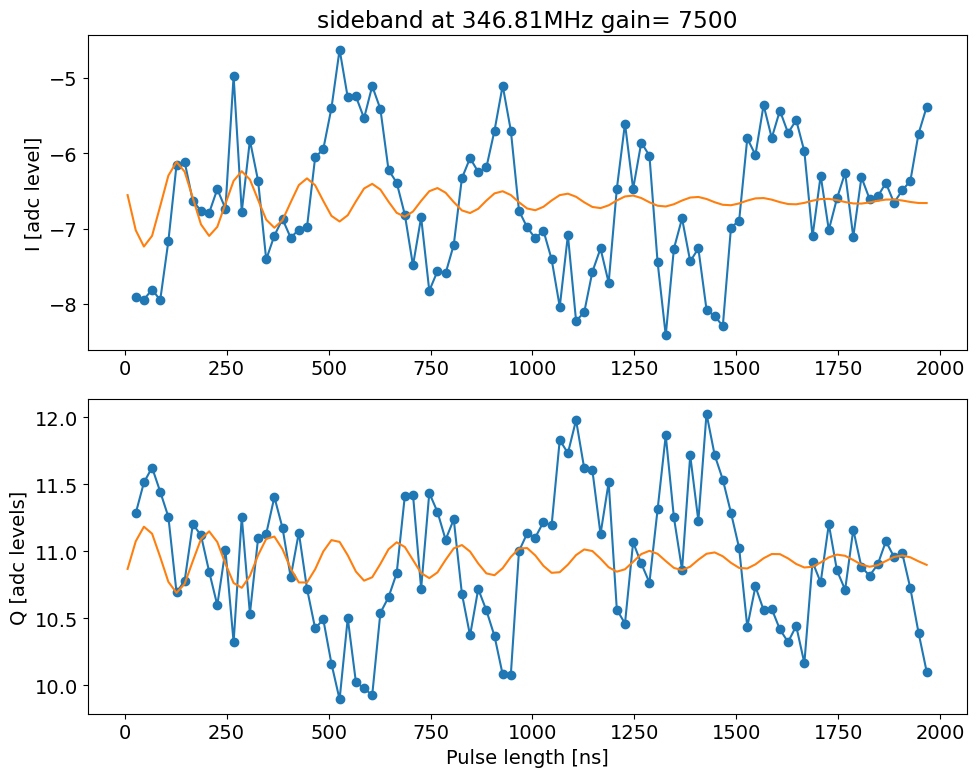

In [496]:
#temp_data, attrs = prev_data(expt_path, '00133_rb_bs_optimization.h5')
temp_data, attrs = prev_data(expt_path, '00036_SidebandGeneralExperiment.h5')


length_rabi_display(temp_data, fit=True, fitparams=[None, None, None, None, None, None], 
                    title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz' + ' gain= '+str(attrs['config']['expt']['flux_drive'][2]))

In [439]:
attrs['config']['expt']['flux_drive']

['low', 346.81, 7500, 0.005]

Attempted to init fitparam 4 to 2.1866712132089017, which is out of bounds 4.59714935064935 to 8.702136363636363. Instead init to 6.649642857142856
[ 10.           0.47319714 -62.46550574   5.62155358   2.1558539
  -9.893     ]
Decay from avgi [us] 5.621553575864103
Rate [MHz] 0.47319714387779443
Pi length from avgi data [us]: 0.8950081360340248
	Pi/2 length from avgi data [us]: 0.4475040680170124

Decay from avgq [us] 2.9700000000000006
Rate [MHz] 0.3167477486048288
Pi length from avgq data [us]: 0.8818816887915449
Pi/2 length from avgq data [us]: 0.44094084439577247


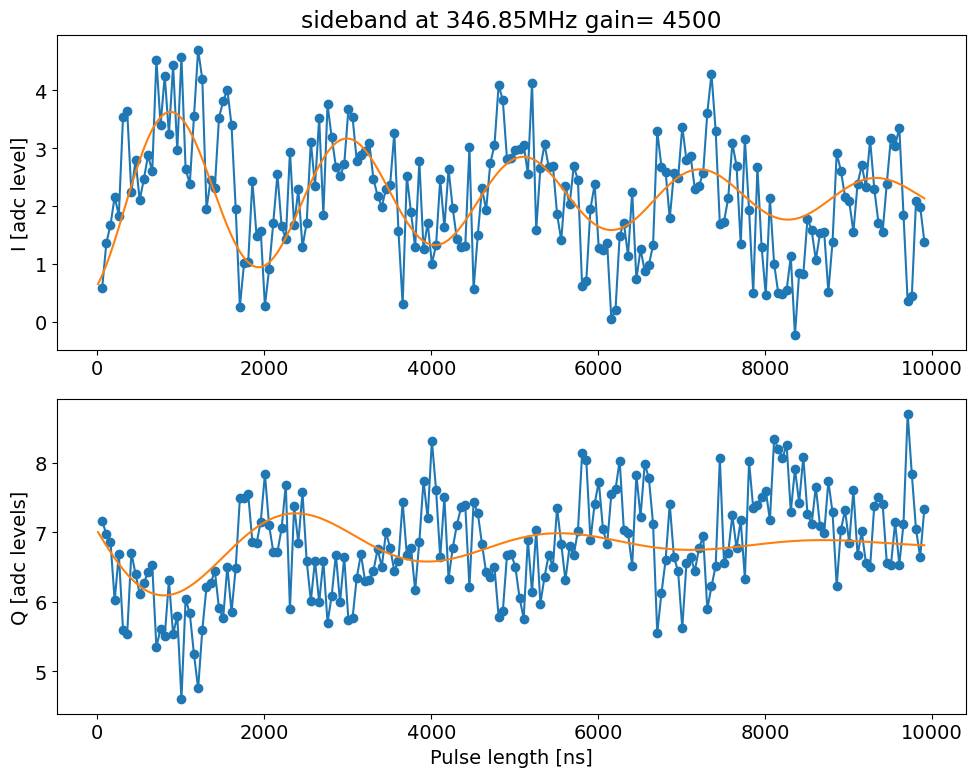

In [471]:
temp_data, attrs = prev_data(expt_path, '00033_SidebandGeneralExperiment.h5')


length_rabi_display(temp_data, fit=True, fitparams=[20, None, 0.002, None, None, None], 
                    title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz' + ' gain= '+str(attrs['config']['expt']['flux_drive'][2]))

In [442]:
temp_data.keys()

dict_keys(['amps', 'avgi', 'avgq', 'phases', 'xpts'])

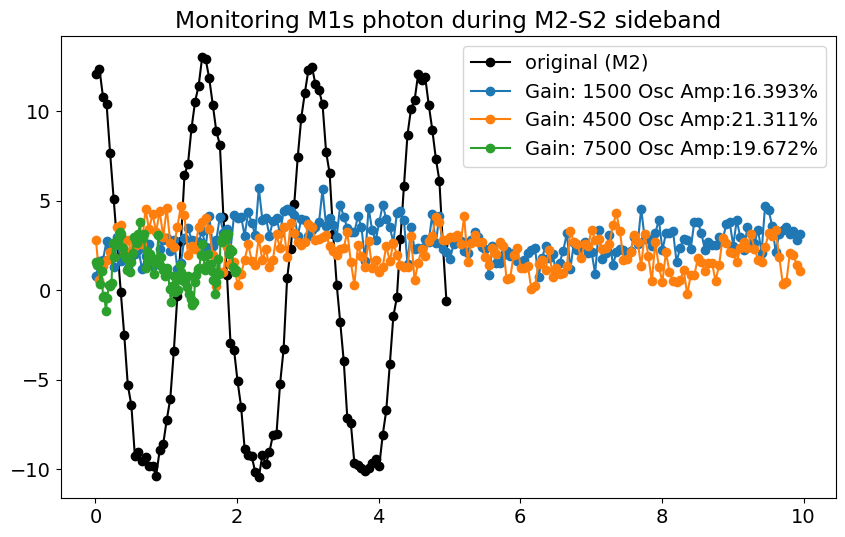

In [488]:
file_list = [ 32, 33, 34]
amp_list = [2 , 2.6, 2.4]

temp_data, attrs = prev_data(expt_path, '00133_rb_bs_optimization.h5')
xlist = temp_data['xpts']
ylist = temp_data['avgi']
amp_orig = 12.2
plt.plot(xlist, ylist,'o-', color = 'black', label = 'original (M2)')

name = '_SidebandGeneralExperiment.h5'
for idx, file_no in enumerate(file_list):
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    xlist = temp_data['xpts']
    ylist = temp_data['avgi']
    # make label gain in file no. 
    osc_amplitude = amp_list[idx]/amp_orig * 100
    plt.plot(xlist, ylist,'-o', label = 'Gain: ' + str(attrs['config']['expt']['flux_drive'][2]) + ' Osc Amp:' + str(round(osc_amplitude, 3)) + '%')

#original Signal 
temp_data, attrs = prev_data(expt_path, '00133_rb_bs_optimization.h5')
xlist = temp_data['xpts']
ylist = temp_data['avgi']
#plt.plot(xlist, ylist,'o-', color = 'black', label = 'original (M2)')
plt.title('Monitoring M1s photon during M2-S2 sideband')
plt.legend()


#### POST SELECTION

976
967
970
967
1925
1939
2906
2909
2925
2932
2919
4857
9788
9669
9744
9732
9751
9664
9602
9699
9606


h:\Shared drives\SLab\Multimode\experiment\240911\experiments\fitting.py:55: RuntimeWarning: overflow encountered in exp
  return y0 + yscale*np.exp(-(x-x0)/decay)


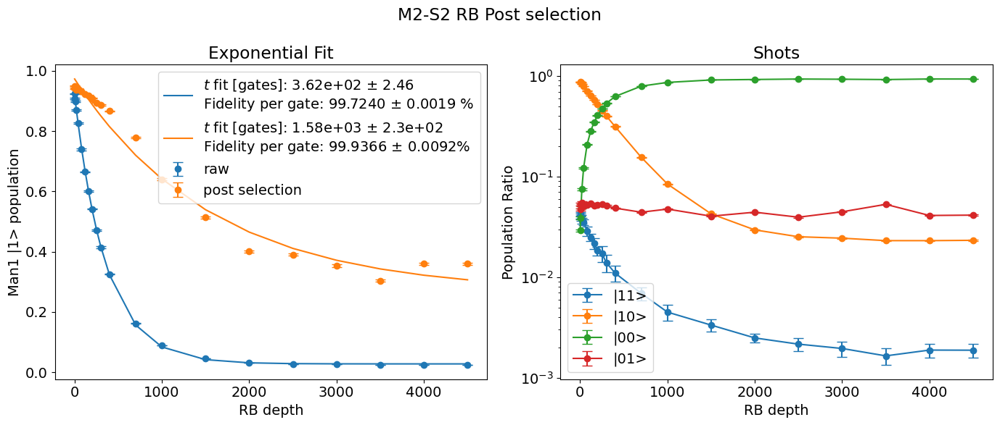

In [57]:
file_list = np.arange(149,170,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth_storsweep.h5'

# plt.figure(figsize=(12,5))
# plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
depth_list = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
    depth_list.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])


plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            ebars_list=ebars_list, ebars_post_list=ebars_post_list, title='M2-S2 RB Post selection')

### M2-S3

#### length rabi sweep

292
293
291
296
295
291
293
290
288
297


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


289


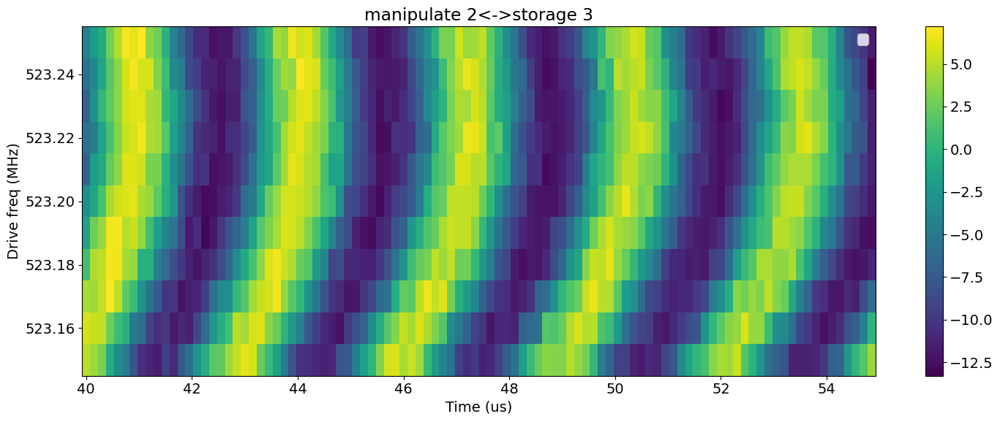

In [ ]:
# file_list = np.arange(1297,1313,1)
file_list = np.arange(244,1387,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->storage 3")
    

[12.14742748  0.31708674 91.73969708 88.3755862  -0.71580651 -4.95579146]
Decay from avgi [us] 88.37558620423029
Rate [MHz] 0.3170867427938483
Pi length from avgi data [us]: 1.5616152972943056
	Pi/2 length from avgi data [us]: 0.7808076486471528
Fit params:  [12.14742748  0.31708674 91.73969708 88.3755862  -0.71580651 -4.95579146]

Decay from avgq [us] 101.34364517176675
Rate [MHz] 0.3174489649261015
Pi length from avgq data [us]: 1.5693933331369274
Pi/2 length from avgq data [us]: 0.7846966665684637
Fit params:  [ 10.20101948   0.31744896 -89.3528241  101.34364517   8.28230084
  -7.4608661 ]


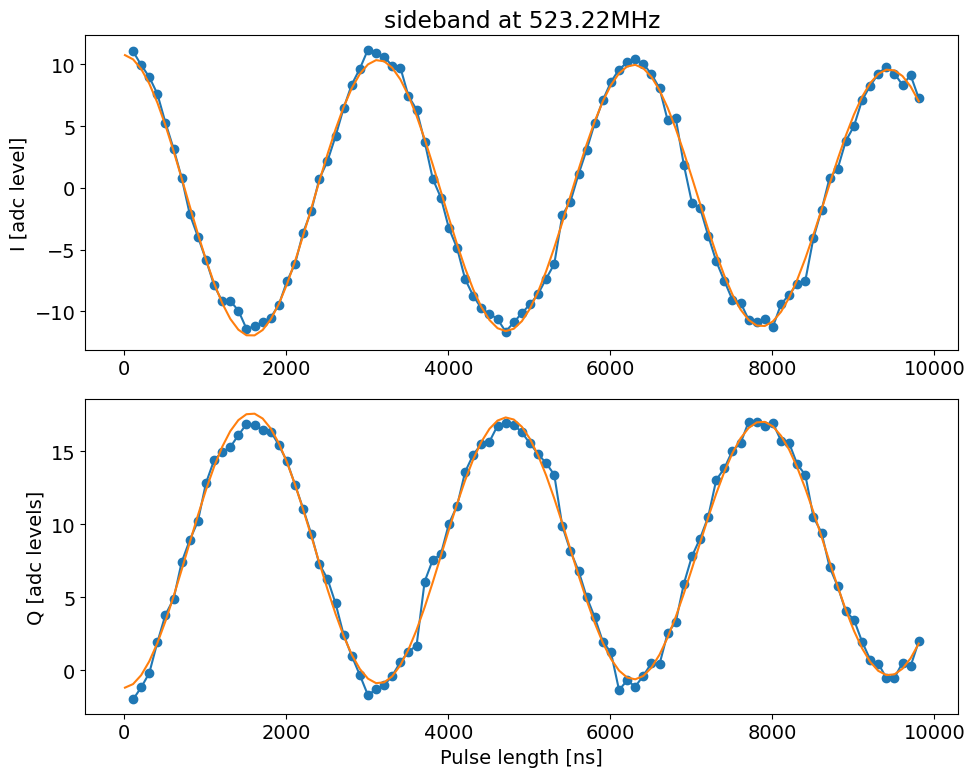

In [45]:

temp_data, attrs = prev_data(expt_path, '00095_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00000_rb_bs_optimization.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz', active_reset=True, readout_per_round=4, threshold=-4.0)

In [46]:
#ds.append_dataset('M2-S1', attrs['config']['expt']['flux_drive'][1], 0.05, temp_data['pi_length'], temp_data['pi2_length'], attrs['config']['expt']['flux_drive'][2])
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M2-S3', freq, 0.01, pi_length, pi2_length, gain)
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.41,0.05,0.993722,0.496861,3000,50:22.5
1,M1-S2,520.93,0.05,1.128904,0.564452,5000,03:56.9
2,M1-S3,696.66,0.05,1.343910,0.671955,9000,50:58.0
3,M1-S4,875.83,0.05,1.275784,0.637892,9000,44:30.4
4,M1-S5,1053.42,0.05,1.956004,0.978002,7500,04:59.0
5,M1-S6,1245.18,0.05,1.605961,0.802981,13500,04:56.2
6,M1-S7,1423.15,0.01,1.372788,0.686394,16500,28:43.5
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


#### RB Check

In [52]:
temp_data, attrs = prev_data(expt_path, '00166_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

979
0.5015839829949301
0.9055446078161069


In [ ]:
####

#### POST SELECTION

964
968
954
964
1924
1925
2880
2887
2874
2895
2882
4829
9635
9722
9601
9644
9620
9620
9664
9552
9715


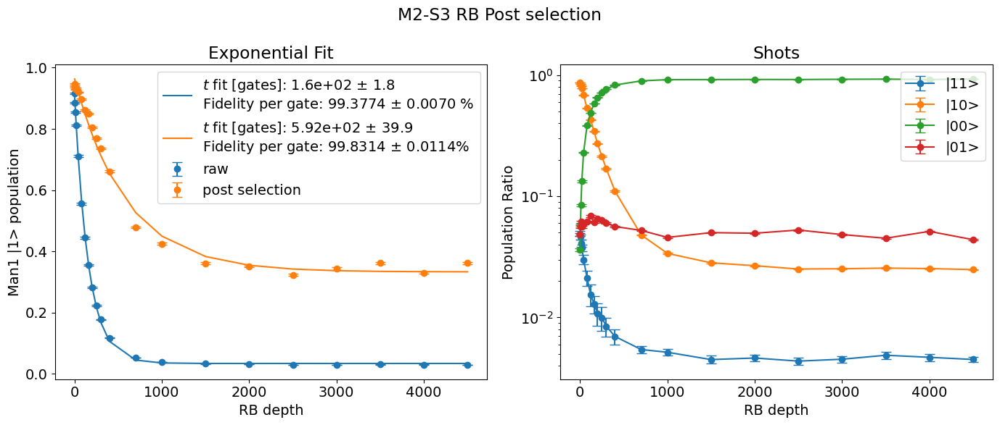

In [60]:
file_list = np.arange(170,191,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth_storsweep.h5'

# plt.figure(figsize=(12,5))
# plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
depth_list = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
    depth_list.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])


plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            ebars_list=ebars_list, ebars_post_list=ebars_post_list,
            title='M2-S3 RB Post selection')

### M2-S4

#### length rabi sweep

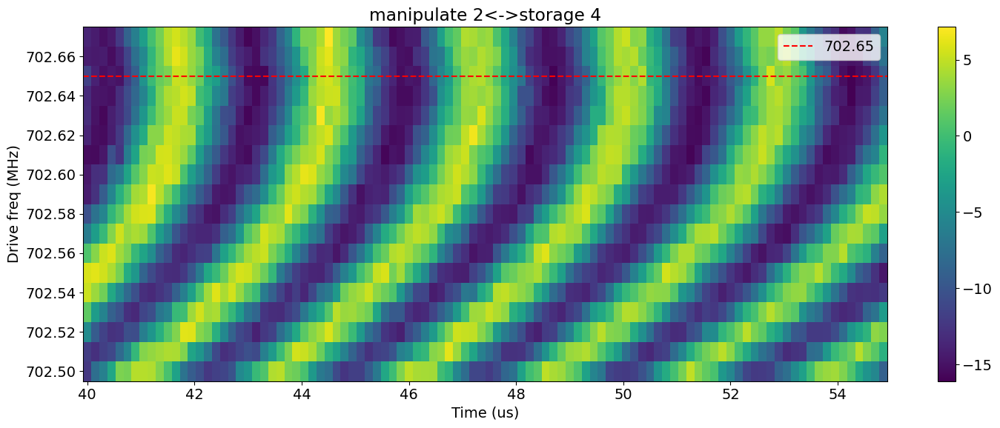

In [77]:
# file_list = np.arange(1297,1313,1)
file_list = np.arange(1397,1415,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[702.65], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->storage 4")
    

In [76]:
attrs['config']['expt']

{'start': 0.007,
 'step': 0.01,
 'qubits': [0],
 'expts': 101,
 'reps': 200,
 'rounds': 1,
 'gain': 3000,
 'ramp_sigma': 0.005,
 'freq': 3420.0,
 'pi_ge_before': True,
 'pi_ef_before': False,
 'pi_ge_after': True,
 'prepulse': False,
 'pre_sweep_pulse': [[3568.1832921185774, 3425.557033831784, 2006.76],
  [9653, 7575, 15000],
  [0, 0, 0.6151067375075144],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'length_placeholder': 1.007}

[ 13.94769138   0.35952499  90.51247608 146.72535929  -2.44435798
  -9.79299675]
Decay from avgi [us] 146.72535928827662
Rate [MHz] 0.3595249936692842
Pi length from avgi data [us]: 1.3867643810970816
	Pi/2 length from avgi data [us]: 0.6933821905485408
Fit params:  [ 13.94769138   0.35952499  90.51247608 146.72535929  -2.44435798
  -9.79299675]

Decay from avgq [us] 224.49512112813036
Rate [MHz] 0.3597546062643292
Pi length from avgq data [us]: 1.3909432872773004
Pi/2 length from avgq data [us]: 0.6954716436386502
Fit params:  [  8.79191169   0.35975461 -90.14337167 224.49512113   7.82974459
  -9.76537653]


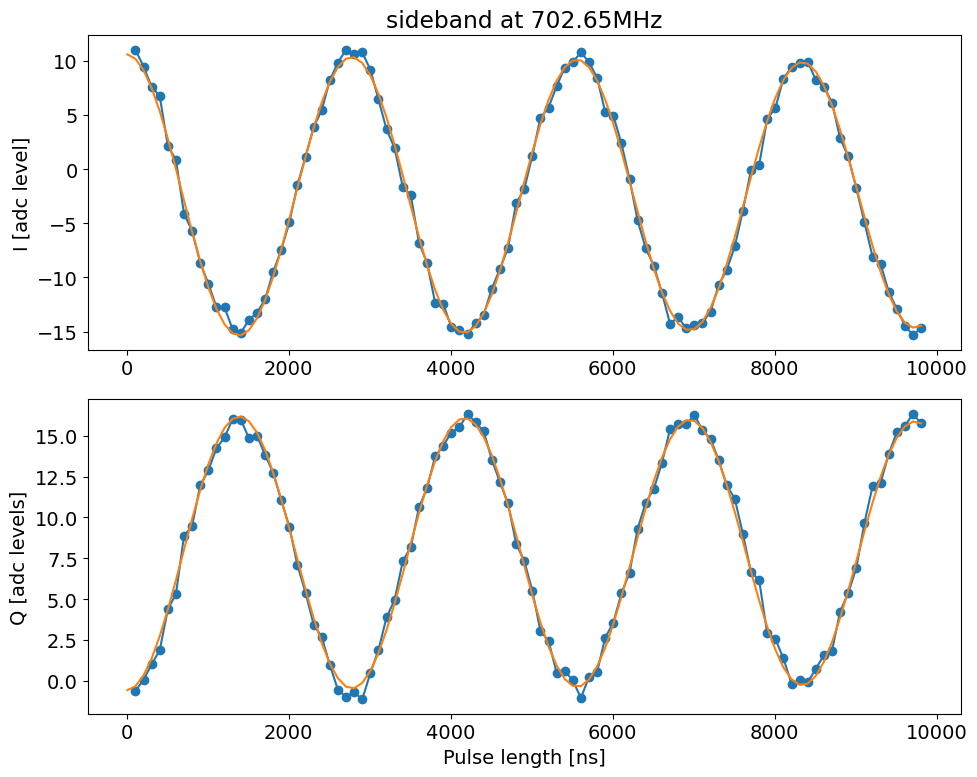

In [18]:

temp_data, attrs = prev_data(expt_path, '00096_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00000_rb_bs_optimization.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz', active_reset=True, readout_per_round=4, threshold=-4.0)

In [19]:
#ds.append_dataset('M2-S1', attrs['config']['expt']['flux_drive'][1], 0.05, temp_data['pi_length'], temp_data['pi2_length'], attrs['config']['expt']['flux_drive'][2])
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M2-S4', freq, 0.01, pi_length, pi2_length, gain)
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.41,0.05,0.993722,0.496861,3000,50:22.5
1,M1-S2,520.93,0.05,1.128904,0.564452,5000,03:56.9
2,M1-S3,696.66,0.05,1.343910,0.671955,9000,50:58.0
3,M1-S4,875.83,0.05,1.275784,0.637892,9000,44:30.4
4,M1-S5,1053.42,0.05,1.956004,0.978002,7500,04:59.0
5,M1-S6,1245.18,0.05,1.605961,0.802981,13500,04:56.2
6,M1-S7,1423.15,0.01,1.372788,0.686394,16500,28:43.5
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


#### RB Check

In [22]:
temp_data, attrs = prev_data(expt_path, '00193_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

980
0.5777380189339436
0.9240683288230235


#### POST SELECTION

980
976
979
971
1943
1934
2915
2922
2936
2937
2936
4863
9787
9817
9806
9820
9757
9782
9751
9731
9758


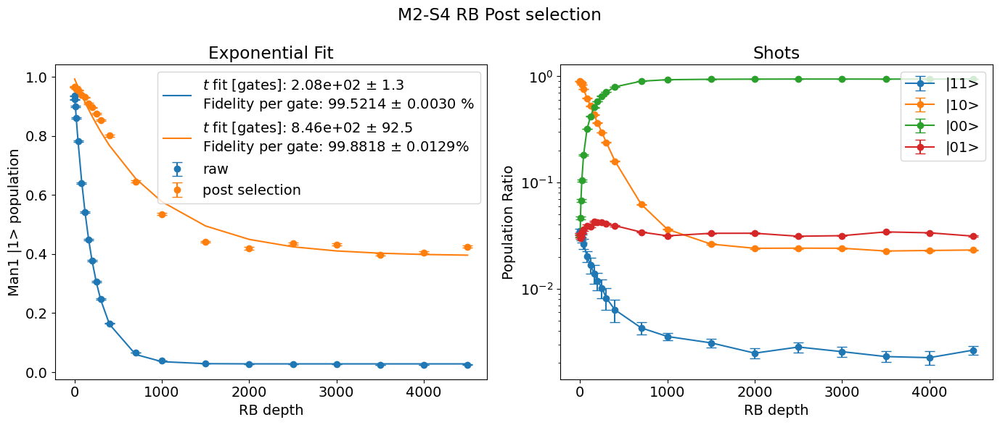

In [23]:
file_list = np.arange(191,212,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth_storsweep.h5'

# plt.figure(figsize=(12,5))
# plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
depth_list = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
    depth_list.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])


plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            ebars_list=ebars_list, ebars_post_list=ebars_post_list,
            title='M2-S4 RB Post selection')

### M2-S5

#### length rabi sweep

TypeError: Dimensions of C (10, 0) should be one smaller than X(100) and Y(10) while using shading='flat' see help(pcolormesh)

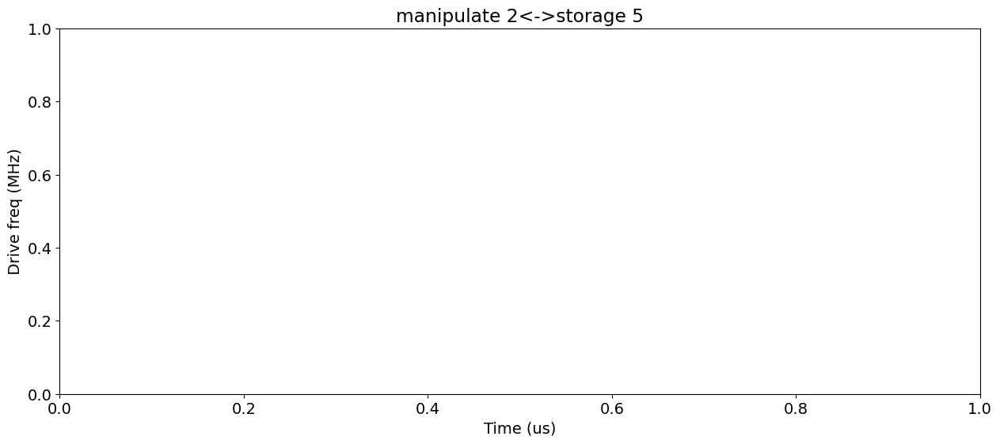

In [79]:
file_list = np.arange(214,224,1)
# file_list = np.arange(1469,1479,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->storage 5")
    

[ 14.01230372   0.34021591  89.64533314 112.35622033  -1.46146351
  -9.78600113]
Decay from avgi [us] 112.35622033145926
Rate [MHz] 0.34021590790246764
Pi length from avgi data [us]: 1.4725507364103205
	Pi/2 length from avgi data [us]: 0.7362753682051603
Fit params:  [ 14.01230372   0.34021591  89.64533314 112.35622033  -1.46146351
  -9.78600113]

Decay from avgq [us] 113.41832618453113
Rate [MHz] 0.3403734183507282
Pi length from avgq data [us]: 1.4744640126842379
Pi/2 length from avgq data [us]: 0.7372320063421189
Fit params:  [ 11.25465546   0.34037342 -90.67260824 113.41832618   9.20207803
  -8.71585005]


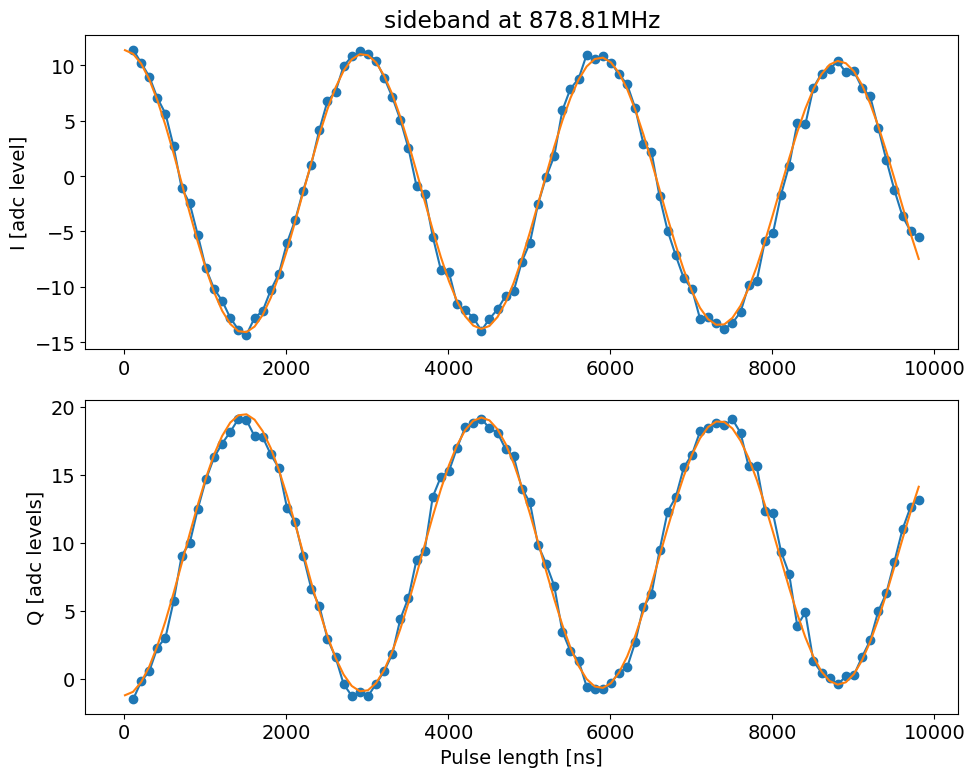

In [21]:

temp_data, attrs = prev_data(expt_path, '00103_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00000_rb_bs_optimization.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz', active_reset=True, readout_per_round=4, threshold=-4.0)

In [18]:
#ds.append_dataset('M2-S1', attrs['config']['expt']['flux_drive'][1], 0.05, temp_data['pi_length'], temp_data['pi2_length'], attrs['config']['expt']['flux_drive'][2])
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M2-S5', freq, 0.01, pi_length, pi2_length, gain)
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.41,0.05,0.993722,0.496861,3000,50:22.5
1,M1-S2,520.93,0.05,1.128904,0.564452,5000,03:56.9
2,M1-S3,696.66,0.05,1.343910,0.671955,9000,50:58.0
3,M1-S4,875.83,0.05,1.275784,0.637892,9000,44:30.4
4,M1-S5,1053.42,0.05,1.956004,0.978002,7500,04:59.0
5,M1-S6,1245.18,0.05,1.605961,0.802981,13500,04:56.2
6,M1-S7,1423.15,0.01,1.372788,0.686394,16500,28:43.5
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


#### RB Check

In [32]:
temp_data, attrs = prev_data(expt_path, '00217_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

973
0.5620300232104103
0.9083512576071874


#### POST SELECTION

970
969
972
979
1952
1947
2919
2907
2912
2896
2885
4851
9688
9679
9721
9699
9710
9678
9606
9650
9641


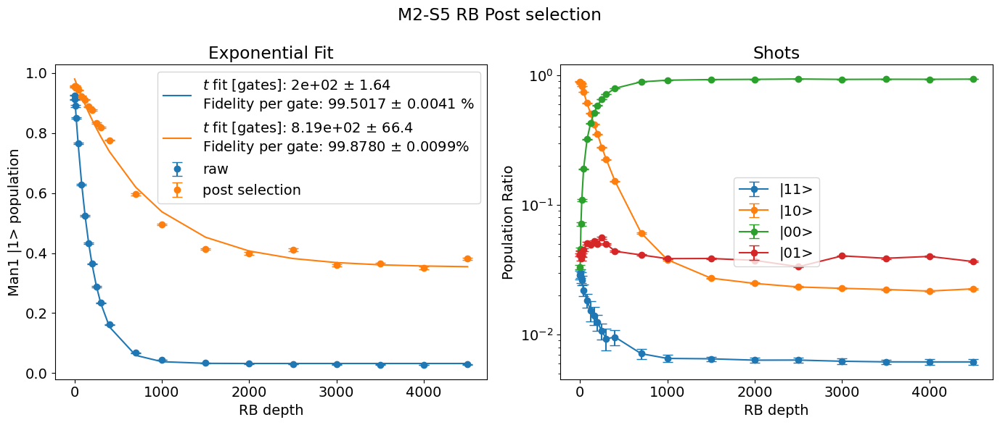

In [49]:
file_list = np.arange(212,233,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth_storsweep.h5'

# plt.figure(figsize=(12,5))
# plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
depth_list = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
    depth_list.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])


plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            ebars_list=ebars_list, ebars_post_list=ebars_post_list,
            title='M2-S5 RB Post selection')

### M2-S6

#### length rabi sweep

TypeError: Dimensions of C (2, 0) should be one smaller than X(100) and Y(2) while using shading='flat' see help(pcolormesh)

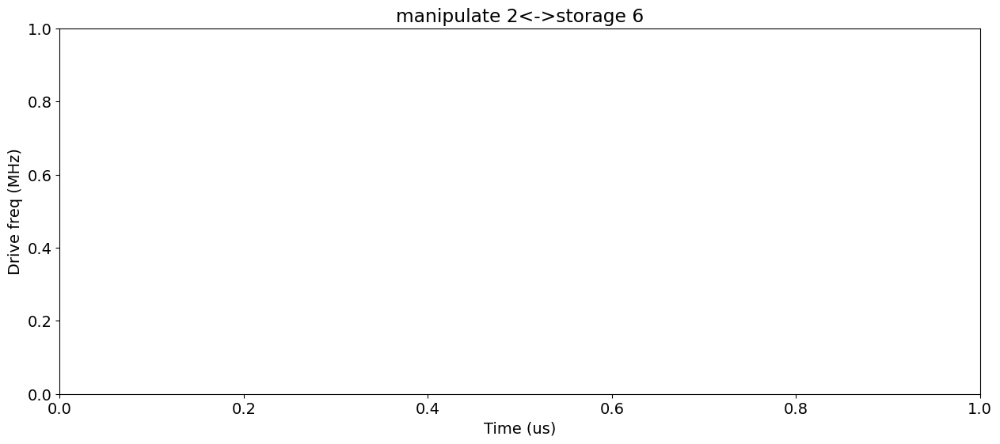

In [66]:
file_list = np.arange(203,205,1)
# file_list = np.arange(1469,1479,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1070.00], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->storage 6")
    

[14.12224532  0.21028187 89.85912429 75.39044863 -1.34873081 -9.34935398]
Decay from avgi [us] 75.39044863298422
Rate [MHz] 0.2102818651009736
Pi length from avgi data [us]: 2.379621852651983
	Pi/2 length from avgi data [us]: 1.1898109263259915
Fit params:  [14.12224532  0.21028187 89.85912429 75.39044863 -1.34873081 -9.34935398]

Decay from avgq [us] 88.8641150778113
Rate [MHz] 0.21017167359329686
Pi length from avgq data [us]: 2.369499201779003
Pi/2 length from avgq data [us]: 1.1847496008895015
Fit params:  [ 11.34387516   0.21017167 -89.28058061  88.86411508   9.34281391
  -8.08109304]


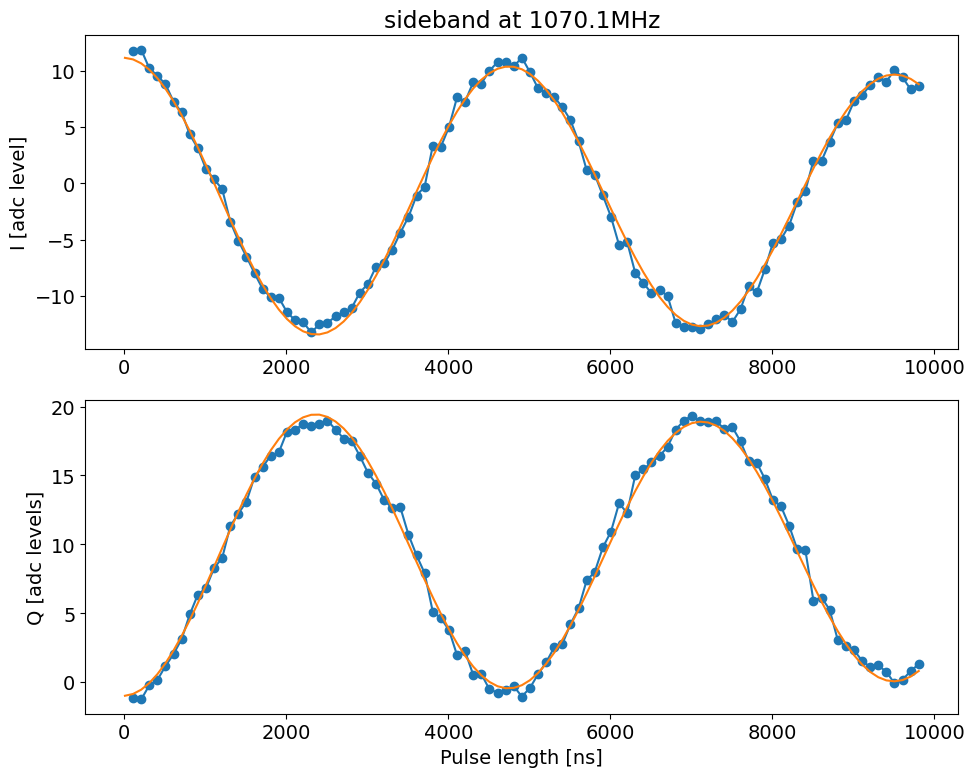

In [77]:

temp_data, attrs = prev_data(expt_path, '00104_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00000_rb_bs_optimization.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz', active_reset=True, readout_per_round=4, threshold=-4.0)

In [78]:
#ds.append_dataset('M2-S1', attrs['config']['expt']['flux_drive'][1], 0.05, temp_data['pi_length'], temp_data['pi2_length'], attrs['config']['expt']['flux_drive'][2])
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M2-S6', freq, 0.01, pi_length, pi2_length, gain)
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.41,0.05,0.993722,0.496861,3000,50:22.5
1,M1-S2,520.93,0.05,1.128904,0.564452,5000,03:56.9
2,M1-S3,696.66,0.05,1.343910,0.671955,9000,50:58.0
3,M1-S4,875.83,0.05,1.275784,0.637892,9000,44:30.4
4,M1-S5,1053.42,0.05,1.956004,0.978002,7500,04:59.0
5,M1-S6,1245.18,0.05,1.605961,0.802981,13500,04:56.2
6,M1-S7,1423.15,0.01,1.372788,0.686394,16500,28:43.5
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


#### RB Check

In [70]:
temp_data, attrs = prev_data(expt_path, '00220_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

972
0.2601576642900162
0.785483529115137


#### POST SELECTION

975
979
989
984
1976
1974
2952
2966
2966
2957
2965
4933


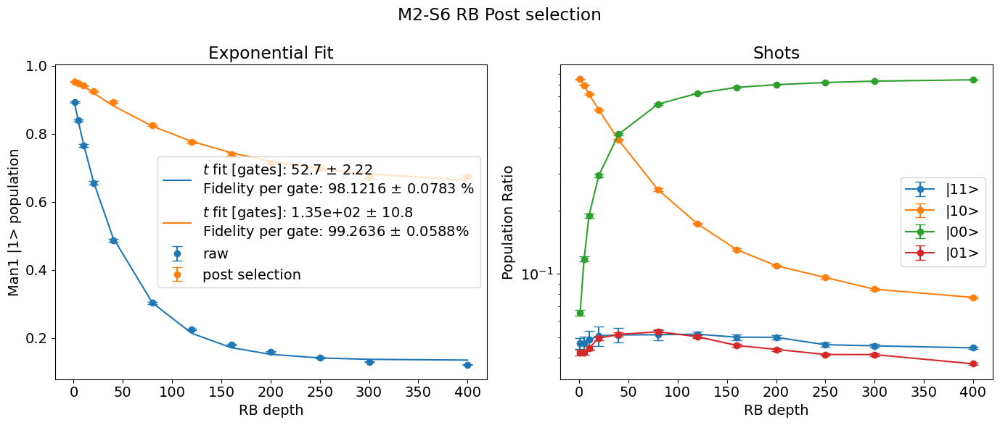

In [81]:
file_list = np.arange(233,245,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth_storsweep.h5'

# plt.figure(figsize=(12,5))
# plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
depth_list = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
    depth_list.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])


plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            ebars_list=ebars_list, ebars_post_list=ebars_post_list,
            title='M2-S6 RB Post selection')

### M2-S7

#### Length rabi sweep

296
294
298
298
296
297
296
295
294
288


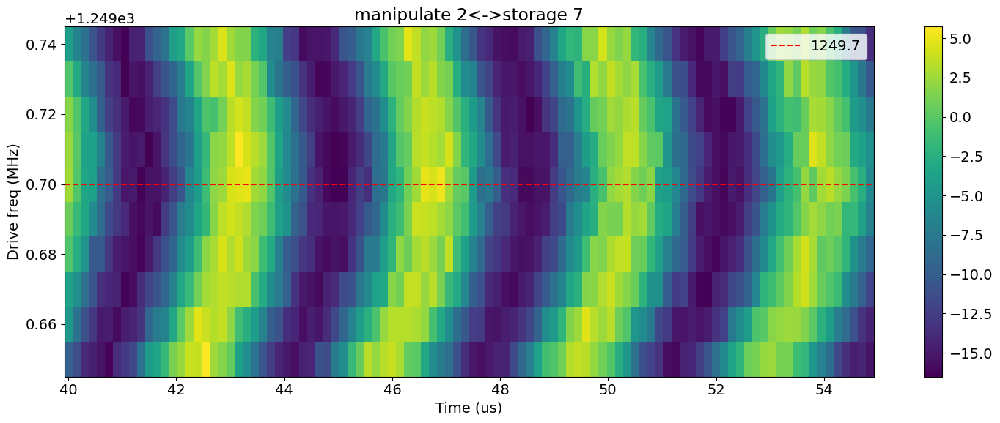

In [110]:
# file_list = np.arange(1649,1659,1)
file_list = np.arange(1708,1718,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1249.70], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->storage 7")
    

[ 1.34164903e+01  2.77666693e-01  9.03737242e+01  3.62419466e+02
 -2.99290994e+00 -9.79300000e+00]
Decay from avgi [us] 362.4194655650079
Rate [MHz] 0.2776666929050944
Pi length from avgi data [us]: 1.796981380675857
	Pi/2 length from avgi data [us]: 0.8984906903379285
Fit params:  [ 1.34164903e+01  2.77666693e-01  9.03737242e+01  3.62419466e+02
 -2.99290994e+00 -9.79300000e+00]

Decay from avgq [us] 140.32665234540173
Rate [MHz] 0.2780847705776982
Pi length from avgq data [us]: 1.8003701805135905
Pi/2 length from avgq data [us]: 0.9001850902567953
Fit params:  [ 10.31210587   0.27808477 -90.2359903  140.32665235   9.3204711
  -9.77939847]


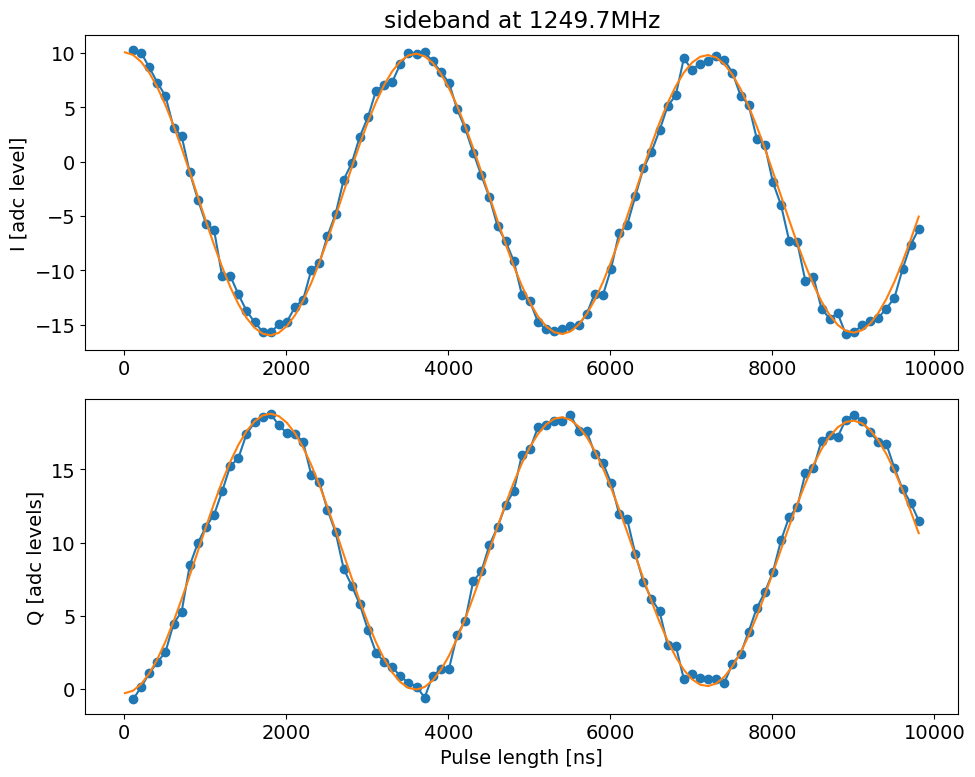

In [115]:

temp_data, attrs = prev_data(expt_path, '00109_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00000_rb_bs_optimization.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz', active_reset=True, readout_per_round=4, threshold=-4.0)

In [116]:
#ds.append_dataset('M2-S1', attrs['config']['expt']['flux_drive'][1], 0.05, temp_data['pi_length'], temp_data['pi2_length'], attrs['config']['expt']['flux_drive'][2])
freq = attrs['config']['expt']['flux_drive'][1]
pi_length =temp_data['pi_length']
pi2_length = temp_data['pi2_length']
gain = attrs['config']['expt']['flux_drive'][2]

ds.update_all('M2-S7', freq, 0.01, pi_length, pi2_length, gain)
ds.df

,stor_name,freq (MHz),precision (MHz),pi (mus),h_pi (mus),gain (DAC units),last_update
0,M1-S1,349.41,0.05,0.993722,0.496861,3000,50:22.5
1,M1-S2,520.93,0.05,1.128904,0.564452,5000,03:56.9
2,M1-S3,696.66,0.05,1.343910,0.671955,9000,50:58.0
3,M1-S4,875.83,0.05,1.275784,0.637892,9000,44:30.4
4,M1-S5,1053.42,0.05,1.956004,0.978002,7500,04:59.0
5,M1-S6,1245.18,0.05,1.605961,0.802981,13500,04:56.2
6,M1-S7,1423.15,0.01,1.372788,0.686394,16500,28:43.5
7,M1-S8,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
8,M1-S9,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3
9,M1-S10,-1.00,-1.00,-1.000000,-1.000000,-1,51:31.3


#### RB Check

In [114]:
temp_data, attrs = prev_data(expt_path, '00248_SingleBeamSplitterRBPostSelection.h5')  
avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
# gg_list.append(np.average(gg))
# ge_list.append(np.average(ge))
# eg_list.append(np.average(eg))
# ee_list.append(np.average(ee))
# fids_list.append(np.average(avg_readout))
# ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
# gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
# eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
# ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))
print(np.average(avg_readout))
print(np.average(avg_readout_post))

990
0.447283032010084
0.9013880341076651


#### POST SELECTION

974
985
967
972
1955
1934
2929
2948
2952
2935
2939
4906
9825
9795
9807
9765
9799
9791
9718
9713


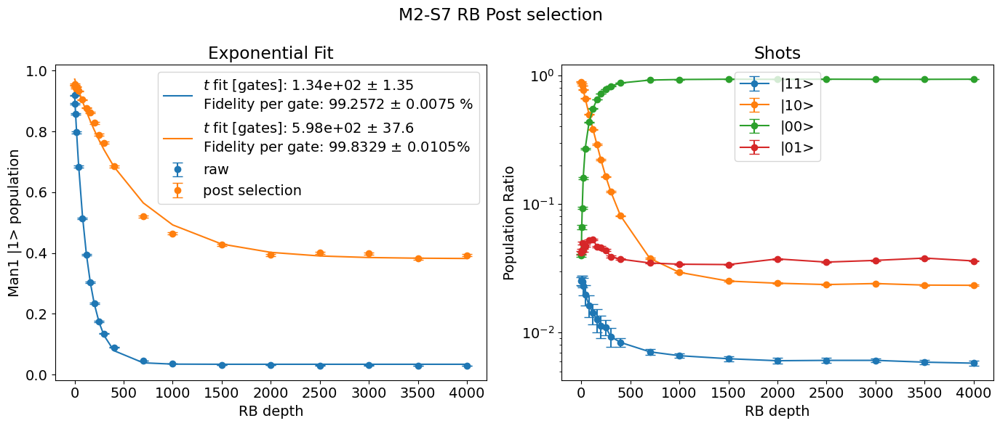

In [126]:
file_list = np.arange(245,265,1)
name = '_SingleBeamSplitterRBPostSelection_sweep_depth_storsweep.h5'

# plt.figure(figsize=(12,5))
# plt.subplot(111)

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
fids_post_list = []
gg_list = []
ge_list = []
eg_list = []
ee_list = []
gg_list_err = []
ge_list_err = []
eg_list_err = []
ee_list_err = []
xlist = []
depth_list = []
ebars_list = []
ebars_post_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout, avg_readout_post, gg, ge, eg, ee = RB_extract_postselction_excited(temp_data, active_reset=True)
    # print(gg[0]+ge[0]+eg[0]+ee[0])
    gg_list.append(np.average(gg))
    ge_list.append(np.average(ge))
    eg_list.append(np.average(eg))
    ee_list.append(np.average(ee))
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    gg_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    ge_list_err.append(np.std(ge)/np.sqrt(len(ge)))
    eg_list_err.append(np.std(eg)/np.sqrt(len(eg)))
    ee_list_err.append(np.std(ee)/np.sqrt(len(ee)))


    fids_post_list.append(np.average(avg_readout_post))
    ebars_post_list.append(np.std(avg_readout_post)/np.sqrt(len(avg_readout_post)))
    xlist.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])
    depth_list.append(attrs['config']['expt']['rb_depth']*attrs['config']['expt']['bs_repeat'])


plot_rb(fids_list = fids_list, fids_post_list = fids_post_list, xlist=depth_list, 
            gg_list = gg_list, gg_list_err = gg_list_err, ge_list = ge_list, ge_list_err = ge_list_err, 
            eg_list = eg_list, eg_list_err = eg_list_err, ee_list = ee_list, ee_list_err = ee_list_err,
            ebars_list=ebars_list, ebars_post_list=ebars_post_list,
            title='M2-S7 RB Post selection')

### M2-S8

#### Length rabi sweep

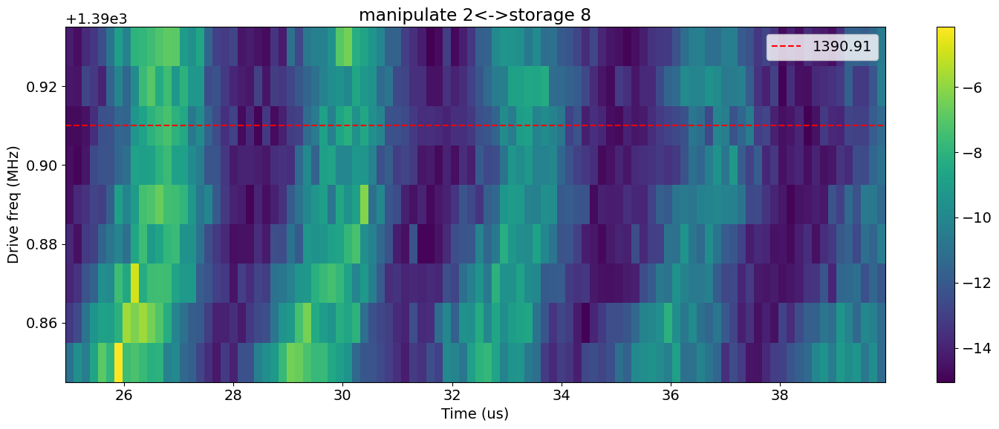

In [59]:
# file_list = np.arange(1649,1659,1)
file_list = np.arange(3968,3977,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1390.91], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->storage 8")
    

[18.61461257  0.29924981 85.22004866 17.95081596 -4.22465241 -6.07455891]
Decay from avgi [us] 17.950815963390905
Rate [MHz] 0.29924980523529976
Pi length from avgi data [us]: 1.7152146254520622
	Pi/2 length from avgi data [us]: 0.8576073127260311
Fit params:  [18.61461257  0.29924981 85.22004866 17.95081596 -4.22465241 -6.07455891]

Decay from avgq [us] 17.74256742315448
Rate [MHz] 0.29920030910711376
Pi length from avgq data [us]: 1.7146798625608612
Pi/2 length from avgq data [us]: 0.8573399312804306
Fit params:  [ 15.48283834   0.29920031 -94.69178816  17.74256742  11.32267307
  -5.89764349]


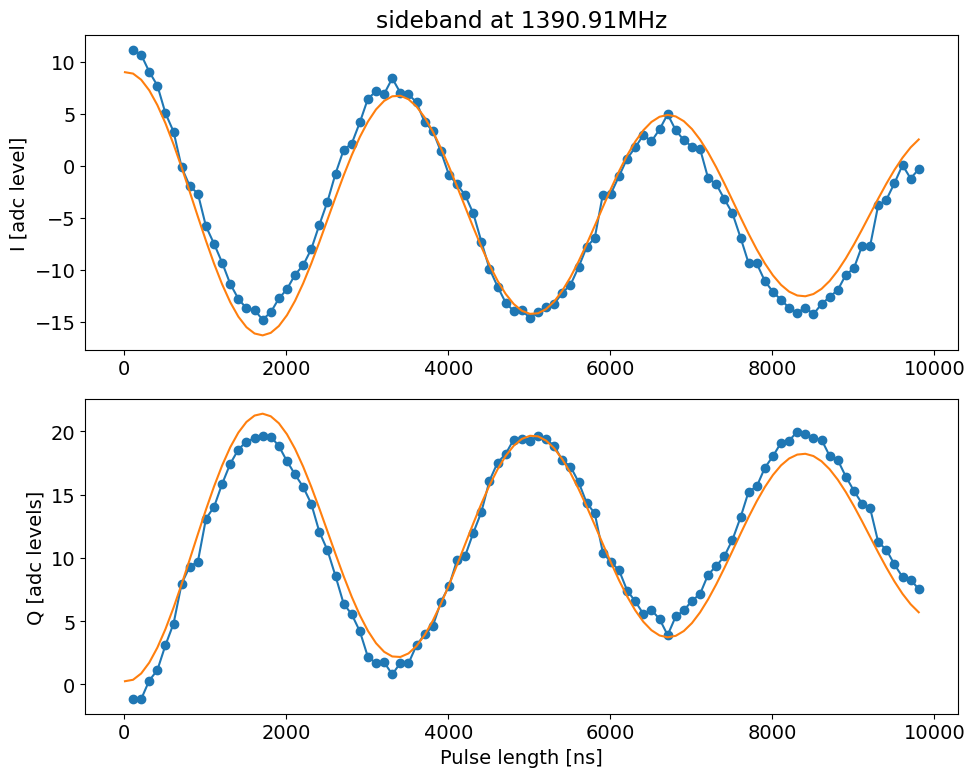

In [60]:

temp_data, attrs = prev_data(expt_path, '00111_SidebandGeneralExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00000_rb_bs_optimization.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='sideband at '+str(attrs['config']['expt']['flux_drive'][1])+'MHz', active_reset=True, readout_per_round=4, threshold=-4.0)

In [53]:
1/(1/372-1/656)

859.2676056338026

### M2-S9

#### Length rabi sweep

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


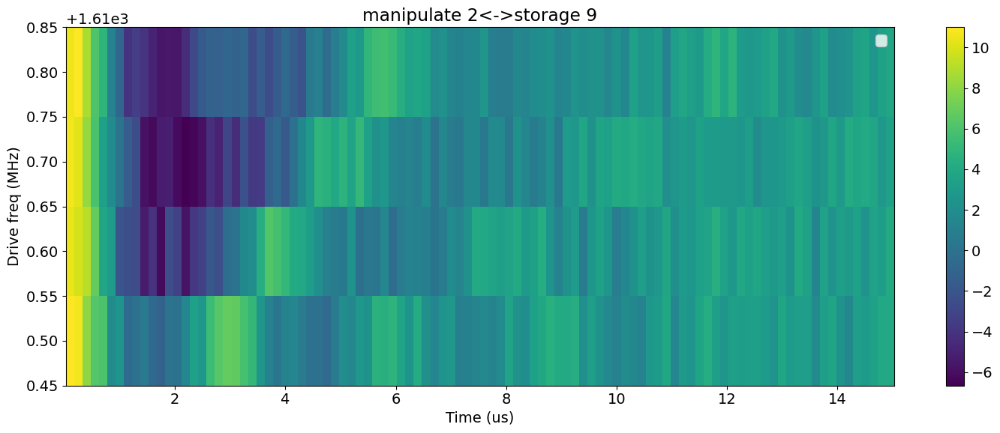

In [72]:
# file_list = np.arange(1649,1659,1)
file_list = np.arange(3999,4003,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->storage 9")
    

### M2-S12

#### Length rabi sweep

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


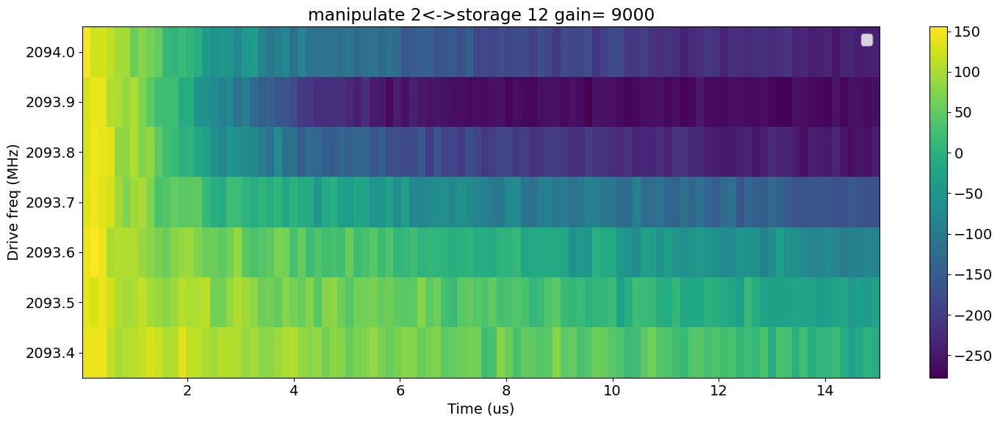

In [82]:

# file_list = np.arange(736, 745, 1)
file_list = np.arange(4056, 4063, 1)

y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 2<->storage 12 gain= "+str(attrs['config']['expt']['flux_drive'][2]))
    

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


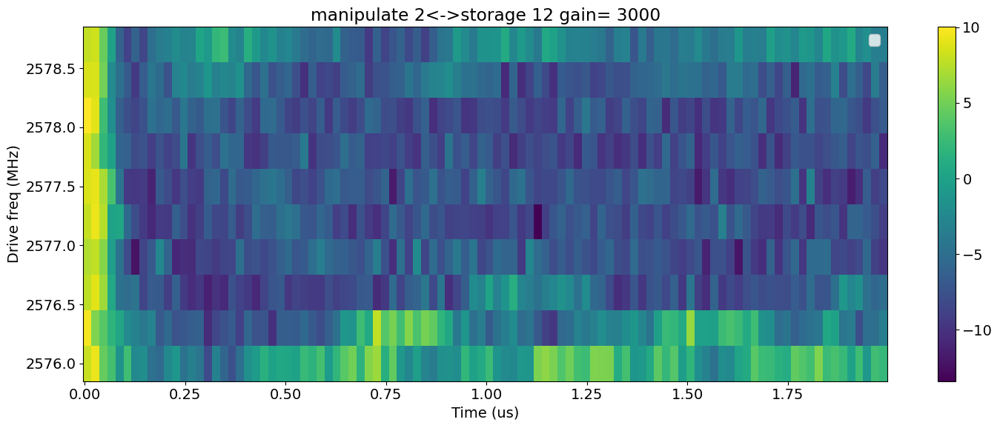

In [571]:

file_list = np.arange(746, 756, 1)

y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 2<->storage 12 gain= "+str(attrs['config']['expt']['flux_drive'][2]))
    

## DC sweep

In [18]:
expt_path_old   

'H:\\Shared drives\\SLab\\Multimode\\experiment\\240911\\data'

In [20]:
file_list = np.arange(122,235,1)
y_list = []
freq_list = []
name = '_fluxspectroscopy_f0g1_dc_flux_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path_old + '1', full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['current'])

plot_f0g1_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=[], title="manipulate 1 <-> everything, gain=" + str(attrs['config']['expt']['flux_drive'][2]))

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = 'H:\Shared drives\SLab\Multimode\experiment\240911\data1\00135_fluxspectroscopy_f0g1_dc_flux_sweep.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [19]:
file_list = np.arange(122,141,1)
y_list = []
freq_list = []
name = '_fluxspectroscopy_f0g1_dc_flux_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path_old + '1', full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['current'])

plot_f0g1_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=[], title="manipulate 1 <-> everything, gain=" + str(attrs['config']['expt']['flux_drive'][2]))

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = 'H:\Shared drives\SLab\Multimode\experiment\240911\data1\00135_fluxspectroscopy_f0g1_dc_flux_sweep.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

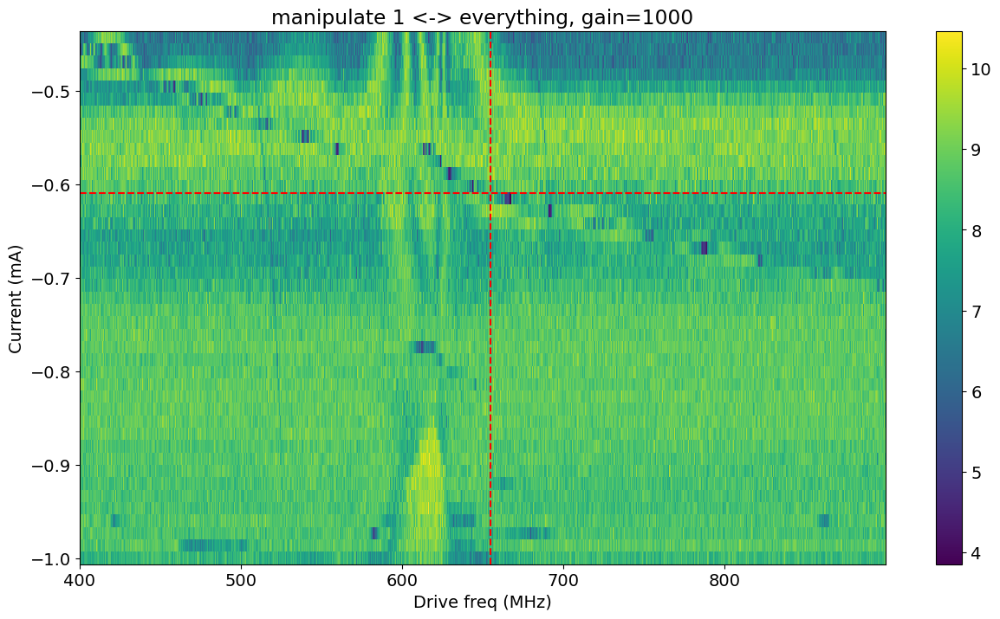

In [525]:
file_list = np.arange(79,122,1)
y_list = []
freq_list = []
name = '_fluxspectroscopy_f0g1_dc_flux_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['current'])

plot_f0g1_sweep(len_x, freq_list, np.array(y_list), hlines=[-0.61], vlines=[655], title="manipulate 1 <-> everything, gain=" + str(attrs['config']['expt']['flux_drive'][2]))

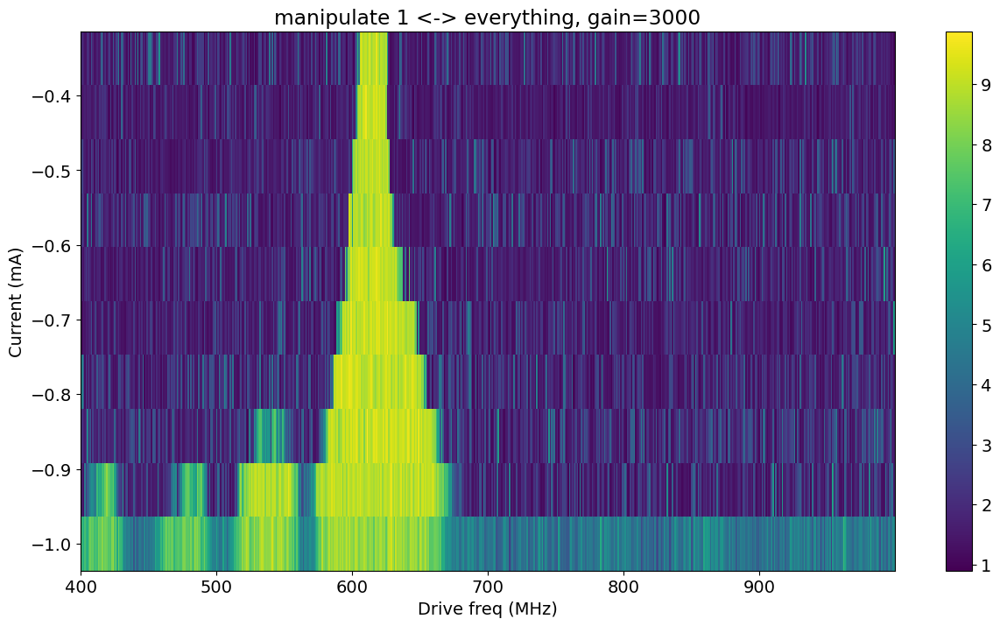

In [362]:
file_list = np.arange(32,42,1)
y_list = []
freq_list = []
name = '_fluxspectroscopy_f0g1_dc_flux_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['current'])

plot_f0g1_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1 <-> everything, gain=" + str(attrs['config']['expt']['flux_drive'][2]))

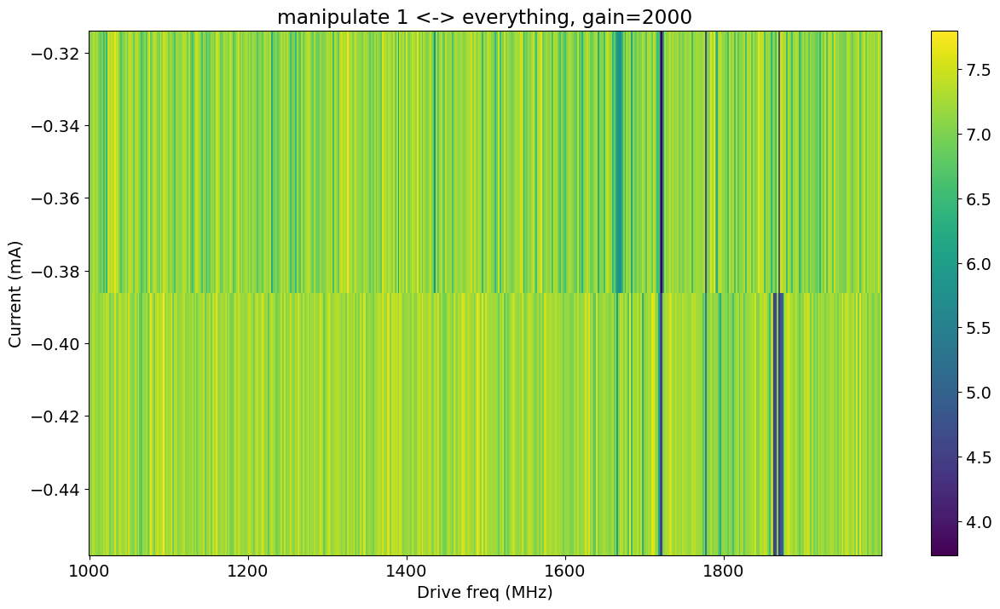

In [360]:
file_list = np.arange(43,45,1)
y_list = []
freq_list = []
name = '_fluxspectroscopy_f0g1_dc_flux_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgq']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['current'])

plot_f0g1_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1 <-> everything, gain=2000")

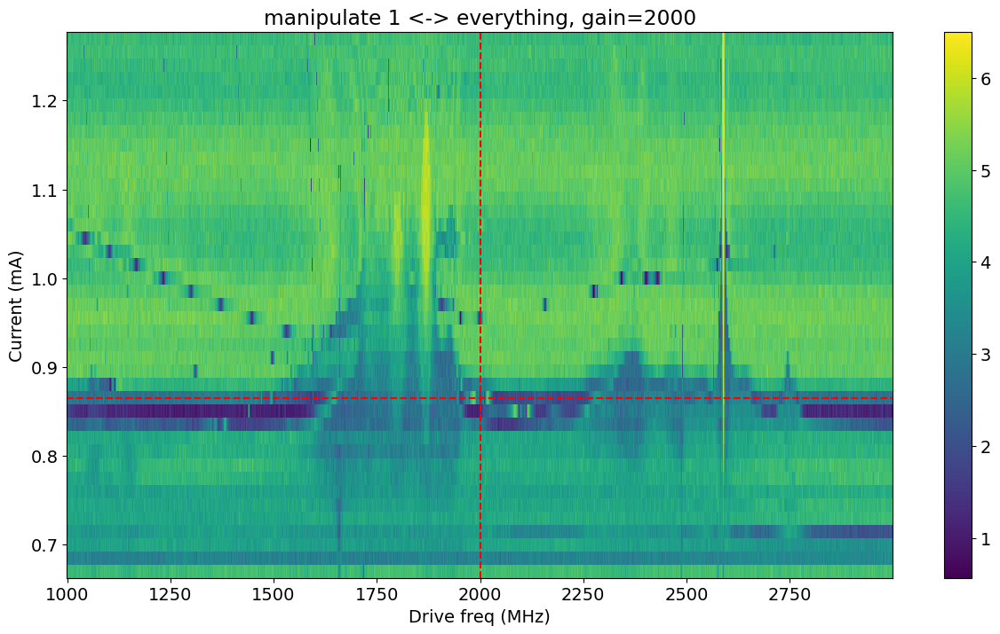

In [937]:
file_list = np.arange(0,41,1)
y_list = []
freq_list = []
name = '_fluxspectroscopy_f0g1_dc_flux_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['current'])

plot_f0g1_sweep(len_x, freq_list, np.array(y_list), hlines=[0.865], vlines=[2000], title="manipulate 1 <-> everything, gain=2000")

### M2 - Coupler

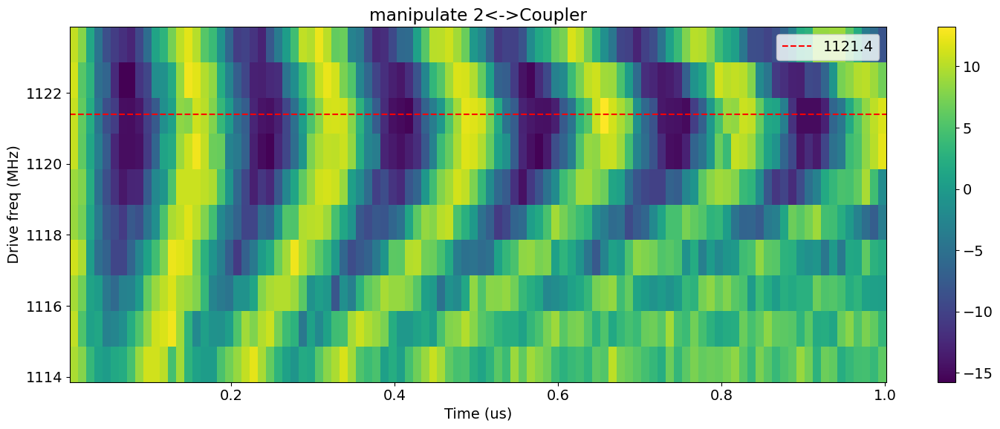

In [601]:
file_list = np.arange(802,812,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[1121.4], vlines=None, title="manipulate 2<->Coupler")
    

#### DC sweep

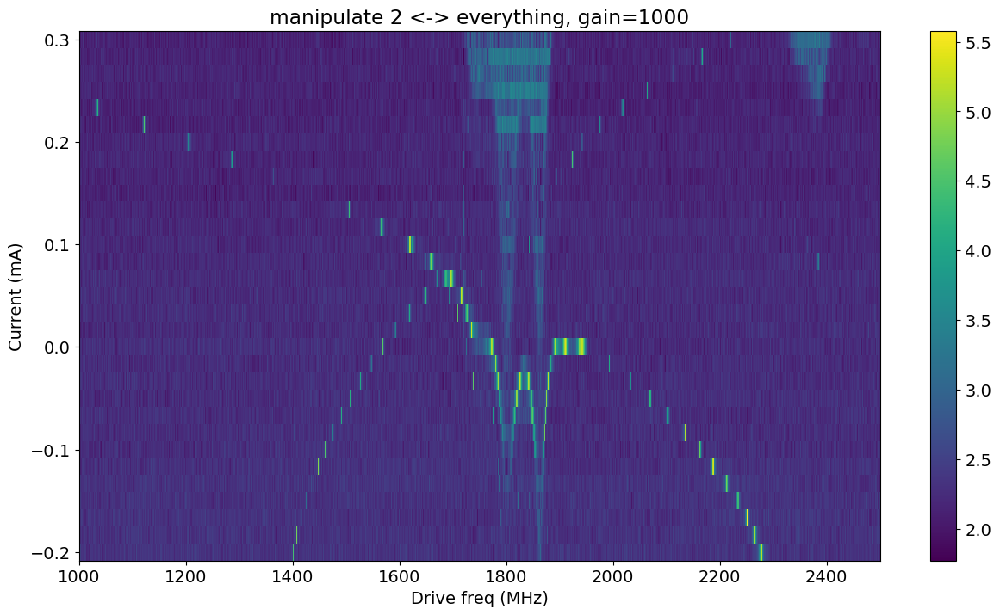

In [147]:
file_list = np.arange(31,62,1)
y_list = []
freq_list = []
name = '_fluxspectroscopy_f0g1_dc_flux_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgq']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['current'])

plot_f0g1_sweep(len_x, freq_list, np.array(y_list), hlines=None, vlines=None, title="manipulate 2 <-> everything, gain=1000")

### Man1-Coupler mode sweep 

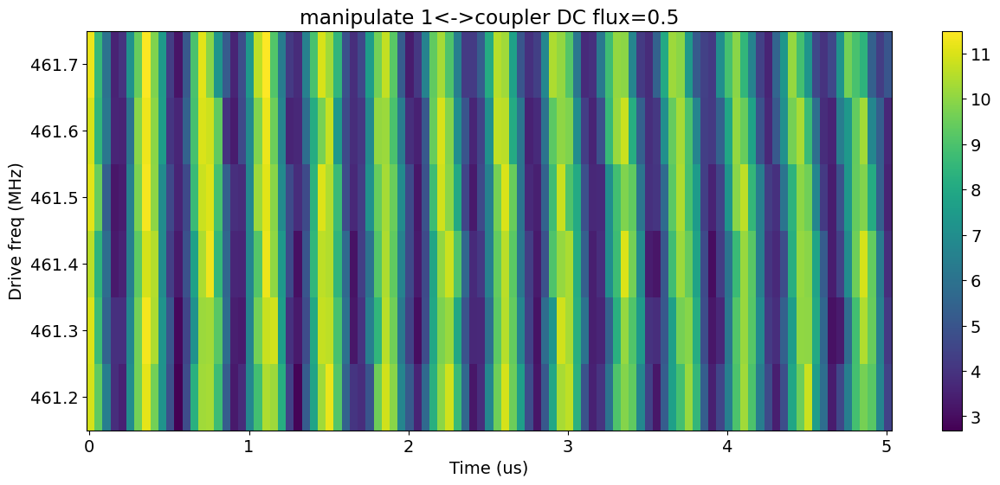

In [470]:
file_list = np.arange(108,114,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="manipulate 1<->coupler DC flux=0.5")
    

### M2-general

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


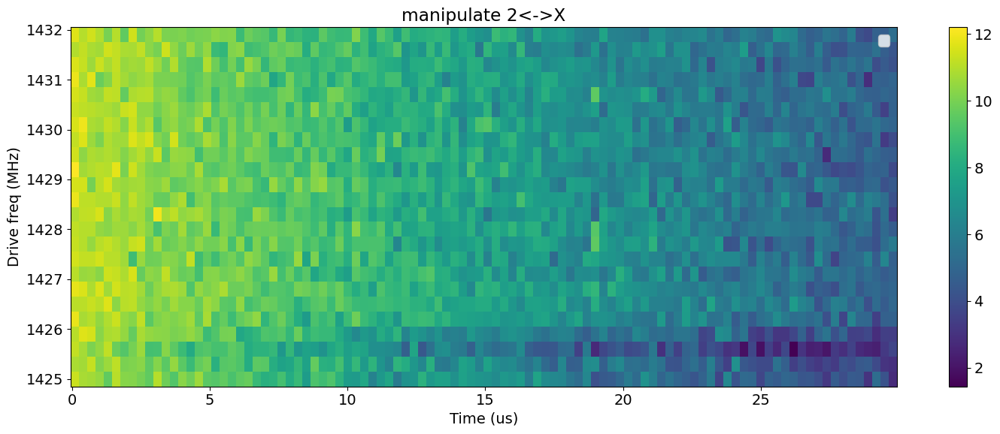

In [25]:
# file_list = np.arange(1297,1313,1)
file_list = np.arange(1778,1802,1)
y_list = []
freq_list = []
name = '_sideband_general_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['idata']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['flux_drive'][1])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, active_reset=True, readout_per_round=4, threshold=-4.0, title="manipulate 2<->X")
    

# Storage T1

In [93]:
def fit_t1(data, fit=True, title="$T_1$", **kwargs):
    data['fit_avgi'], data['fit_err_avgi'] = fitter.fitexp(data['xpts'][:-1], data['avgi'][:-1], fitparams=None)
    p = data['fit_avgi']
    pCov = data['fit_err_avgi']
    captionStr = f'$T_1$ fit [us]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
    print(captionStr)
    return p[3], np.sqrt(pCov[3][3])
        

## Storage 1

Fit T1 avgi [us]: 1153.283040488111
Fit T1 avgq [us]: 1298.3726133861724


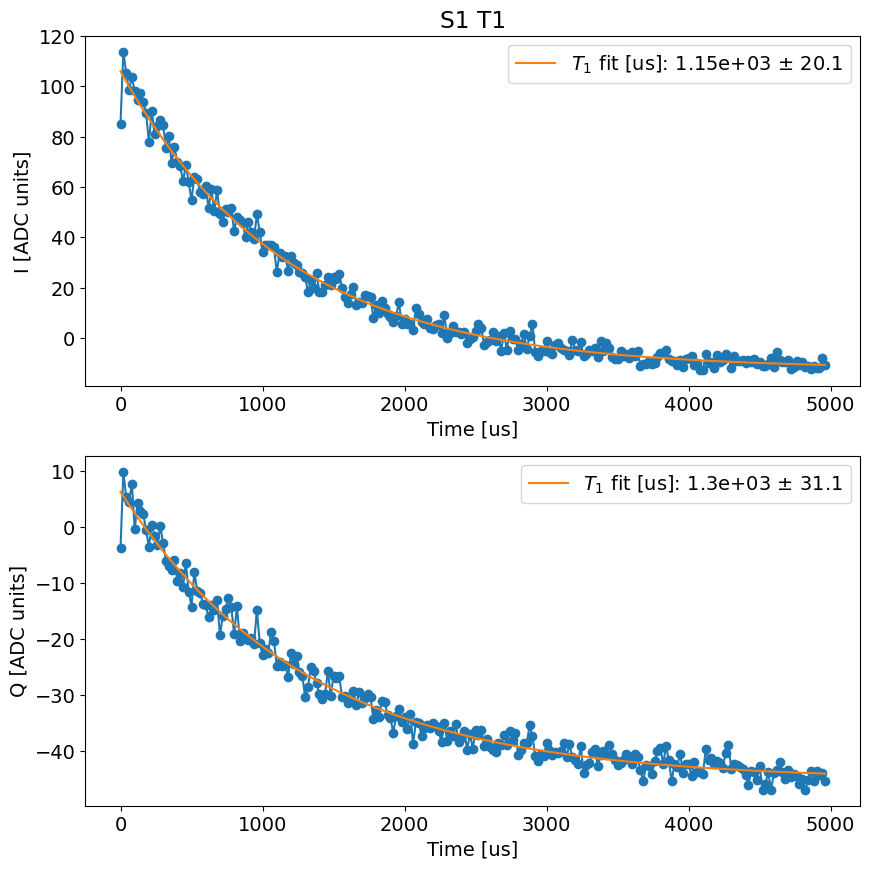

(1298.3726133861724, 31.0700783932502)

In [148]:
# temp_data, attrs = prev_data(expt_path, '00006_SidebandT1GeneralExperiment.h5')
temp_data, attrs = prev_data(expt_path, '00002_storage_t1_sweep.h5')
t1_display(temp_data, attrs, fit=True, fitparams=None, title='S1 T1', active_reset=False)

In [149]:
attrs['config']['expt']

{'start': 0.007,
 'step': 20,
 'qubits': [0],
 'expts': 250,
 'reps': 400,
 'rounds': 1,
 'prepulse': True,
 'postpulse': True,
 'active_reset': False,
 'man_reset': False,
 'storage_reset': False,
 'pre_sweep_pulse': [[3568.655054337803, 3425.3983357264633, 2006.8, 348.85],
  [11105, 9530, 15000, 3000],
  [0, 0, 0.6077792185114786, 0.7842591523264502],
  [0, 0, 0, 0],
  [2, 2, 0, 1],
  ['g', 'g', 'flat_top', 'flat_top'],
  [0.035, 0.035, 0.005, 0.005]],
 'post_sweep_pulse': [[348.85, 2006.8],
  [3000, 15000],
  [0.7842591523264502, 0.6077792185114786],
  [0, 0],
  [1, 0],
  ['flat_top', 'flat_top'],
  [0.005, 0.005]],
 'length_placeholder': 4980.007}

Fit T1 avgi [us]: 366.7393725221756
Fit T1 avgq [us]: 352.6520810465617


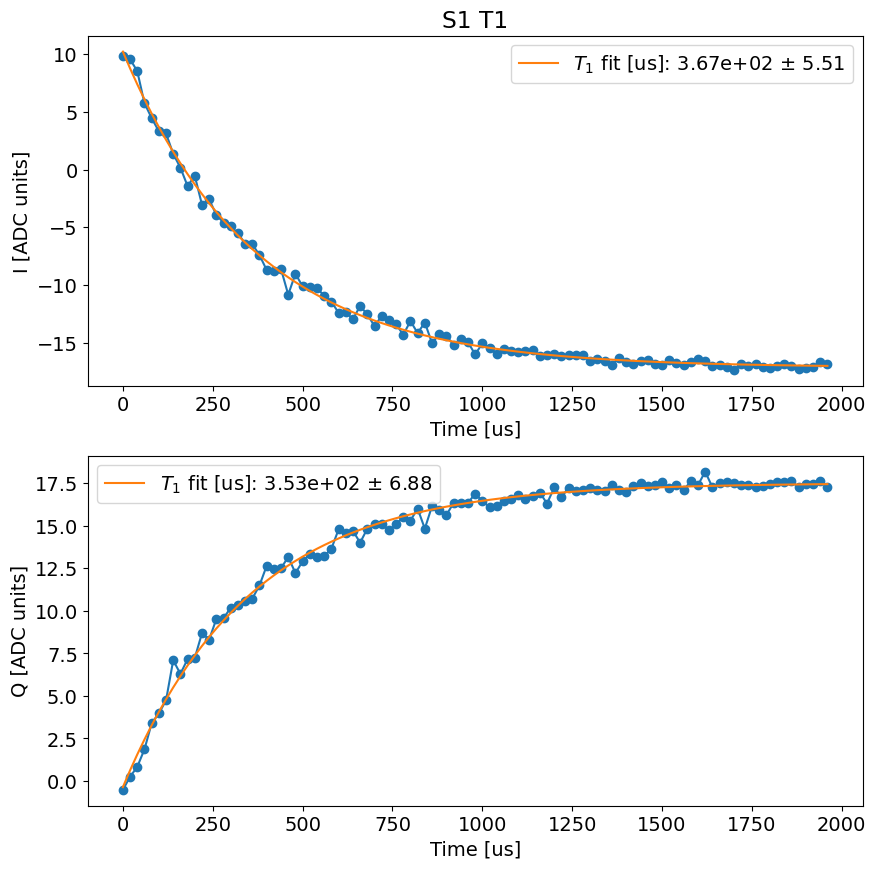

In [42]:
temp_data, attrs = prev_data(expt_path, '00022_SidebandT1GeneralExperiment.h5')
t1_display(temp_data, fit=True, active_reset= False, fitparams=None, title='S1 T1')

In [95]:
fit_t1(temp_data)

$T_1$ fit [us]: 3.26e+02 $\pm$ 14.4


(325.522038964734, 14.380092131425037)

## Storage 2

Fit T1 avgi [us]: 1277.4340465972953
Fit T1 avgq [us]: 1228.4132190895716


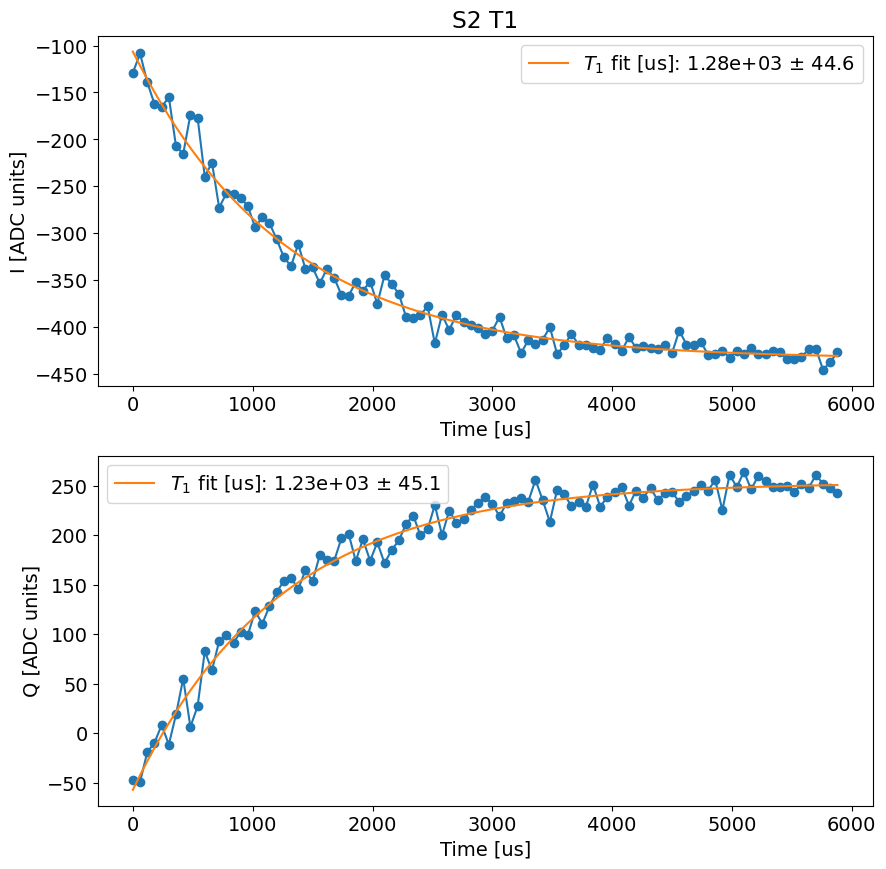

(1277.4340465972953, 44.594387264343)

In [11]:
temp_data, attrs = prev_data(expt_path, '00013_storage_t1_sweep.h5')
t1_display(temp_data, attrs, fit=True, fitparams=None, title='S2 T1', active_reset=False)

In [147]:
attrs['config']['expt']

{'start': 0.007,
 'step': 20,
 'qubits': [0],
 'expts': 250,
 'reps': 400,
 'rounds': 1,
 'prepulse': True,
 'postpulse': True,
 'active_reset': False,
 'man_reset': False,
 'storage_reset': False,
 'pre_sweep_pulse': [[3568.655054337803, 3425.3983357264633, 2006.8, 520.32],
  [11105, 9530, 15000, 5000],
  [0, 0, 0.6077792185114786, 0.9408112344723606],
  [0, 0, 0, 0],
  [2, 2, 0, 1],
  ['g', 'g', 'flat_top', 'flat_top'],
  [0.035, 0.035, 0.005, 0.005]],
 'post_sweep_pulse': [[520.32, 2006.8],
  [5000, 15000],
  [0.9408112344723606, 0.6077792185114786],
  [0, 0],
  [1, 0],
  ['flat_top', 'flat_top'],
  [0.005, 0.005]],
 'length_placeholder': 4980.007}

Fit T1 avgi [us]: 1244.1432946049488
Fit T1 avgq [us]: 1290.9232427415736


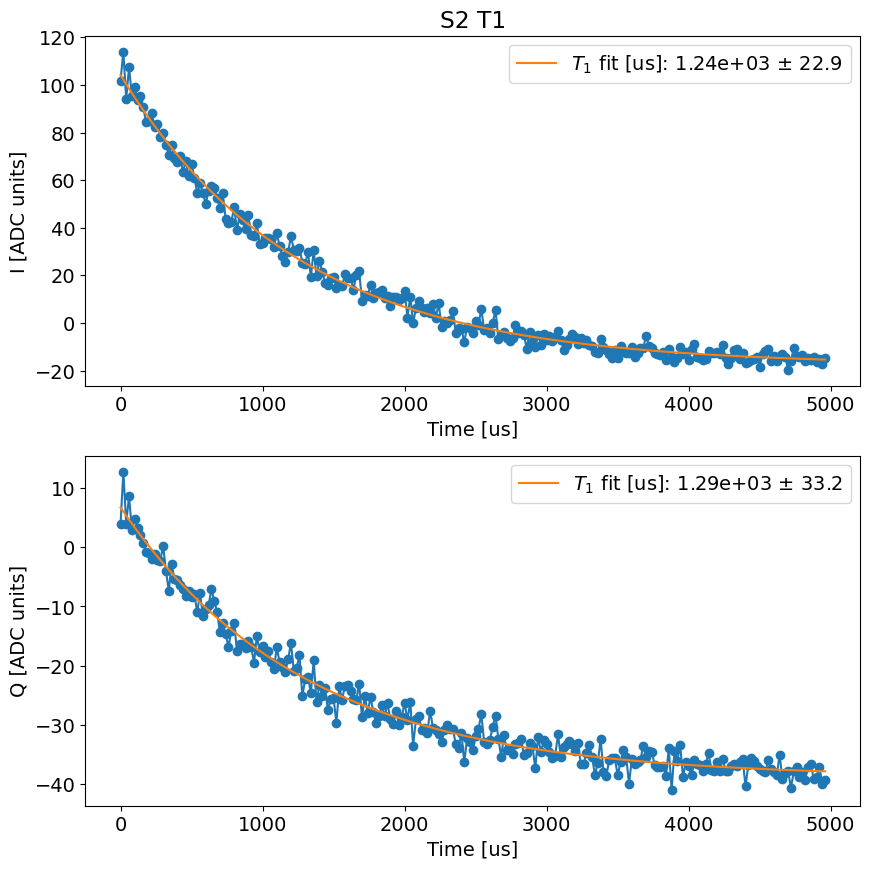

(1290.9232427415736, 33.208029291194535)

In [139]:
temp_data, attrs = prev_data(expt_path, '00011_SidebandT1GeneralExperiment.h5')
t1_display(temp_data, attrs, fit=True, fitparams=None, title='S2 T1')

## Storage 3

Fit T1 avgi [us]: 1196.0500321336958
Fit T1 avgq [us]: 1144.4408266031894


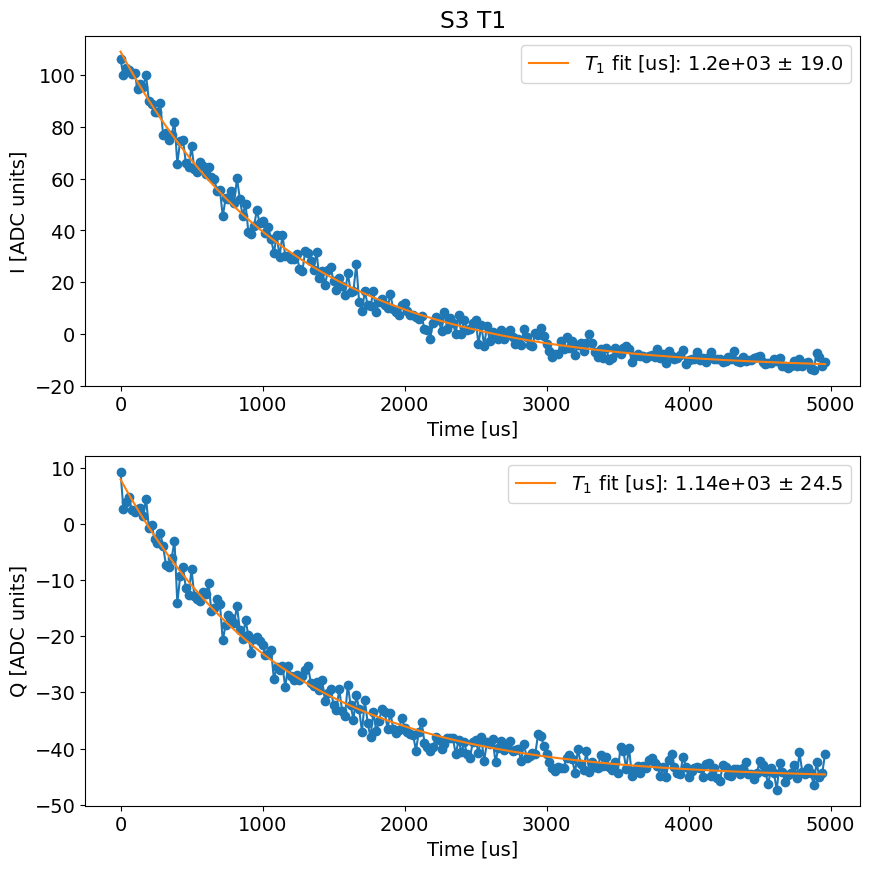

(1144.4408266031894, 24.49998940575469)

In [120]:
temp_data, attrs = prev_data(expt_path, '00010_SidebandT1GeneralExperiment.h5')
t1_display(temp_data, attrs,fit=True, fitparams=None, title='S3 T1', active_reset=False)

## Storage 4

Fit T1 avgi [us]: 1183.6113378358016
Fit T1 avgq [us]: 1227.414574101434


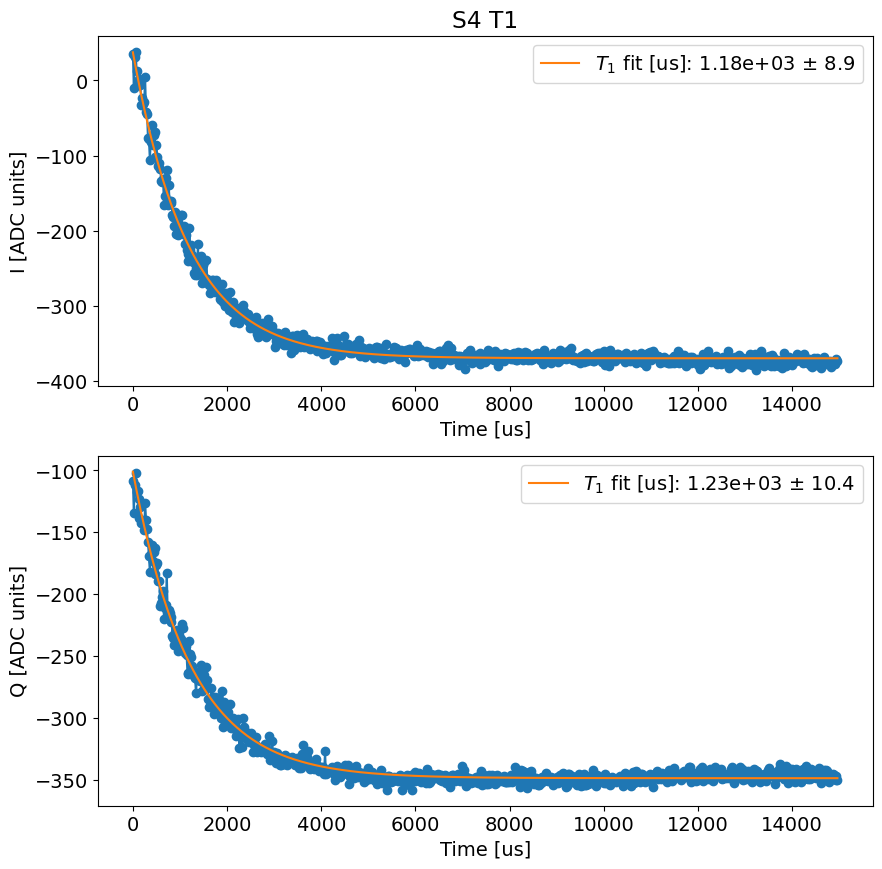

(1183.6113378358016, 8.899080348750443)

In [195]:
temp_data, attrs = prev_data(expt_path, '00011_storage_t1_sweep.h5')
t1_display(temp_data,attrs, fit=True, fitparams=None, title='S4 T1')

In [179]:
attrs['config']['expt']

{'start': 0.007,
 'step': 20,
 'qubits': [0],
 'expts': 100,
 'reps': 400,
 'rounds': 1,
 'prepulse': True,
 'postpulse': True,
 'active_reset': False,
 'man_reset': False,
 'storage_reset': False,
 'pre_sweep_pulse': [[3568.655054337803, 3425.3983357264633, 2006.8, 874.5],
  [11105, 9530, 15000, 9000],
  [0, 0, 0.6077792185114786, 1.0873710417096902],
  [0, 0, 0, 0],
  [2, 2, 0, 1],
  ['g', 'g', 'flat_top', 'flat_top'],
  [0.035, 0.035, 0.005, 0.005]],
 'post_sweep_pulse': [[874.5, 2006.8],
  [9000, 15000],
  [1.0873710417096902, 0.6077792185114786],
  [0, 0],
  [1, 0],
  ['flat_top', 'flat_top'],
  [0.005, 0.005]],
 'length_placeholder': 1980.007}

Fit T1 avgi [us]: 1137.9388909355825
Fit T1 avgq [us]: 1130.6175479581104


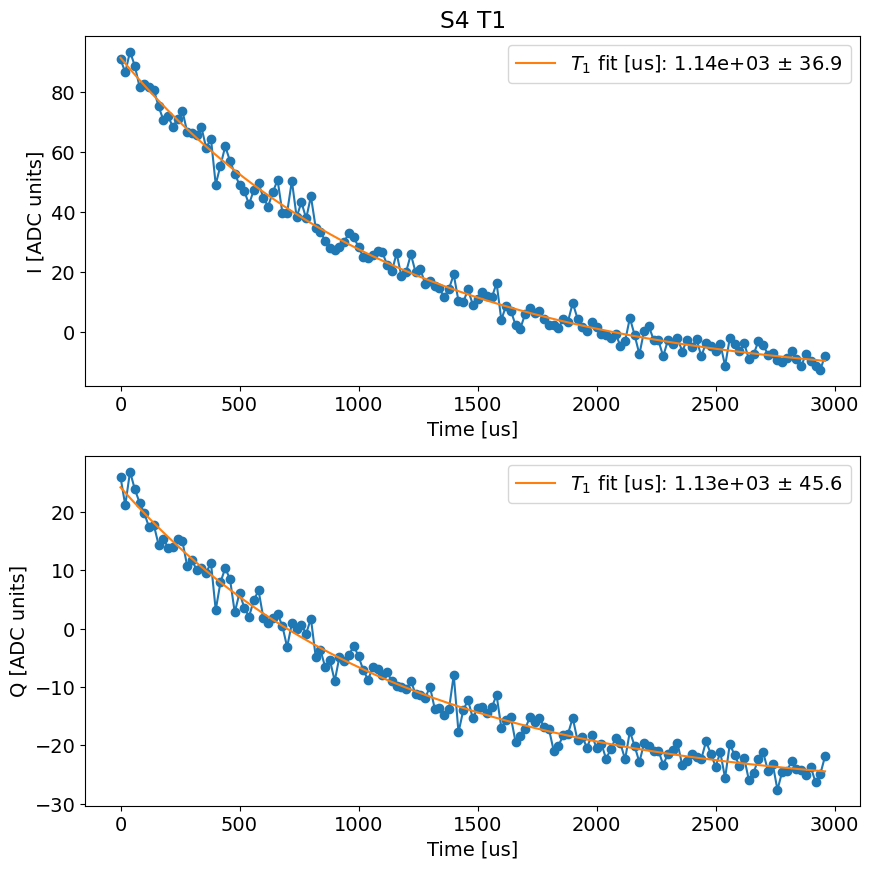

(1137.9388909355825, 36.85240291716228)

In [169]:
temp_data, attrs = prev_data(expt_path, '00004_SidebandT1GeneralExperiment.h5')
t1_display(temp_data, attrs, fit=True, fitparams=None, title='S4 T1')

In [170]:
attrs['config']['expt'] 

{'start': 0.007,
 'step': 20,
 'qubits': [0],
 'expts': 150,
 'reps': 400,
 'rounds': 1,
 'prepulse': True,
 'postpulse': True,
 'active_reset': False,
 'man_reset': False,
 'storage_reset': False,
 'pre_sweep_pulse': [[3568.6633051114345, 3425.406304983311, 2006.8, 874.5],
  [11105, 9530, 15000, 9000],
  [0, 0, 0.6077792185114786, 1.0873710417096902],
  [0, 0, 0, 0],
  [2, 2, 0, 1],
  ['g', 'g', 'flat_top', 'flat_top'],
  [0.035, 0.035, 0.005, 0.005]],
 'post_sweep_pulse': [[874.5, 2006.8],
  [9000, 15000],
  [1.0873710417096902, 0.6077792185114786],
  [0, 0],
  [1, 0],
  ['flat_top', 'flat_top'],
  [0.005, 0.005]],
 'length_placeholder': 2980.007}

## Storage 5

Fit T1 avgi [us]: 1085.5157219085593
Fit T1 avgq [us]: 1259.9885368786518


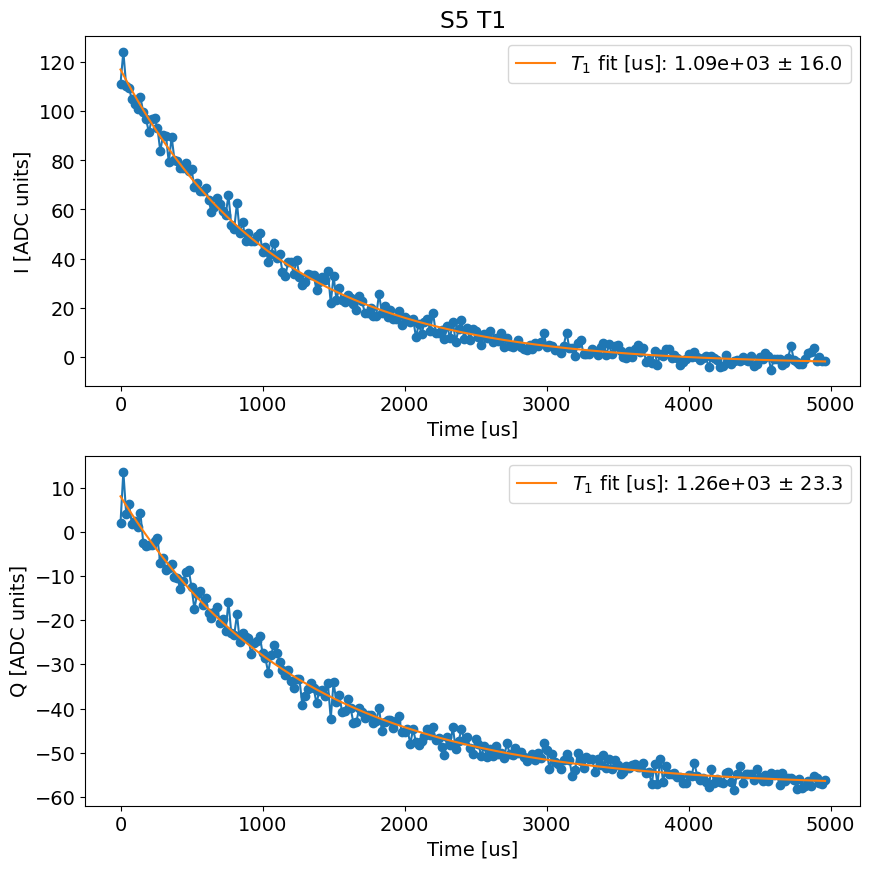

(1085.5157219085593, 15.970272654226328)

In [171]:
temp_data, attrs = prev_data(expt_path, '00006_storage_t1_sweep.h5')
t1_display(temp_data,attrs, fit=True, fitparams=None, title='S5 T1')

In [168]:
attrs['config']['expt']

{'start': 0.007,
 'step': 20,
 'qubits': [0],
 'expts': 250,
 'reps': 400,
 'rounds': 1,
 'prepulse': True,
 'postpulse': True,
 'active_reset': False,
 'man_reset': False,
 'storage_reset': False,
 'pre_sweep_pulse': [[3568.655054337803, 3425.3983357264633, 2006.8, 874.5],
  [11105, 9530, 15000, 9000],
  [0, 0, 0.6077792185114786, 1.0873710417096902],
  [0, 0, 0, 0],
  [2, 2, 0, 1],
  ['g', 'g', 'flat_top', 'flat_top'],
  [0.035, 0.035, 0.005, 0.005]],
 'post_sweep_pulse': [[874.5, 2006.8],
  [9000, 15000],
  [1.0873710417096902, 0.6077792185114786],
  [0, 0],
  [1, 0],
  ['flat_top', 'flat_top'],
  [0.005, 0.005]],
 'length_placeholder': 4980.007}

In [1116]:
attrs['config']['expt']

{'start': 0.007,
 'step': 0.15,
 'qubits': [0],
 'expts': 100,
 'reps': 400,
 'rounds': 1,
 'flux_drive': ['high', 1053.2700000000004, 5000, 0.005],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.159805939475, 3425.5642769944775, 0, 2006.45],
  [13344, 10144, 0, 15000],
  [0.0, 0.0, 0.01, 0.6168589772656545],
  [0, 0, 0, 0],
  [2, 2, 5, 5],
  ['gaussian', 'gaussian', 'flat_top', 'flat_top'],
  [0.025, 0.025, 0.005, 0.005]],
 'post_sweep_pulse': [[2006.45],
  [15000],
  [0.6168589772656545],
  [0],
  [5],
  ['flat_top'],
  [0.005]],
 'length_placeholder': 14.857}

## Storage 6

Fit T1 avgi [us]: 980.817198411962
Fit T1 avgq [us]: 1003.6547003271478


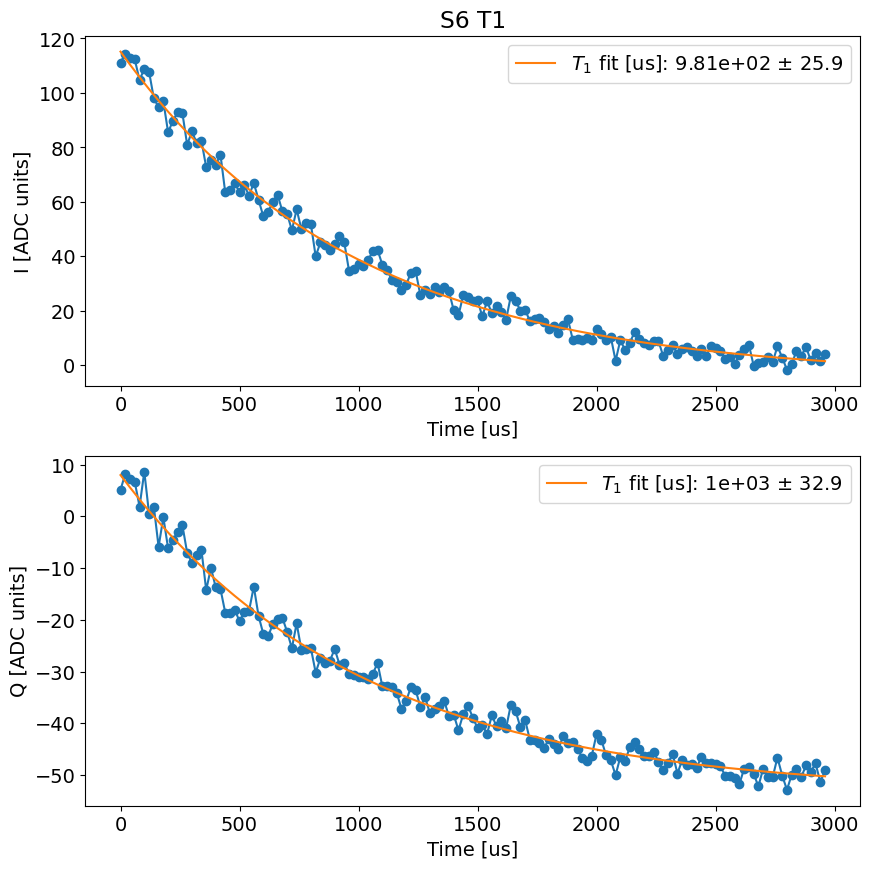

(1003.6547003271478, 32.923129982481655)

In [77]:
temp_data, attrs = prev_data(expt_path, '00008_SidebandT1GeneralExperiment.h5')
t1_display(temp_data,attrs, fit=True, fitparams=None, title='S6 T1', active_reset=False)

## Storage 7

Fit T1 avgi [us]: 645.2018219794863
Fit T1 avgq [us]: 640.1636731940442


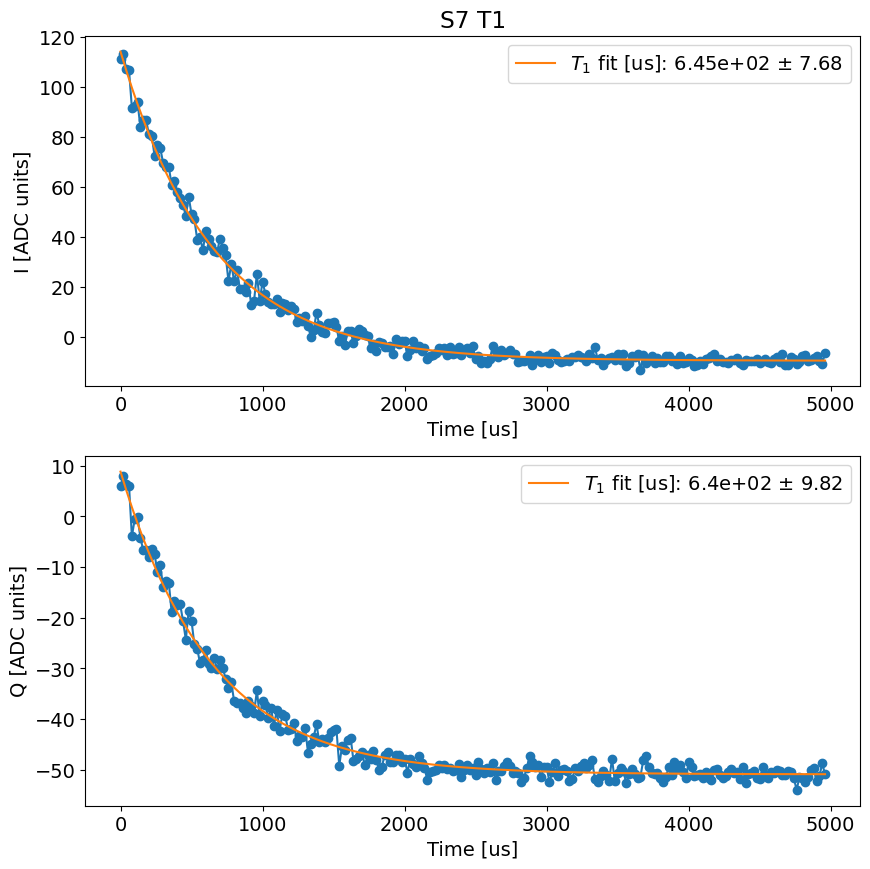

(640.1636731940442, 9.815917647887414)

In [60]:
temp_data, attrs = prev_data(expt_path, '00007_SidebandT1GeneralExperiment.h5')
t1_display(temp_data,attrs, fit=True, fitparams=None, title='S7 T1')

## All storage modes

Fit T1 avgi [us]: 1153.283040488111
Fit T1 avgq [us]: 1298.3726133861724


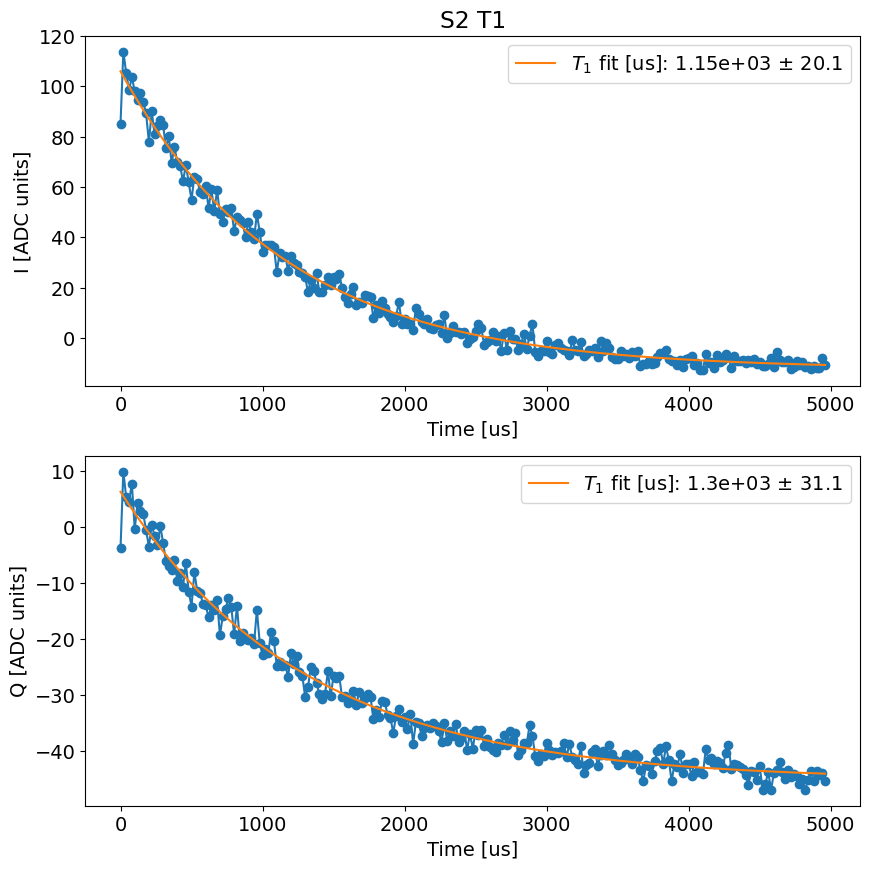

Fit T1 avgi [us]: 1165.059717953785
Fit T1 avgq [us]: 1430.3247400309465


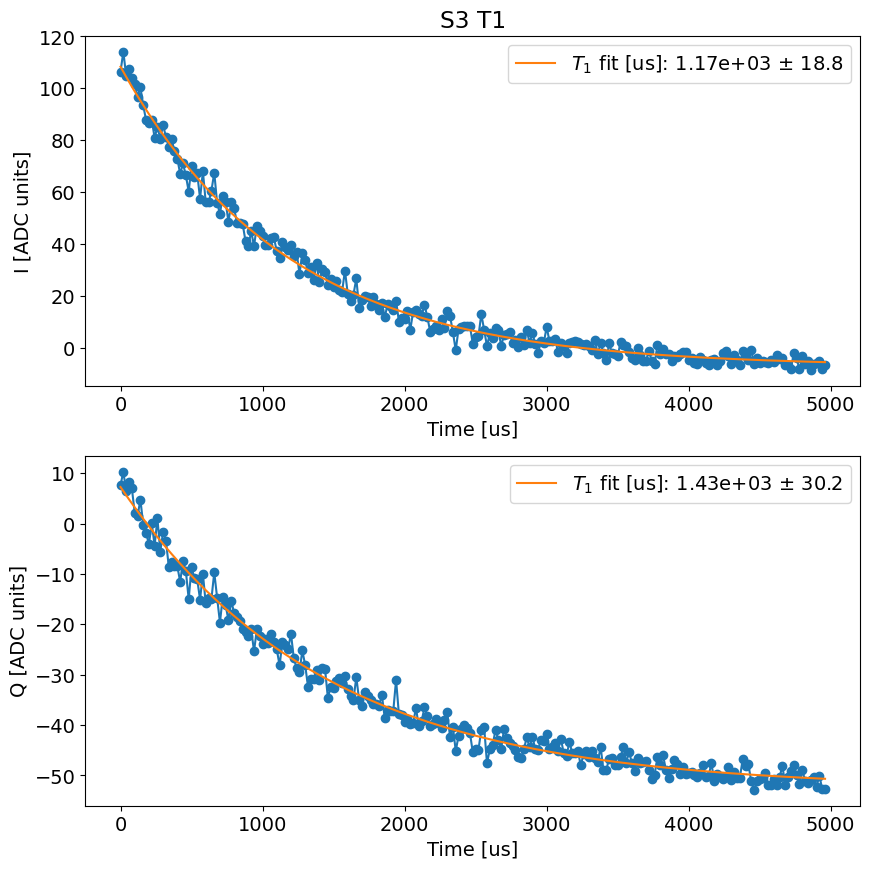

Fit T1 avgi [us]: 1138.4652735085224
Fit T1 avgq [us]: 1286.825479738411


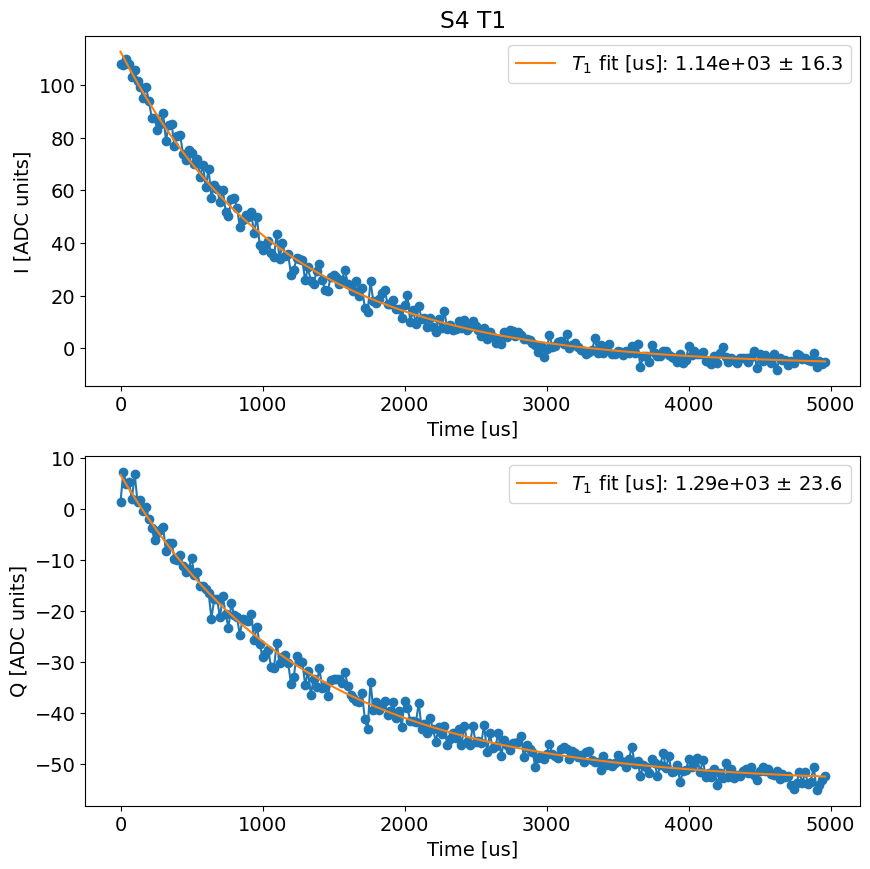

c:\Users\26049\.conda\envs\slab\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


Fit T1 avgi [us]: 244.28011506246796
Fit T1 avgq [us]: 233.74156137564177


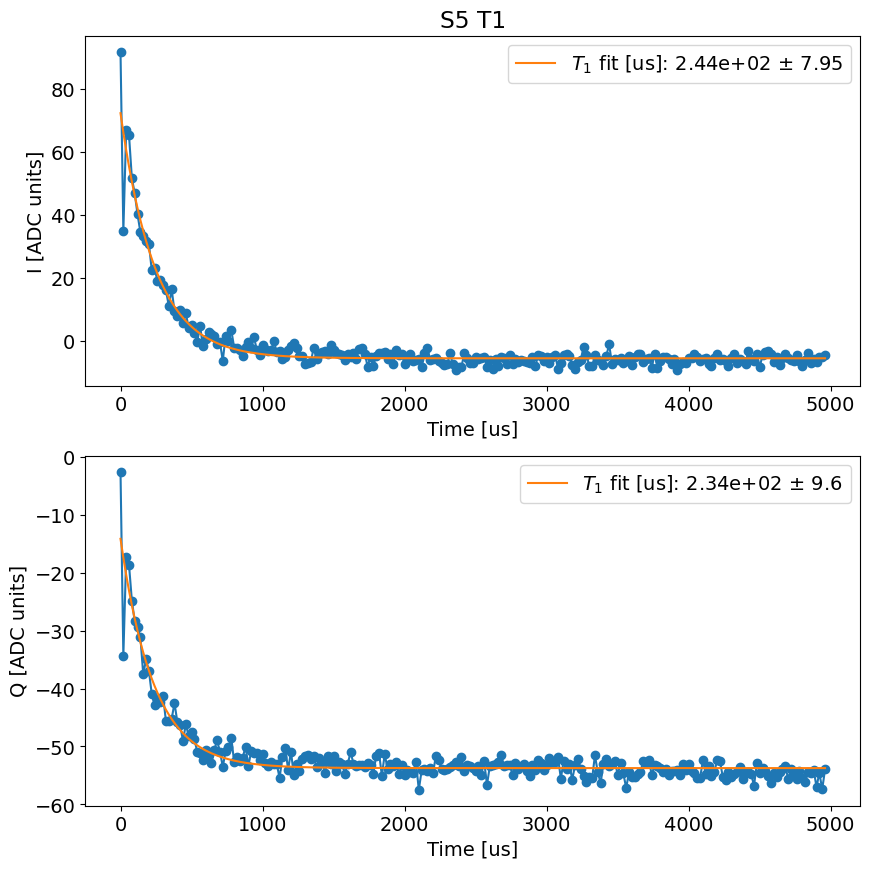

Fit T1 avgi [us]: 1085.5157219085593
Fit T1 avgq [us]: 1259.9885368786518


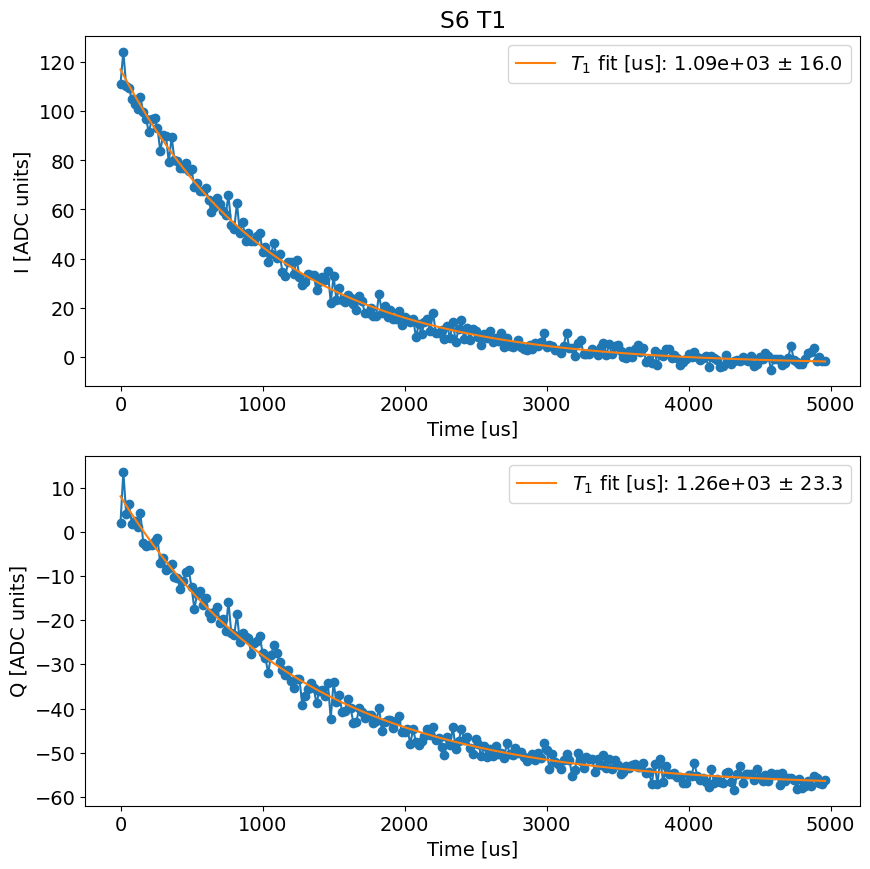

Fit T1 avgi [us]: 1019.6247261117884
Fit T1 avgq [us]: 1084.782353327104


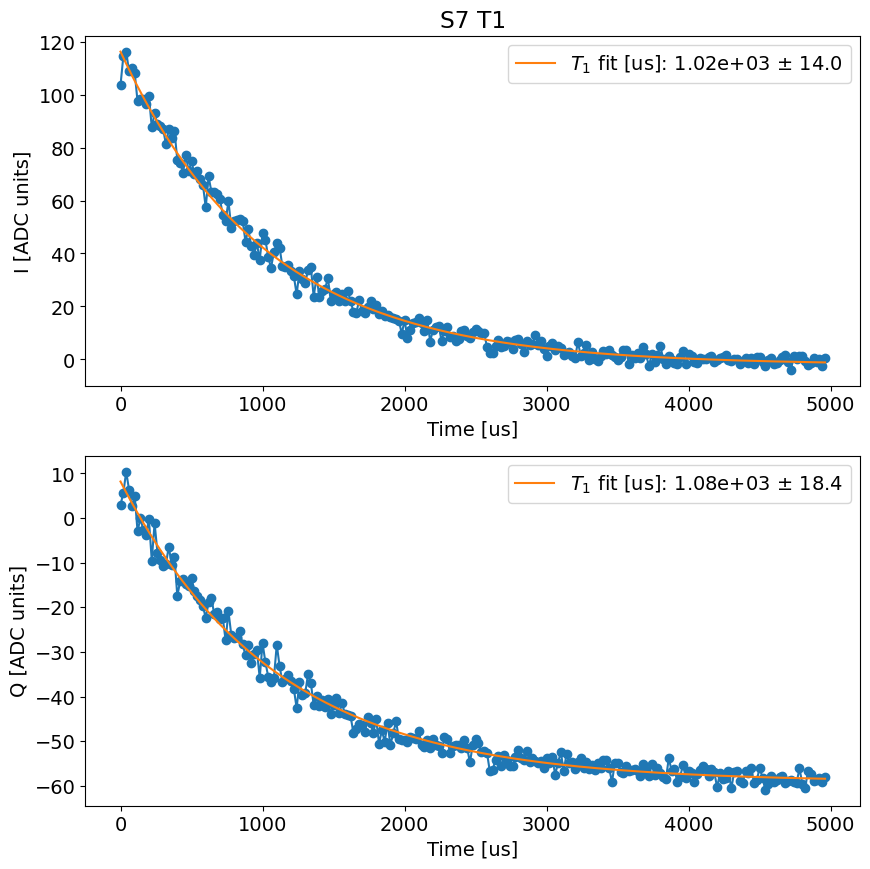

Fit T1 avgi [us]: 629.176383424421
Fit T1 avgq [us]: 692.0726727933702


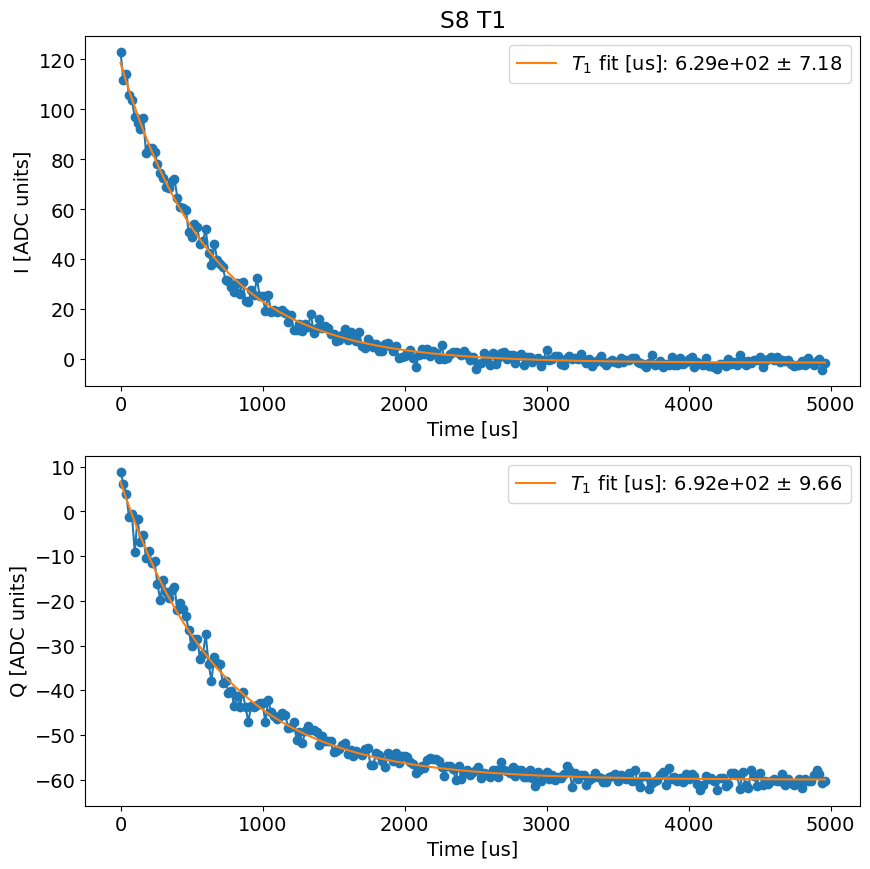

In [159]:
t1s = []
t1_errs = []
for i in range(2,9):
    temp_data, attrs = prev_data(expt_path, '0000'+str(i)+'_storage_t1_sweep.h5')
    t1, t1_err = t1_display(temp_data, attrs, fit=True, fitparams=None, title='S'+str(i)+' T1', active_reset=False)
    t1s.append(t1)
    t1_errs.append(t1_err)


In [174]:
t1_errs

[20.125954480419647,
 18.83609481283889,
 16.295158678224198,
 7.954514648418462,
 15.970272654226328,
 14.00277765856333,
 7.176589863415904]

## storage 8

h:\Shared drives\SLab\Multimode\experiment\240911\experiments\fitting.py:55: RuntimeWarning: overflow encountered in exp
  return y0 + yscale*np.exp(-(x-x0)/decay)


Fit T1 avgi [us]: 11.483226191880467
Fit T1 avgq [us]: 11.462242951189127


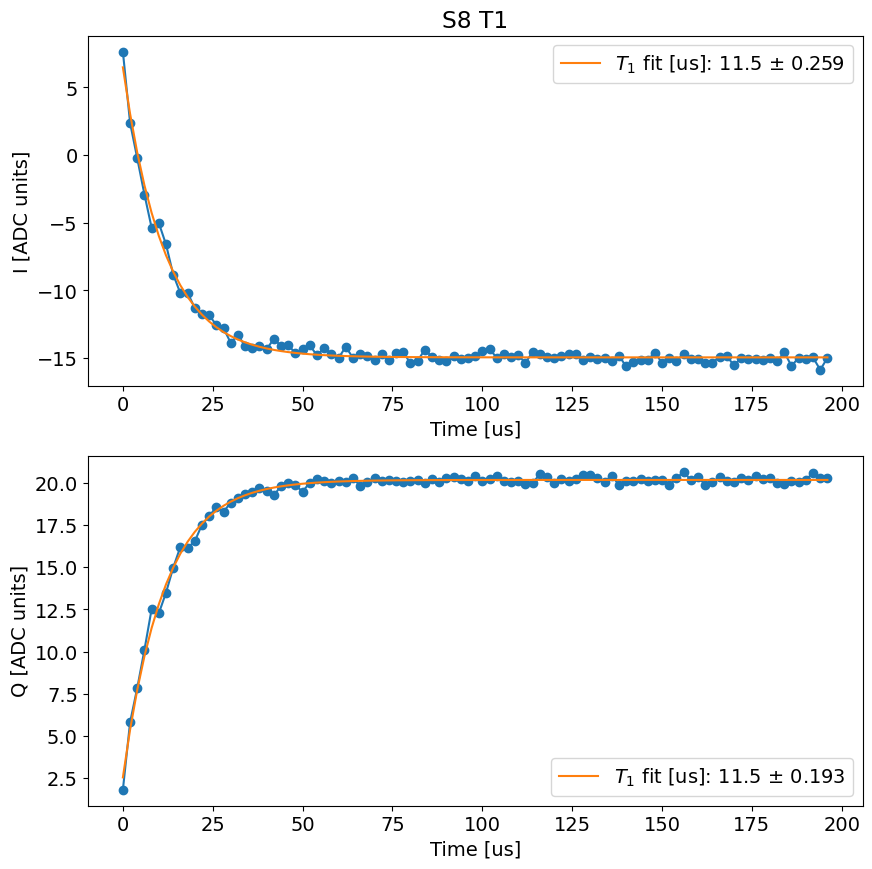

In [64]:
temp_data, attrs = prev_data(expt_path, '00026_SidebandT1GeneralExperiment.h5')
t1_display(temp_data, fit=True, fitparams=None, title='S8 T1', active_reset=False)

## Storage 10

Fit T1 avgi [us]: 40.19010896758286
Fit T1 avgq [us]: 38.04800827724407


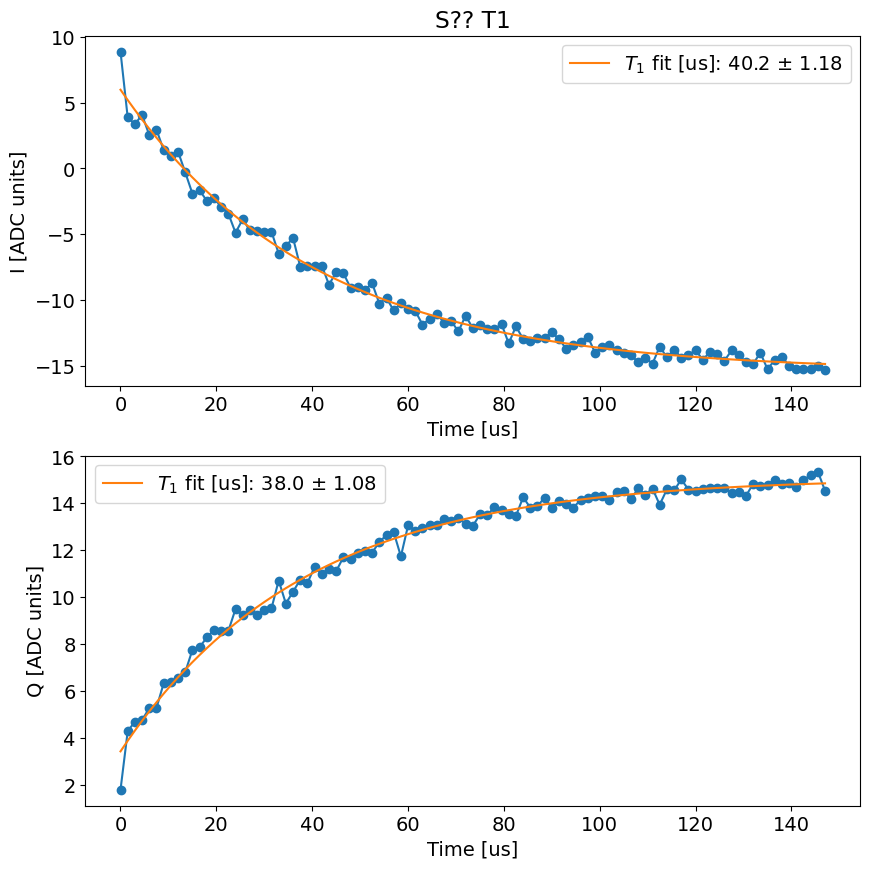

In [62]:
temp_data, attrs = prev_data(expt_path, '00005_SidebandT1GeneralExperiment.h5')
t1_display(temp_data, fit=True, fitparams=None, title='S?? T1', active_reset=False)

In [63]:
attrs['config']['expt']

{'start': 0.007,
 'step': 1.5,
 'qubits': [0],
 'expts': 100,
 'reps': 500,
 'rounds': 1,
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.1904347121535, 3425.5537944060666, 1834.83, 2019.2],
  [9653, 7575, 15000, 3000],
  [0, 0, 1.0988389376322376, 0.41362426587604323],
  [0, 0, 0, 0],
  [2, 2, 5, 3],
  ['gaussian', 'gaussian', 'flat_top', 'flat_top'],
  [0.035, 0.035, 0.005, 0.005]],
 'post_sweep_pulse': [[2019.2, 1834.83],
  [3000, 15000],
  [0.41362426587604323, 1.0988389376322376],
  [0, 0],
  [3, 5],
  ['flat_top', 'flat_top'],
  [0.005, 0.005]],
 'length_placeholder': 148.507}

## Coupler

Fit T1 avgi [us]: 30.376028000341147
Fit T1 avgq [us]: 33.53026305677078


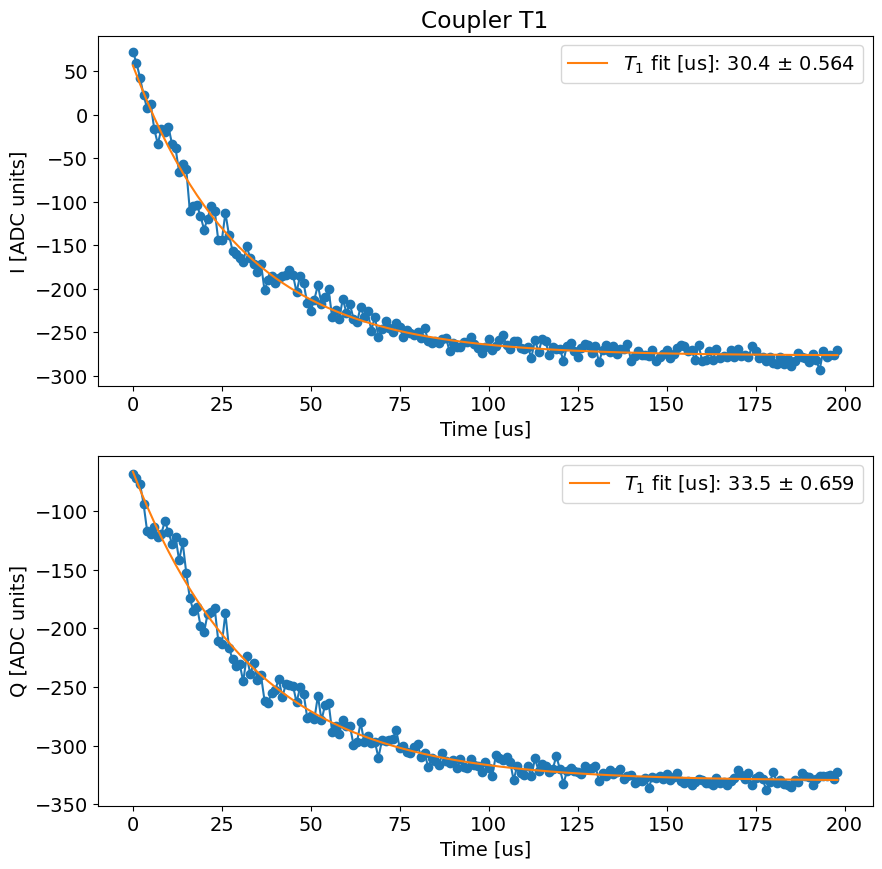

(33.53026305677078, 0.6590236866893014)

In [53]:
temp_data, attrs = prev_data(expt_path, '00002_SidebandT1GeneralExperiment.h5')
t1_display(temp_data, attrs, fit=True, fitparams=None, title='Coupler T1')

## T1 analysis

In [56]:
# Data from the LaTeX table
data = [
    ["Qubit ($Q$)", "$\omega_{q}$", 3.568, "493±13.1", "259±8.0", "370±14"],
    ["Coupler ($C$)", "$\omega_{c}$", 4.037, "45±0.8", "0.39±0.04", ""],
    ["Buffer 1", "$\omega_{b1}$", 4.984, "209±5.1", "75.5±3.8", "219±7.0"],
    ["Buffer 2", "$\omega_{b2}$", 5.158, "120±1.3", "70.6±5.4", "193±6.7"],
    ["Storage 1", "$\omega_{s1}$", 5.333, "358.3±6.0", "235.7±7.1", "551.6±16.8"],
    ["Storage 2", "$\omega_{s2}$", 5.505, "1254.8±30.2", "378.3±15.1", "1493.2±53.5"],
    ["Storage 3", "$\omega_{s3}$", 5.681, "799.0±12.7", "677.2±16.8", "1309.9±41.8"],
    ["Storage 4", "$\omega_{s4}$", 5.860, "597.4±11.9", "806.2±23.7", "972.4±29.8"],
    ["Storage 5", "$\omega_{s5}$", 6.037, "355.7±5.5", "591.8±15.2", "663.3±22.7"],
    ["Storage 6", "$\omega_{s6}$", 6.229, "589.5±12.9", "1071.1±63.0", "1048.4±54.1"],
    ["Storage 7", "$\omega_{s7}$", 6.407, "371.2±6.4", "663.5±29.0", "692.7±22.7"],
    ["Dump 1", "$\omega_{d1}$", 7.297, "0.73±0.03", "", ""],
    ["Dump 2", "$\omega_{d2}$", 7.252, "1.81±0.11", "", ""],
    ["Readout ($R$)", "$\omega_{r}$", 8.051, "0.05±0.01", "", ""]
]

# Convert into a NumPy array (for numerical processing, you can adjust column 3 and 4)
np_array = np.array(data)

freq_stor = np_array[:, 2][4:11].astype(float)

freq_stor

array([5.333, 5.505, 5.681, 5.86 , 6.037, 6.229, 6.407])

In [57]:
t1s_old = [358.3, 1254.8, 799.0, 597.4, 355.7, 589.5, 371.2] # raqm paper 
qc = np.array([15,500,
73.4,
42.5,
24.9,
47.4,
31.9])

# Q = omega * T1
q_total = freq_stor*1e3 * t1s_old * 2 * np.pi * 1e-6 # in million 

q_i = (1/q_total - 1/qc)**-1

t1_intrinsic = q_i/freq_stor*1e3/(2*np.pi) # in micro seconds
t1_intrinsic

array([1795.08887406, 1374.0758151 , 1306.74608733, 1238.26749708,
        776.39699121, 1148.55732685,  698.31895111])

In [151]:
3e-4 * 2*np.pi*5e9

9424777.960769378

In [131]:
new_qc_hfss = qc * (10**(1.75/2))#np.sqrt(10)
q_total = (1/q_i + 1/new_qc_hfss)**-1
t1_hfss = q_total/freq_stor*1e3/(2*np.pi) # in micro seconds
t1_hfss

array([1169.63385813, 1356.87622425, 1204.66049031, 1083.29651859,
        670.62613601, 1019.61150845,  624.88485758])

In [132]:
# get coupler storage chis 

folder = os.path.join(data_parent_old, 'RAM_paper_results', 'datasets')
file_name = 'StorageCoupler_chis.csv'
file_path = os.path.join(folder, file_name)

# Ensure the directory exists
os.makedirs(folder, exist_ok=True)

# Save the DataFrame to a CSV file
df_chis = pd.read_csv(file_path)

df_chis


,mode,freq,detuning,g,zz_shift
0,S1,5333.367742,1322.890,78.734242,-0.422000
1,S2,5504.937742,1494.460,88.112234,-0.412000
2,S3,5680.687742,1670.210,69.096214,-0.202000
3,S4,5860.087742,1849.610,42.464539,-0.062000
4,S5,6037.657742,2027.180,98.590065,-0.278212
5,S6,6229.232742,2218.755,89.878559,-0.192000
6,S7,6406.982742,2396.505,106.817578,-0.232000


In [158]:
part_factor = (1.452/60)
40/part_factor

1652.892561983471

In [133]:
part_factors = (df_chis['g'].values / df_chis['detuning'].values)**2
coup_t1 = 40 # mus
t1_purcell = coup_t1/part_factors
t1_purcell

array([11292.24146255, 11506.84209837, 23371.87997536, 75887.02074519,
       16911.35143271, 24376.22730143, 20134.05355642])

Text(0.5, 1.0, 'T1 comparison')

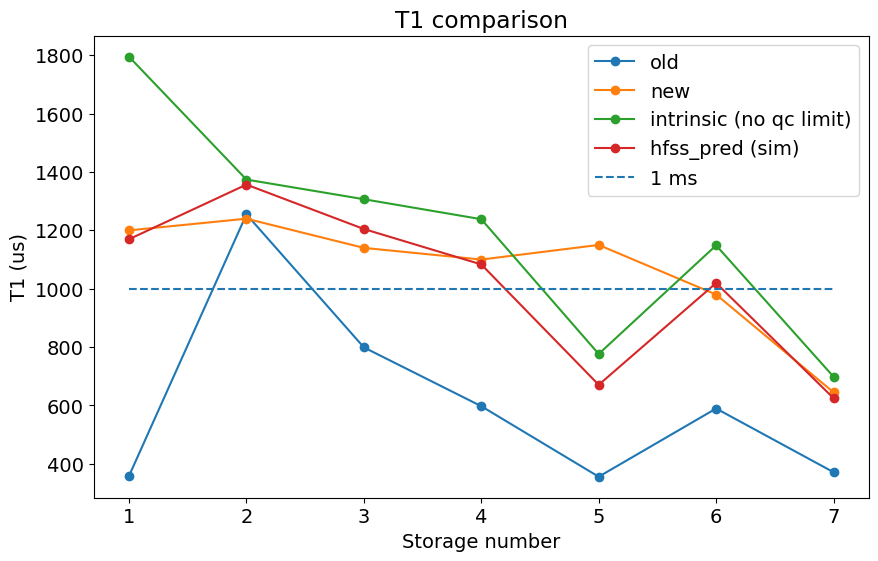

In [140]:
t1s_new = [1200, 1240, 1140, 1100, 1150,980, 645 ] # from, 030122025
stor_list = [1,2,3,4,5,6,7]
plt.plot(stor_list, t1s_old, '-o',label='old')
plt.plot(stor_list,t1s_new, '-o' , label='new')
plt.plot(stor_list,t1_intrinsic,'-o',  label='intrinsic (no qc limit)')
plt.plot(stor_list,t1_hfss, '-o' ,label='hfss_pred (sim)')
plt.hlines([1000], 1, 7, linestyles='dashed', label='1 ms')
# plt.plot(t1_purcell, '-o', label='purcell')
plt.legend()
# labels axes
plt.xlabel('Storage number')
plt.ylabel('T1 (us)')
plt.title('T1 comparison')

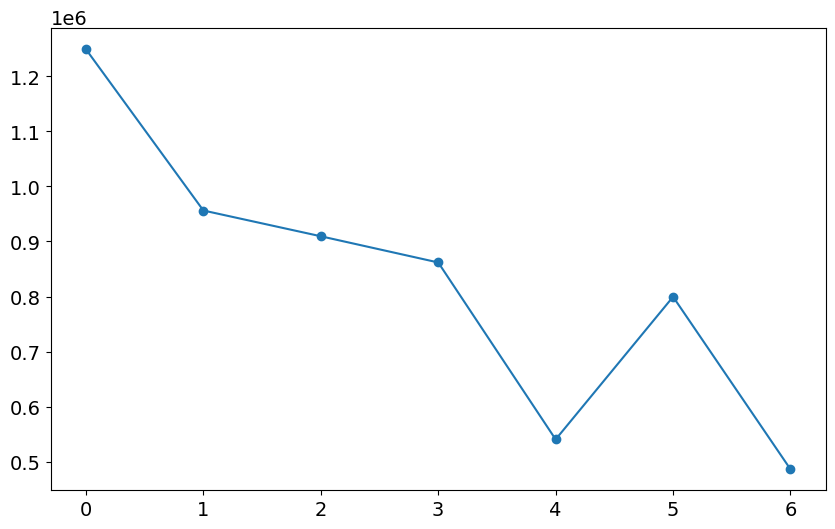

In [122]:
plt.plot(t1_intrinsic * freq_list,'-o',  label='intrinsic')